In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, Conv1D, MaxPooling1D, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for specific humidity
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for specific humidity
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for specific humidity
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (specific_humidity) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

# Swap columns 'temperatures' and 'specific_humidity' directly
df['A'] = df['temperatures']
df['temperatures'] = df['specific_humidity']
df['specific_humidity'] = df['A']
df = df.drop(columns=['A'])
# Rename columns
df = df.rename(columns={'temperatures': 'specific_humidity', 'specific_humidity': 'temperatures'})

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['solar_activity'], axis=1)

n_vars = df_trimmed.shape[1]-1

X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['specific_humidity'].iloc[j])
    y.append(add_to_y)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df) 
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['specific_humidity']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['specific_humidity']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  specific_humidity          slp  vapor_pressure  \
0      2006-01-31     6501           5.386935  1018.534543        8.674922   
1      2006-02-28     6501           4.299929  1021.230347        6.942276   
2      2006-03-31     6501           6.505135  1018.968548       10.468176   
3      2006-04-30     6501          10.211263  1014.686944       16.358802   
4      2006-05-31     6501          11.737971  1014.236828       18.798749   
...           ...      ...                ...          ...             ...   
24057  2024-07-31     9858          15.211417  1013.969355       23.769169   
24058  2024-08-31     9858          15.149811  1015.112097       23.699154   
24059  2024-09-30     9858          10.720199  1014.393750       16.790240   
24060  2024-10-31     9858           6.989922  1018.230376       1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-18 03:54:36,833] A new study created in memory with name: no-name-692477f7-a5f0-425a-9ce7-ba1e9848fc92
[I 2025-05-18 04:00:37,533] Trial 0 finished with value: 0.06488744765520096 and parameters: {'lr': 0.00801727458178656, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.10252820208043022}. Best is trial 0 with value: 0.06488744765520096.


Cross Validation Accuracies:
[0.06019195541739464, 0.061817169189453125, 0.0721374899148941, 0.07304466515779495, 0.05724595859646797]
Mean Cross Validation Accuracy:
0.06488744765520096
Standard Deviation of Cross Validation Accuracy:
0.006464826716923393


[I 2025-05-18 04:09:30,070] Trial 1 finished with value: 0.06393875628709793 and parameters: {'lr': 0.13158563021174108, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2938029134630171}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.05883675441145897, 0.060913875699043274, 0.0709260031580925, 0.07119683176279068, 0.05782031640410423]
Mean Cross Validation Accuracy:
0.06393875628709793
Standard Deviation of Cross Validation Accuracy:
0.00590113397170234


[I 2025-05-18 04:20:37,157] Trial 2 finished with value: 0.30140066146850586 and parameters: {'lr': 0.0500160612937509, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.31024117164203546}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.283568799495697, 0.30750179290771484, 0.2621842622756958, 0.3263455331325531, 0.32740291953086853]
Mean Cross Validation Accuracy:
0.30140066146850586
Standard Deviation of Cross Validation Accuracy:
0.025264556669702856


[I 2025-05-18 04:28:55,719] Trial 3 finished with value: 0.2535289883613586 and parameters: {'lr': 0.04697932180815393, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.45345623425602544}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.2839319407939911, 0.21912997961044312, 0.27953779697418213, 0.26755961775779724, 0.21748560667037964]
Mean Cross Validation Accuracy:
0.2535289883613586
Standard Deviation of Cross Validation Accuracy:
0.029257728449443104


[I 2025-05-18 04:40:51,165] Trial 4 finished with value: 0.14275347143411637 and parameters: {'lr': 0.9604838376072142, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.19692100870027718}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.17552146315574646, 0.3032127320766449, 0.08136873692274094, 0.08393246680498123, 0.06973195821046829]
Mean Cross Validation Accuracy:
0.14275347143411637
Standard Deviation of Cross Validation Accuracy:
0.08874801768772068


[I 2025-05-18 04:49:45,687] Trial 5 finished with value: 0.49722005128860475 and parameters: {'lr': 0.0010957147065260317, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.3220897635759461}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.5003769397735596, 0.5013766288757324, 0.4949047267436981, 0.4906403720378876, 0.498801589012146]
Mean Cross Validation Accuracy:
0.49722005128860475
Standard Deviation of Cross Validation Accuracy:
0.003959728538821865


[I 2025-05-18 04:57:07,826] Trial 6 finished with value: 0.06433831751346589 and parameters: {'lr': 0.14887665650653242, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.12982545584058972}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.06032436713576317, 0.06119658052921295, 0.07177704572677612, 0.0710480809211731, 0.05734551325440407]
Mean Cross Validation Accuracy:
0.06433831751346589
Standard Deviation of Cross Validation Accuracy:
0.00592008822125718


[I 2025-05-18 05:06:44,162] Trial 7 finished with value: 0.11495335698127747 and parameters: {'lr': 0.1890698277139123, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.22531817159274856}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.090273417532444, 0.11497264355421066, 0.11798522621393204, 0.12201332300901413, 0.1295221745967865]
Mean Cross Validation Accuracy:
0.11495335698127747
Standard Deviation of Cross Validation Accuracy:
0.01326940527107874


[I 2025-05-18 05:14:56,141] Trial 8 finished with value: 0.1783688485622406 and parameters: {'lr': 0.02784259571537621, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.10702948900808412}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.19527529180049896, 0.1761663258075714, 0.157612144947052, 0.1758526861667633, 0.18693779408931732]
Mean Cross Validation Accuracy:
0.1783688485622406
Standard Deviation of Cross Validation Accuracy:
0.0126592067292425


[I 2025-05-18 05:24:59,156] Trial 9 finished with value: 0.06500025540590286 and parameters: {'lr': 0.03415488154115198, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4349695749875848}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[0.05933860316872597, 0.061472728848457336, 0.07245254516601562, 0.07318954169750214, 0.05854785814881325]
Mean Cross Validation Accuracy:
0.06500025540590286
Standard Deviation of Cross Validation Accuracy:
0.006461148700749249


[I 2025-05-18 05:37:25,889] Trial 10 finished with value: 9.370652866363525 and parameters: {'lr': 0.8565908030837033, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.39127297897271834}. Best is trial 1 with value: 0.06393875628709793.


Cross Validation Accuracies:
[10.642868041992188, 8.26563549041748, 7.123755931854248, 13.665807723999023, 7.1551971435546875]
Mean Cross Validation Accuracy:
9.370652866363525
Standard Deviation of Cross Validation Accuracy:
2.49978959111946


[I 2025-05-18 05:45:50,966] Trial 11 finished with value: 0.061994298547506335 and parameters: {'lr': 0.22106824221608912, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.19845655029850248}. Best is trial 11 with value: 0.061994298547506335.


Cross Validation Accuracies:
[0.05395164713263512, 0.060077592730522156, 0.07071290910243988, 0.06883659213781357, 0.05639275163412094]
Mean Cross Validation Accuracy:
0.061994298547506335
Standard Deviation of Cross Validation Accuracy:
0.006671828570600514


[I 2025-05-18 05:54:35,633] Trial 12 finished with value: 0.06410023495554924 and parameters: {'lr': 0.22622985105858928, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.24072417902620288}. Best is trial 11 with value: 0.061994298547506335.


Cross Validation Accuracies:
[0.05970020592212677, 0.05866717919707298, 0.07112358510494232, 0.07133574783802032, 0.0596744567155838]
Mean Cross Validation Accuracy:
0.06410023495554924
Standard Deviation of Cross Validation Accuracy:
0.005833454506420859


[I 2025-05-18 06:03:02,052] Trial 13 finished with value: 0.061559805274009706 and parameters: {'lr': 0.3304007944567223, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2567095094631814}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05849524587392807, 0.055294349789619446, 0.06804665923118591, 0.06731032580137253, 0.058652445673942566]
Mean Cross Validation Accuracy:
0.061559805274009706
Standard Deviation of Cross Validation Accuracy:
0.005142916627458801


[I 2025-05-18 06:13:39,455] Trial 14 finished with value: 0.06840882748365402 and parameters: {'lr': 0.4909274149965699, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1792308674074777}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06224217265844345, 0.059286557137966156, 0.07441384345293045, 0.07863079756498337, 0.06747076660394669]
Mean Cross Validation Accuracy:
0.06840882748365402
Standard Deviation of Cross Validation Accuracy:
0.00724806588466197


[I 2025-05-18 06:21:42,817] Trial 15 finished with value: 0.06963286101818085 and parameters: {'lr': 0.33418686193578445, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.27062688051831957}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05774645507335663, 0.06525787711143494, 0.07408589869737625, 0.08334872871637344, 0.06772534549236298]
Mean Cross Validation Accuracy:
0.06963286101818085
Standard Deviation of Cross Validation Accuracy:
0.008625779005253166


[I 2025-05-18 06:29:18,493] Trial 16 finished with value: 0.21307488679885864 and parameters: {'lr': 0.009428969536125025, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.36205631274576616}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.1730850487947464, 0.2433355748653412, 0.21310682594776154, 0.21669143438339233, 0.21915555000305176]
Mean Cross Validation Accuracy:
0.21307488679885864
Standard Deviation of Cross Validation Accuracy:
0.02264928823338763


[I 2025-05-18 06:38:40,016] Trial 17 finished with value: 8.489998054504394 and parameters: {'lr': 0.09244045975959028, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4995040169226376}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[8.247876167297363, 8.736071586608887, 8.580724716186523, 8.051109313964844, 8.834208488464355]
Mean Cross Validation Accuracy:
8.489998054504394
Standard Deviation of Cross Validation Accuracy:
0.296145460213847


[I 2025-05-18 06:48:00,995] Trial 18 finished with value: 0.06585060432553291 and parameters: {'lr': 0.4935625644101535, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.1744864945440218}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06573284417390823, 0.05909930169582367, 0.07291814684867859, 0.07293759286403656, 0.058565136045217514]
Mean Cross Validation Accuracy:
0.06585060432553291
Standard Deviation of Cross Validation Accuracy:
0.006306307423144955


[I 2025-05-18 06:59:17,715] Trial 19 finished with value: 0.0649413950741291 and parameters: {'lr': 0.010858433567081903, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.2540192116263679}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.058840855956077576, 0.06119191274046898, 0.0723644569516182, 0.07323139905929565, 0.05907835066318512]
Mean Cross Validation Accuracy:
0.0649413950741291
Standard Deviation of Cross Validation Accuracy:
0.006472657858671613


[I 2025-05-18 07:07:48,157] Trial 20 finished with value: 6.237134027481079 and parameters: {'lr': 0.08599680401094942, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.21349045814864656}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[5.787493705749512, 7.133525371551514, 6.972131252288818, 7.8503193855285645, 3.4422004222869873]
Mean Cross Validation Accuracy:
6.237134027481079
Standard Deviation of Cross Validation Accuracy:
1.5466050328373036


[I 2025-05-18 07:18:56,857] Trial 21 finished with value: 0.06368011385202407 and parameters: {'lr': 0.08933658292565541, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2866402509437086}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.057796660810709, 0.0610058568418026, 0.07158569246530533, 0.07097874581813812, 0.057033613324165344]
Mean Cross Validation Accuracy:
0.06368011385202407
Standard Deviation of Cross Validation Accuracy:
0.0063515484930913736


[I 2025-05-18 07:27:28,556] Trial 22 finished with value: 0.06344835013151169 and parameters: {'lr': 0.3177586343320797, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.34613223417175176}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.058006178587675095, 0.06117036193609238, 0.07163554430007935, 0.06924067437648773, 0.05718899145722389]
Mean Cross Validation Accuracy:
0.06344835013151169
Standard Deviation of Cross Validation Accuracy:
0.005908759613610321


[I 2025-05-18 07:35:15,595] Trial 23 finished with value: 0.0646293506026268 and parameters: {'lr': 0.3690171608897182, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.34303184499270817}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06975675374269485, 0.059637703001499176, 0.0675172433257103, 0.07028000056743622, 0.05595505237579346]
Mean Cross Validation Accuracy:
0.0646293506026268
Standard Deviation of Cross Validation Accuracy:
0.005774426861040086


[I 2025-05-18 07:43:27,933] Trial 24 finished with value: 0.062448196858167646 and parameters: {'lr': 0.26297593840947164, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3982537676461764}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05550241097807884, 0.0602293461561203, 0.0697249099612236, 0.07258845865726471, 0.05419585853815079]
Mean Cross Validation Accuracy:
0.062448196858167646
Standard Deviation of Cross Validation Accuracy:
0.007443705940140961


[I 2025-05-18 07:52:58,462] Trial 25 finished with value: 0.07132146432995796 and parameters: {'lr': 0.6661082492660174, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.15280380329257226}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05901453271508217, 0.07094933092594147, 0.07607419788837433, 0.08234361559152603, 0.06822564452886581]
Mean Cross Validation Accuracy:
0.07132146432995796
Standard Deviation of Cross Validation Accuracy:
0.007813570809746746


[I 2025-05-18 07:59:50,166] Trial 26 finished with value: 0.06564301550388336 and parameters: {'lr': 0.020050873550121362, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3939817210035001}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.0594334714114666, 0.06188765540719032, 0.07294229418039322, 0.07481259852647781, 0.059139057993888855]
Mean Cross Validation Accuracy:
0.06564301550388336
Standard Deviation of Cross Validation Accuracy:
0.006816499872939486


[I 2025-05-18 08:07:57,209] Trial 27 finished with value: 0.46843531131744387 and parameters: {'lr': 0.001960581114183357, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.26046064192906176}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.46650031208992004, 0.4669668972492218, 0.4792225956916809, 0.4708382785320282, 0.4586484730243683]
Mean Cross Validation Accuracy:
0.46843531131744387
Standard Deviation of Cross Validation Accuracy:
0.0066906265964572645


[I 2025-05-18 08:19:13,041] Trial 28 finished with value: 2.6880752563476564 and parameters: {'lr': 0.26158236524246103, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.3888981690445249}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[2.624256134033203, 3.0259878635406494, 2.707308053970337, 2.2502880096435547, 2.832536220550537]
Mean Cross Validation Accuracy:
2.6880752563476564
Standard Deviation of Cross Validation Accuracy:
0.25735359120576967


[I 2025-05-18 08:29:30,688] Trial 29 finished with value: 0.06612911447882652 and parameters: {'lr': 0.5617874715061403, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.42759776151206014}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06054496392607689, 0.059367600828409195, 0.07394786924123764, 0.0749402642250061, 0.061844874173402786]
Mean Cross Validation Accuracy:
0.06612911447882652
Standard Deviation of Cross Validation Accuracy:
0.006841415133135808


[I 2025-05-18 08:38:51,371] Trial 30 finished with value: 0.06564835011959076 and parameters: {'lr': 0.06530776318606044, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.21991190453636664}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06044652685523033, 0.062324535101652145, 0.07188641279935837, 0.0735715925693512, 0.060012683272361755]
Mean Cross Validation Accuracy:
0.06564835011959076
Standard Deviation of Cross Validation Accuracy:
0.00585762151857675


[I 2025-05-18 08:48:22,078] Trial 31 finished with value: 0.06282037347555161 and parameters: {'lr': 0.3019034631971483, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3452564466268394}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05497997626662254, 0.0574941523373127, 0.06891710311174393, 0.07305417209863663, 0.05965646356344223]
Mean Cross Validation Accuracy:
0.06282037347555161
Standard Deviation of Cross Validation Accuracy:
0.006953438465303798


[I 2025-05-18 08:58:06,158] Trial 32 finished with value: 0.06310577169060708 and parameters: {'lr': 0.16183929134429414, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3257672376111178}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.055459197610616684, 0.061689939349889755, 0.07064413279294968, 0.07075195014476776, 0.05698363855481148]
Mean Cross Validation Accuracy:
0.06310577169060708
Standard Deviation of Cross Validation Accuracy:
0.006530637389602818


[I 2025-05-18 09:06:30,574] Trial 33 finished with value: 0.06399635225534439 and parameters: {'lr': 0.11347027578102788, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.36902216178098335}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05800241231918335, 0.061329569667577744, 0.07130253314971924, 0.07128710299730301, 0.058060143142938614]
Mean Cross Validation Accuracy:
0.06399635225534439
Standard Deviation of Cross Validation Accuracy:
0.0060796866629396155


[I 2025-05-18 09:16:53,959] Trial 34 finished with value: 0.06331027001142502 and parameters: {'lr': 0.21976257657312473, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.28971169780976275}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05753563344478607, 0.060012444853782654, 0.07073034346103668, 0.07091039419174194, 0.05736253410577774]
Mean Cross Validation Accuracy:
0.06331027001142502
Standard Deviation of Cross Validation Accuracy:
0.0062034993061068095


[I 2025-05-18 09:25:32,885] Trial 35 finished with value: 2.5429806232452394 and parameters: {'lr': 0.4127715480894512, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4685086608886186}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[3.476539373397827, 2.2882814407348633, 2.332231044769287, 2.230196237564087, 2.387655019760132]
Mean Cross Validation Accuracy:
2.5429806232452394
Standard Deviation of Cross Validation Accuracy:
0.46963371118556985


[I 2025-05-18 09:34:31,590] Trial 36 finished with value: 0.06630076467990875 and parameters: {'lr': 0.827846451349423, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3034701383168448}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06430909037590027, 0.06267800182104111, 0.07354072481393814, 0.06760894507169724, 0.06336706131696701]
Mean Cross Validation Accuracy:
0.06630076467990875
Standard Deviation of Cross Validation Accuracy:
0.003995651420391147


[I 2025-05-18 09:44:03,346] Trial 37 finished with value: 0.06447402536869049 and parameters: {'lr': 0.13569806648120272, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4065843373746972}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.058501485735177994, 0.060386016964912415, 0.07180647552013397, 0.07271439582109451, 0.05896175280213356]
Mean Cross Validation Accuracy:
0.06447402536869049
Standard Deviation of Cross Validation Accuracy:
0.0063943212563572485


[I 2025-05-18 09:54:27,711] Trial 38 finished with value: 0.3149576514959335 and parameters: {'lr': 0.05825092011587256, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.19530642938756398}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.33146587014198303, 0.38140496611595154, 0.2836551070213318, 0.34372544288635254, 0.23453687131404877]
Mean Cross Validation Accuracy:
0.3149576514959335
Standard Deviation of Cross Validation Accuracy:
0.05091699893003819


[I 2025-05-18 10:04:04,125] Trial 39 finished with value: 0.06475051641464233 and parameters: {'lr': 0.2508900102590645, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.14697024039223938}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05788872018456459, 0.06259196996688843, 0.07246582955121994, 0.07182535529136658, 0.058980707079172134]
Mean Cross Validation Accuracy:
0.06475051641464233
Standard Deviation of Cross Validation Accuracy:
0.006238808731880709


[I 2025-05-18 10:12:32,318] Trial 40 finished with value: 0.06490047350525856 and parameters: {'lr': 0.03990472630919797, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.3282097840773356}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05908101424574852, 0.06090138107538223, 0.07232442498207092, 0.07313572615385056, 0.05905982106924057]
Mean Cross Validation Accuracy:
0.06490047350525856
Standard Deviation of Cross Validation Accuracy:
0.006432829998225666


[I 2025-05-18 10:22:01,305] Trial 41 finished with value: 0.06374375075101853 and parameters: {'lr': 0.1677798790763544, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.31705131623258925}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.057088255882263184, 0.060442809015512466, 0.07077396661043167, 0.07290779054164886, 0.057505931705236435]
Mean Cross Validation Accuracy:
0.06374375075101853
Standard Deviation of Cross Validation Accuracy:
0.00674545439613013


[I 2025-05-18 10:32:00,884] Trial 42 finished with value: 0.06289417445659637 and parameters: {'lr': 0.1720147511813693, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.36189958900224883}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05563803017139435, 0.05836831405758858, 0.07126735895872116, 0.07271204888820648, 0.056485120207071304]
Mean Cross Validation Accuracy:
0.06289417445659637
Standard Deviation of Cross Validation Accuracy:
0.007492821840586077


[I 2025-05-18 10:40:25,758] Trial 43 finished with value: 0.06236888021230698 and parameters: {'lr': 0.2809560581407, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3726576740300592}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05485251173377037, 0.0629425197839737, 0.06967189162969589, 0.06767737120389938, 0.05670010671019554]
Mean Cross Validation Accuracy:
0.06236888021230698
Standard Deviation of Cross Validation Accuracy:
0.0058390736054941455


[I 2025-05-18 10:48:47,469] Trial 44 finished with value: 0.06279607862234116 and parameters: {'lr': 0.3014504908366015, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.40639601559986577}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.058607134968042374, 0.05775345861911774, 0.06922035664319992, 0.06701214611530304, 0.06138729676604271]
Mean Cross Validation Accuracy:
0.06279607862234116
Standard Deviation of Cross Validation Accuracy:
0.004560844328607009


[I 2025-05-18 10:58:03,405] Trial 45 finished with value: 0.06812917590141296 and parameters: {'lr': 0.6611476624485191, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.424361597936098}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06297197937965393, 0.06458921730518341, 0.07233645766973495, 0.0728355273604393, 0.06791269779205322]
Mean Cross Validation Accuracy:
0.06812917590141296
Standard Deviation of Cross Validation Accuracy:
0.003975570639111545


[I 2025-05-18 11:06:26,348] Trial 46 finished with value: 3.912150573730469 and parameters: {'lr': 0.41750075050854935, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4556161948911569}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[3.4955031871795654, 4.282827377319336, 4.054468154907227, 3.8078794479370117, 3.920074701309204]
Mean Cross Validation Accuracy:
3.912150573730469
Standard Deviation of Cross Validation Accuracy:
0.26160500408924886


[I 2025-05-18 11:14:13,166] Trial 47 finished with value: 0.06442804038524627 and parameters: {'lr': 0.0028990091175868002, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4127367802680315}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05714535713195801, 0.06084400787949562, 0.07165682315826416, 0.0725897029042244, 0.0599043108522892]
Mean Cross Validation Accuracy:
0.06442804038524627
Standard Deviation of Cross Validation Accuracy:
0.006406479980621545


[I 2025-05-18 11:24:31,878] Trial 48 finished with value: 0.07057872265577317 and parameters: {'lr': 0.9870619694343633, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4834121316228437}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.0576024055480957, 0.06895322352647781, 0.08158931881189346, 0.07480159401893616, 0.06994707137346268]
Mean Cross Validation Accuracy:
0.07057872265577317
Standard Deviation of Cross Validation Accuracy:
0.007880252619095156


[I 2025-05-18 11:32:53,008] Trial 49 finished with value: 0.0652527503669262 and parameters: {'lr': 0.02383700705436582, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.37460026475053193}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.059250906109809875, 0.061245713382959366, 0.07239539921283722, 0.07426995784044266, 0.05910177528858185]
Mean Cross Validation Accuracy:
0.0652527503669262
Standard Deviation of Cross Validation Accuracy:
0.00666693988946063


[I 2025-05-18 11:41:16,755] Trial 50 finished with value: 0.06485330238938332 and parameters: {'lr': 0.12020321001691085, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.23927029971016037}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05809452384710312, 0.06139281019568443, 0.07258570939302444, 0.07307539135217667, 0.05911807715892792]
Mean Cross Validation Accuracy:
0.06485330238938332
Standard Deviation of Cross Validation Accuracy:
0.006602147635918738


[I 2025-05-18 11:49:12,398] Trial 51 finished with value: 0.06292708739638328 and parameters: {'lr': 0.2934755576442336, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.34009001132557276}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06357567757368088, 0.054713305085897446, 0.06786499917507172, 0.0693657323718071, 0.05911572277545929]
Mean Cross Validation Accuracy:
0.06292708739638328
Standard Deviation of Cross Validation Accuracy:
0.005445227473474885


[I 2025-05-18 11:57:25,996] Trial 52 finished with value: 0.06256780326366425 and parameters: {'lr': 0.21760016463606816, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3935824768624084}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.052909206598997116, 0.05940183624625206, 0.07070216536521912, 0.07243844121694565, 0.05738736689090729]
Mean Cross Validation Accuracy:
0.06256780326366425
Standard Deviation of Cross Validation Accuracy:
0.007664803951859637


[I 2025-05-18 12:05:46,036] Trial 53 finished with value: 0.06378706991672516 and parameters: {'lr': 0.203667937346176, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4379937885182107}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05973130837082863, 0.06168077141046524, 0.06998350471258163, 0.07008988410234451, 0.05744988098740578]
Mean Cross Validation Accuracy:
0.06378706991672516
Standard Deviation of Cross Validation Accuracy:
0.00527573557863317


[I 2025-05-18 12:15:53,250] Trial 54 finished with value: 0.07027961164712906 and parameters: {'lr': 0.5052187983339571, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.38238356898700343}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06775306910276413, 0.07748553156852722, 0.07027296721935272, 0.07784432172775269, 0.058042168617248535]
Mean Cross Validation Accuracy:
0.07027961164712906
Standard Deviation of Cross Validation Accuracy:
0.007284072951364086


[I 2025-05-18 12:24:43,276] Trial 55 finished with value: 5.742985486984253 and parameters: {'lr': 0.07188451023013734, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.41044335121835845}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[5.408886432647705, 3.844259023666382, 6.4406843185424805, 6.855564594268799, 6.165533065795898]
Mean Cross Validation Accuracy:
5.742985486984253
Standard Deviation of Cross Validation Accuracy:
1.0601836394224864


[I 2025-05-18 12:33:10,193] Trial 56 finished with value: 0.06848131865262985 and parameters: {'lr': 0.38636468937643265, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4555842235923777}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.0643060952425003, 0.059696927666664124, 0.07843012362718582, 0.0734776183962822, 0.06649582833051682]
Mean Cross Validation Accuracy:
0.06848131865262985
Standard Deviation of Cross Validation Accuracy:
0.006670560979230822


[I 2025-05-18 12:42:48,482] Trial 57 finished with value: 0.06391464397311211 and parameters: {'lr': 0.10794489865742841, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.20237143971604443}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05887996777892113, 0.059369612485170364, 0.07185417413711548, 0.07206756621599197, 0.05740189924836159]
Mean Cross Validation Accuracy:
0.06391464397311211
Standard Deviation of Cross Validation Accuracy:
0.006601930017503453


[I 2025-05-18 12:52:13,098] Trial 58 finished with value: 0.06336144581437111 and parameters: {'lr': 0.2226373094290418, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.27887406026495914}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.058131929486989975, 0.0601477287709713, 0.07091478258371353, 0.06955362111330032, 0.05805916711688042]
Mean Cross Validation Accuracy:
0.06336144581437111
Standard Deviation of Cross Validation Accuracy:
0.005677779652699059


[I 2025-05-18 13:01:05,779] Trial 59 finished with value: 0.07044721394777298 and parameters: {'lr': 0.684406013860476, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2377714530928587}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06531509011983871, 0.061318837106227875, 0.07671400904655457, 0.07421370595693588, 0.07467442750930786]
Mean Cross Validation Accuracy:
0.07044721394777298
Standard Deviation of Cross Validation Accuracy:
0.00601655177168007


[I 2025-05-18 13:11:24,718] Trial 60 finished with value: 0.06604119837284088 and parameters: {'lr': 0.013498611556595756, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.10496899041650659}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06098903715610504, 0.06261031329631805, 0.07292444258928299, 0.07369308918714523, 0.05998910963535309]
Mean Cross Validation Accuracy:
0.06604119837284088
Standard Deviation of Cross Validation Accuracy:
0.005997558960641278


[I 2025-05-18 13:22:05,103] Trial 61 finished with value: 0.06250576451420783 and parameters: {'lr': 0.30703972029595744, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3568793429596774}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.051764726638793945, 0.06240944564342499, 0.06929881870746613, 0.06988921761512756, 0.05916661396622658]
Mean Cross Validation Accuracy:
0.06250576451420783
Standard Deviation of Cross Validation Accuracy:
0.0067407724084715005


[I 2025-05-18 13:28:59,651] Trial 62 finished with value: 0.06317013055086136 and parameters: {'lr': 0.33161354870236476, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.35834313897402587}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05248035490512848, 0.062023404985666275, 0.07263125479221344, 0.06907439231872559, 0.05964124575257301]
Mean Cross Validation Accuracy:
0.06317013055086136
Standard Deviation of Cross Validation Accuracy:
0.007105103654857254


[I 2025-05-18 13:37:50,018] Trial 63 finished with value: 0.0640125997364521 and parameters: {'lr': 0.27346880308435734, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.38781113629634323}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05766350030899048, 0.05996708944439888, 0.06957797706127167, 0.07180878520011902, 0.06104564666748047]
Mean Cross Validation Accuracy:
0.0640125997364521
Standard Deviation of Cross Validation Accuracy:
0.005607743933666896


[I 2025-05-18 13:45:32,158] Trial 64 finished with value: 0.06411662399768829 and parameters: {'lr': 0.1477953485992593, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.39927589635554417}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05949058756232262, 0.05999009683728218, 0.07088682055473328, 0.07045896351337433, 0.059756651520729065]
Mean Cross Validation Accuracy:
0.06411662399768829
Standard Deviation of Cross Validation Accuracy:
0.005357212548704754


[I 2025-05-18 13:54:11,568] Trial 65 finished with value: 0.0662318579852581 and parameters: {'lr': 0.1953760403026004, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4416448482836735}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05703750625252724, 0.06207813322544098, 0.07812082767486572, 0.06998559087514877, 0.0639372318983078]
Mean Cross Validation Accuracy:
0.0662318579852581
Standard Deviation of Cross Validation Accuracy:
0.007245591113683651


[I 2025-05-18 14:03:39,861] Trial 66 finished with value: 44.392581176757815 and parameters: {'lr': 0.46079273854481856, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.4205014467428877}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[32.79408645629883, 51.21134948730469, 46.79539489746094, 48.28770446777344, 42.87437057495117]
Mean Cross Validation Accuracy:
44.392581176757815
Standard Deviation of Cross Validation Accuracy:
6.391731278980412


[I 2025-05-18 14:12:01,982] Trial 67 finished with value: 0.07461954951286316 and parameters: {'lr': 0.5786138246888854, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3805296637148668}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.07899945974349976, 0.07024052739143372, 0.07734184712171555, 0.07896258682012558, 0.0675533264875412]
Mean Cross Validation Accuracy:
0.07461954951286316
Standard Deviation of Cross Validation Accuracy:
0.004786728183956771


[I 2025-05-18 14:20:56,346] Trial 68 finished with value: 0.06440909281373024 and parameters: {'lr': 0.33398172027741374, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3558829430043008}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05618954822421074, 0.06263933330774307, 0.0698397308588028, 0.06744395941495895, 0.06593289226293564]
Mean Cross Validation Accuracy:
0.06440909281373024
Standard Deviation of Cross Validation Accuracy:
0.004726884208299859


[I 2025-05-18 14:29:51,861] Trial 69 finished with value: 0.06223162263631821 and parameters: {'lr': 0.2495927052404069, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.1807057145726661}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05491333827376366, 0.05866803228855133, 0.06974838674068451, 0.06950943917036057, 0.05831891670823097]
Mean Cross Validation Accuracy:
0.06223162263631821
Standard Deviation of Cross Validation Accuracy:
0.006181166329447328


[I 2025-05-18 14:38:07,355] Trial 70 finished with value: 0.06290715783834458 and parameters: {'lr': 0.2247511332251749, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.15321882415805696}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05692275986075401, 0.0598924495279789, 0.06988891214132309, 0.06942731887102127, 0.0584043487906456]
Mean Cross Validation Accuracy:
0.06290715783834458
Standard Deviation of Cross Validation Accuracy:
0.005593463465689434


[I 2025-05-18 14:46:53,400] Trial 71 finished with value: 0.06598576158285141 and parameters: {'lr': 0.3710255385926689, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.190224698672131}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05217015743255615, 0.06470316648483276, 0.0760272964835167, 0.07306066900491714, 0.0639675185084343]
Mean Cross Validation Accuracy:
0.06598576158285141
Standard Deviation of Cross Validation Accuracy:
0.008336378248647663


[I 2025-05-18 14:53:57,970] Trial 72 finished with value: 0.06294811069965363 and parameters: {'lr': 0.26030859213937724, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.17330664327620726}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05539434775710106, 0.06337226182222366, 0.06933622807264328, 0.0702679306268692, 0.05636978521943092]
Mean Cross Validation Accuracy:
0.06294811069965363
Standard Deviation of Cross Validation Accuracy:
0.006243419131033245


[I 2025-05-18 14:58:11,189] Trial 73 finished with value: 0.06447460204362869 and parameters: {'lr': 0.13217355887531304, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.21226855907405398}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05885070934891701, 0.06124882772564888, 0.07163462042808533, 0.07229951024055481, 0.05833934247493744]
Mean Cross Validation Accuracy:
0.06447460204362869
Standard Deviation of Cross Validation Accuracy:
0.0061995201511643745


[I 2025-05-18 15:02:12,913] Trial 74 finished with value: 0.06309549435973168 and parameters: {'lr': 0.17508648452759773, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.39963588105186865}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.055323585867881775, 0.06107110157608986, 0.07069788873195648, 0.07055965065956116, 0.0578252449631691]
Mean Cross Validation Accuracy:
0.06309549435973168
Standard Deviation of Cross Validation Accuracy:
0.006415392207951708


[I 2025-05-18 15:06:30,881] Trial 75 finished with value: 0.06397442519664764 and parameters: {'lr': 0.09683721141226351, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2529787212427863}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.05850660428404808, 0.06001174449920654, 0.07199367880821228, 0.07195304334163666, 0.05740705505013466]
Mean Cross Validation Accuracy:
0.06397442519664764
Standard Deviation of Cross Validation Accuracy:
0.0065832671292236624


[I 2025-05-18 15:10:46,302] Trial 76 finished with value: 0.3994839072227478 and parameters: {'lr': 0.005044885374071596, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.12630430760560674}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.38857361674308777, 0.4105406105518341, 0.40114524960517883, 0.38227108120918274, 0.41488897800445557]
Mean Cross Validation Accuracy:
0.3994839072227478
Standard Deviation of Cross Validation Accuracy:
0.012471108776146078


[I 2025-05-18 15:14:43,775] Trial 77 finished with value: 0.06409207880496978 and parameters: {'lr': 0.45473477354428604, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.16344188232865814}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.060986604541540146, 0.0569632314145565, 0.07106570899486542, 0.06730615347623825, 0.06413869559764862]
Mean Cross Validation Accuracy:
0.06409207880496978
Standard Deviation of Cross Validation Accuracy:
0.004887297876330009


[I 2025-05-18 15:22:06,242] Trial 78 finished with value: 3.0914495944976808 and parameters: {'lr': 0.5806391828017474, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.3073888967973354}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[2.744436740875244, 3.81148624420166, 3.264272451400757, 2.8919990062713623, 2.74505352973938]
Mean Cross Validation Accuracy:
3.0914495944976808
Standard Deviation of Cross Validation Accuracy:
0.4070649108405489


[I 2025-05-18 15:25:57,946] Trial 79 finished with value: 0.07120460271835327 and parameters: {'lr': 0.25895005867268567, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.33581912173086864}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.06424275040626526, 0.06828512996435165, 0.0786348208785057, 0.08029212802648544, 0.0645681843161583]
Mean Cross Validation Accuracy:
0.07120460271835327
Standard Deviation of Cross Validation Accuracy:
0.006911208521222275


[I 2025-05-18 15:30:43,570] Trial 80 finished with value: 0.11392291933298111 and parameters: {'lr': 0.1923765351217901, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.1854087462723668}. Best is trial 13 with value: 0.061559805274009706.


Cross Validation Accuracies:
[0.11252224445343018, 0.11417703330516815, 0.12085799872875214, 0.11466867476701736, 0.10738864541053772]
Mean Cross Validation Accuracy:
0.11392291933298111
Standard Deviation of Cross Validation Accuracy:
0.004321450615606566


[I 2025-05-18 15:34:39,873] Trial 81 finished with value: 0.06128101721405983 and parameters: {'lr': 0.29999887991116414, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.36944959061462074}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.05505802482366562, 0.05934920534491539, 0.06947251409292221, 0.06619785726070404, 0.05632748454809189]
Mean Cross Validation Accuracy:
0.06128101721405983
Standard Deviation of Cross Validation Accuracy:
0.005626205727169589


[I 2025-05-18 15:38:34,842] Trial 82 finished with value: 0.06247733533382416 and parameters: {'lr': 0.3115572270984407, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.35086241737997287}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.052935656160116196, 0.06551234424114227, 0.06911185383796692, 0.06758180260658264, 0.05724501982331276]
Mean Cross Validation Accuracy:
0.06247733533382416
Standard Deviation of Cross Validation Accuracy:
0.006288155024225879


[I 2025-05-18 15:42:49,470] Trial 83 finished with value: 0.06685225442051887 and parameters: {'lr': 0.7926944700363632, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3743702165600973}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.05037318542599678, 0.07351738214492798, 0.06941509246826172, 0.07349437475204468, 0.06746123731136322]
Mean Cross Validation Accuracy:
0.06685225442051887
Standard Deviation of Cross Validation Accuracy:
0.008567851586339182


[I 2025-05-18 15:48:10,348] Trial 84 finished with value: 0.06334156841039658 and parameters: {'lr': 0.38393501970254984, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3516189589540548}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.05890320613980293, 0.059994958341121674, 0.07071052491664886, 0.06984727084636688, 0.057251881808042526]
Mean Cross Validation Accuracy:
0.06334156841039658
Standard Deviation of Cross Validation Accuracy:
0.005737749135194386


[I 2025-05-18 15:53:01,093] Trial 85 finished with value: 0.0633099615573883 and parameters: {'lr': 0.32901974727550704, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3667650997389288}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.053821682929992676, 0.06547342985868454, 0.07198190689086914, 0.06764453649520874, 0.05762825161218643]
Mean Cross Validation Accuracy:
0.0633099615573883
Standard Deviation of Cross Validation Accuracy:
0.006648022714486966


[I 2025-05-18 15:57:38,811] Trial 86 finished with value: 0.06347956731915474 and parameters: {'lr': 0.14442864445847142, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2937074335010094}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.0580889917910099, 0.05896366015076637, 0.07096928358078003, 0.07158692926168442, 0.057788971811532974]
Mean Cross Validation Accuracy:
0.06347956731915474
Standard Deviation of Cross Validation Accuracy:
0.0063821589866805


[I 2025-05-18 16:02:31,101] Trial 87 finished with value: 0.06424214839935302 and parameters: {'lr': 0.2333270311775556, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.32937447907823947}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.06530670821666718, 0.057742562144994736, 0.0711871013045311, 0.07144787162542343, 0.0555264987051487]
Mean Cross Validation Accuracy:
0.06424214839935302
Standard Deviation of Cross Validation Accuracy:
0.006625636222136543


[I 2025-05-18 16:07:39,350] Trial 88 finished with value: 0.06811161935329438 and parameters: {'lr': 0.5090214914180174, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3756912068809029}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.05597608909010887, 0.06888773292303085, 0.07549528032541275, 0.08416163176298141, 0.05603736266493797]
Mean Cross Validation Accuracy:
0.06811161935329438
Standard Deviation of Cross Validation Accuracy:
0.011007111058951224


[I 2025-05-18 16:12:24,481] Trial 89 finished with value: 0.06415899768471718 and parameters: {'lr': 0.2748801515877212, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.312999715305984}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.057196274399757385, 0.06256713718175888, 0.0707707479596138, 0.07261458784341812, 0.057646241039037704]
Mean Cross Validation Accuracy:
0.06415899768471718
Standard Deviation of Cross Validation Accuracy:
0.00645974892947331


[I 2025-05-18 16:17:07,632] Trial 90 finished with value: 0.06443301290273666 and parameters: {'lr': 0.07543755756252377, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.22534857939317637}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.05812021717429161, 0.06122985854744911, 0.07163166999816895, 0.07257289439439774, 0.058610424399375916]
Mean Cross Validation Accuracy:
0.06443301290273666
Standard Deviation of Cross Validation Accuracy:
0.00635755392093916


[I 2025-05-18 16:22:31,546] Trial 91 finished with value: 0.06433726400136948 and parameters: {'lr': 0.3147330612733011, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.38537771145201444}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.059928011149168015, 0.06071515381336212, 0.07197969406843185, 0.07004037499427795, 0.05902308598160744]
Mean Cross Validation Accuracy:
0.06433726400136948
Standard Deviation of Cross Validation Accuracy:
0.005508791034007515


[I 2025-05-18 16:27:50,583] Trial 92 finished with value: 0.0647309273481369 and parameters: {'lr': 0.41440953263143193, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4009016253026756}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.059835974127054214, 0.06624608486890793, 0.06837791204452515, 0.07164179533720016, 0.057552870362997055]
Mean Cross Validation Accuracy:
0.0647309273481369
Standard Deviation of Cross Validation Accuracy:
0.00526956099061774


[I 2025-05-18 16:33:37,291] Trial 93 finished with value: 0.06295393407344818 and parameters: {'lr': 0.1859952184383608, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.41579474029464775}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.0549776665866375, 0.05932988226413727, 0.07018857449293137, 0.07103513926267624, 0.059238407760858536]
Mean Cross Validation Accuracy:
0.06295393407344818
Standard Deviation of Cross Validation Accuracy:
0.0064529935630975995


[I 2025-05-18 16:39:23,803] Trial 94 finished with value: 0.06304896995425224 and parameters: {'lr': 0.22885941920246305, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3490104482713444}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.05517788231372833, 0.0606464184820652, 0.07044114172458649, 0.0719624012708664, 0.0570170059800148]
Mean Cross Validation Accuracy:
0.06304896995425224
Standard Deviation of Cross Validation Accuracy:
0.006902236230757958


[I 2025-05-18 16:46:35,680] Trial 95 finished with value: 0.06392512917518615 and parameters: {'lr': 0.29990530427231205, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.43069625021753233}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.05677536502480507, 0.05896308273077011, 0.06962786614894867, 0.07208716124296188, 0.06217217072844505]
Mean Cross Validation Accuracy:
0.06392512917518615
Standard Deviation of Cross Validation Accuracy:
0.005965800400716316


[I 2025-05-18 16:55:44,644] Trial 96 finished with value: 0.06417458429932595 and parameters: {'lr': 0.15466168052038576, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.36514870476832123}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.05884445831179619, 0.0603489875793457, 0.07108862698078156, 0.07286138087511063, 0.05772946774959564]
Mean Cross Validation Accuracy:
0.06417458429932595
Standard Deviation of Cross Validation Accuracy:
0.006447470536520899


[I 2025-05-18 17:03:12,164] Trial 97 finished with value: 1.9530031204223632 and parameters: {'lr': 0.3685181906198885, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.39748862979486893}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[1.5247485637664795, 3.0631749629974365, 2.09649920463562, 1.9978744983673096, 1.0827183723449707]
Mean Cross Validation Accuracy:
1.9530031204223632
Standard Deviation of Cross Validation Accuracy:
0.6627040960824685


[I 2025-05-18 17:10:01,045] Trial 98 finished with value: 0.06526934206485749 and parameters: {'lr': 0.1221833686225114, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.2681471075971739}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[0.060030363500118256, 0.061932697892189026, 0.07219909131526947, 0.07336331158876419, 0.05882124602794647]
Mean Cross Validation Accuracy:
0.06526934206485749
Standard Deviation of Cross Validation Accuracy:
0.006224014790559917


[I 2025-05-18 17:16:10,638] Trial 99 finished with value: 7.862067604064942 and parameters: {'lr': 0.6970317967234316, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.33532001094753616}. Best is trial 81 with value: 0.06128101721405983.


Cross Validation Accuracies:
[9.798720359802246, 8.012755393981934, 9.009007453918457, 6.5557098388671875, 5.934144973754883]
Mean Cross Validation Accuracy:
7.862067604064942
Standard Deviation of Cross Validation Accuracy:
1.4499833105709248
Number of finished trials: 100
Best trial: {'lr': 0.29999887991116414, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.36944959061462074}
Best hyperparameters:  {'lr': 0.29999887991116414, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.36944959061462074}
Fold 1:
Epoch 1/100
84/84 [==============================] - 28s 154ms/step - loss: 0.1344 - val_loss: 0.0776
Epoch 2/100
84/84 [==============================] - 8s 100ms/step - loss: 0.0751 - val_loss: 0.0712
Epoch 3/100
84/84 [==============================] - 5s 62ms/step - loss: 0.0689 - val_loss: 0.0602
Epoch 4/100
84/84 [==============================] - 5s 63ms/step - loss: 0

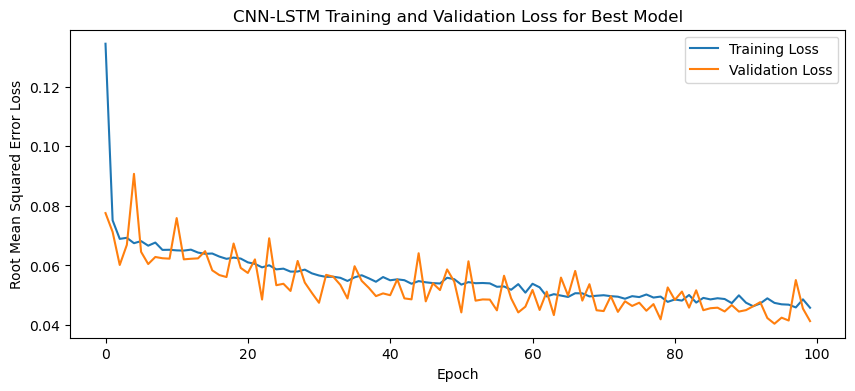

1/1 - 2s - loss: 0.0490 - 2s/epoch - 2s/step
Test Loss: 0.04904920980334282
1/1 [==============================] - 0s 39ms/step


NameError: name 'series' is not defined

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    filters = trial.suggest_categorical('filters', [256, 512, 1024]) # Used for CNN-LSTM model
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM Only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "CNN-LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "CNN-LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Specific Humidity\tPredicted Specific Humidity\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

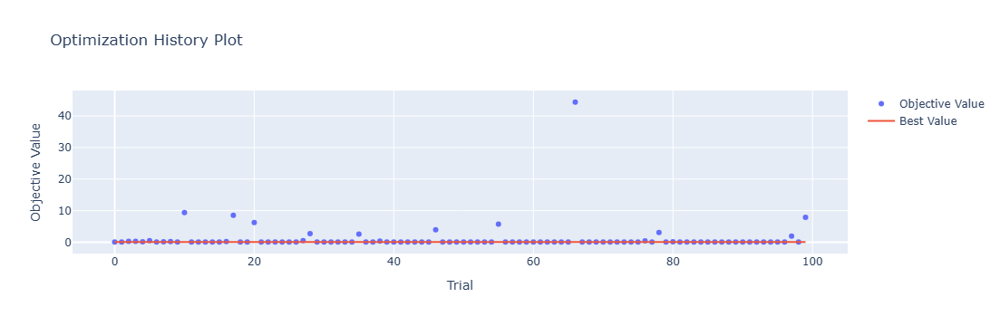

In [4]:
optuna.visualization.plot_optimization_history(study)

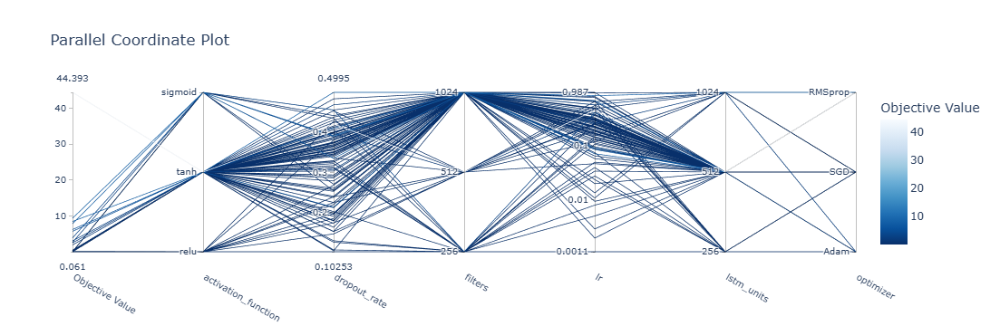

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

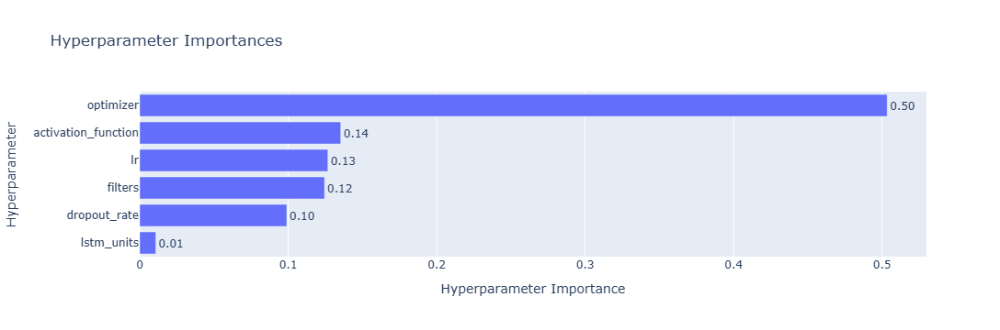

In [6]:
optuna.visualization.plot_param_importances(study)

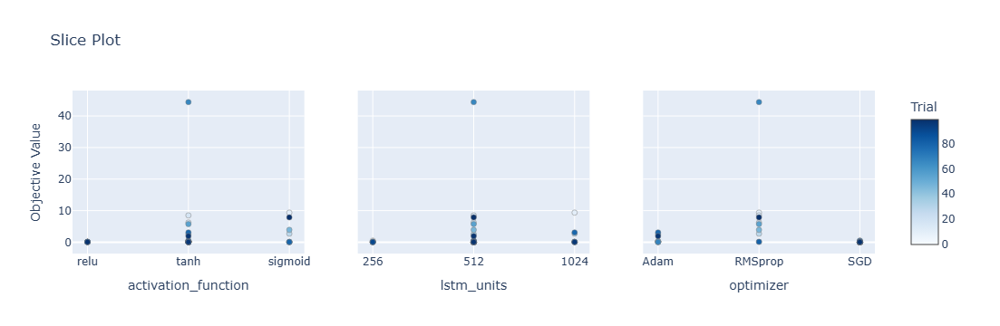

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

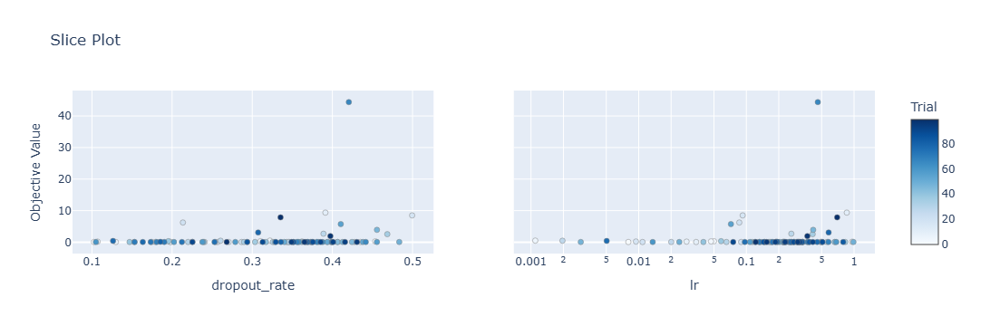

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

Epoch 1/100
84/84 [==============================] - 24s 92ms/step - loss: 0.1353 - accuracy: 0.1905 - mae: 0.1156 - rmse: 0.1353 - mape: 24.3760 - pearson: 0.5665 - val_loss: 0.0814 - val_accuracy: 0.0000e+00 - val_mae: 0.0641 - val_rmse: 0.0814 - val_mape: 14.4777 - val_pearson: 0.6063
Epoch 2/100
84/84 [==============================] - 3s 42ms/step - loss: 0.0770 - accuracy: 0.3095 - mae: 0.0609 - rmse: 0.0770 - mape: 13.6400 - pearson: 0.7259 - val_loss: 0.0671 - val_accuracy: 0.7000 - val_mae: 0.0529 - val_rmse: 0.0671 - val_mape: 11.2949 - val_pearson: 0.7713
Epoch 3/100
84/84 [==============================] - 3s 40ms/step - loss: 0.0706 - accuracy: 0.4167 - mae: 0.0557 - rmse: 0.0706 - mape: 12.4449 - pearson: 0.7538 - val_loss: 0.0654 - val_accuracy: 0.7000 - val_mae: 0.0500 - val_rmse: 0.0654 - val_mape: 10.6074 - val_pearson: 0.7727
Epoch 4/100
84/84 [==============================] - 3s 39ms/step - loss: 0.0687 - accuracy: 0.4048 - mae: 0.0541 - rmse: 0.0687 - mape: 12.148

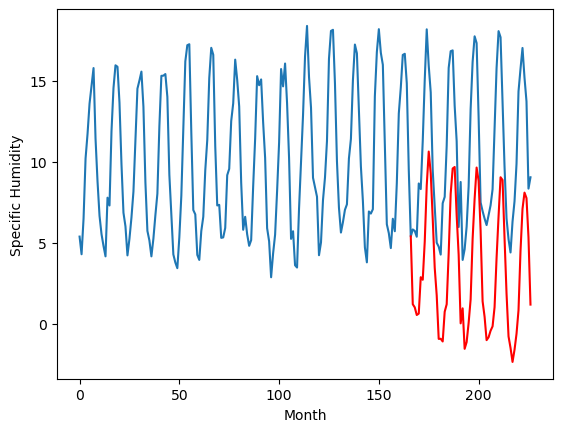

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.70		0.20		1.90
-1.37		0.36		1.73
-1.81		-0.39		1.42
-1.08		-0.02		1.06
2.80		2.16		-0.64
1.01		2.00		0.99
3.33		3.51		0.18
7.01		6.70		-0.31
8.67		7.98		-0.69
8.61		7.77		-0.84
6.51		5.63		-0.88
3.95		3.47		-0.48
0.62		0.93		0.31
-2.90		-2.55		0.35
-2.55		-2.43		0.12
-1.84		-1.77		0.07
0.37		-0.57		-0.94
0.59		-0.46		-1.05
3.08		2.37		-0.71
7.83		5.71		-2.12
8.63		7.13		-1.50
8.79		7.10		-1.69
6.63		5.09		-1.54
3.55		2.56		-0.99
-2.11		-1.44		0.67
1.53		0.26		-1.27
-3.23		-2.83		0.40
-2.01		-2.07		-0.06
-0.10		-1.03		-0.93
1.20		0.25		-0.95
5.44		3.43		-2.01
8.05		5.77		-2.28
8.95		7.64		-1.31
8.38		6.75		-1.63
5.32		4.16		-1.16
0.18		0.08		-0.10
-0.02		-0.59		-0.57
-1.22		-2.22		-1.00
-1.13		-2.23		-1.10
0.56		-1.29		-1.85
0.94		-1.28		-2.22
1.73		-0.12		-1.85
3.92		2.31		-1.61
7.25		4.57		-2.68
8.92		6.75		-2.17
9.70		6.90		-2.80
5.68		3.25		-2.43
0.98		-0.11		-1.09
-1.20		-2.40		-1.20
-

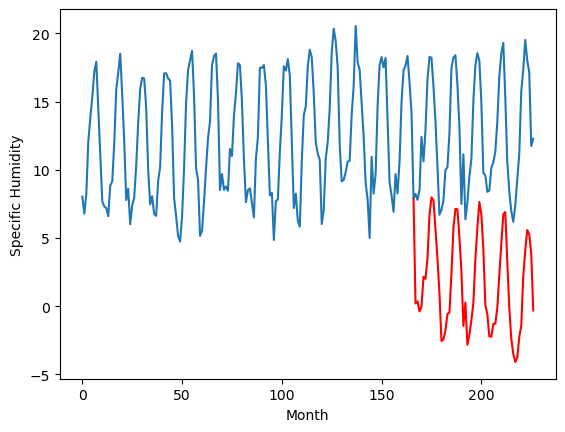

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.36		0.15		1.51
-1.11		0.19		1.30
-1.28		-0.47		0.81
-0.73		-0.21		0.52
1.87		1.90		0.03
0.62		1.75		1.13
3.48		3.71		0.23
7.39		7.18		-0.21
9.79		8.94		-0.85
9.88		8.28		-1.60
6.79		5.68		-1.11
4.04		3.17		-0.87
0.71		0.91		0.20
-2.45		-2.25		0.20
-2.07		-2.24		-0.17
-1.92		-1.91		0.01
-0.07		-0.47		-0.40
0.17		-0.12		-0.29
2.93		2.75		-0.18
7.55		6.47		-1.08
9.46		7.96		-1.50
9.66		8.13		-1.53
6.66		5.59		-1.07
3.94		3.15		-0.79
-1.93		-1.26		0.67
0.47		0.13		-0.34
-2.94		-2.69		0.25
-1.73		-2.02		-0.29
-1.02		-0.93		0.09
0.43		0.36		-0.07
4.57		3.90		-0.67
7.35		6.28		-1.07
9.55		8.37		-1.18
8.85		7.46		-1.39
5.12		4.63		-0.49
0.12		0.30		0.18
-0.20		-0.43		-0.23
-1.53		-2.09		-0.56
-1.16		-1.94		-0.78
-0.05		-1.28		-1.23
-0.69		-1.26		-0.57
0.75		0.05		-0.70
3.53		2.47		-1.06
6.11		5.01		-1.10
8.97		7.63		-1.34
9.06		7.55		-1.51
5.48		3.92		-1.56
1.57		0.48		-1.09
-0.96		-2.08		-1.12
-1

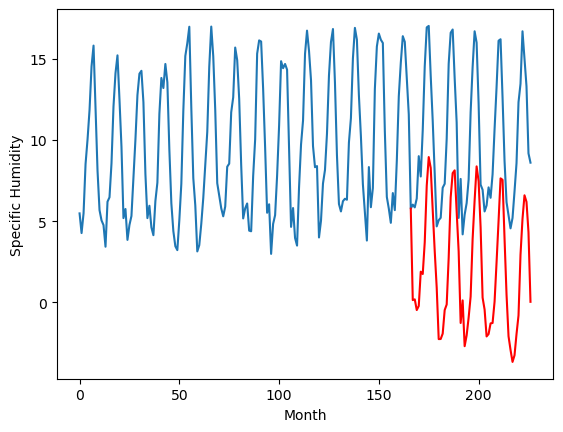

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.82		0.01		1.83
-1.28		0.03		1.31
-1.04		-0.61		0.43
-0.90		-0.32		0.58
3.41		2.06		-1.35
2.26		1.84		-0.42
4.41		3.55		-0.86
6.90		6.74		-0.16
9.65		8.17		-1.48
8.40		7.62		-0.78
7.05		5.42		-1.63
3.24		2.95		-0.29
0.19		0.64		0.45
-2.88		-2.70		0.18
-2.81		-2.56		0.25
-2.90		-2.13		0.77
0.55		-0.66		-1.21
1.12		-0.54		-1.66
4.63		2.55		-2.08
8.53		5.84		-2.69
9.37		7.27		-2.10
8.99		7.17		-1.82
6.68		4.93		-1.75
4.25		2.33		-1.92
-1.96		-1.62		0.34
1.09		-0.00		-1.09
-4.03		-3.10		0.93
-2.82		-2.44		0.38
-1.73		-1.36		0.37
1.19		0.10		-1.09
5.43		3.45		-1.98
7.44		5.85		-1.59
8.65		7.54		-1.11
7.93		6.70		-1.23
4.55		3.94		-0.61
-0.55		-0.22		0.33
-1.07		-0.96		0.11
-1.57		-2.49		-0.92
-1.38		-2.54		-1.16
-0.71		-1.62		-0.91
0.37		-1.46		-1.83
0.77		-0.42		-1.19
3.62		2.46		-1.16
7.77		4.76		-3.01
8.80		6.73		-2.07
8.55		6.85		-1.70
6.37		3.15		-3.22
1.80		-0.27		-2.07
-1.19		-2.58		-1.39

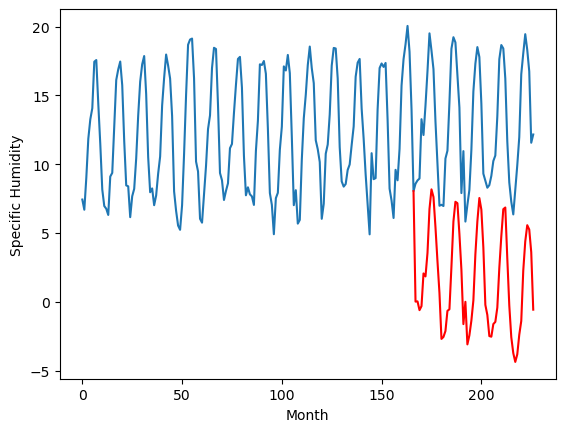

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.25		2.59		0.34
1.00		2.28		1.28
1.79		1.90		0.11
1.18		1.91		0.73
5.63		4.24		-1.39
5.35		4.14		-1.21
7.93		6.37		-1.56
10.29		9.45		-0.84
13.15		11.33		-1.82
10.88		9.83		-1.05
9.57		7.29		-2.28
5.29		4.19		-1.10
3.44		2.86		-0.58
0.66		0.46		-0.20
0.59		0.56		-0.03
0.19		0.23		0.04
3.03		2.08		-0.95
4.43		2.45		-1.98
8.44		5.75		-2.69
12.13		8.89		-3.24
12.84		10.49		-2.35
12.76		10.26		-2.50
8.53		7.42		-1.11
6.44		4.96		-1.48
2.22		1.51		-0.71
4.98		2.08		-2.90
-0.52		-0.17		0.35
-0.26		0.01		0.27
1.29		1.24		-0.05
5.21		2.74		-2.47
8.91		6.15		-2.76
9.88		8.67		-1.21
9.64		10.23		0.59
10.73		9.57		-1.16
7.90		6.61		-1.29
3.10		2.63		-0.47
3.09		1.42		-1.67
2.01		0.26		-1.75
1.25		0.31		-0.94
1.59		0.64		-0.95
3.78		1.16		-2.62
4.54		2.08		-2.46
8.48		5.61		-2.87
12.60		7.84		-4.76
11.18		9.56		-1.62
9.36		9.61		0.25
9.32		6.13		-3.19
5.57		2.91		-2.66
2.77		0.52		-2.25
0.91		-0.27		-1.

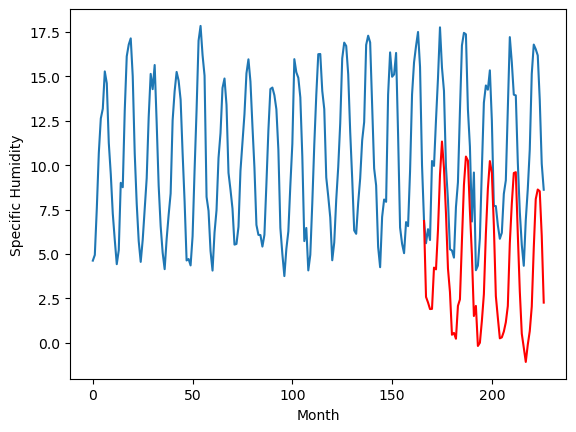

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.59		4.10		1.51
2.55		4.13		1.58
2.07		3.50		1.43
1.96		3.68		1.72
3.72		5.55		1.83
4.06		5.52		1.46
7.19		7.57		0.38
10.92		11.03		0.11
14.40		12.93		-1.47
14.43		12.13		-2.30
11.53		9.38		-2.15
7.83		6.85		-0.98
4.88		4.83		-0.05
1.12		2.00		0.88
0.51		1.94		1.43
1.10		2.12		1.02
2.67		3.49		0.82
3.68		3.97		0.29
6.18		6.66		0.48
11.44		10.44		-1.00
12.56		12.02		-0.54
13.72		12.24		-1.48
9.63		9.59		-0.04
7.31		7.31		-0.00
2.05		3.00		0.95
3.47		3.95		0.48
0.36		1.58		1.22
1.74		2.12		0.38
3.07		3.25		0.18
4.20		4.36		0.16
8.98		7.83		-1.15
10.07		10.18		0.11
14.40		12.44		-1.96
12.61		11.57		-1.04
9.91		8.78		-1.13
5.27		4.60		-0.67
4.61		3.71		-0.90
1.26		2.12		0.86
2.01		2.39		0.38
2.94		2.74		-0.20
2.72		2.78		0.06
5.40		4.18		-1.22
6.16		6.41		0.25
10.06		8.92		-1.14
14.41		11.76		-2.65
13.52		11.62		-1.90
10.40		8.17		-2.23
6.00		4.87		-1.13
2.98		2.24		-0.74
2.16		1.67		-0.49
1.37	

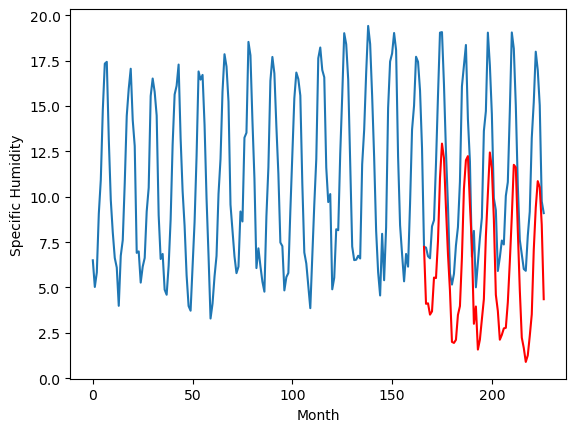

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.36		1.54		1.18
0.48		1.52		1.04
0.40		0.92		0.52
0.76		1.08		0.32
2.39		3.03		0.64
2.17		2.96		0.79
5.27		5.09		-0.18
8.99		8.60		-0.39
11.78		10.57		-1.21
11.72		9.66		-2.06
8.19		6.86		-1.33
5.47		4.22		-1.25
2.62		2.24		-0.38
-0.25		-0.57		-0.32
-0.40		-0.62		-0.22
-0.35		-0.52		-0.17
1.24		0.96		-0.28
1.84		1.46		-0.38
4.84		4.23		-0.61
9.22		8.04		-1.18
10.66		9.60		-1.06
11.19		9.83		-1.36
7.87		7.08		-0.79
5.76		4.78		-0.98
0.01		0.40		0.39
1.85		1.38		-0.47
-0.93		-1.04		-0.11
0.35		-0.51		-0.86
1.36		0.63		-0.73
2.36		1.81		-0.55
6.72		5.37		-1.35
8.60		7.74		-0.86
12.22		9.98		-2.24
10.87		9.10		-1.77
7.43		6.24		-1.19
2.87		1.97		-0.90
2.27		1.09		-1.18
0.09		-0.49		-0.58
0.95		-0.23		-1.18
1.63		0.14		-1.49
1.22		0.21		-1.01
3.43		1.59		-1.84
5.02		3.94		-1.08
7.75		6.50		-1.25
11.49		9.32		-2.17
11.12		9.15		-1.97
8.18		5.65		-2.53
3.92		2.30		-1.62
0.59		-0.35		-0.94
0.52		-0.

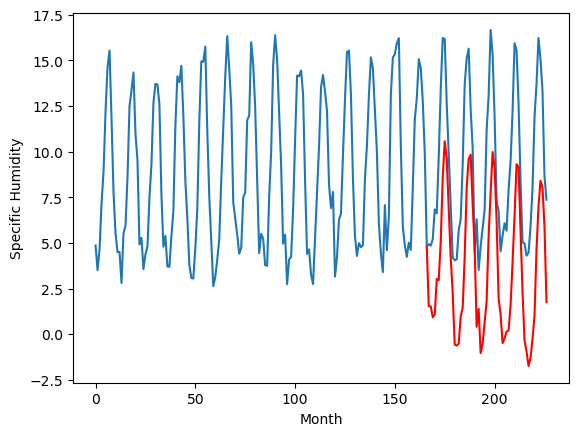

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.52		3.67		1.15
2.77		3.61		0.84
2.80		3.06		0.26
3.02		3.15		0.13
4.32		4.94		0.62
4.26		4.93		0.67
6.25		7.27		1.02
10.92		10.88		-0.04
13.73		13.09		-0.64
13.97		11.96		-2.01
10.07		8.91		-1.16
7.36		6.14		-1.22
4.82		4.37		-0.45
1.95		1.83		-0.12
1.64		1.71		0.07
1.67		1.61		-0.06
3.29		3.14		-0.15
3.99		3.79		-0.20
7.01		6.48		-0.53
11.28		10.47		-0.81
12.78		12.10		-0.68
13.06		12.44		-0.62
9.57		9.44		-0.13
7.69		7.24		-0.45
1.90		2.76		0.86
3.67		3.42		-0.25
1.16		1.32		0.16
2.39		1.76		-0.63
3.38		2.92		-0.46
4.28		4.02		-0.26
8.57		7.68		-0.89
10.02		10.05		0.03
13.39		12.46		-0.93
12.32		11.59		-0.73
9.53		8.66		-0.87
5.11		4.37		-0.74
4.41		3.39		-1.02
2.07		1.84		-0.23
3.00		2.22		-0.78
3.36		2.34		-1.02
3.28		2.40		-0.88
5.56		3.89		-1.67
6.88		6.13		-0.75
9.50		8.78		-0.72
13.85		11.89		-1.96
12.79		11.60		-1.19
9.99		8.19		-1.80
6.24		4.88		-1.36
2.72		2.09		-0.63
2.92		1.74	

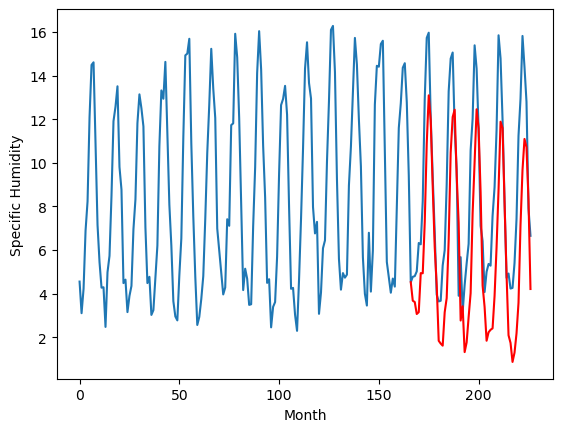

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.35		1.38		0.03
1.44		1.13		-0.31
1.04		0.71		-0.33
1.03		0.66		-0.37
3.29		2.60		-0.69
3.53		2.58		-0.95
6.75		5.21		-1.54
10.40		8.80		-1.60
13.49		11.24		-2.25
11.46		9.59		-1.87
8.74		6.40		-2.34
4.29		3.21		-1.08
2.53		1.89		-0.64
0.62		-0.32		-0.94
0.39		-0.43		-0.82
-0.29		-0.89		-0.60
2.77		0.95		-1.82
3.50		1.67		-1.83
6.41		4.62		-1.79
11.39		8.54		-2.85
12.89		10.22		-2.67
13.08		10.47		-2.61
9.27		7.15		-2.12
6.85		4.92		-1.93
1.56		0.61		-0.95
3.15		0.94		-2.21
-0.13		-0.97		-0.84
0.46		-0.71		-1.17
2.14		0.53		-1.61
3.72		1.78		-1.94
7.91		5.58		-2.33
10.09		8.04		-2.05
13.75		10.26		-3.49
12.78		9.47		-3.31
8.33		6.37		-1.96
3.10		2.04		-1.06
2.10		0.90		-1.20
1.17		-0.49		-1.66
1.77		-0.12		-1.89
1.84		-0.16		-2.00
2.28		0.11		-2.17
3.50		1.47		-2.03
6.99		4.26		-2.73
9.27		6.94		-2.33
12.82		9.78		-3.04
12.82		9.47		-3.35
8.75		6.06		-2.69
4.69		2.75		-1.94
2.03		-0.08		-2.1

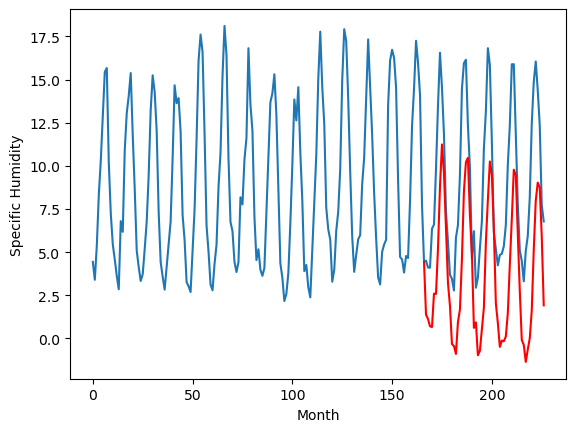

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.84		3.37		0.53
3.25		3.21		-0.04
2.75		2.76		0.01
2.43		2.69		0.26
4.39		4.20		-0.19
4.45		4.32		-0.13
7.59		6.89		-0.70
10.28		10.50		0.22
13.42		13.01		-0.41
12.20		11.51		-0.69
9.41		8.17		-1.24
6.07		5.20		-0.87
4.02		3.92		-0.10
2.36		1.96		-0.40
2.03		1.74		-0.29
1.58		1.29		-0.29
3.38		2.85		-0.53
4.70		3.72		-0.98
6.79		6.24		-0.55
11.56		10.33		-1.23
12.49		12.08		-0.41
12.91		12.48		-0.43
9.74		9.19		-0.55
8.43		7.21		-1.22
2.91		2.89		-0.02
3.75		2.85		-0.90
1.46		1.41		-0.05
2.20		1.62		-0.58
3.48		2.85		-0.63
5.10		3.77		-1.33
9.71		7.40		-2.31
11.39		9.77		-1.62
14.97		12.36		-2.61
13.43		11.58		-1.85
10.37		8.64		-1.73
4.58		4.49		-0.09
3.86		3.25		-0.61
2.93		1.85		-1.08
3.54		2.40		-1.14
3.31		2.05		-1.26
3.41		2.19		-1.22
5.14		3.75		-1.39
7.58		5.91		-1.67
10.20		8.55		-1.65
14.02		11.88		-2.14
12.72		11.50		-1.22
10.00		8.31		-1.69
6.76		5.18		-1.58
3.41		2.25		-1.16
3.

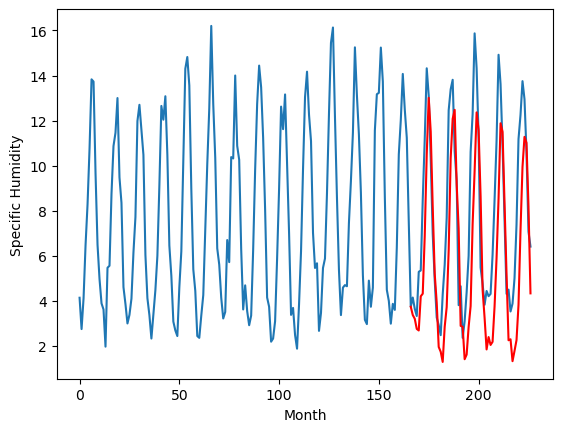

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.21		1.94		0.73
1.33		1.76		0.43
0.95		1.33		0.38
0.44		1.22		0.78
2.04		2.61		0.57
2.40		2.78		0.38
5.30		5.38		0.08
8.40		8.98		0.58
11.45		11.54		0.09
9.88		9.98		0.10
7.22		6.56		-0.66
3.77		3.60		-0.17
2.36		2.45		0.09
0.83		0.67		-0.16
0.45		0.42		-0.03
-0.29		-0.11		0.18
1.33		1.40		0.07
2.93		2.34		-0.59
4.45		4.77		0.32
9.58		8.86		-0.72
10.65		10.66		0.01
11.14		11.07		-0.07
7.52		7.73		0.21
6.53		5.83		-0.70
1.68		1.60		-0.08
1.68		1.34		-0.34
-0.39		0.12		0.51
0.21		0.25		0.04
1.46		1.50		0.04
2.40		2.33		-0.07
6.12		5.91		-0.21
7.39		8.26		0.87
9.88		10.94		1.06
10.87		10.19		-0.68
8.27		7.28		-0.99
3.25		3.22		-0.03
2.11		1.88		-0.23
0.94		0.52		-0.42
1.34		1.13		-0.21
0.78		0.62		-0.16
1.24		0.77		-0.47
2.88		2.38		-0.50
4.09		4.44		0.35
7.10		7.05		-0.05
10.93		10.46		-0.47
10.18		10.07		-0.11
8.87		6.97		-1.90
5.11		3.91		-1.20
1.70		0.96		-0.74
2.23		1.14		-1.09
0.71		0.15

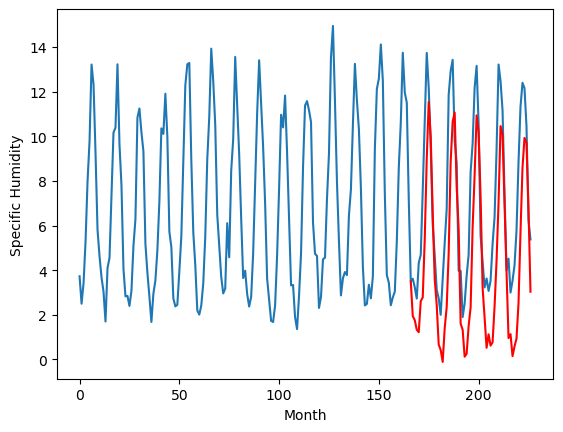

RangeIndex(start=1, stop=12, step=1)
[0.7500000000000009, -1.7000000000000002, -1.3600000000000003, -1.8200000000000012, 2.2500000000000004, 2.59, 0.3600000000000003, 2.5199999999999996, 1.3499999999999996, 2.84, 1.21]
[1.2160354709625247, 0.19938974380493146, 0.1477655792236332, 0.011782779693603196, 2.5877488994598385, 4.099480180740356, 1.5355322170257573, 3.6733326244354245, 1.3806494522094725, 3.373312473297119, 1.9427717781066898]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.75   1.216035
1                 1   -1.70   0.199390
2                 2   -1.36   0.147766
3                 3   -1.82   0.011783
4                 4    2.25   2.587749
5                 5    2.59   4.099480
6                 6    0.36   1.535532
7                 7    2.52   3.673333
8                 8    1.35   1.380649
9                 9    2.84   3.373312
10               10    1.21   1.942772


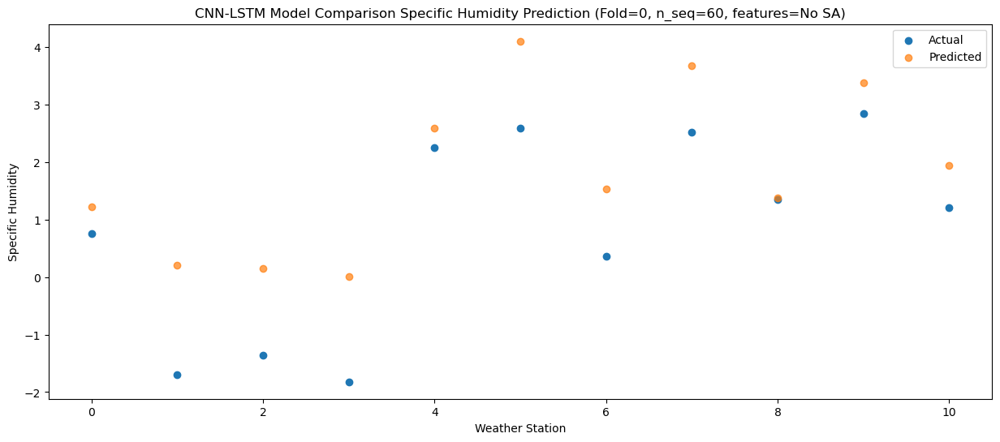

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.18   1.021220
1                 1   -1.37   0.358048
2                 2   -1.11   0.193818
3                 3   -1.28   0.028711
4                 4    1.00   2.275905
5                 5    2.55   4.128410
6                 6    0.48   1.520520
7                 7    2.77   3.610938
8                 8    1.44   1.127861
9                 9    3.25   3.207883
10               10    1.33   1.763536


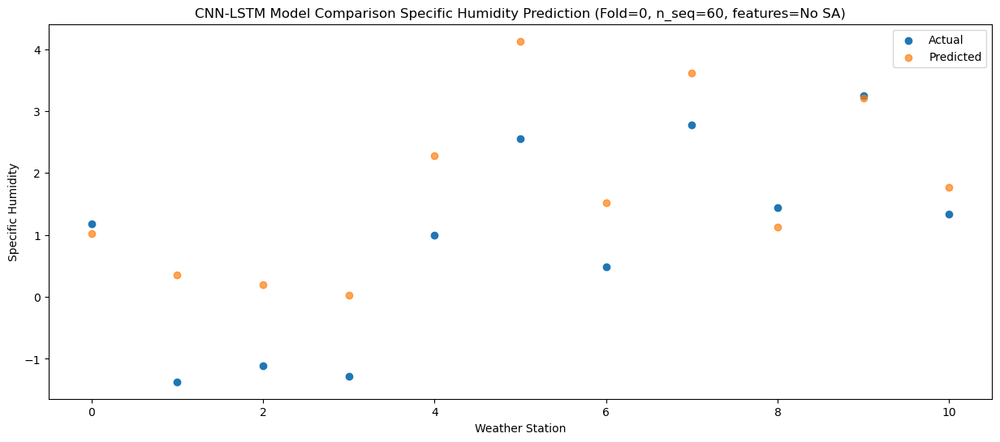

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.09   0.551770
1                 1   -1.81  -0.388149
2                 2   -1.28  -0.465122
3                 3   -1.04  -0.608827
4                 4    1.79   1.904325
5                 5    2.07   3.504185
6                 6    0.40   0.924337
7                 7    2.80   3.062460
8                 8    1.04   0.705190
9                 9    2.75   2.756986
10               10    0.95   1.333568


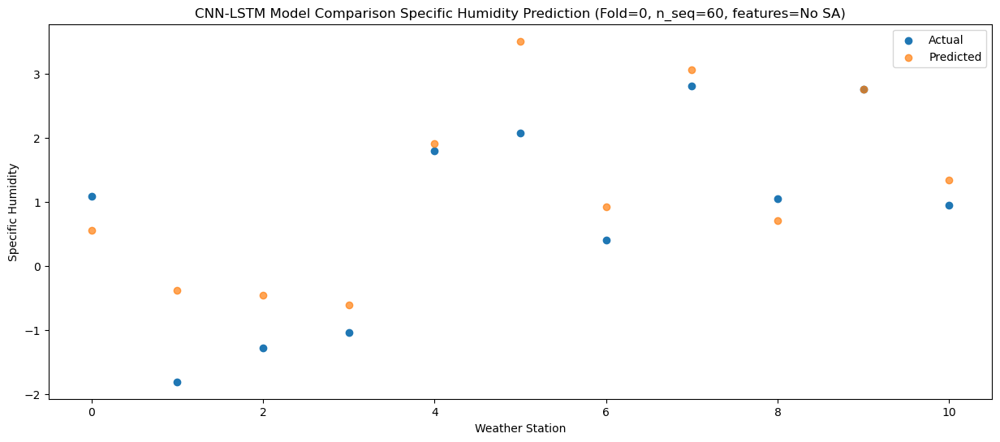

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.73   0.636174
1                 1   -1.08  -0.024449
2                 2   -0.73  -0.214459
3                 3   -0.90  -0.316168
4                 4    1.18   1.914267
5                 5    1.96   3.682720
6                 6    0.76   1.084965
7                 7    3.02   3.147713
8                 8    1.03   0.663981
9                 9    2.43   2.687709
10               10    0.44   1.221930


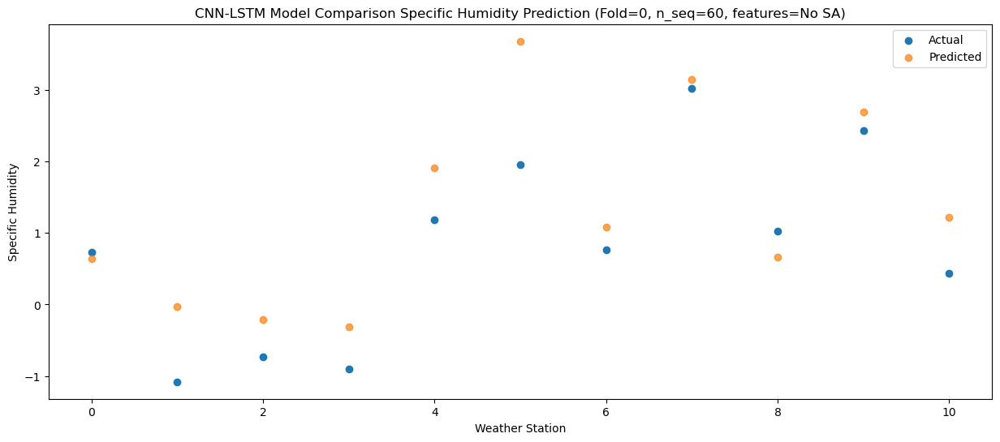

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    4.02   2.883948
1                 1    2.80   2.155226
2                 2    1.87   1.895759
3                 3    3.41   2.060476
4                 4    5.63   4.237357
5                 5    3.72   5.548314
6                 6    2.39   3.027127
7                 7    4.32   4.938245
8                 8    3.29   2.600485
9                 9    4.39   4.203883
10               10    2.04   2.612005


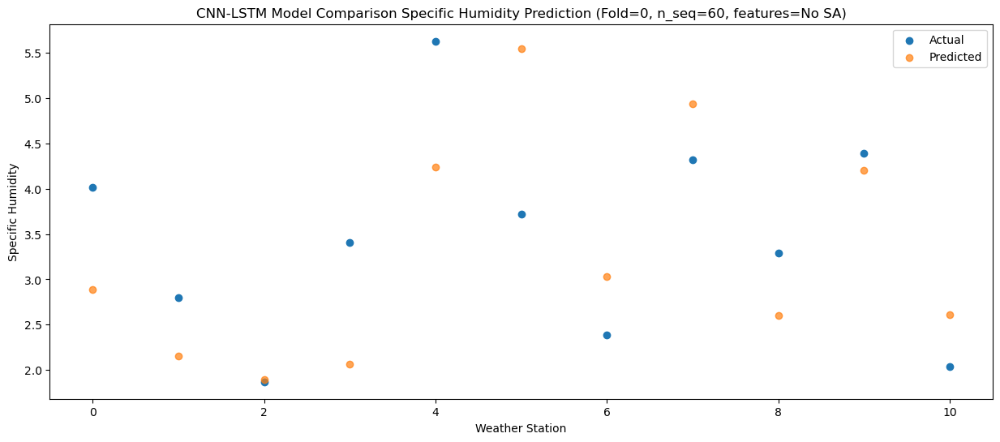

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.67   2.725334
1                 1    1.01   2.000542
2                 2    0.62   1.751760
3                 3    2.26   1.841562
4                 4    5.35   4.139073
5                 5    4.06   5.519508
6                 6    2.17   2.961204
7                 7    4.26   4.930277
8                 8    3.53   2.581301
9                 9    4.45   4.320410
10               10    2.40   2.782259


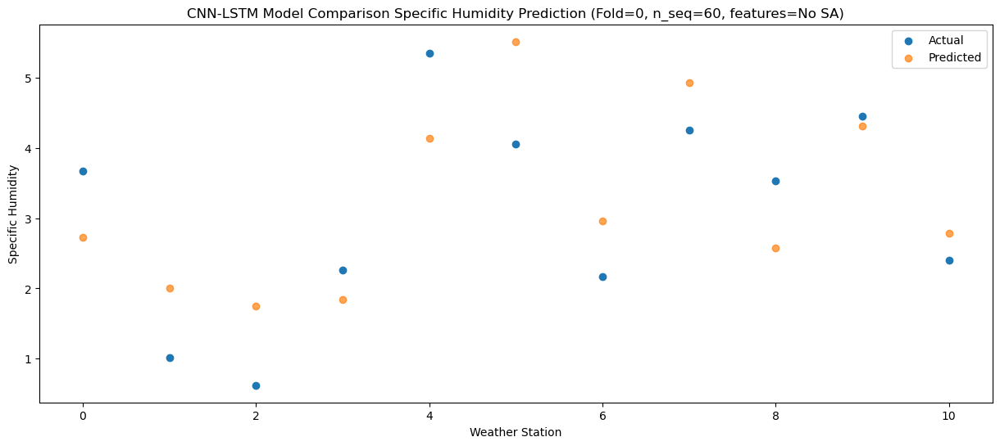

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.64   5.078400
1                 1    3.33   3.508323
2                 2    3.48   3.706568
3                 3    4.41   3.550963
4                 4    7.93   6.369224
5                 5    7.19   7.565093
6                 6    5.27   5.092902
7                 7    6.25   7.267320
8                 8    6.75   5.205493
9                 9    7.59   6.890373
10               10    5.30   5.383024


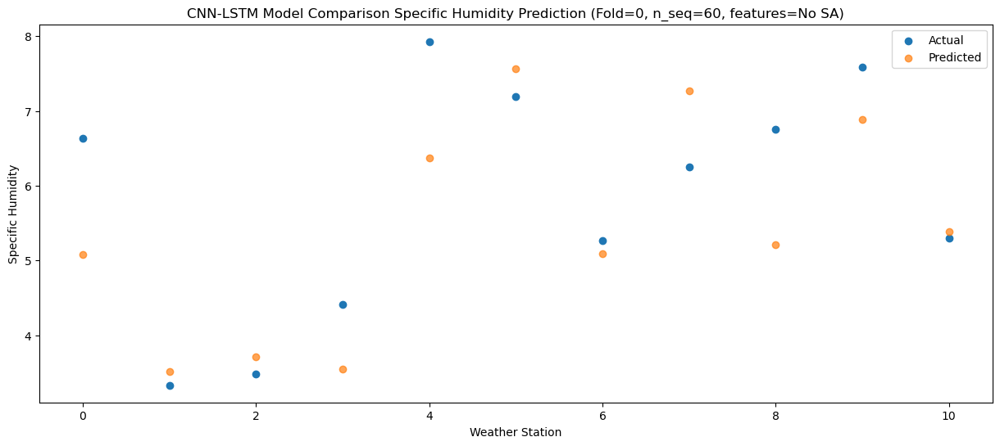

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   10.40   8.544028
1                 1    7.01   6.702768
2                 2    7.39   7.181954
3                 3    6.90   6.744390
4                 4   10.29   9.452302
5                 5   10.92  11.032047
6                 6    8.99   8.598945
7                 7   10.92  10.875822
8                 8   10.40   8.803359
9                 9   10.28  10.503880
10               10    8.40   8.977694


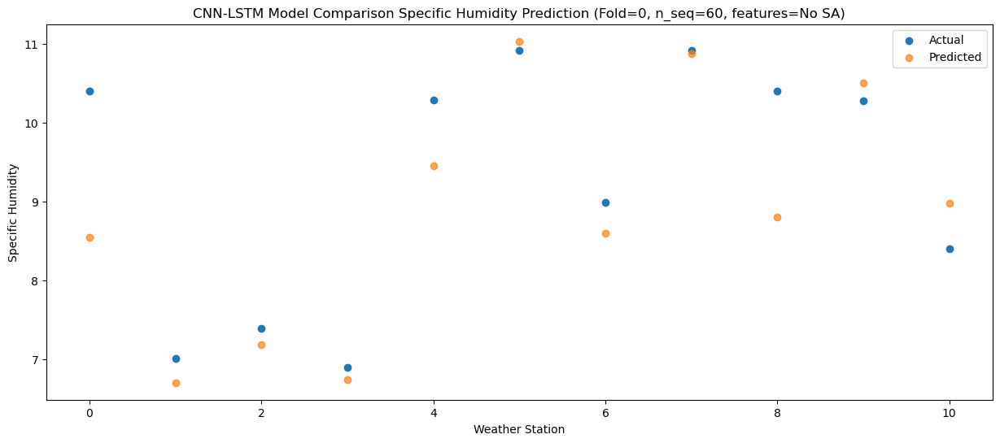

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.53  10.637513
1                 1    8.67   7.976024
2                 2    9.79   8.944186
3                 3    9.65   8.171576
4                 4   13.15  11.332977
5                 5   14.40  12.932502
6                 6   11.78  10.568936
7                 7   13.73  13.094819
8                 8   13.49  11.242566
9                 9   13.42  13.009590
10               10   11.45  11.540014


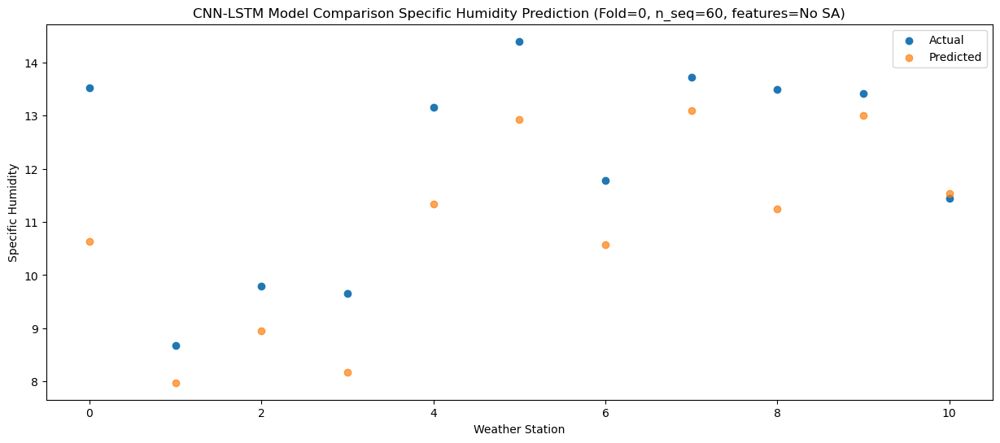

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   11.28   9.304862
1                 1    8.61   7.768111
2                 2    9.88   8.275267
3                 3    8.40   7.615832
4                 4   10.88   9.829061
5                 5   14.43  12.133848
6                 6   11.72   9.659377
7                 7   13.97  11.959185
8                 8   11.46   9.588025
9                 9   12.20  11.507723
10               10    9.88   9.977402


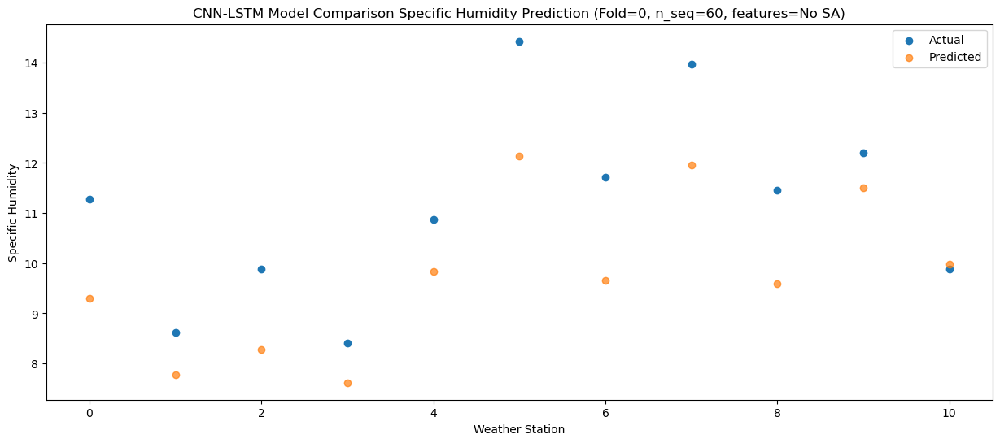

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    9.64   6.499500
1                 1    6.51   5.626056
2                 2    6.79   5.684473
3                 3    7.05   5.418078
4                 4    9.57   7.291913
5                 5   11.53   9.380178
6                 6    8.19   6.861056
7                 7   10.07   8.914522
8                 8    8.74   6.403445
9                 9    9.41   8.165807
10               10    7.22   6.564753


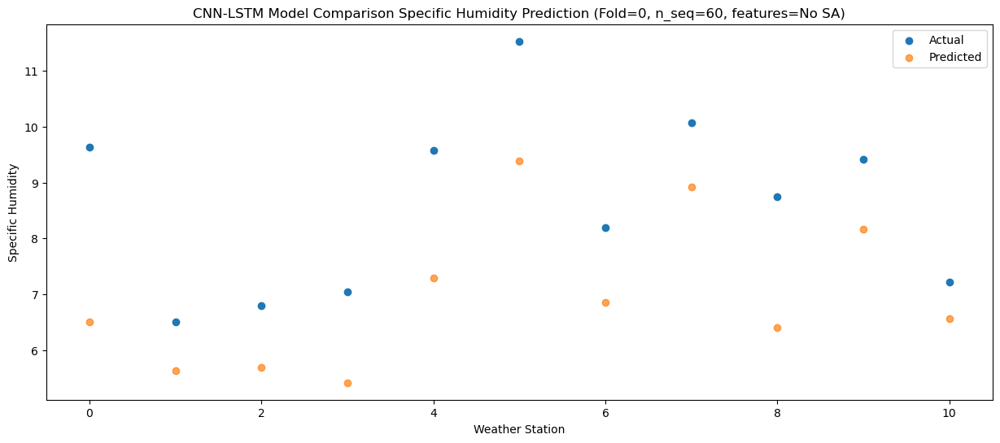

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.83   3.469804
1                 1    3.95   3.471531
2                 2    4.04   3.166837
3                 3    3.24   2.953596
4                 4    5.29   4.187951
5                 5    7.83   6.845321
6                 6    5.47   4.216929
7                 7    7.36   6.136715
8                 8    4.29   3.214465
9                 9    6.07   5.204227
10               10    3.77   3.602398


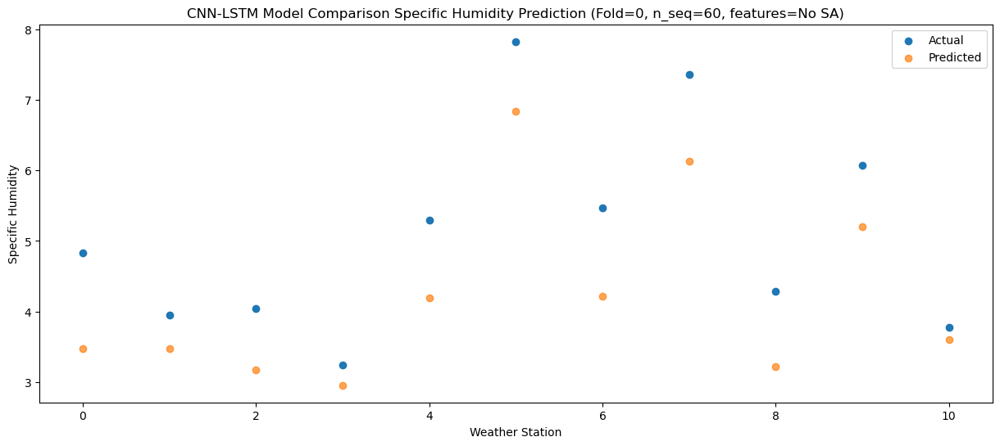

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    2.59   1.764572
1                 1    0.62   0.931925
2                 2    0.71   0.907703
3                 3    0.19   0.637461
4                 4    3.44   2.861473
5                 5    4.88   4.829753
6                 6    2.62   2.241191
7                 7    4.82   4.370497
8                 8    2.53   1.892474
9                 9    4.02   3.919960
10               10    2.36   2.447447


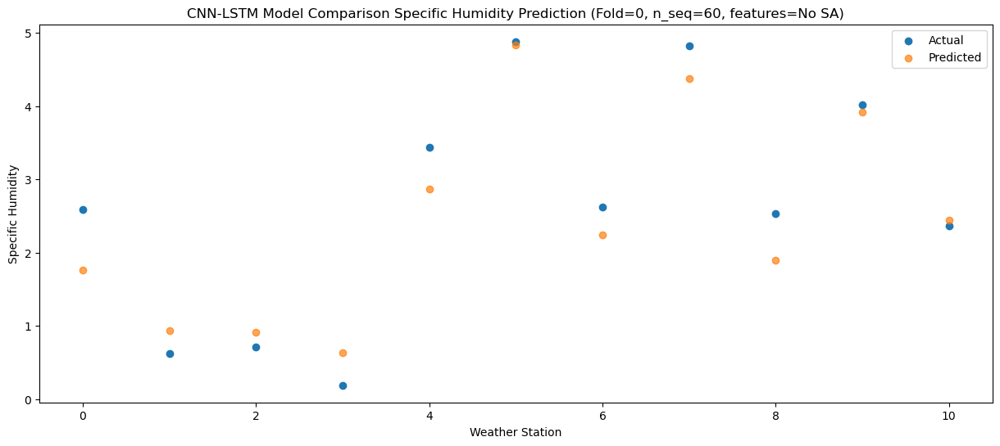

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.36  -0.923662
1                 1   -2.90  -2.547591
2                 2   -2.45  -2.252207
3                 3   -2.88  -2.699556
4                 4    0.66   0.457993
5                 5    1.12   2.002920
6                 6   -0.25  -0.570804
7                 7    1.95   1.834571
8                 8    0.62  -0.323469
9                 9    2.36   1.957231
10               10    0.83   0.665574


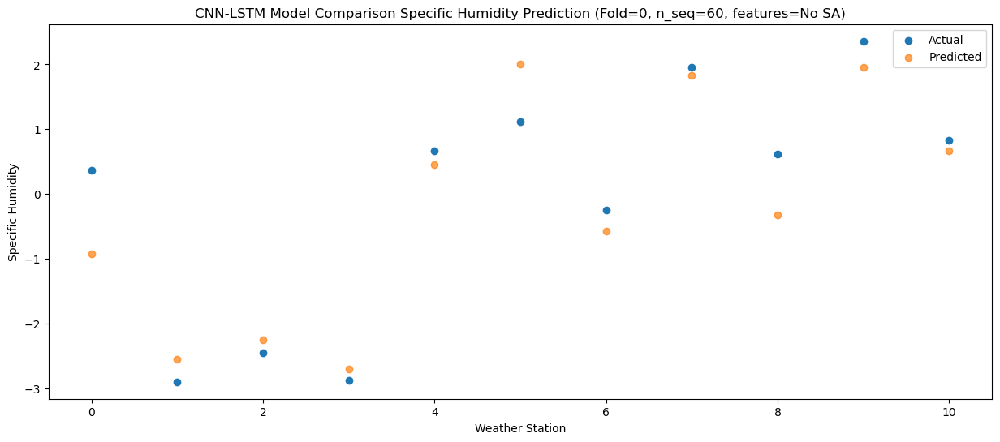

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    0.12  -0.916076
1                 1   -2.55  -2.434553
2                 2   -2.07  -2.244474
3                 3   -2.81  -2.558540
4                 4    0.59   0.561787
5                 5    0.51   1.944019
6                 6   -0.40  -0.624997
7                 7    1.64   1.705547
8                 8    0.39  -0.434886
9                 9    2.03   1.743096
10               10    0.45   0.423218


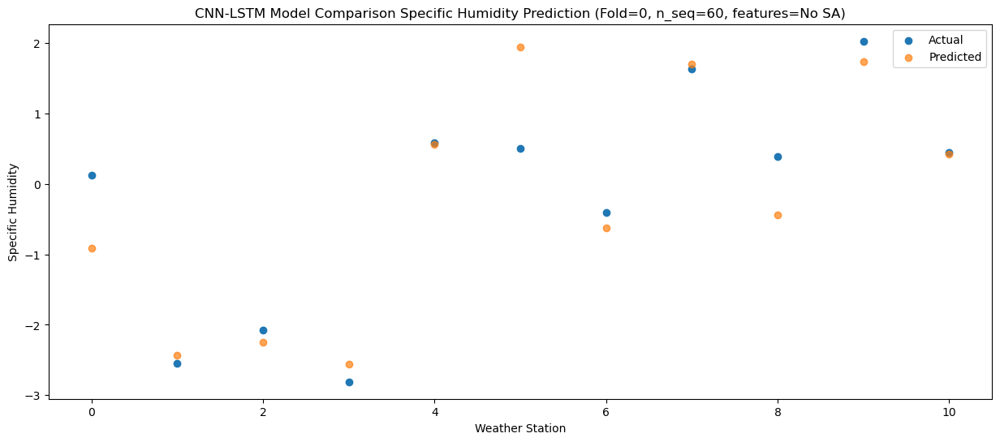

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.37  -1.082342
1                 1   -1.84  -1.765803
2                 2   -1.92  -1.913716
3                 3   -2.90  -2.125230
4                 4    0.19   0.233762
5                 5    1.10   2.115924
6                 6   -0.35  -0.519740
7                 7    1.67   1.609955
8                 8   -0.29  -0.894705
9                 9    1.58   1.292370
10               10   -0.29  -0.110124


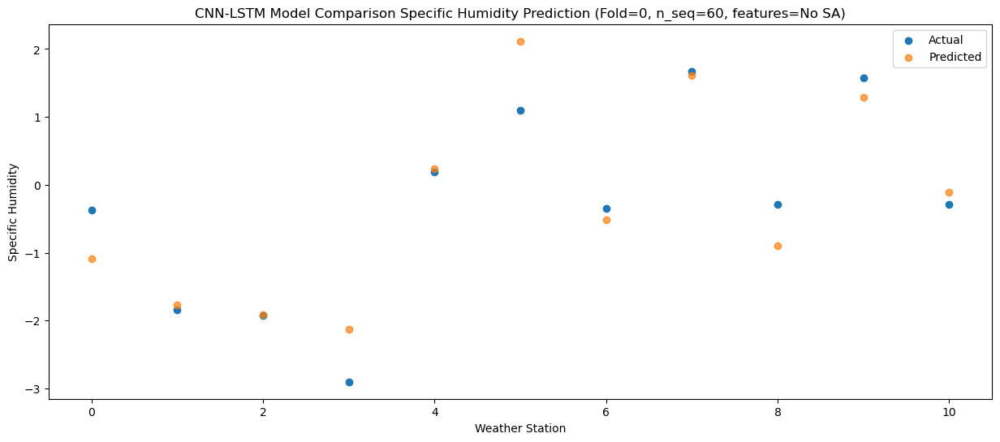

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.80   0.752247
1                 1    0.37  -0.571585
2                 2   -0.07  -0.465165
3                 3    0.55  -0.661547
4                 4    3.03   2.083152
5                 5    2.67   3.489094
6                 6    1.24   0.960485
7                 7    3.29   3.142035
8                 8    2.77   0.950156
9                 9    3.38   2.847214
10               10    1.33   1.398791


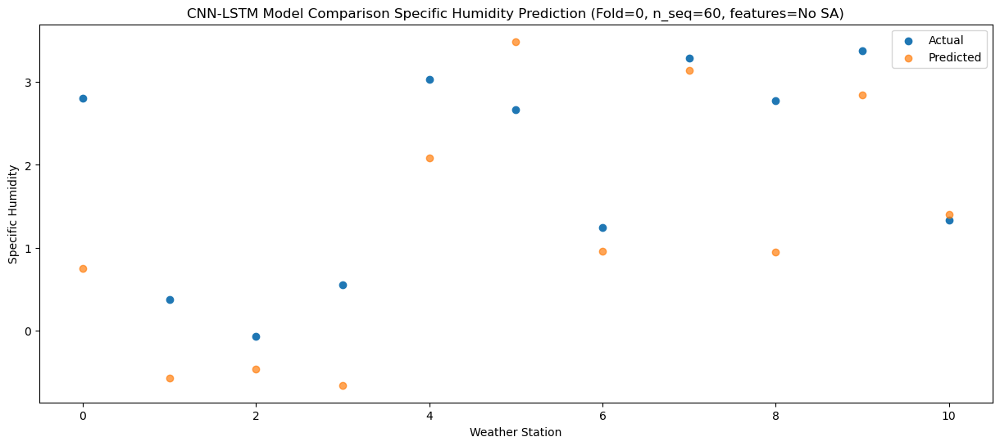

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.19   1.213506
1                 1    0.59  -0.461706
2                 2    0.17  -0.122337
3                 3    1.12  -0.544933
4                 4    4.43   2.448536
5                 5    3.68   3.974407
6                 6    1.84   1.455174
7                 7    3.99   3.792471
8                 8    3.50   1.669797
9                 9    4.70   3.723508
10               10    2.93   2.342671


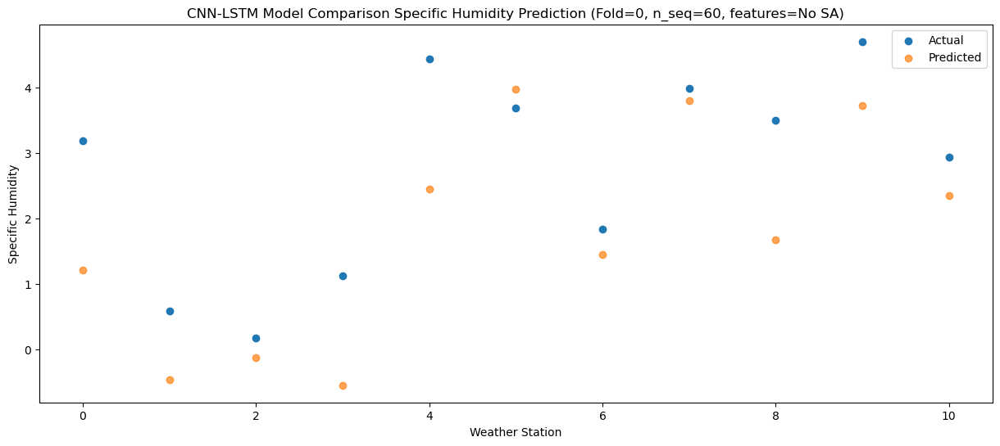

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    6.34   4.366991
1                 1    3.08   2.368649
2                 2    2.93   2.750807
3                 3    4.63   2.548123
4                 4    8.44   5.746922
5                 5    6.18   6.656667
6                 6    4.84   4.226272
7                 7    7.01   6.475754
8                 8    6.41   4.624167
9                 9    6.79   6.241159
10               10    4.45   4.768603


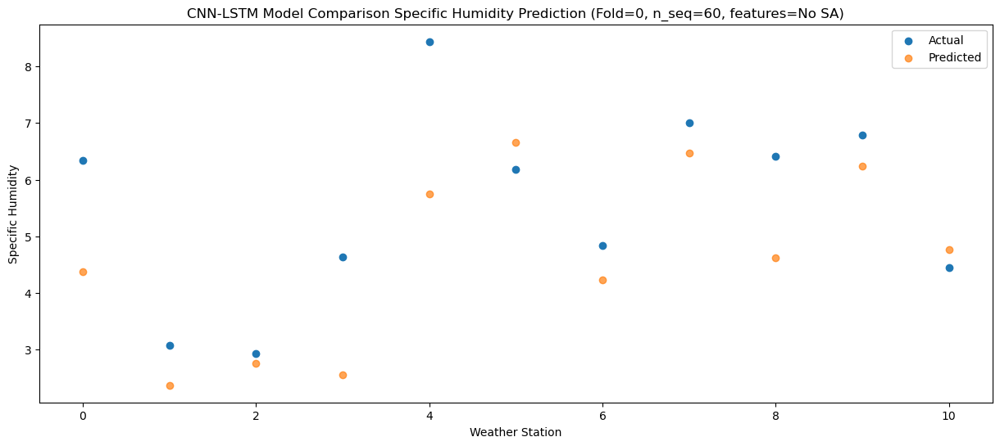

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.15   8.033456
1                 1    7.83   5.708169
2                 2    7.55   6.468649
3                 3    8.53   5.835342
4                 4   12.13   8.886515
5                 5   11.44  10.444389
6                 6    9.22   8.039604
7                 7   11.28  10.469325
8                 8   11.39   8.540478
9                 9   11.56  10.326620
10               10    9.58   8.864451


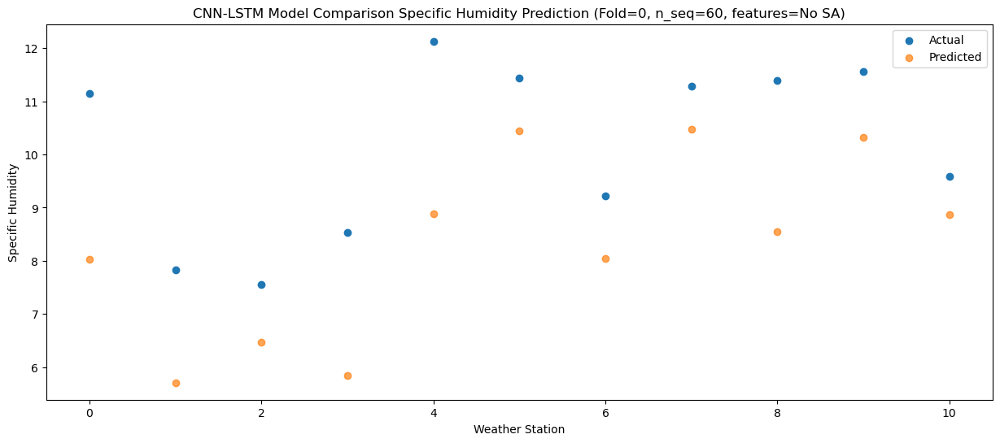

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.18   9.590474
1                 1    8.63   7.133155
2                 2    9.46   7.956730
3                 3    9.37   7.267157
4                 4   12.84  10.487588
5                 5   12.56  12.017895
6                 6   10.66   9.603147
7                 7   12.78  12.099218
8                 8   12.89  10.218305
9                 9   12.49  12.080355
10               10   10.65  10.659953


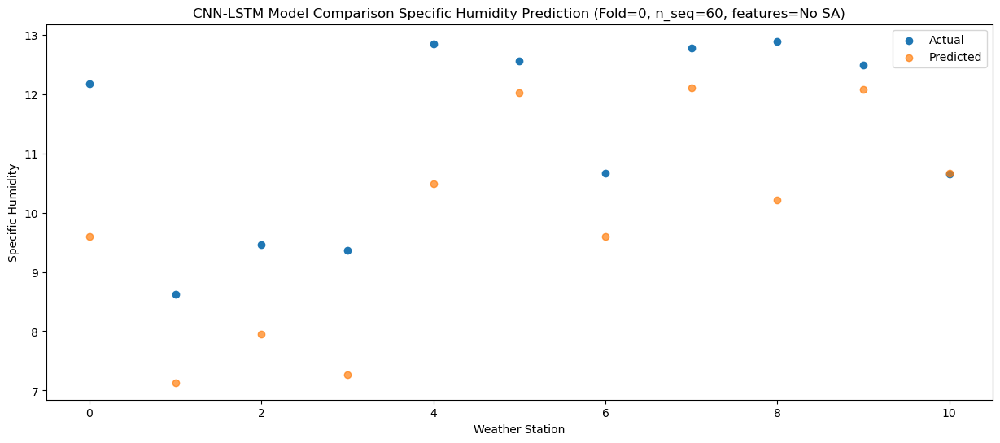

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.23   9.685455
1                 1    8.79   7.100161
2                 2    9.66   8.126374
3                 3    8.99   7.167337
4                 4   12.76  10.257218
5                 5   13.72  12.242720
6                 6   11.19   9.833669
7                 7   13.06  12.435648
8                 8   13.08  10.468898
9                 9   12.91  12.476530
10               10   11.14  11.070711


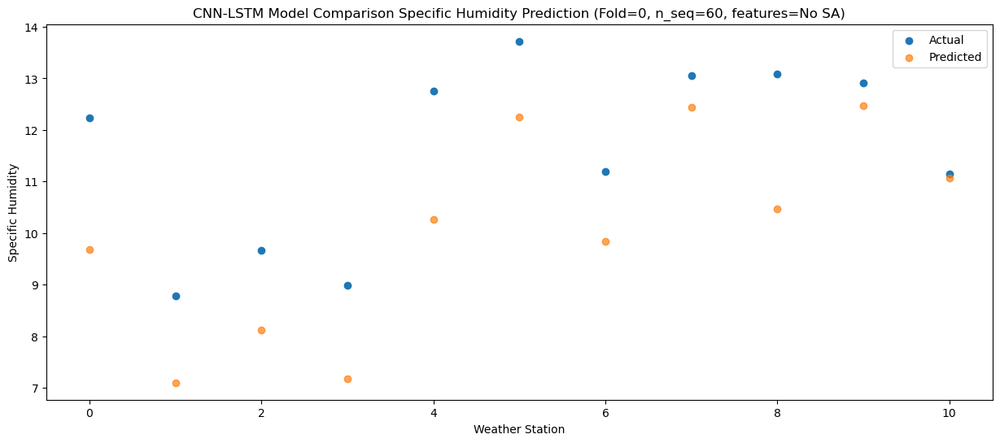

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.81   6.700919
1                 1    6.63   5.091040
2                 2    6.66   5.589631
3                 3    6.68   4.927593
4                 4    8.53   7.424395
5                 5    9.63   9.594480
6                 6    7.87   7.084683
7                 7    9.57   9.440008
8                 8    9.27   7.152027
9                 9    9.74   9.188296
10               10    7.52   7.731827


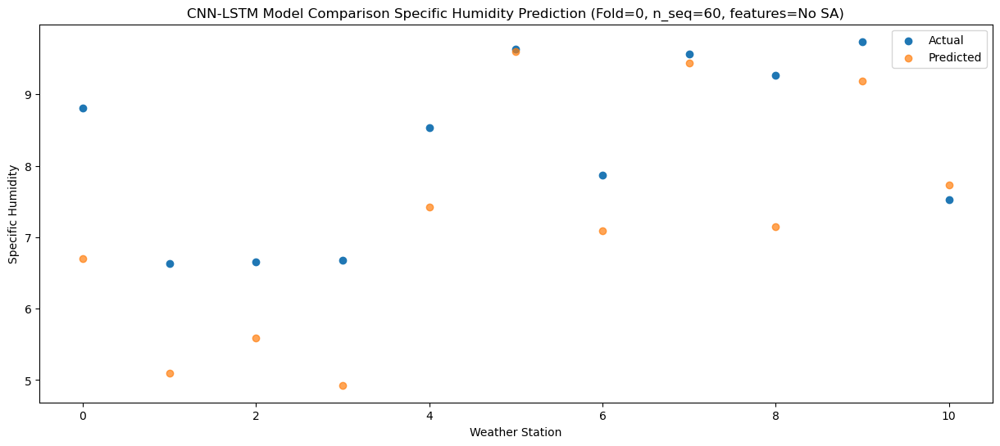

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.63   4.268321
1                 1    3.55   2.560591
2                 2    3.94   3.147717
3                 3    4.25   2.328823
4                 4    6.44   4.962574
5                 5    7.31   7.308467
6                 6    5.76   4.777033
7                 7    7.69   7.244596
8                 8    6.85   4.922303
9                 9    8.43   7.208646
10               10    6.53   5.834739


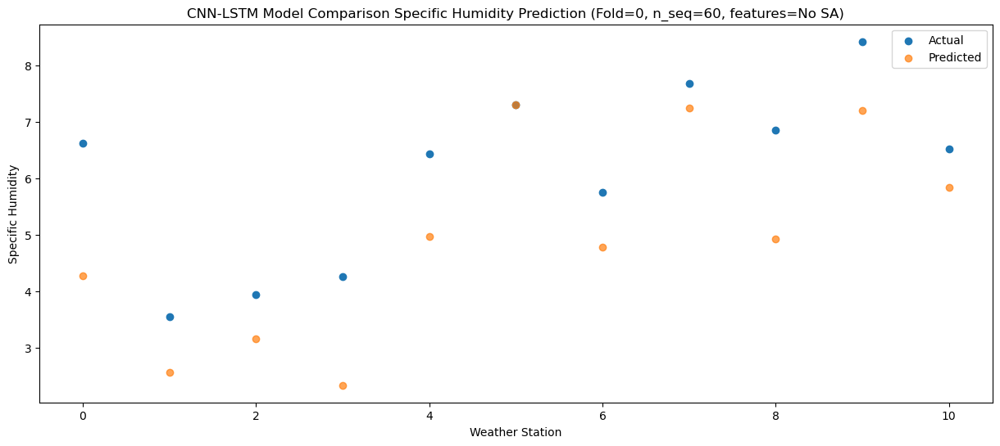

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.33   0.035723
1                 1   -2.11  -1.441815
2                 2   -1.93  -1.260938
3                 3   -1.96  -1.624759
4                 4    2.22   1.514164
5                 5    2.05   2.999417
6                 6    0.01   0.404380
7                 7    1.90   2.763609
8                 8    1.56   0.612540
9                 9    2.91   2.891019
10               10    1.68   1.600159


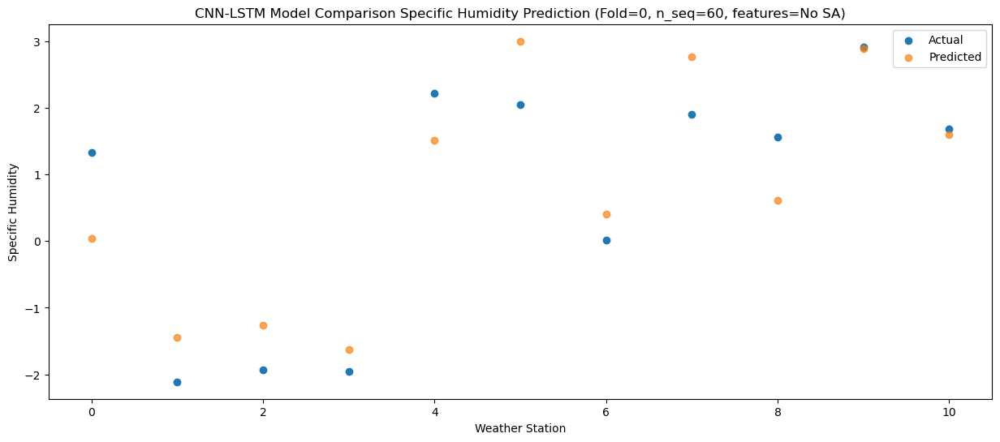

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.11   0.962638
1                 1    1.53   0.262875
2                 2    0.47   0.129822
3                 3    1.09  -0.002398
4                 4    4.98   2.081414
5                 5    3.47   3.952796
6                 6    1.85   1.382187
7                 7    3.67   3.417094
8                 8    3.15   0.935205
9                 9    3.75   2.854852
10               10    1.68   1.335017


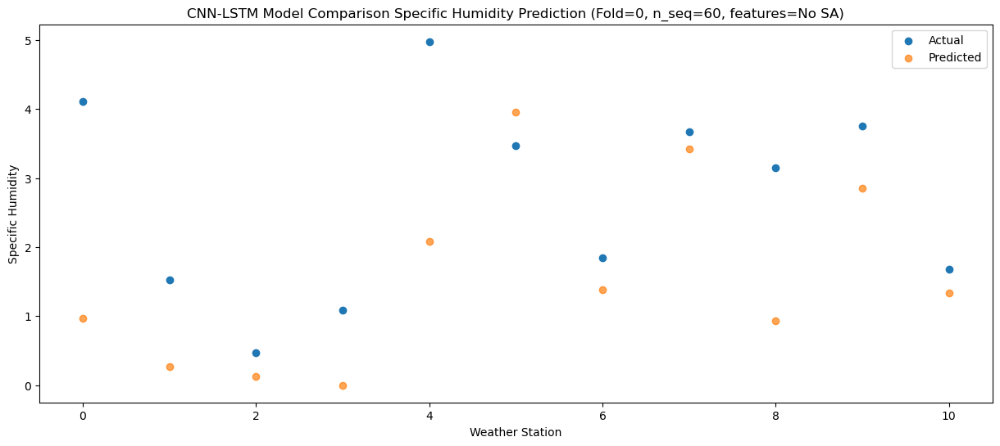

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -0.70  -1.535014
1                 1   -3.23  -2.826504
2                 2   -2.94  -2.687252
3                 3   -4.03  -3.096811
4                 4   -0.52  -0.172603
5                 5    0.36   1.578627
6                 6   -0.93  -1.036923
7                 7    1.16   1.315372
8                 8   -0.13  -0.974403
9                 9    1.46   1.411848
10               10   -0.39   0.124188


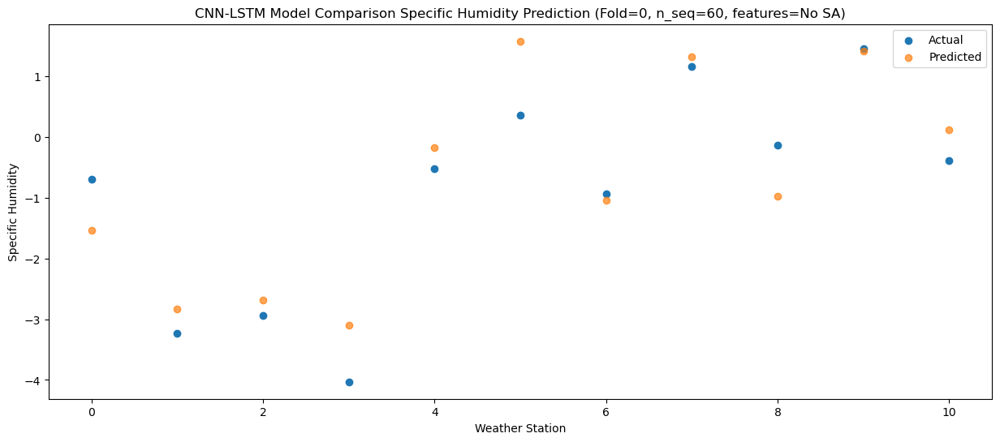

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.04  -1.118975
1                 1   -2.01  -2.073260
2                 2   -1.73  -2.021120
3                 3   -2.82  -2.437994
4                 4   -0.26   0.008487
5                 5    1.74   2.123530
6                 6    0.35  -0.506034
7                 7    2.39   1.758896
8                 8    0.46  -0.714769
9                 9    2.20   1.618009
10               10    0.21   0.254979


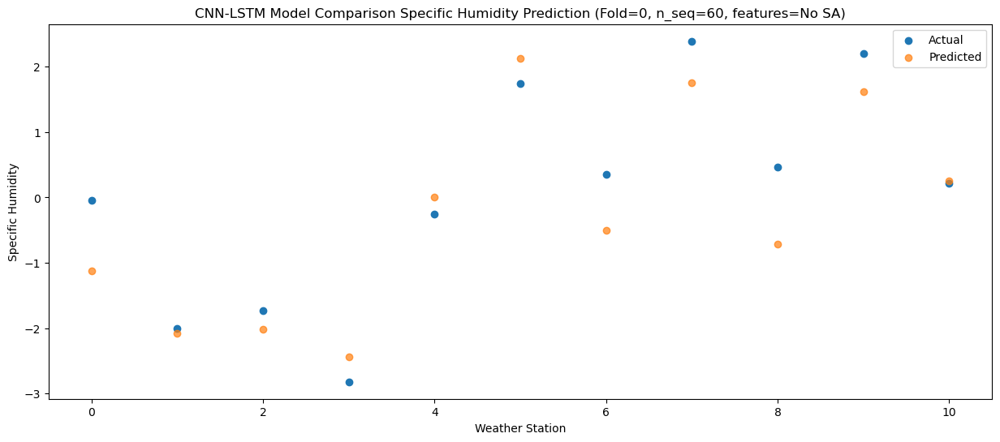

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.36   0.064164
1                 1   -0.10  -1.032782
2                 2   -1.02  -0.928873
3                 3   -1.73  -1.364139
4                 4    1.29   1.244010
5                 5    3.07   3.246372
6                 6    1.36   0.628373
7                 7    3.38   2.924433
8                 8    2.14   0.527848
9                 9    3.48   2.847221
10               10    1.46   1.499466


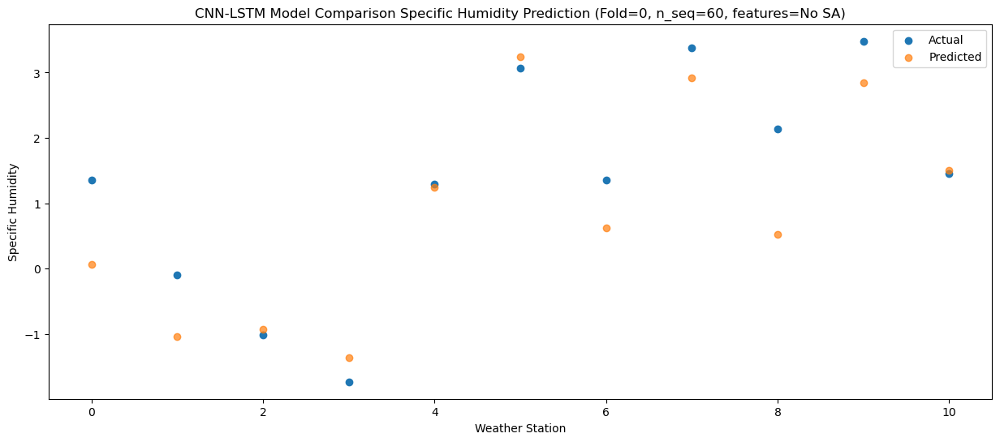

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.83   1.515069
1                 1    1.20   0.248944
2                 2    0.43   0.363130
3                 3    1.19   0.101112
4                 4    5.21   2.740649
5                 5    4.20   4.361068
6                 6    2.36   1.813509
7                 7    4.28   4.020737
8                 8    3.72   1.779973
9                 9    5.10   3.770415
10               10    2.40   2.334795


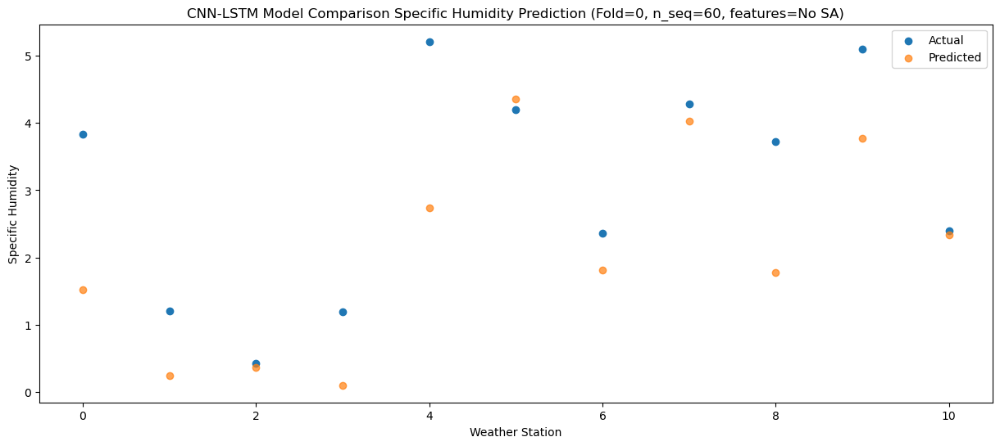

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    8.60   5.252624
1                 1    5.44   3.426820
2                 2    4.57   3.904571
3                 3    5.43   3.445223
4                 4    8.91   6.150704
5                 5    8.98   7.826011
6                 6    6.72   5.374078
7                 7    8.57   7.680332
8                 8    7.91   5.576243
9                 9    9.71   7.403580
10               10    6.12   5.912812


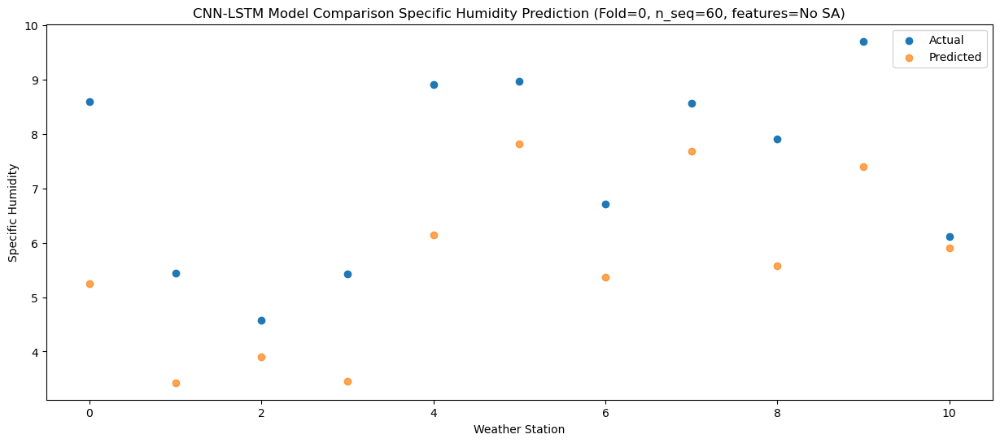

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   11.52   7.717777
1                 1    8.05   5.766629
2                 2    7.35   6.276817
3                 3    7.44   5.846019
4                 4    9.88   8.672615
5                 5   10.07  10.176949
6                 6    8.60   7.743899
7                 7   10.02  10.046077
8                 8   10.09   8.038283
9                 9   11.39   9.765526
10               10    7.39   8.264983


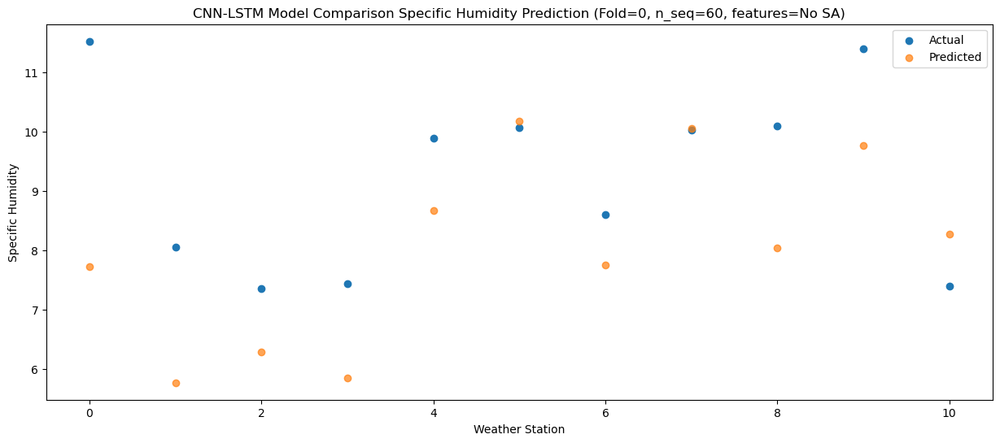

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.10   9.650506
1                 1    8.95   7.637293
2                 2    9.55   8.371710
3                 3    8.65   7.541493
4                 4    9.64  10.232008
5                 5   14.40  12.443499
6                 6   12.22   9.978867
7                 7   13.39  12.455380
8                 8   13.75  10.257313
9                 9   14.97  12.363360
10               10    9.88  10.942555


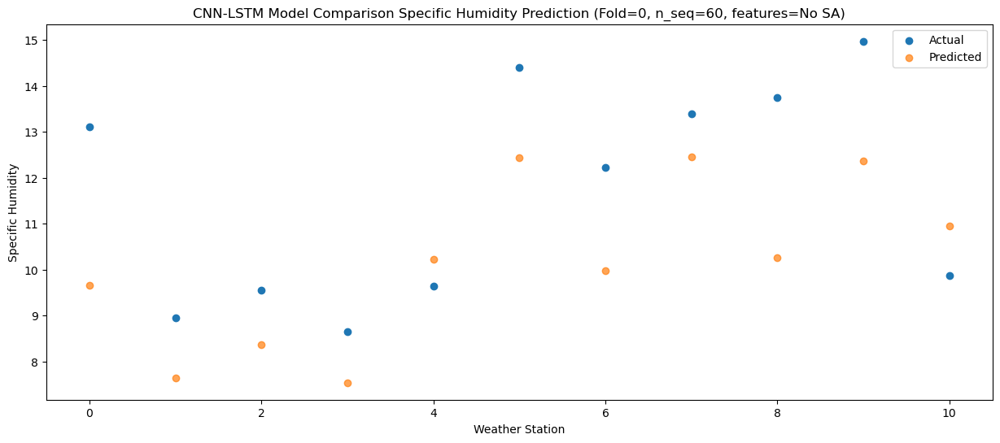

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.68   8.830301
1                 1    8.38   6.749741
2                 2    8.85   7.460930
3                 3    7.93   6.698246
4                 4   10.73   9.572190
5                 5   12.61  11.571431
6                 6   10.87   9.102428
7                 7   12.32  11.585994
8                 8   12.78   9.470292
9                 9   13.43  11.580965
10               10   10.87  10.188272


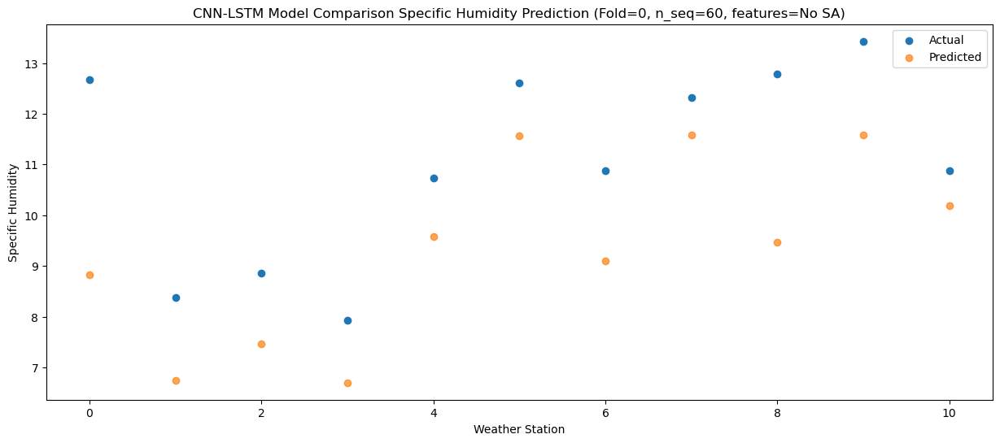

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    8.13   5.762519
1                 1    5.32   4.158439
2                 2    5.12   4.630622
3                 3    4.55   3.938096
4                 4    7.90   6.606677
5                 5    9.91   8.782010
6                 6    7.43   6.238808
7                 7    9.53   8.658525
8                 8    8.33   6.370539
9                 9   10.37   8.636138
10               10    8.27   7.275795


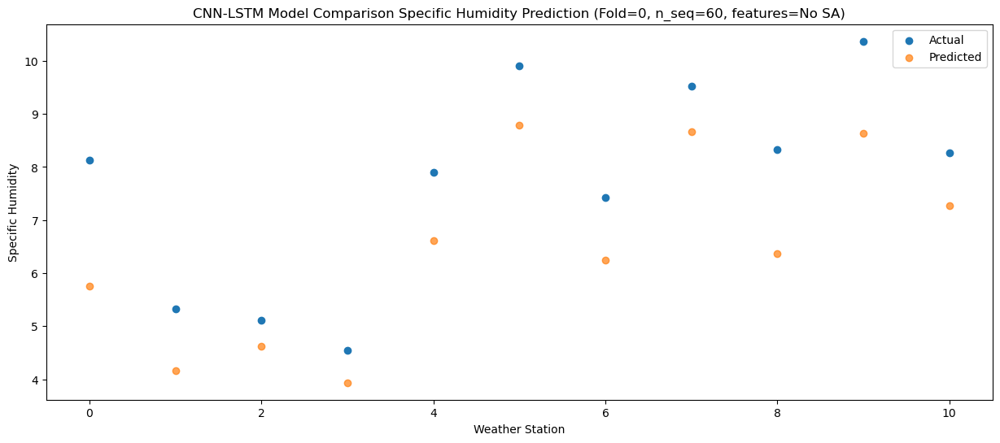

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.85   1.398632
1                 1    0.18   0.083458
2                 2    0.12   0.298621
3                 3   -0.55  -0.224996
4                 4    3.10   2.634582
5                 5    5.27   4.596571
6                 6    2.87   1.972255
7                 7    5.11   4.368245
8                 8    3.10   2.042488
9                 9    4.58   4.494848
10               10    3.25   3.218482


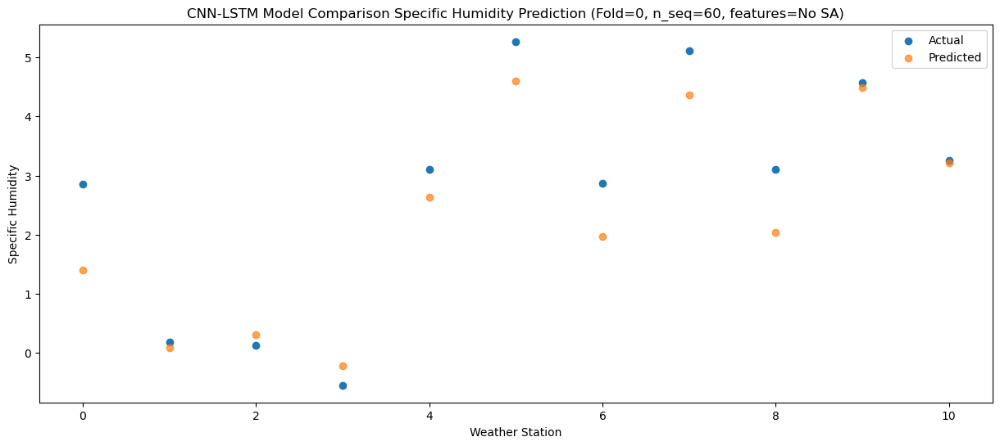

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    2.31   0.439305
1                 1   -0.02  -0.588620
2                 2   -0.20  -0.433639
3                 3   -1.07  -0.960293
4                 4    3.09   1.416396
5                 5    4.61   3.706249
6                 6    2.27   1.086268
7                 7    4.41   3.386286
8                 8    2.10   0.898346
9                 9    3.86   3.245487
10               10    2.11   1.877053


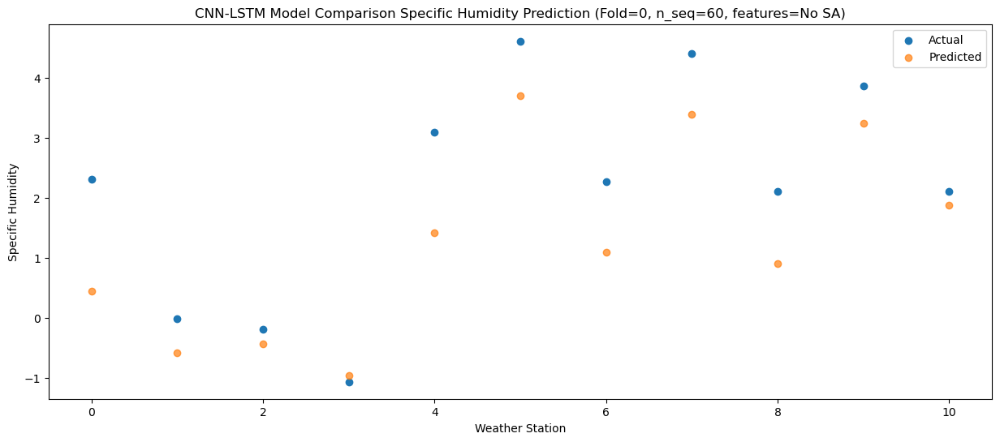

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.85  -1.000514
1                 1   -1.22  -2.218090
2                 2   -1.53  -2.087799
3                 3   -1.57  -2.493257
4                 4    2.01   0.257985
5                 5    1.26   2.121460
6                 6    0.09  -0.488294
7                 7    2.07   1.836661
8                 8    1.17  -0.487568
9                 9    2.93   1.846704
10               10    0.94   0.522598


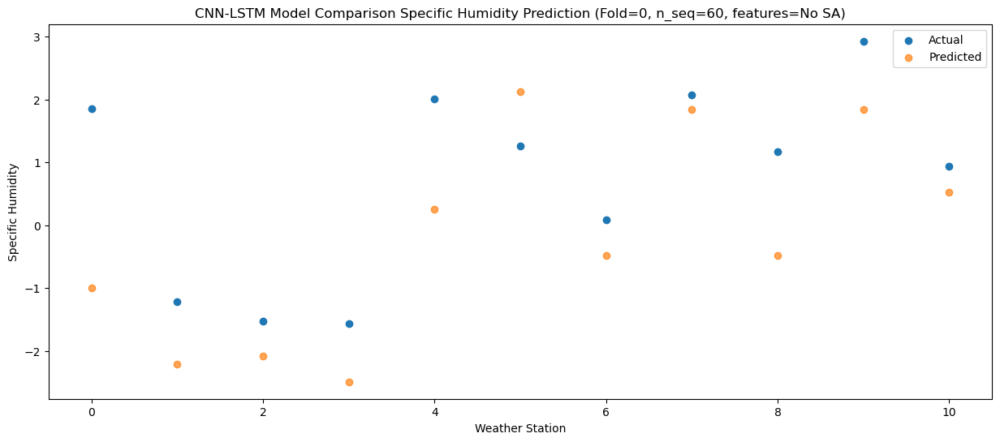

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.45  -0.823448
1                 1   -1.13  -2.232227
2                 2   -1.16  -1.940028
3                 3   -1.38  -2.538375
4                 4    1.25   0.311173
5                 5    2.01   2.389029
6                 6    0.95  -0.225525
7                 7    3.00   2.224500
8                 8    1.77  -0.122597
9                 9    3.54   2.396189
10               10    1.34   1.126741


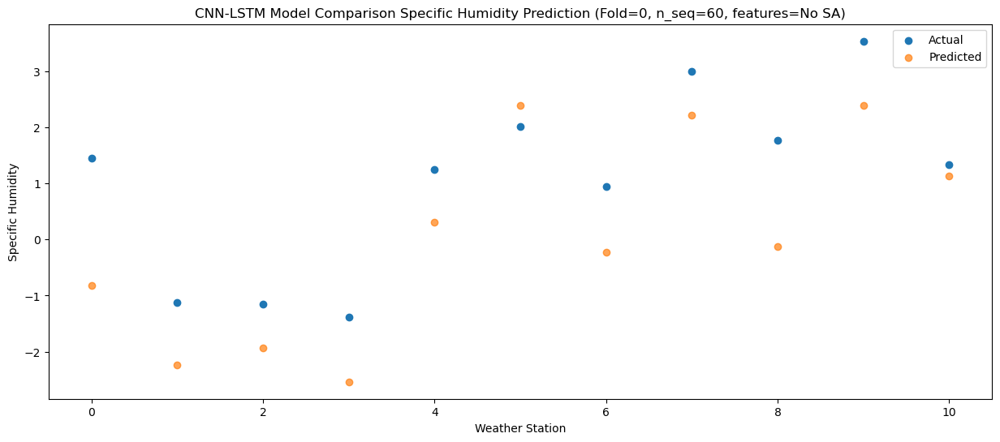

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.07  -0.419644
1                 1    0.56  -1.291351
2                 2   -0.05  -1.284534
3                 3   -0.71  -1.621288
4                 4    1.59   0.637199
5                 5    2.94   2.744346
6                 6    1.63   0.142719
7                 7    3.36   2.338790
8                 8    1.84  -0.161869
9                 9    3.31   2.045487
10               10    0.78   0.620787


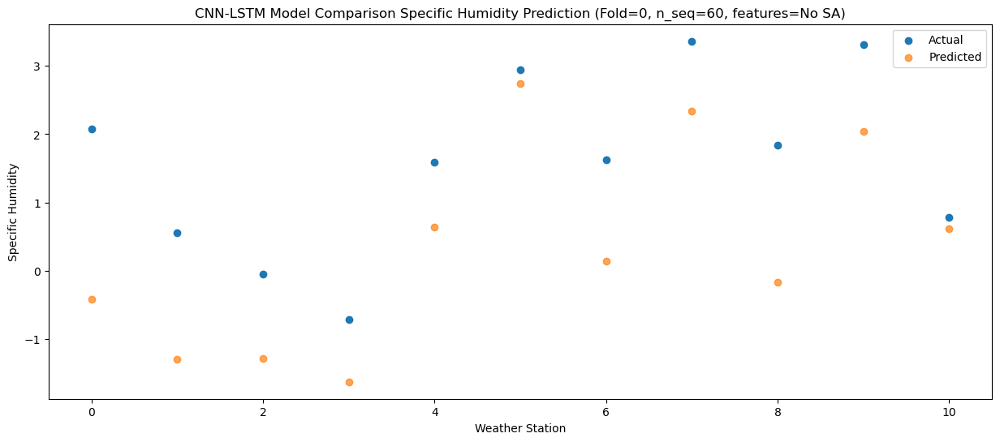

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    2.67  -0.149553
1                 1    0.94  -1.278939
2                 2   -0.69  -1.260485
3                 3    0.37  -1.462441
4                 4    3.78   1.160487
5                 5    2.72   2.778615
6                 6    1.22   0.205981
7                 7    3.28   2.403992
8                 8    2.28   0.109337
9                 9    3.41   2.185128
10               10    1.24   0.768209


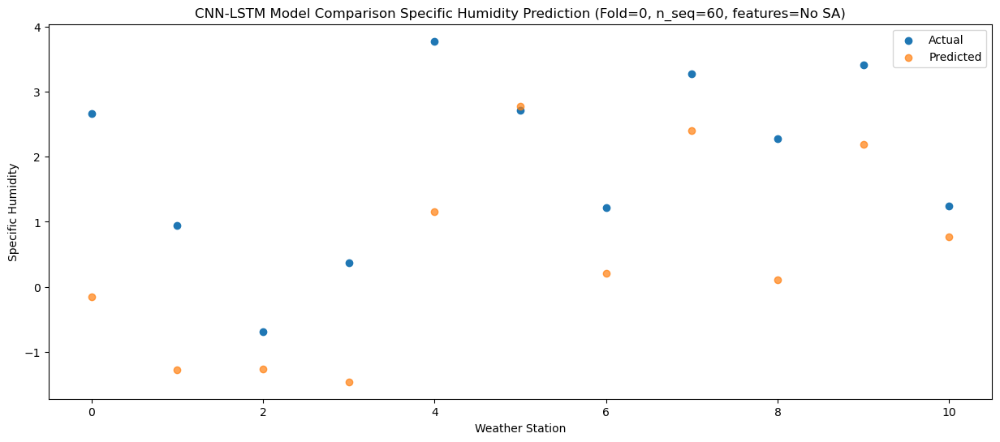

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    3.66   1.035433
1                 1    1.73  -0.120961
2                 2    0.75   0.048766
3                 3    0.77  -0.421223
4                 4    4.54   2.076105
5                 5    5.40   4.183491
6                 6    3.43   1.587423
7                 7    5.56   3.891091
8                 8    3.50   1.470827
9                 9    5.14   3.754563
10               10    2.88   2.375937


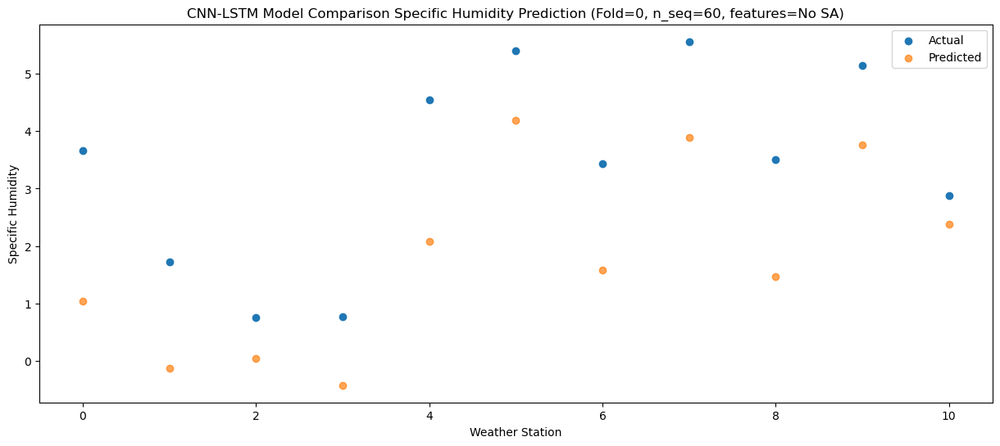

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    7.34   4.059823
1                 1    3.92   2.307300
2                 2    3.53   2.474434
3                 3    3.62   2.456148
4                 4    8.48   5.613888
5                 5    6.16   6.406142
6                 6    5.02   3.938935
7                 7    6.88   6.127082
8                 8    6.99   4.263078
9                 9    7.58   5.905142
10               10    4.09   4.436195


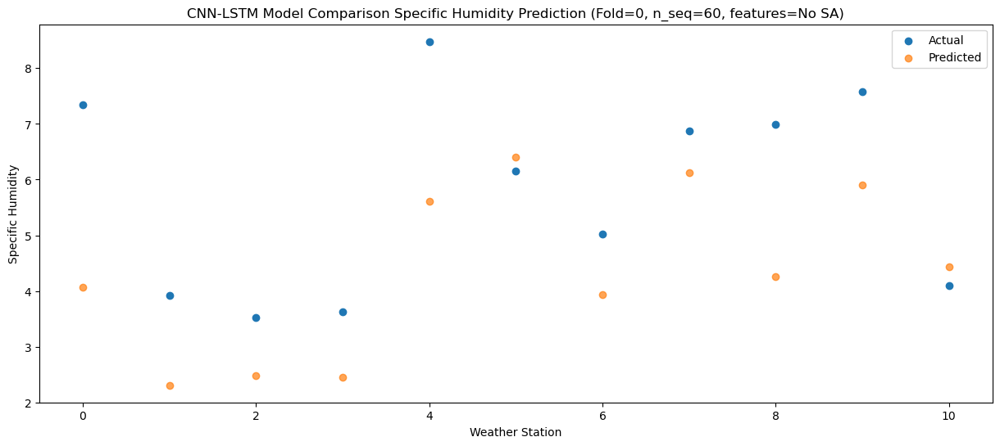

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   11.13   6.638976
1                 1    7.25   4.565186
2                 2    6.11   5.009079
3                 3    7.77   4.759391
4                 4   12.60   7.839782
5                 5   10.06   8.920530
6                 6    7.75   6.498568
7                 7    9.50   8.784231
8                 8    9.27   6.936450
9                 9   10.20   8.550485
10               10    7.10   7.047642


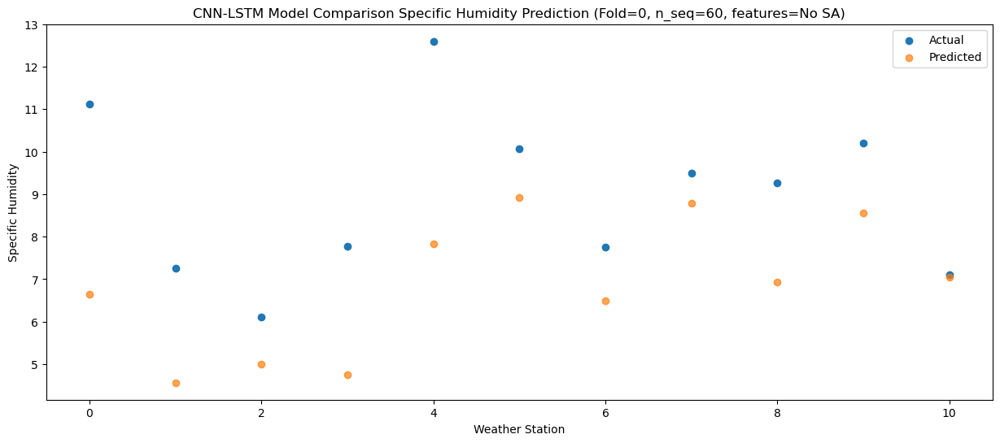

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   13.42   9.051646
1                 1    8.92   6.746145
2                 2    8.97   7.633999
3                 3    8.80   6.731952
4                 4   11.18   9.562287
5                 5   14.41  11.762984
6                 6   11.49   9.315039
7                 7   13.85  11.885652
8                 8   12.82   9.779531
9                 9   14.02  11.879579
10               10   10.93  10.459873


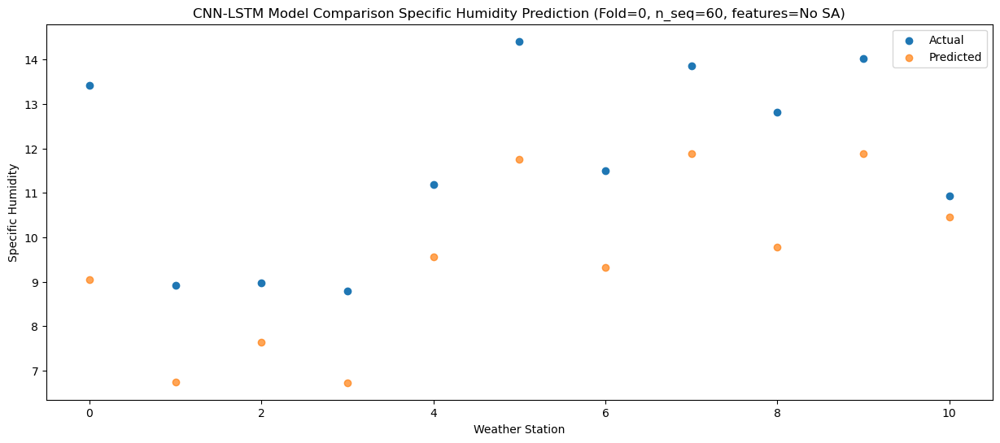

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   13.04   8.884530
1                 1    9.70   6.895128
2                 2    9.06   7.546828
3                 3    8.55   6.851378
4                 4    9.36   9.607690
5                 5   13.52  11.620310
6                 6   11.12   9.147719
7                 7   12.79  11.596403
8                 8   12.82   9.467137
9                 9   12.72  11.500450
10               10   10.18  10.065928


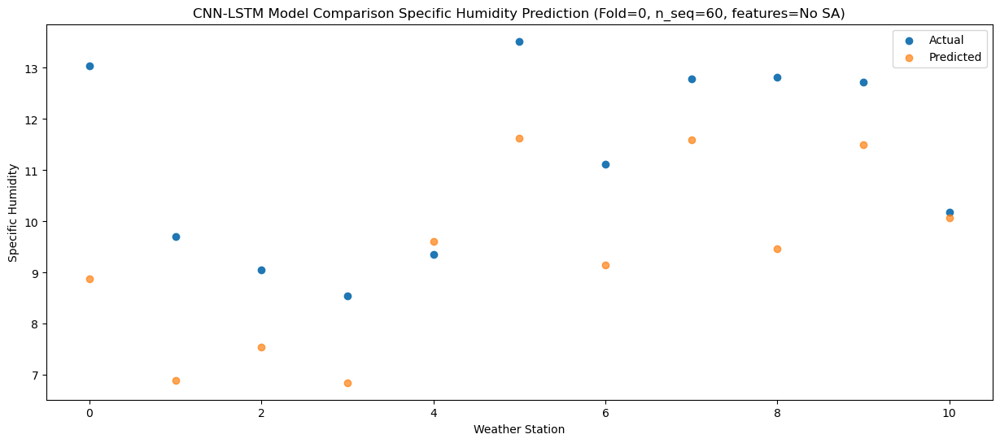

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    9.07   5.288982
1                 1    5.68   3.250993
2                 2    5.48   3.922513
3                 3    6.37   3.148421
4                 4    9.32   6.131062
5                 5   10.40   8.168968
6                 6    8.18   5.651548
7                 7    9.99   8.191928
8                 8    8.75   6.061310
9                 9   10.00   8.311738
10               10    8.87   6.966055


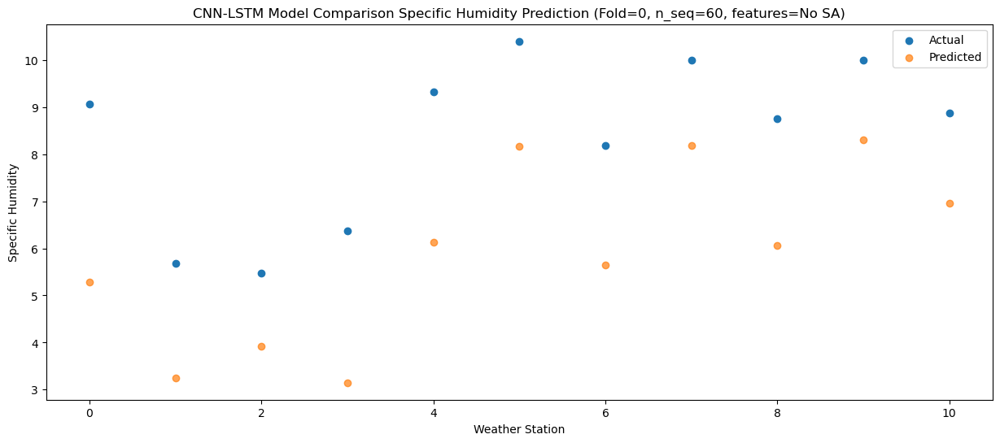

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    5.04   1.867389
1                 1    0.98  -0.114565
2                 2    1.57   0.480199
3                 3    1.80  -0.273639
4                 4    5.57   2.912695
5                 5    6.00   4.866835
6                 6    3.92   2.304854
7                 7    6.24   4.884755
8                 8    4.69   2.750330
9                 9    6.76   5.180652
10               10    5.11   3.914752


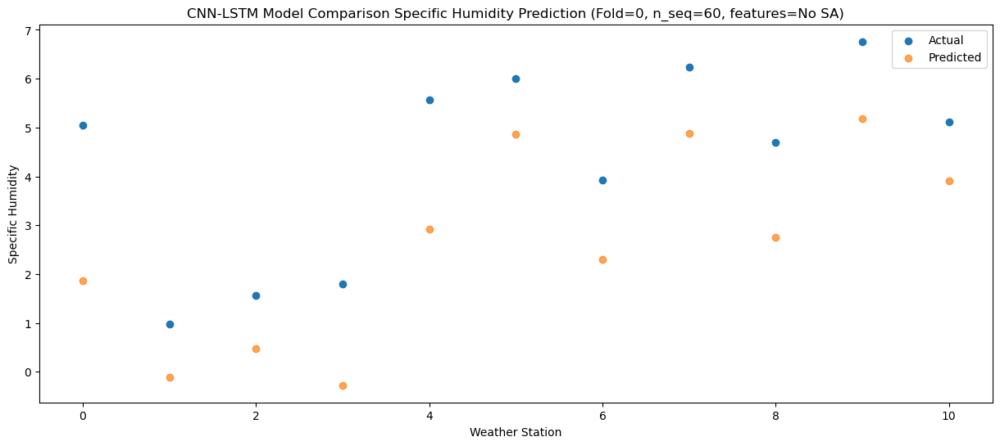

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.86  -0.768989
1                 1   -1.20  -2.395017
2                 2   -0.96  -2.077170
3                 3   -1.19  -2.577974
4                 4    2.77   0.516413
5                 5    2.98   2.236416
6                 6    0.59  -0.351311
7                 7    2.72   2.086390
8                 8    2.03  -0.082180
9                 9    3.41   2.253863
10               10    1.70   0.959452


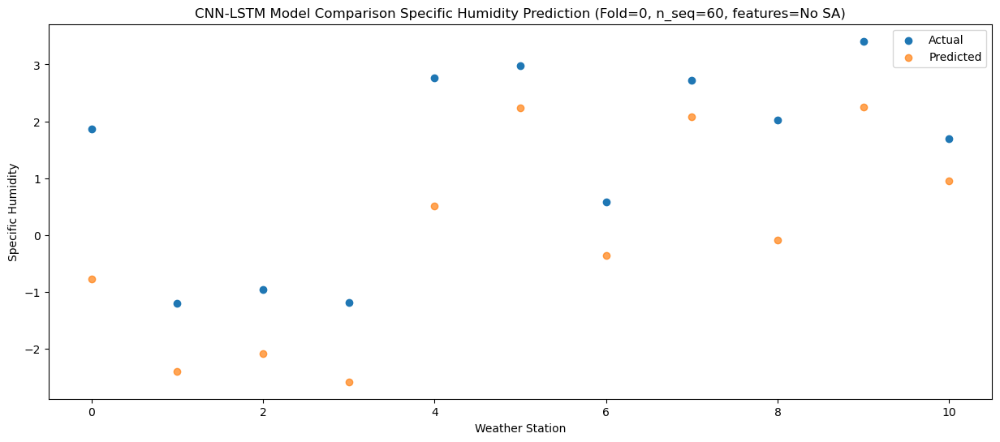

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.58  -1.478373
1                 1   -2.64  -3.509342
2                 2   -1.77  -2.913018
3                 3   -2.59  -3.733404
4                 4    0.91  -0.268240
5                 5    2.16   1.665915
6                 6    0.52  -0.936765
7                 7    2.92   1.735825
8                 8    1.42  -0.380857
9                 9    3.60   2.296336
10               10    2.23   1.135650


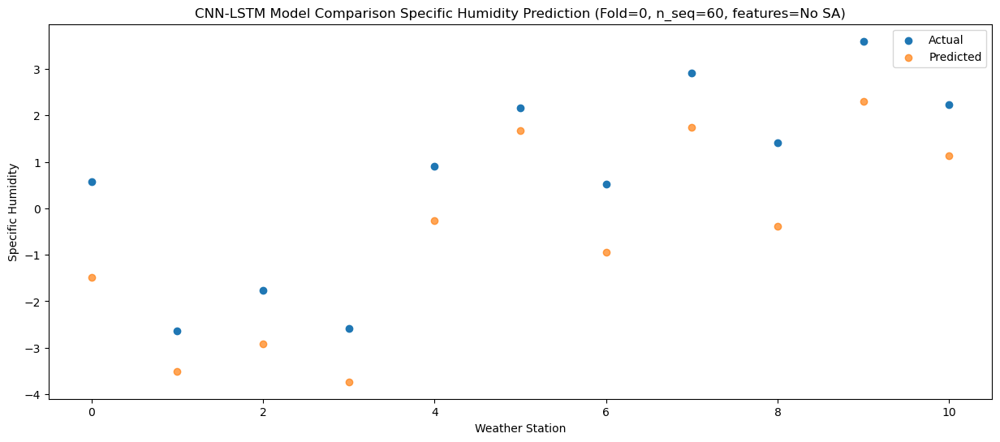

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.24  -2.344308
1                 1   -3.42  -4.084918
2                 2   -2.57  -3.654871
3                 3   -3.51  -4.371855
4                 4   -0.27  -1.070616
5                 5    1.37   0.897205
6                 6   -0.15  -1.738171
7                 7    2.23   0.864071
8                 8    0.24  -1.358677
9                 9    2.63   1.326031
10               10    0.71   0.150262


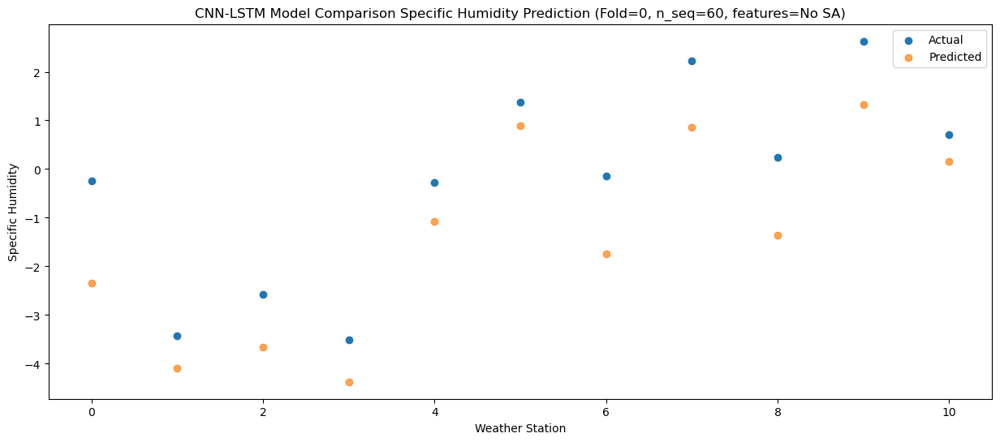

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.66  -1.594283
1                 1   -2.20  -3.764624
2                 2   -1.93  -3.246106
3                 3   -1.73  -3.820196
4                 4    2.30  -0.102559
5                 5    1.27   1.256501
6                 6    0.01  -1.312690
7                 7    2.26   1.290119
8                 8    2.00  -0.639253
9                 9    2.98   1.781933
10               10    1.24   0.586728


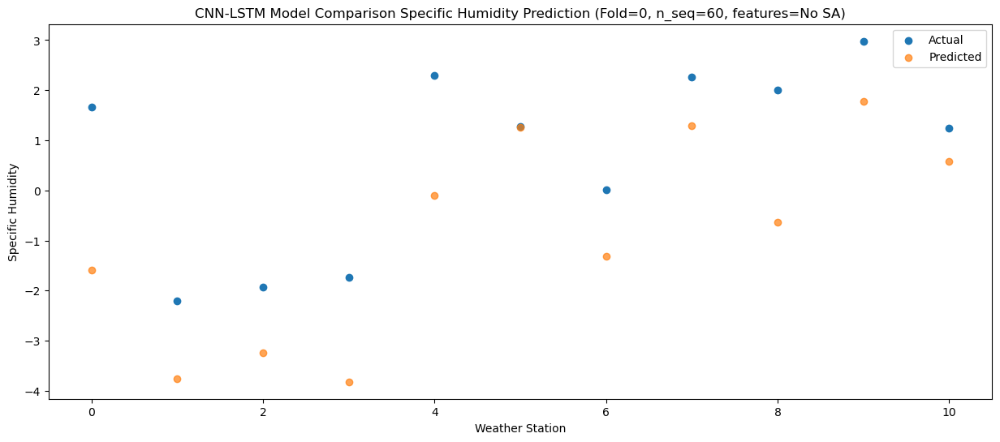

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.92  -0.610345
1                 1   -0.35  -2.262307
2                 2   -0.30  -1.944429
3                 3    0.06  -2.398378
4                 4    4.04   0.663803
5                 5    3.19   2.327279
6                 6    1.46  -0.248755
7                 7    3.40   2.171888
8                 8    2.87   0.005250
9                 9    4.11   2.260226
10               10    1.93   0.937521


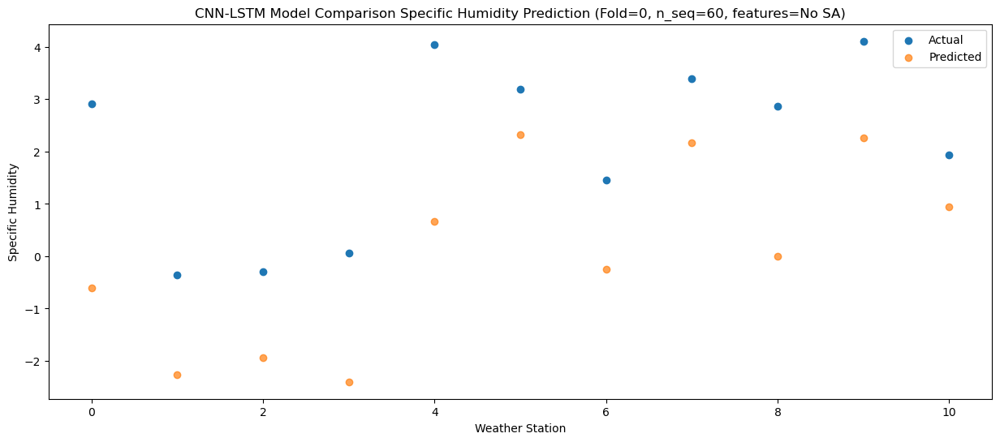

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.23   0.848954
1                 1    1.56  -1.437132
2                 2    1.44  -0.797063
3                 3    2.11  -1.395845
4                 4    6.28   2.045669
5                 5    4.53   3.518536
6                 6    3.52   1.017992
7                 7    5.42   3.577467
8                 8    5.10   1.626350
9                 9    6.48   3.825455
10               10    3.49   2.522240


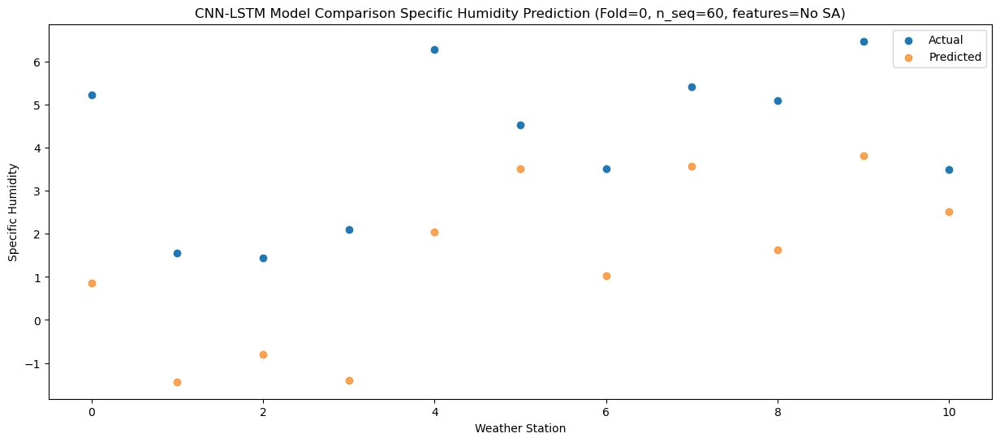

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    9.70   4.495754
1                 1    6.14   2.180665
2                 2    5.19   2.938647
3                 3    6.68   2.262050
4                 4   10.53   5.325218
5                 5    8.59   7.065700
6                 6    7.43   4.622424
7                 7    9.24   7.135371
8                 8    9.38   5.127326
9                 9   10.28   7.124695
10               10    6.54   5.711300


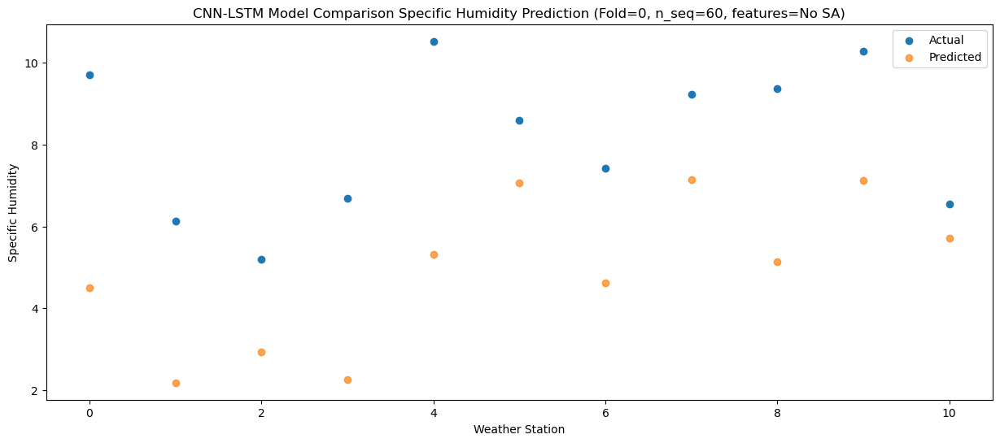

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   11.09   7.096431
1                 1    7.74   4.120690
2                 2    6.32   5.139441
3                 3    8.19   4.383412
4                 4   12.18   8.097368
5                 5   10.56   9.395346
6                 6    9.25   6.998358
7                 7   10.93   9.664892
8                 8   11.80   7.988008
9                 9   11.35   9.944858
10               10    9.04   8.598197


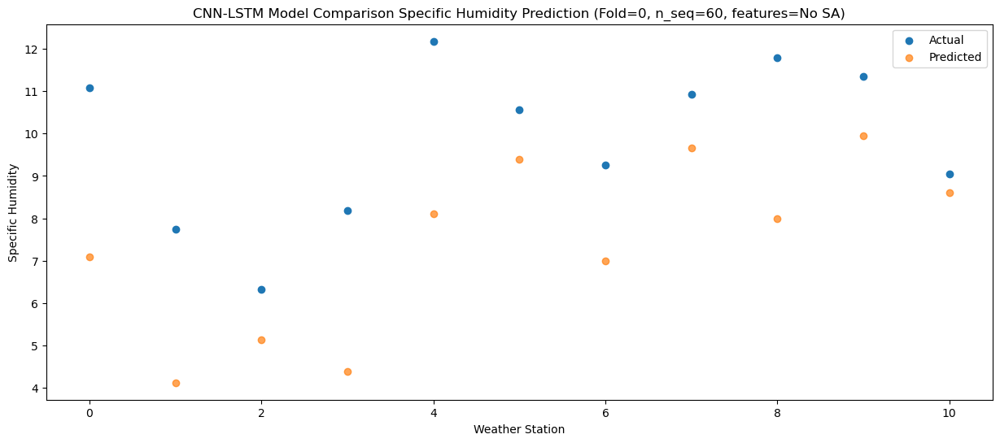

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.38   8.103579
1                 1    9.91   5.579853
2                 2    9.55   6.594144
3                 3    9.59   5.566275
4                 4   11.92   8.632117
5                 5   13.35  10.863370
6                 6   11.78   8.409853
7                 7   13.82  11.093853
8                 8   12.98   9.031337
9                 9   12.85  11.278856
10               10   10.11   9.930141


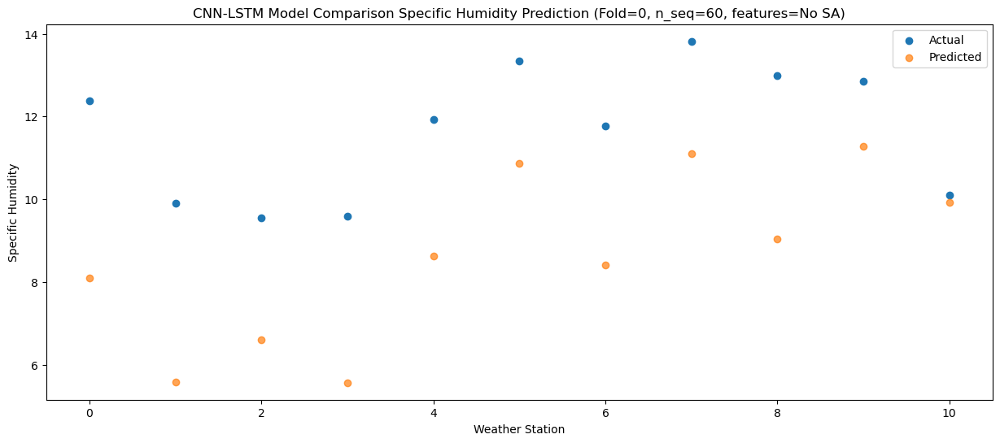

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   10.55   7.764609
1                 1    8.41   5.260899
2                 2    7.86   6.188871
3                 3    8.45   5.252684
4                 4   11.57   8.536161
5                 5   12.34  10.524076
6                 6   10.62   8.042897
7                 7   12.39  10.720517
8                 8   11.31   8.747883
9                 9   12.05  11.013689
10               10    9.87   9.707217


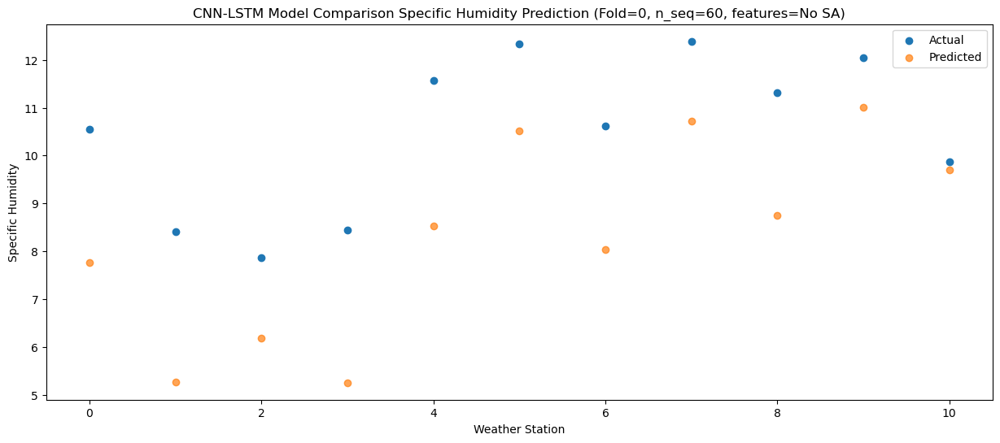

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    9.08   5.340333
1                 1    7.54   3.868525
2                 2    6.17   4.321858
3                 3    6.89   3.603879
4                 4    9.08   6.033372
5                 5   10.39   8.459155
6                 6    8.89   5.901487
7                 7   10.80   8.311498
8                 8    9.27   5.934942
9                 9    9.70   8.191478
10               10    8.16   6.792998


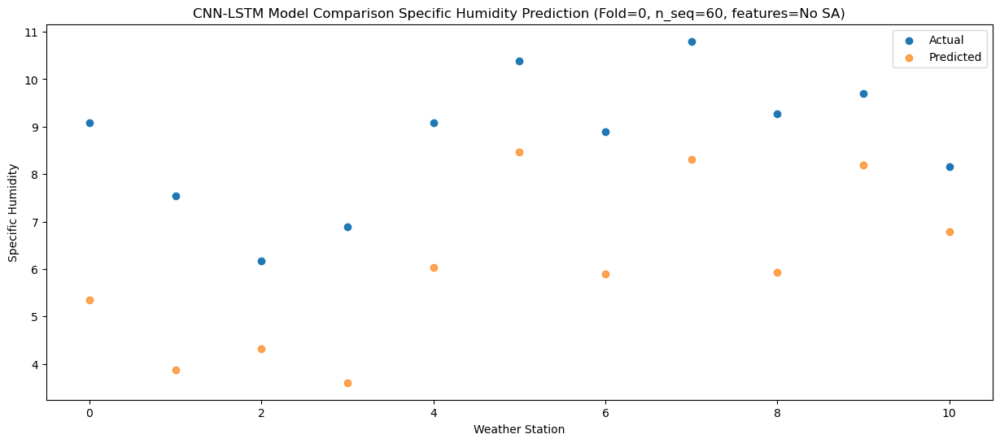

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.70   1.193613
1                 1    2.14  -0.308236
2                 2    2.04   0.042611
3                 3    1.70  -0.573305
4                 4    5.47   2.266918
5                 5    5.10   4.354672
6                 6    4.19   1.753413
7                 7    5.91   4.209553
8                 8    4.67   1.918996
9                 9    6.17   4.334426
10               10    3.96   3.036821


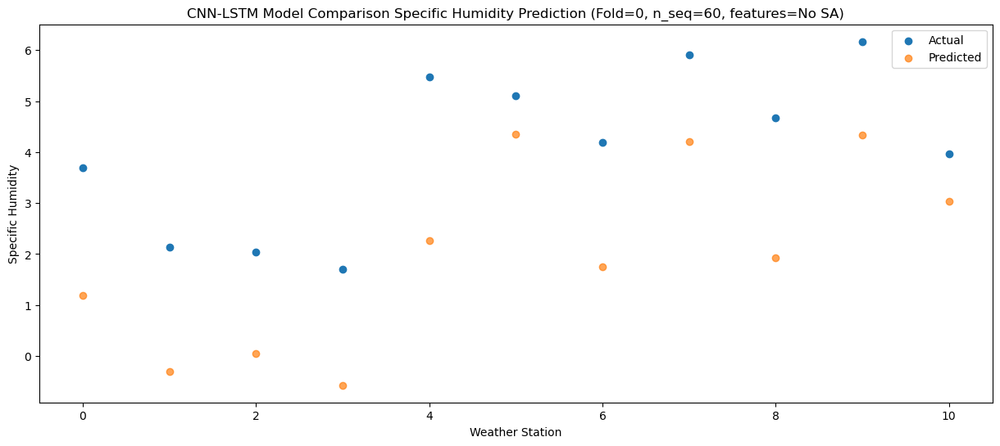

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d (Conv1D)             (None, 1, 1024)           1859584   
                                                                 
 max_pooling1d (MaxPooling1D  (None, 1, 1024)          0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 1, 1024)           0         
                                                                 
 lstm (LSTM)                 (None, 1, 512)            3147776   
                                                                 
 dropout_1 (Dropout)         (None, 1, 512)            0         
                                                                 
 lstm_1 (LSTM)               (None, 512)               2099200   
                                                        

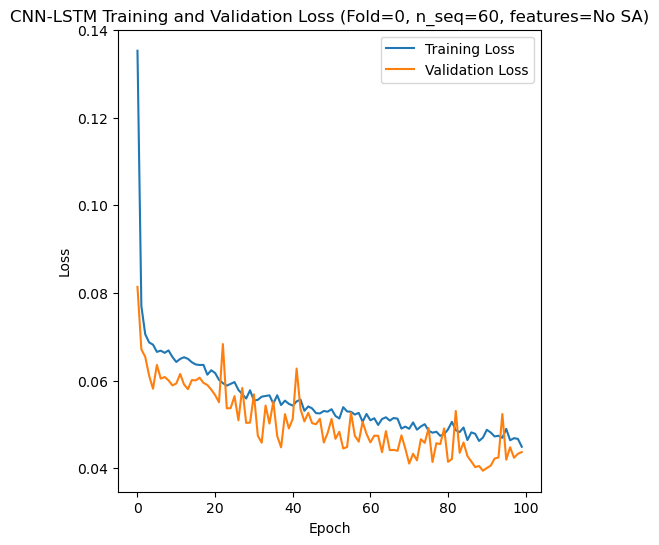

Epoch 1/100
84/84 [==============================] - 22s 92ms/step - loss: 0.1306 - accuracy: 0.2857 - mae: 0.1110 - rmse: 0.1306 - mape: 23.8068 - pearson: 0.5876 - val_loss: 0.0874 - val_accuracy: 0.5000 - val_mae: 0.0716 - val_rmse: 0.0874 - val_mape: 15.3344 - val_pearson: 0.7638
Epoch 2/100
84/84 [==============================] - 3s 34ms/step - loss: 0.0767 - accuracy: 0.4405 - mae: 0.0605 - rmse: 0.0767 - mape: 13.7034 - pearson: 0.7258 - val_loss: 0.0610 - val_accuracy: 0.5000 - val_mae: 0.0469 - val_rmse: 0.0610 - val_mape: 10.3723 - val_pearson: 0.8088
Epoch 3/100
84/84 [==============================] - 3s 37ms/step - loss: 0.0714 - accuracy: 0.4643 - mae: 0.0566 - rmse: 0.0714 - mape: 12.7180 - pearson: 0.7589 - val_loss: 0.0662 - val_accuracy: 0.5000 - val_mae: 0.0534 - val_rmse: 0.0662 - val_mape: 11.8524 - val_pearson: 0.7965
Epoch 4/100
84/84 [==============================] - 3s 35ms/step - loss: 0.0691 - accuracy: 0.5000 - mae: 0.0543 - rmse: 0.0691 - mape: 12.3038 - 

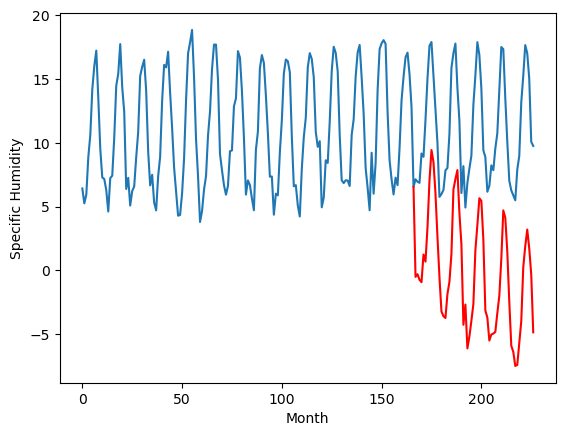

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.00		-0.82		0.18
-0.95		-0.66		0.29
-1.20		-1.09		0.11
-0.68		-1.32		-0.64
1.55		0.85		-0.70
-0.04		0.33		0.37
2.97		3.11		0.14
6.77		6.77		0.00
8.81		9.20		0.39
8.86		8.11		-0.75
5.96		5.59		-0.37
3.29		2.07		-1.22
0.23		-0.96		-1.19
-2.36		-3.55		-1.19
-2.34		-3.92		-1.58
-2.15		-4.15		-2.00
-0.62		-2.21		-1.59
-0.26		-1.23		-0.97
2.66		1.00		-1.66
6.64		6.03		-0.61
8.51		6.86		-1.65
8.72		7.52		-1.20
5.77		4.07		-1.70
3.73		1.66		-2.07
-1.86		-4.62		-2.76
0.31		-3.13		-3.44
-2.69		-6.49		-3.80
-1.74		-5.61		-3.87
-1.06		-4.36		-3.30
0.00		-3.01		-3.01
4.17		1.21		-2.96
6.57		3.22		-3.35
9.24		5.28		-3.96
8.83		5.08		-3.75
5.47		1.98		-3.49
0.58		-3.59		-4.17
0.10		-4.17		-4.27
-1.49		-5.95		-4.46
-1.08		-5.48		-4.40
0.04		-5.45		-5.49
-0.83		-5.31		-4.48
0.77		-3.87		-4.64
3.51		-2.35		-5.86
5.86		0.52		-5.34
8.82		4.23		-4.59
8.95		3.68		-5.27
5.84		1.01		-4.83
1.99		-2.93		-4.92
-1.02	

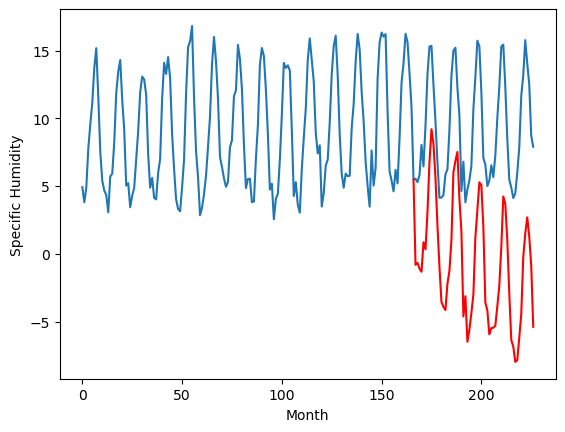

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.90		-2.19		-0.29
-0.99		-2.04		-1.05
-1.50		-2.46		-0.96
-1.11		-2.64		-1.53
2.05		-0.16		-2.21
0.43		-0.78		-1.21
3.20		1.99		-1.21
7.05		5.65		-1.40
9.60		7.99		-1.61
9.12		6.86		-2.26
6.17		4.50		-1.67
3.41		0.83		-2.58
0.23		-2.24		-2.47
-2.54		-5.02		-2.48
-2.39		-5.30		-2.91
-2.39		-5.50		-3.11
0.23		-3.35		-3.58
-0.06		-2.48		-2.42
2.78		-0.03		-2.81
7.30		4.91		-2.39
8.89		5.66		-3.23
9.11		6.21		-2.90
6.35		2.78		-3.57
3.60		0.29		-3.31
-1.90		-6.01		-4.11
0.74		-4.15		-4.89
-3.14		-7.89		-4.75
-2.11		-6.97		-4.86
-1.32		-5.67		-4.35
0.44		-4.11		-4.55
4.80		0.20		-4.60
7.89		2.27		-5.62
9.52		4.13		-5.39
8.65		3.89		-4.76
5.14		0.71		-4.43
0.03		-5.01		-5.04
-0.34		-5.47		-5.13
-1.03		-7.20		-6.17
-1.06		-6.84		-5.78
-0.01		-6.58		-6.57
-0.48		-6.34		-5.86
0.88		-5.04		-5.92
4.18		-3.19		-7.37
6.83		-0.31		-7.14
9.97		3.06		-6.91
9.90		2.66		-7.24
6.09		-0.17		-6.26
1.58		-4.26		

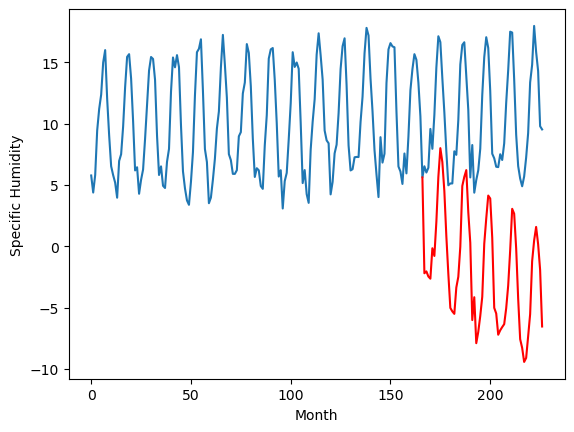

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.51		-2.20		-0.69
-2.71		-2.22		0.49
-1.81		-2.62		-0.81
-2.51		-2.95		-0.44
1.85		-0.45		-2.30
1.51		-0.97		-2.48
3.49		1.92		-1.57
5.61		5.43		-0.18
8.12		7.80		-0.32
7.01		6.30		-0.71
5.43		3.92		-1.51
2.03		-0.05		-2.08
-0.07		-2.64		-2.57
-2.62		-5.16		-2.54
-2.96		-5.38		-2.42
-2.89		-5.82		-2.93
-0.25		-3.56		-3.31
1.09		-2.66		-3.75
4.98		-0.02		-5.00
8.17		4.66		-3.51
8.65		5.36		-3.29
8.99		5.75		-3.24
5.90		2.22		-3.68
3.65		-0.17		-3.82
-0.80		-6.07		-5.27
2.12		-4.56		-6.68
-3.53		-8.09		-4.56
-3.36		-7.37		-4.01
-1.68		-6.04		-4.36
2.48		-4.37		-6.85
6.29		-0.17		-6.46
7.34		2.00		-5.34
8.26		3.61		-4.65
8.51		3.44		-5.07
5.22		0.20		-5.02
0.26		-5.45		-5.71
-0.24		-6.08		-5.84
-1.05		-7.66		-6.61
-1.47		-7.35		-5.88
-0.69		-7.21		-6.52
0.86		-6.80		-7.66
1.23		-5.71		-6.94
5.01		-3.33		-8.34
8.41		-0.57		-8.98
8.97		2.27		-6.70
7.30		2.07		-5.23
6.10		-0.74		-6.84
2.68		-4.75

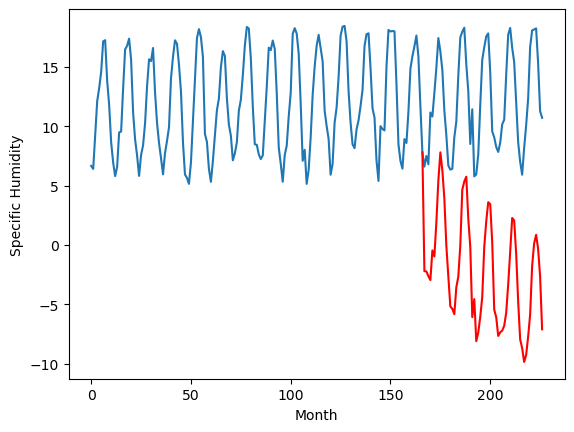

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.21		1.90		-0.31
0.97		1.87		0.90
1.88		1.47		-0.41
1.20		1.13		-0.07
5.93		3.62		-2.31
5.62		3.11		-2.51
7.74		6.00		-1.74
10.03		9.51		-0.52
12.63		11.89		-0.74
11.18		10.37		-0.81
9.69		7.98		-1.71
5.84		4.00		-1.84
3.36		1.44		-1.92
0.54		-1.06		-1.60
0.29		-1.28		-1.57
0.33		-1.74		-2.07
3.05		0.52		-2.53
4.31		1.43		-2.88
8.34		4.07		-4.27
11.75		8.74		-3.01
11.93		9.44		-2.49
11.97		9.83		-2.14
8.87		6.29		-2.58
6.92		3.91		-3.01
2.33		-1.97		-4.30
5.26		-0.49		-5.75
-0.28		-4.00		-3.72
-0.08		-3.29		-3.21
1.62		-1.96		-3.58
5.72		-0.30		-6.02
9.60		3.90		-5.70
10.72		6.07		-4.65
11.47		7.67		-3.80
11.85		7.51		-4.34
8.50		4.27		-4.23
3.60		-1.36		-4.96
3.22		-2.01		-5.23
2.40		-3.58		-5.98
1.92		-3.27		-5.19
2.52		-3.15		-5.67
4.22		-2.74		-6.96
4.67		-1.65		-6.32
8.34		0.74		-7.60
11.60		3.49		-8.11
11.68		6.33		-5.35
10.28		6.13		-4.15
9.53		3.33		-6.20
6.14		-0.67		-6.81
2.80		-3.

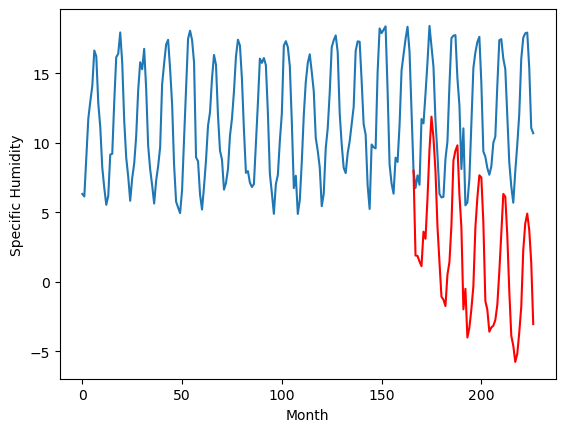

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.35		2.10		-1.25
1.87		2.02		0.15
1.59		1.68		0.09
1.77		1.06		-0.71
4.44		2.77		-1.67
3.43		2.72		-0.71
6.11		5.39		-0.72
7.93		8.24		0.31
8.92		10.25		1.33
7.69		8.86		1.17
7.26		6.50		-0.76
3.75		2.98		-0.77
3.19		1.07		-2.12
0.75		-0.55		-1.30
1.58		-0.72		-2.30
0.95		-1.44		-2.39
1.74		0.23		-1.51
3.04		1.17		-1.87
7.35		3.38		-3.97
9.52		7.33		-2.19
10.85		8.05		-2.80
11.07		8.23		-2.84
7.53		5.06		-2.47
4.42		3.03		-1.39
2.58		-1.37		-3.95
1.53		-1.31		-2.84
0.26		-3.38		-3.64
0.14		-3.14		-3.28
0.69		-1.85		-2.54
2.96		-0.76		-3.72
4.73		2.55		-2.18
7.33		4.72		-2.61
8.28		6.20		-2.08
10.39		6.25		-4.14
9.12		3.54		-5.58
5.93		-0.94		-6.87
3.06		-2.36		-5.42
2.39		-3.60		-5.99
0.84		-3.07		-3.91
0.87		-3.61		-4.48
1.92		-3.08		-5.00
2.18		-2.13		-4.31
6.55		0.25		-6.30
6.50		2.23		-4.27
8.67		4.64		-4.03
8.82		4.65		-4.17
8.46		2.46		-6.00
6.48		-0.71		-7.19
3.85		-3.74		-7.59
1.98		

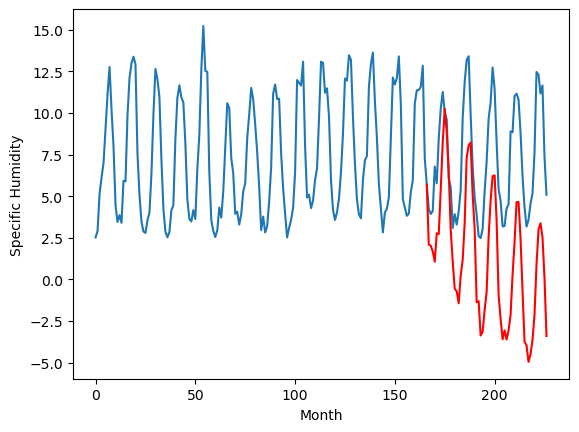

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.70		0.66		-0.04
0.73		0.81		0.08
0.31		0.38		0.07
0.79		0.14		-0.65
2.76		2.22		-0.54
2.11		1.72		-0.39
5.31		4.49		-0.82
8.95		8.15		-0.80
11.39		10.60		-0.79
11.41		9.54		-1.87
8.10		6.98		-1.12
5.61		3.52		-2.09
2.50		0.50		-2.00
-0.22		-2.05		-1.83
-0.33		-2.44		-2.11
-0.21		-2.68		-2.47
1.35		-0.80		-2.15
1.97		0.20		-1.77
4.90		2.36		-2.54
9.25		7.42		-1.83
11.75		8.27		-3.48
12.04		8.96		-3.08
8.69		5.52		-3.17
6.56		3.14		-3.42
0.63		-3.14		-3.77
2.50		-1.75		-4.25
-0.50		-5.00		-4.50
0.63		-4.13		-4.76
1.38		-2.90		-4.28
2.57		-1.62		-4.19
6.83		2.57		-4.26
9.55		4.57		-4.98
12.54		6.68		-5.86
11.45		6.50		-4.95
7.97		3.43		-4.54
2.91		-2.09		-5.00
2.42		-2.70		-5.12
0.52		-4.50		-5.02
0.88		-4.00		-4.88
2.08		-4.04		-6.12
1.32		-3.92		-5.24
3.13		-2.43		-5.56
5.69		-1.03		-6.72
8.27		1.83		-6.44
11.89		5.66		-6.23
11.78		5.06		-6.72
8.81		2.44		-6.37
4.56		-1.46		-6.02
1.21		-4.93

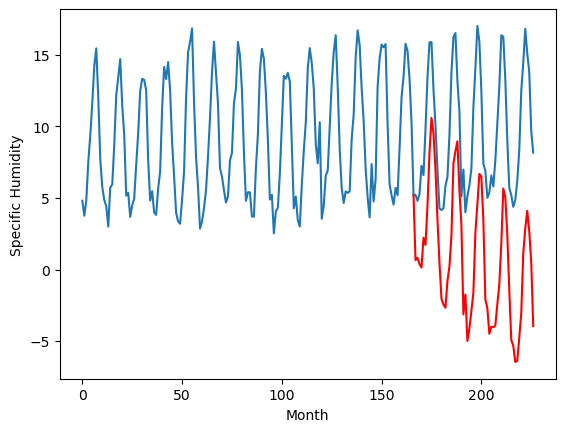

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.11		2.40		-0.71
2.78		2.34		-0.44
2.70		1.92		-0.78
2.58		1.49		-1.09
5.24		3.59		-1.65
5.50		3.23		-2.27
8.40		6.17		-2.23
12.23		9.69		-2.54
15.31		12.19		-3.12
13.14		10.65		-2.49
11.34		8.01		-3.33
6.52		4.16		-2.36
4.50		1.75		-2.75
2.18		-0.46		-2.64
2.05		-0.78		-2.83
1.53		-1.33		-2.86
4.26		0.69		-3.57
5.49		1.74		-3.75
8.70		4.13		-4.57
13.46		8.90		-4.56
14.09		9.72		-4.37
13.94		10.23		-3.71
10.69		6.61		-4.08
7.96		4.36		-3.60
3.40		-1.47		-4.87
5.04		-0.52		-5.56
1.29		-3.48		-4.77
1.97		-2.86		-4.83
3.50		-1.59		-5.09
5.69		-0.18		-5.87
10.14		3.90		-6.24
12.90		6.02		-6.88
13.87		7.84		-6.03
13.78		7.74		-6.04
9.82		4.60		-5.22
5.28		-0.87		-6.15
4.03		-1.68		-5.71
3.12		-3.30		-6.42
3.24		-2.87		-6.11
3.34		-3.07		-6.41
4.10		-2.76		-6.86
5.30		-1.51		-6.81
9.34		0.55		-8.79
12.26		3.25		-9.01
14.83		6.49		-8.34
14.41		6.12		-8.29
9.92		3.51		-6.41
6.67		-0.30		-6.97
3.96		

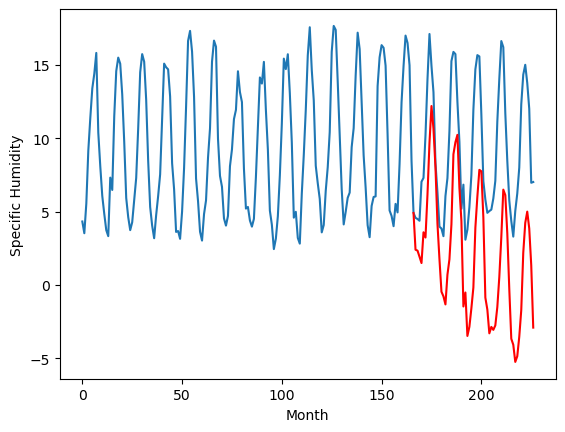

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.03		2.84		-1.19
3.19		2.62		-0.57
3.64		2.21		-1.43
3.02		1.60		-1.42
6.04		3.50		-2.54
6.23		3.32		-2.91
9.56		6.36		-3.20
11.70		9.72		-1.98
15.06		12.29		-2.77
12.16		10.46		-1.70
10.68		7.70		-2.98
6.01		3.70		-2.31
4.90		1.78		-3.12
2.62		-0.06		-2.68
2.78		-0.37		-3.15
1.97		-1.17		-3.14
4.58		0.81		-3.77
5.74		1.95		-3.79
9.96		4.34		-5.62
13.10		8.91		-4.19
14.15		9.74		-4.41
13.73		10.16		-3.57
10.16		6.45		-3.71
7.72		4.36		-3.36
4.19		-1.06		-5.25
3.58		-0.70		-4.28
1.60		-3.16		-4.76
2.13		-2.76		-4.89
3.22		-1.51		-4.73
6.34		-0.15		-6.49
10.58		3.74		-6.84
12.48		5.90		-6.58
11.84		7.61		-4.23
12.58		7.61		-4.97
9.84		4.50		-5.34
5.89		-0.76		-6.65
4.91		-1.84		-6.75
3.17		-3.33		-6.50
2.69		-2.87		-5.56
3.02		-3.35		-6.37
4.44		-2.95		-7.39
5.66		-1.80		-7.46
10.71		0.53		-10.18
13.29		3.07		-10.22
13.52		6.06		-7.46
11.69		5.77		-5.92
10.74		3.31		-7.43
7.31		-0.31		-7.62
4.

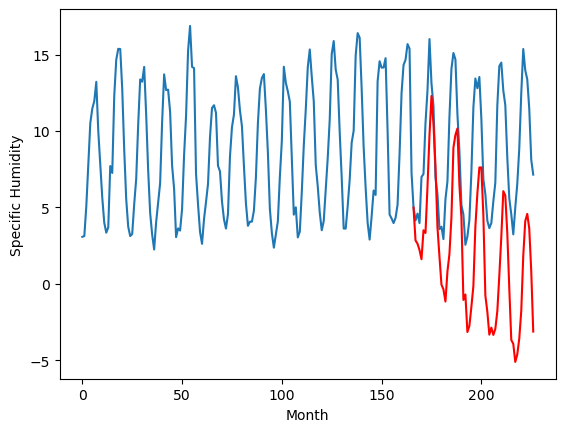

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.80		-0.13		-0.93
0.15		-0.33		-0.48
-0.00		-0.70		-0.70
0.01		-1.41		-1.42
1.90		0.20		-1.70
2.06		0.20		-1.86
4.88		3.07		-1.81
6.59		6.05		-0.54
9.48		8.29		-1.19
8.16		6.60		-1.56
5.37		3.98		-1.39
1.85		0.24		-1.61
1.53		-1.41		-2.94
-0.33		-2.87		-2.54
-0.14		-3.11		-2.97
-0.88		-3.99		-3.11
0.94		-2.26		-3.20
1.11		-1.20		-2.31
6.26		1.03		-5.23
9.25		5.12		-4.13
10.49		5.93		-4.56
9.46		6.16		-3.30
6.50		2.73		-3.77
3.06		0.79		-2.27
0.70		-3.78		-4.48
-0.28		-3.98		-3.70
-0.92		-5.83		-4.91
-1.00		-5.66		-4.66
-0.04		-4.41		-4.37
0.93		-3.30		-4.23
3.49		0.12		-3.37
7.67		2.30		-5.37
8.32		3.85		-4.47
8.73		3.93		-4.80
6.73		1.10		-5.63
3.34		-3.54		-6.88
1.36		-4.98		-6.34
0.15		-6.26		-6.41
-0.16		-5.71		-5.55
-0.30		-6.43		-6.13
0.49		-5.94		-6.43
1.01		-4.93		-5.94
6.74		-2.49		-9.23
8.35		-0.40		-8.75
10.28		2.17		-8.11
8.37		2.09		-6.28
6.72		-0.11		-6.83
3.61		-3.32		-6.93
1

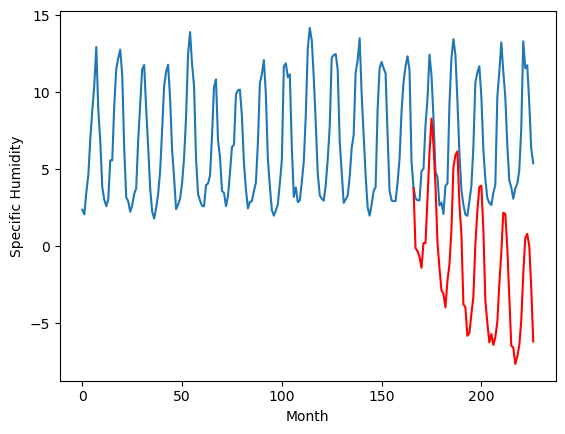

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.62		0.51		-0.11
0.61		0.59		-0.02
0.46		0.11		-0.35
0.53		-0.38		-0.91
1.48		0.76		-0.72
1.77		0.64		-1.13
4.34		3.37		-0.97
7.98		6.92		-1.06
11.62		9.59		-2.03
11.53		8.55		-2.98
8.05		5.55		-2.50
5.13		2.45		-2.68
2.75		-0.17		-2.92
0.59		-2.03		-2.62
-0.14		-2.62		-2.48
-0.10		-3.06		-2.96
1.14		-1.83		-2.97
2.51		-0.50		-3.01
4.04		1.06		-2.98
9.36		6.15		-3.21
11.22		7.22		-4.00
11.56		8.16		-3.40
8.37		4.67		-3.70
6.51		2.60		-3.91
1.32		-3.29		-4.61
1.20		-3.26		-4.46
-0.41		-5.20		-4.79
0.33		-4.60		-4.93
1.35		-3.52		-4.87
2.01		-2.84		-4.85
6.14		0.91		-5.23
7.73		2.81		-4.92
11.36		5.32		-6.04
10.93		5.34		-5.59
7.68		2.57		-5.11
4.24		-2.37		-6.61
2.74		-3.46		-6.20
0.61		-5.31		-5.92
1.47		-4.53		-6.00
0.67		-5.37		-6.04
0.70		-5.39		-6.09
3.31		-3.60		-6.91
3.61		-2.98		-6.59
6.90		-0.26		-7.16
11.61		4.30		-7.31
9.32		3.37		-5.95
8.06		1.29		-6.77
5.01		-2.05		-7.06
1.35		-

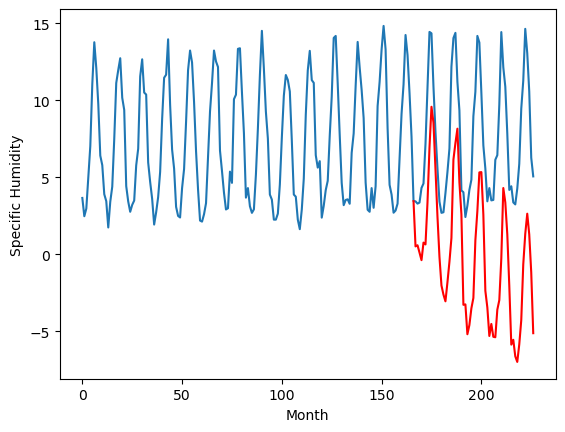

RangeIndex(start=1, stop=12, step=1)
[-1.4400000000000013, -1.0, -1.9, -1.5099999999999993, 2.209999999999999, 3.3500000000000005, 0.7000000000000002, 3.110000000000001, 4.03, 0.7999999999999996, 0.6200000000000001]
[-0.5017809295654301, -0.8151881027221677, -2.194915466308594, -2.202036266326904, 1.9009701538085935, 2.1005033683776855, 0.6563620758056636, 2.3960615730285646, 2.8358279037475587, -0.12622497558593748, 0.510348854064941]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.44  -0.501781
1                 1   -1.00  -0.815188
2                 2   -1.90  -2.194915
3                 3   -1.51  -2.202036
4                 4    2.21   1.900970
5                 5    3.35   2.100503
6                 6    0.70   0.656362
7                 7    3.11   2.396062
8                 8    4.03   2.835828
9                 9    0.80  -0.126225
10               10    0.62   0.510349


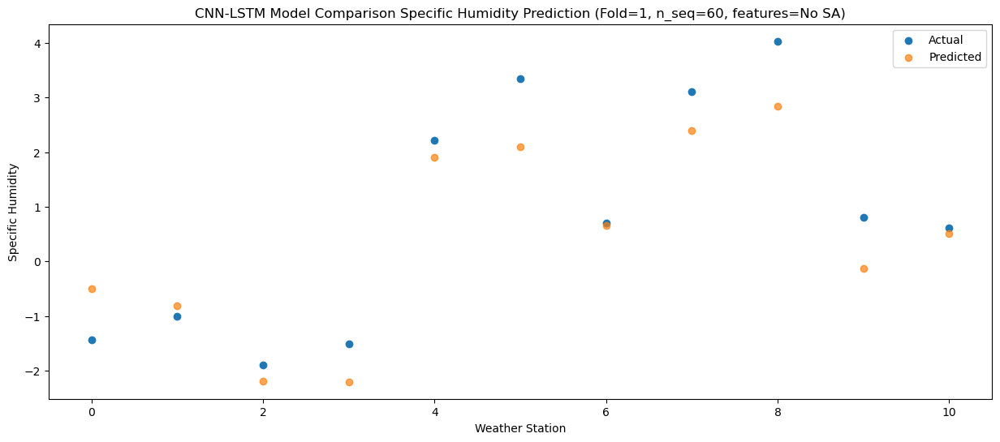

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.84  -0.295798
1                 1   -0.95  -0.663361
2                 2   -0.99  -2.042307
3                 3   -2.71  -2.222259
4                 4    0.97   1.871780
5                 5    1.87   2.021223
6                 6    0.73   0.814831
7                 7    2.78   2.335364
8                 8    3.19   2.617248
9                 9    0.15  -0.332716
10               10    0.61   0.585763


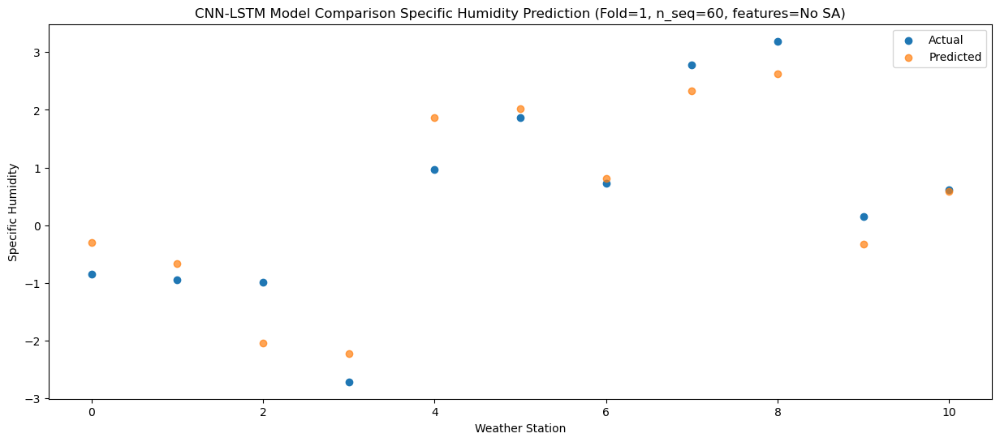

Predictions for (t+2):
    Weather_Station        Actual  Predicted
0                 0 -1.030000e+00  -0.732649
1                 1 -1.200000e+00  -1.093653
2                 2 -1.500000e+00  -2.459806
3                 3 -1.810000e+00  -2.623234
4                 4  1.880000e+00   1.470808
5                 5  1.590000e+00   1.679657
6                 6  3.100000e-01   0.378915
7                 7  2.700000e+00   1.916613
8                 8  3.640000e+00   2.206661
9                 9 -2.775558e-16  -0.699773
10               10  4.600000e-01   0.107265


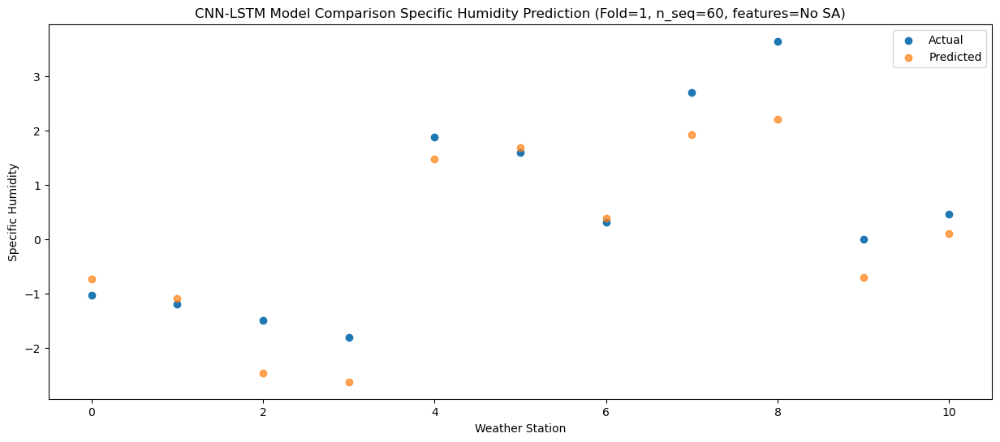

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.12  -0.923710
1                 1   -0.68  -1.324993
2                 2   -1.11  -2.636478
3                 3   -2.51  -2.949590
4                 4    1.20   1.133940
5                 5    1.77   1.062057
6                 6    0.79   0.135325
7                 7    2.58   1.486870
8                 8    3.02   1.603586
9                 9    0.01  -1.408087
10               10    0.53  -0.384658


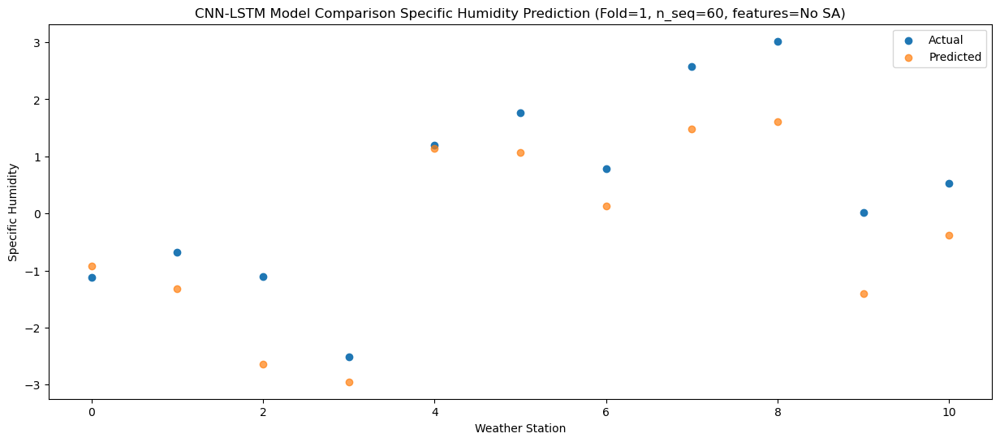

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.18   1.248788
1                 1    1.55   0.854470
2                 2    2.05  -0.158077
3                 3    1.85  -0.452818
4                 4    5.93   3.615080
5                 5    4.44   2.771567
6                 6    2.76   2.221511
7                 7    5.24   3.585516
8                 8    6.04   3.497504
9                 9    1.90   0.199469
10               10    1.48   0.757440


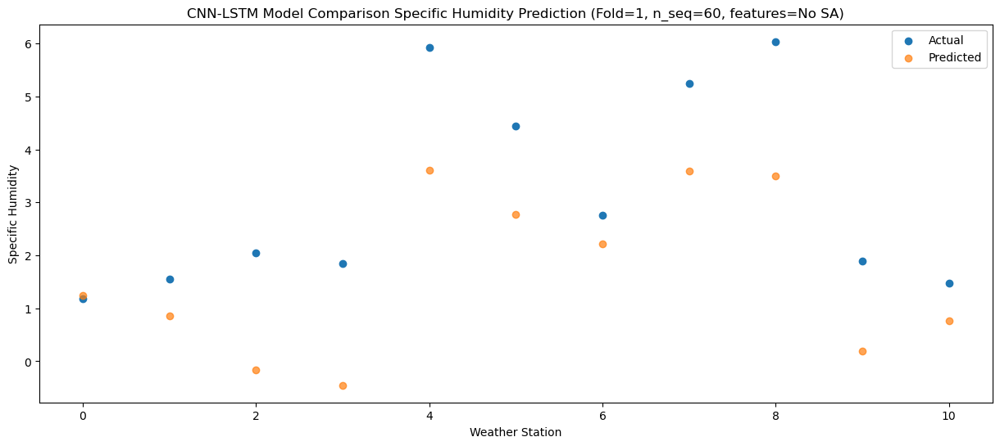

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    0.92   0.692424
1                 1   -0.04   0.328367
2                 2    0.43  -0.783054
3                 3    1.51  -0.967910
4                 4    5.62   3.111771
5                 5    3.43   2.719944
6                 6    2.11   1.722776
7                 7    5.50   3.226304
8                 8    6.23   3.321607
9                 9    2.06   0.203019
10               10    1.77   0.638274


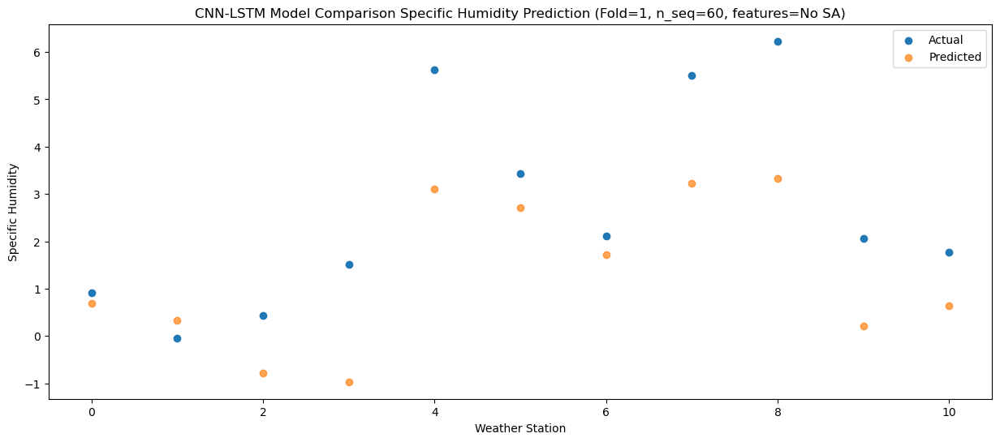

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    3.82   3.377695
1                 1    2.97   3.105459
2                 2    3.20   1.994318
3                 3    3.49   1.917763
4                 4    7.74   6.004240
5                 5    6.11   5.387110
6                 6    5.31   4.485962
7                 7    8.40   6.169790
8                 8    9.56   6.362338
9                 9    4.88   3.074485
10               10    4.34   3.365669


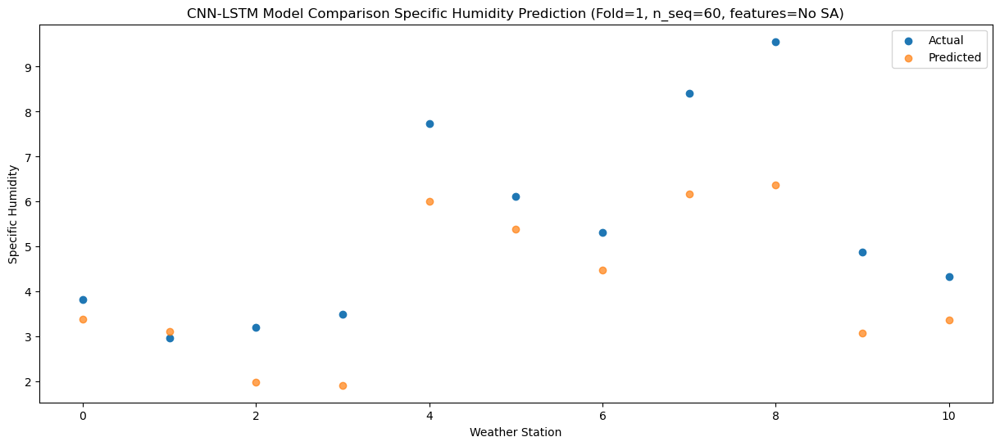

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.06   7.055706
1                 1    6.77   6.770685
2                 2    7.05   5.652108
3                 3    5.61   5.433469
4                 4   10.03   9.512889
5                 5    7.93   8.243541
6                 6    8.95   8.153020
7                 7   12.23   9.685063
8                 8   11.70   9.724545
9                 9    6.59   6.046070
10               10    7.98   6.924548


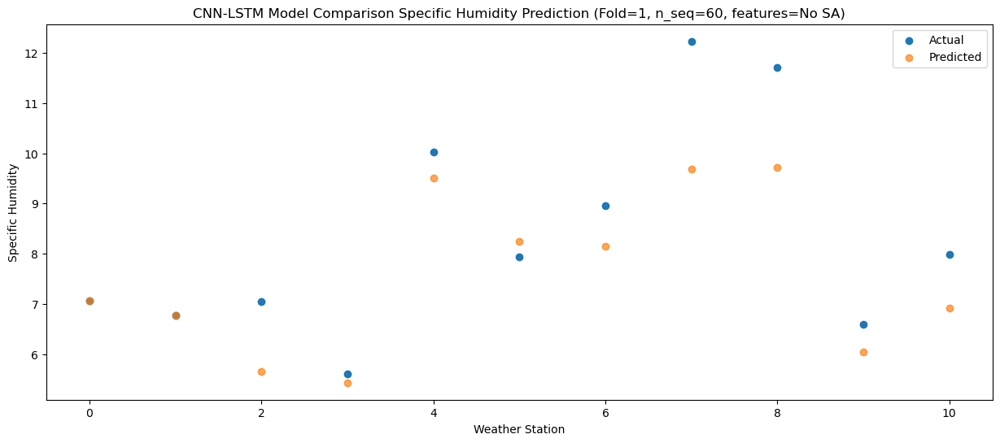

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    9.63   9.442373
1                 1    8.81   9.195320
2                 2    9.60   7.994798
3                 3    8.12   7.803117
4                 4   12.63  11.888782
5                 5    8.92  10.247998
6                 6   11.39  10.596037
7                 7   15.31  12.189481
8                 8   15.06  12.288625
9                 9    9.48   8.288880
10               10   11.62   9.585110


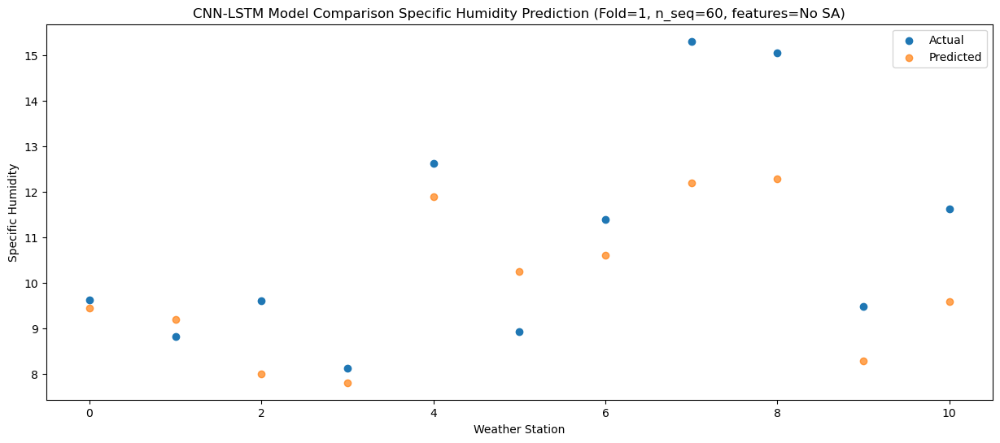

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    9.92   8.503455
1                 1    8.86   8.109828
2                 2    9.12   6.860807
3                 3    7.01   6.297869
4                 4   11.18  10.366705
5                 5    7.69   8.861683
6                 6   11.41   9.543829
7                 7   13.14  10.646796
8                 8   12.16  10.455534
9                 9    8.16   6.596511
10               10   11.53   8.549849


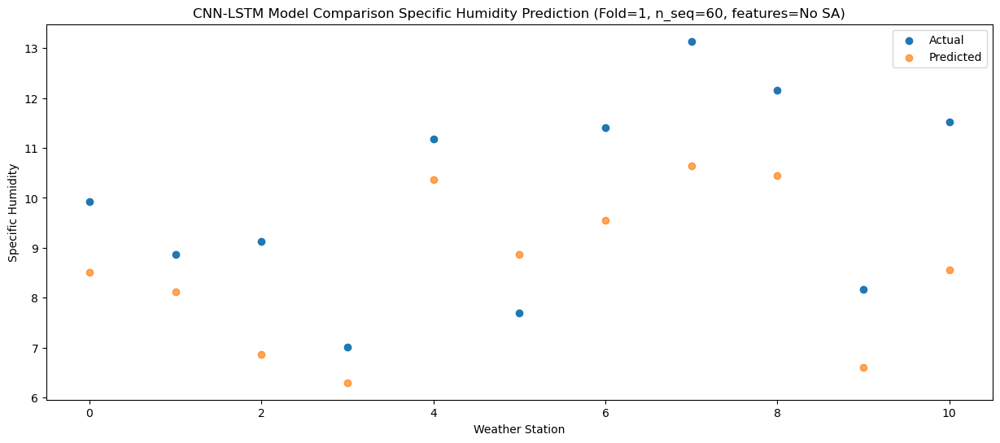

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    7.30   6.040677
1                 1    5.96   5.590203
2                 2    6.17   4.503898
3                 3    5.43   3.918861
4                 4    9.69   7.976826
5                 5    7.26   6.504753
6                 6    8.10   6.983437
7                 7   11.34   8.013962
8                 8   10.68   7.698664
9                 9    5.37   3.976354
10               10    8.05   5.545503


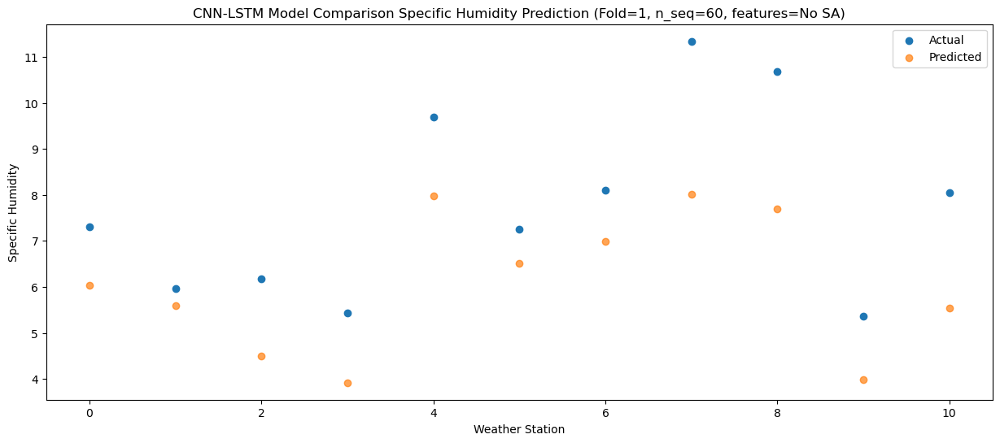

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.62   2.634361
1                 1    3.29   2.065939
2                 2    3.41   0.832352
3                 3    2.03  -0.048996
4                 4    5.84   4.001647
5                 5    3.75   2.979277
6                 6    5.61   3.520608
7                 7    6.52   4.162652
8                 8    6.01   3.697320
9                 9    1.85   0.239685
10               10    5.13   2.454925


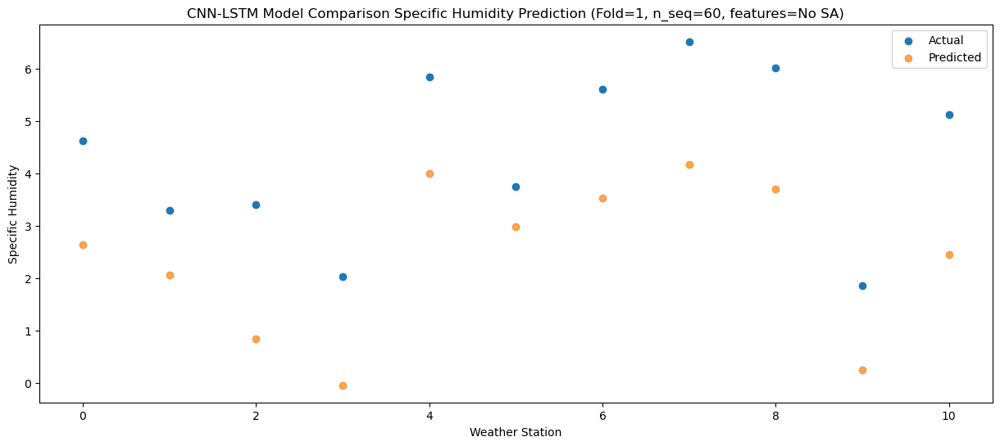

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.99  -0.536243
1                 1    0.23  -0.958182
2                 2    0.23  -2.242223
3                 3   -0.07  -2.640940
4                 4    3.36   1.438075
5                 5    3.19   1.073782
6                 6    2.50   0.495212
7                 7    4.50   1.752869
8                 8    4.90   1.778486
9                 9    1.53  -1.413245
10               10    2.75  -0.170193


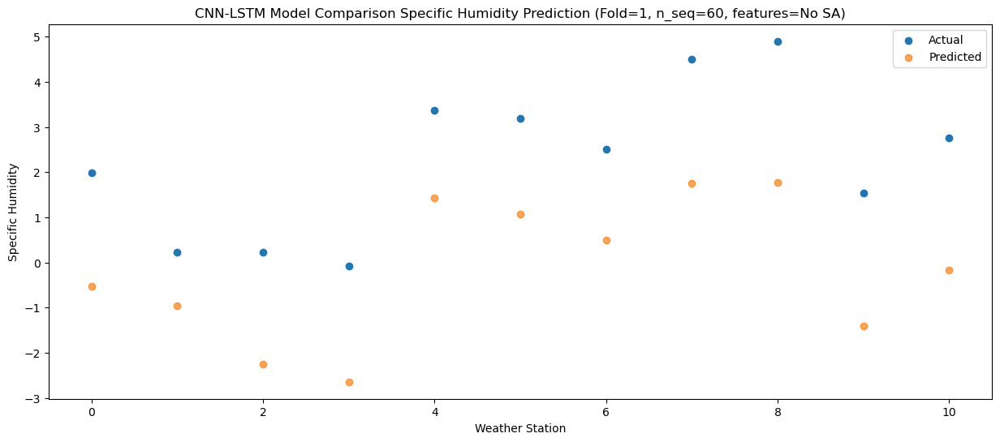

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.22  -3.214366
1                 1   -2.36  -3.550945
2                 2   -2.54  -5.016217
3                 3   -2.62  -5.163157
4                 4    0.54  -1.060667
5                 5    0.75  -0.554355
6                 6   -0.22  -2.052075
7                 7    2.18  -0.464629
8                 8    2.62  -0.057826
9                 9   -0.33  -2.874565
10               10    0.59  -2.027948


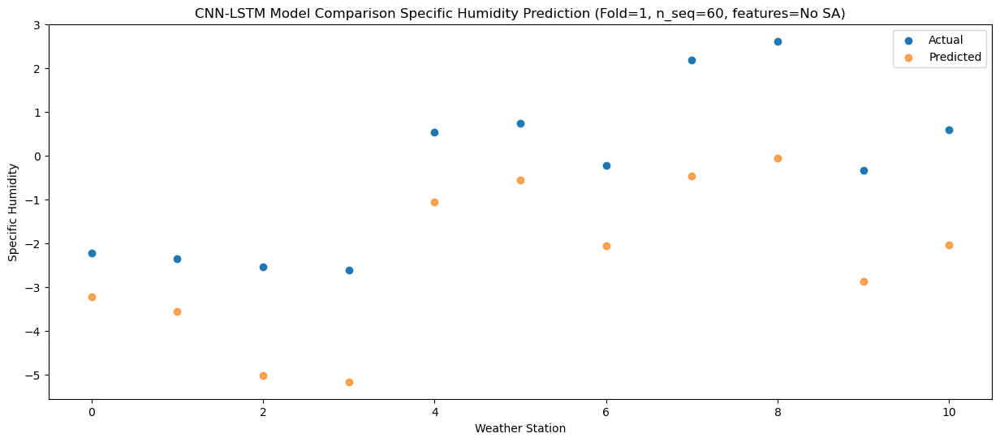

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.00  -3.586532
1                 1   -2.34  -3.917483
2                 2   -2.39  -5.300852
3                 3   -2.96  -5.379460
4                 4    0.29  -1.278294
5                 5    1.58  -0.721324
6                 6   -0.33  -2.443529
7                 7    2.05  -0.783518
8                 8    2.78  -0.366290
9                 9   -0.14  -3.108045
10               10   -0.14  -2.622610


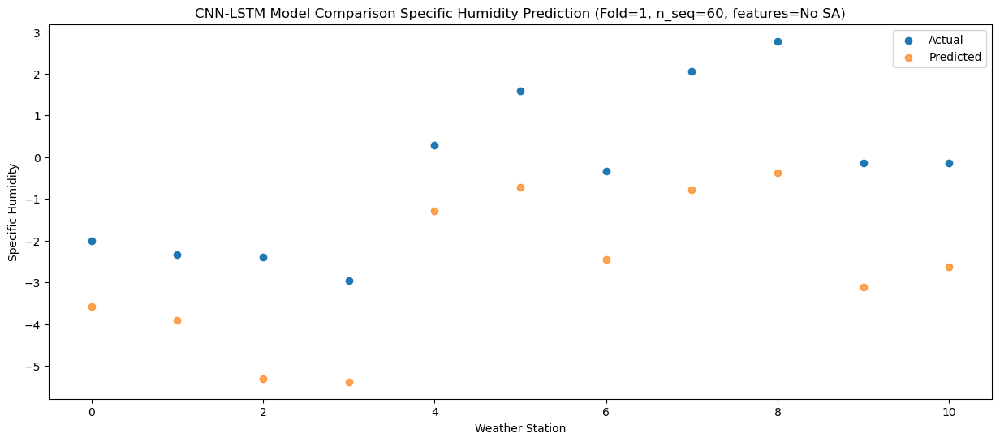

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.68  -3.729879
1                 1   -2.15  -4.151047
2                 2   -2.39  -5.500809
3                 3   -2.89  -5.822394
4                 4    0.33  -1.736080
5                 5    0.95  -1.437657
6                 6   -0.21  -2.675493
7                 7    1.53  -1.331557
8                 8    1.97  -1.166334
9                 9   -0.88  -3.987793
10               10   -0.10  -3.059636


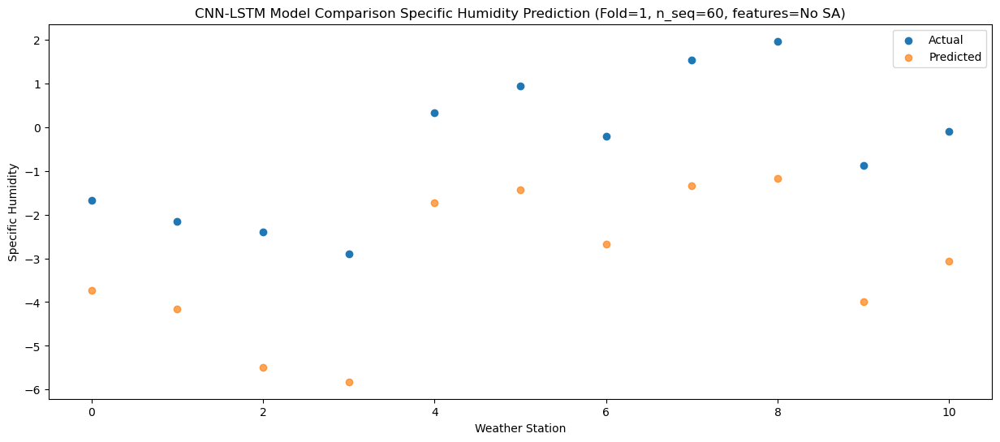

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -0.15  -1.850483
1                 1   -0.62  -2.208112
2                 2    0.23  -3.354252
3                 3   -0.25  -3.564732
4                 4    3.05   0.516806
5                 5    1.74   0.231971
6                 6    1.35  -0.804096
7                 7    4.26   0.694509
8                 8    4.58   0.807522
9                 9    0.94  -2.262768
10               10    1.14  -1.827383


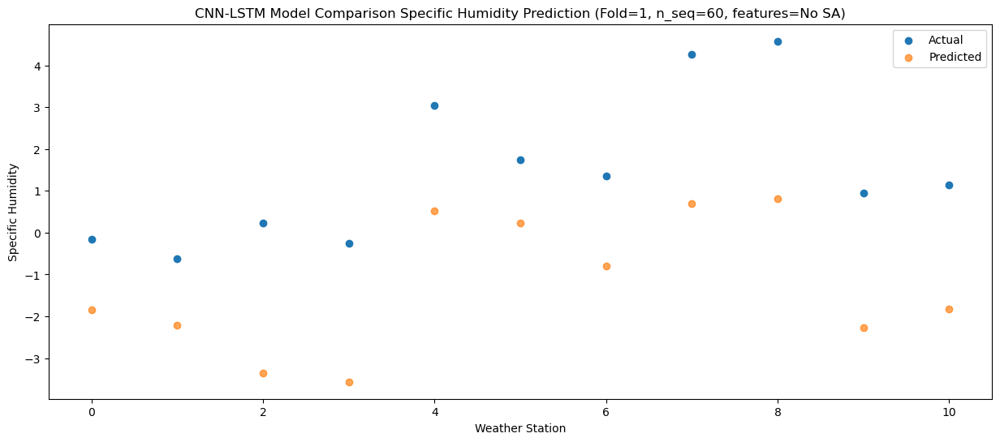

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.05  -0.888738
1                 1   -0.26  -1.233967
2                 2   -0.06  -2.482792
3                 3    1.09  -2.662112
4                 4    4.31   1.426353
5                 5    3.04   1.165346
6                 6    1.97   0.199175
7                 7    5.49   1.741997
8                 8    5.74   1.946132
9                 9    1.11  -1.201941
10               10    2.51  -0.496731


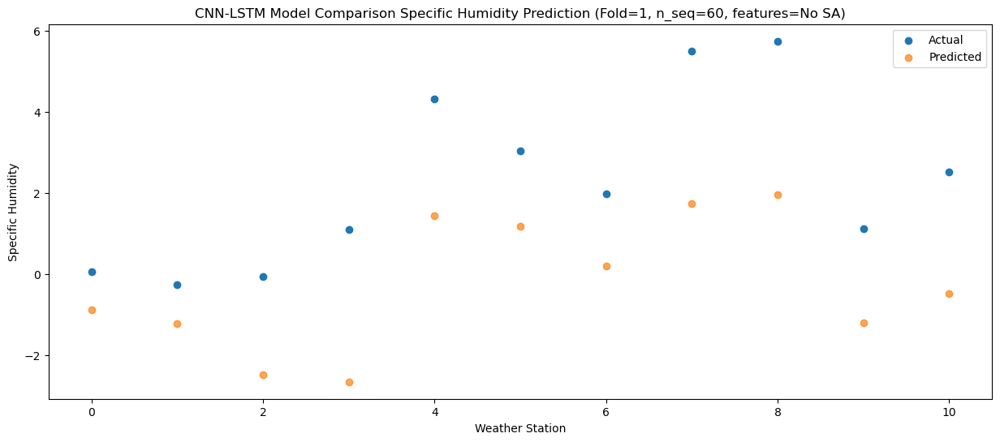

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    2.73   1.293849
1                 1    2.66   1.002923
2                 2    2.78  -0.027997
3                 3    4.98  -0.016290
4                 4    8.34   4.069184
5                 5    7.35   3.378929
6                 6    4.90   2.361972
7                 7    8.70   4.133412
8                 8    9.96   4.340135
9                 9    6.26   1.026308
10               10    4.04   1.059586


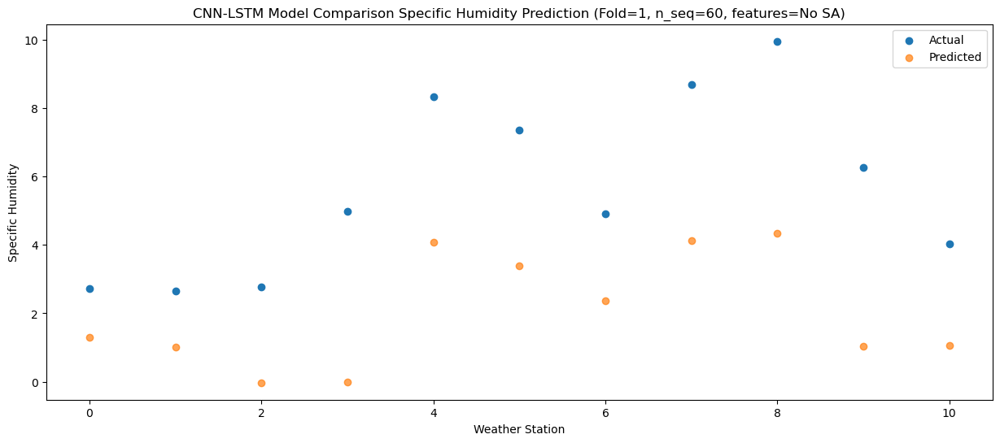

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.89   6.341382
1                 1    6.64   6.032504
2                 2    7.30   4.914687
3                 3    8.17   4.659809
4                 4   11.75   8.737212
5                 5    9.52   7.325663
6                 6    9.25   7.416651
7                 7   13.46   8.904517
8                 8   13.10   8.907425
9                 9    9.25   5.124522
10               10    9.36   6.151248


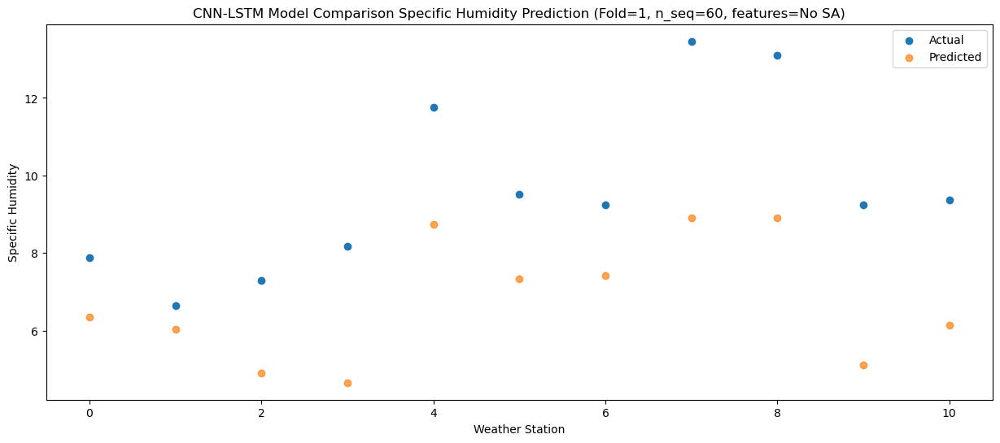

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.04   7.166633
1                 1    8.51   6.860101
2                 2    8.89   5.656799
3                 3    8.65   5.360626
4                 4   11.93   9.440494
5                 5   10.85   8.054759
6                 6   11.75   8.269391
7                 7   14.09   9.722745
8                 8   14.15   9.740837
9                 9   10.49   5.925981
10               10   11.22   7.222711


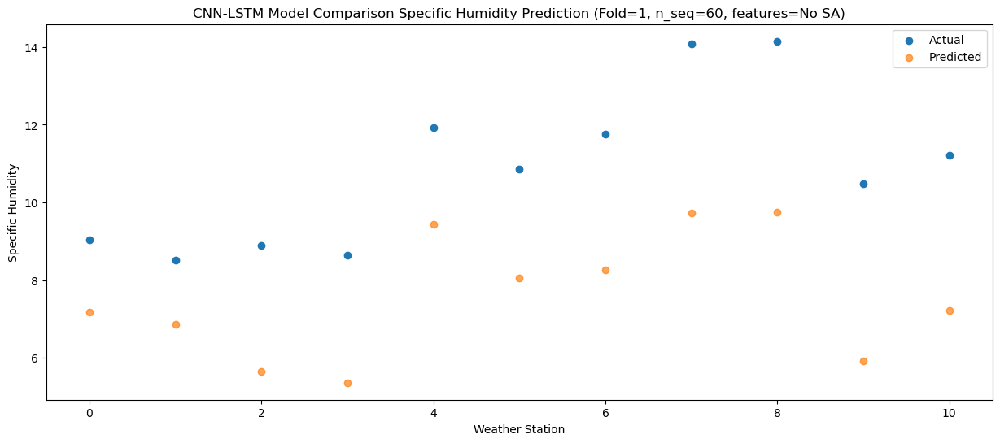

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.80   7.868180
1                 1    8.72   7.516611
2                 2    9.11   6.205415
3                 3    8.99   5.751789
4                 4   11.97   9.829180
5                 5   11.07   8.227788
6                 6   12.04   8.963983
7                 7   13.94  10.225836
8                 8   13.73  10.159045
9                 9    9.46   6.155800
10               10   11.56   8.161344


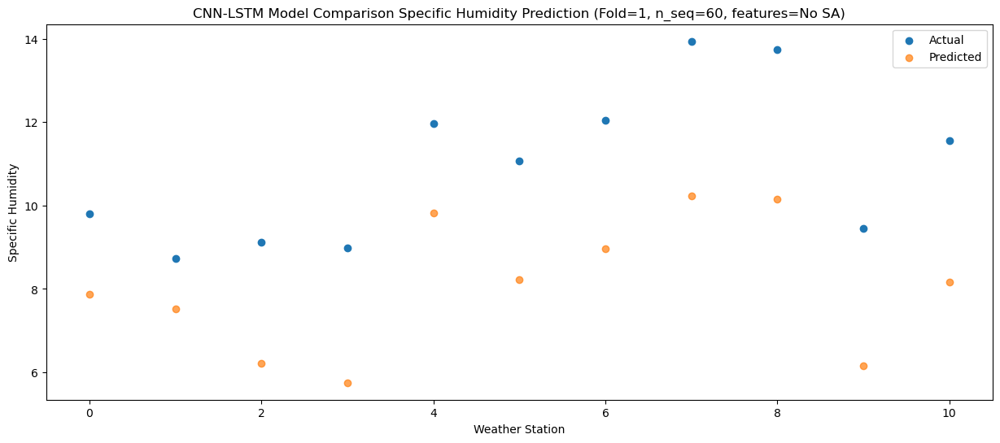

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    6.32   4.503319
1                 1    5.77   4.067004
2                 2    6.35   2.782442
3                 3    5.90   2.221440
4                 4    8.87   6.291527
5                 5    7.53   5.063229
6                 6    8.69   5.519562
7                 7   10.69   6.609109
8                 8   10.16   6.447127
9                 9    6.50   2.728386
10               10    8.37   4.666846


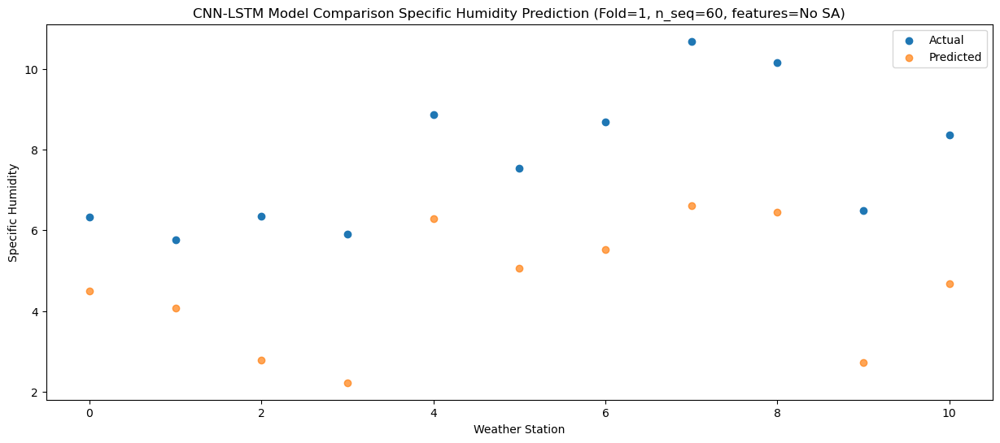

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    3.74   2.054420
1                 1    3.73   1.661283
2                 2    3.60   0.287493
3                 3    3.65  -0.174889
4                 4    6.92   3.905696
5                 5    4.42   3.029969
6                 6    6.56   3.135844
7                 7    7.96   4.363810
8                 8    7.72   4.362865
9                 9    3.06   0.791913
10               10    6.51   2.595766


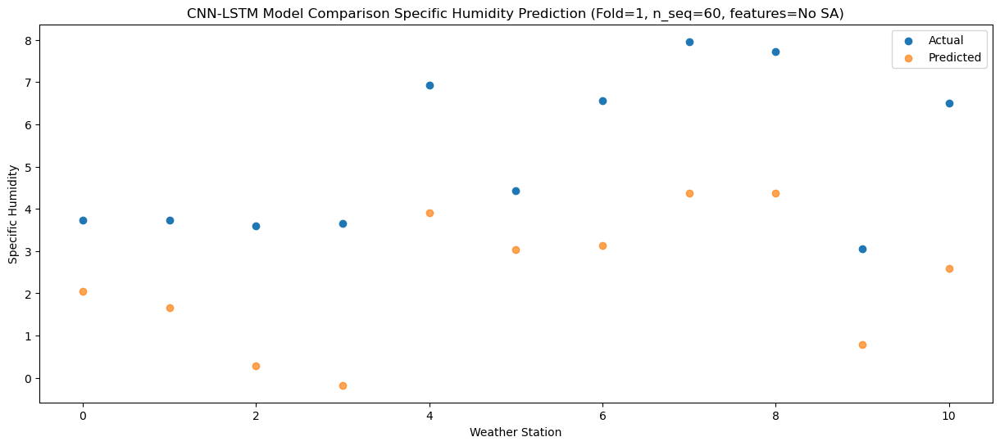

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.92  -4.260186
1                 1   -1.86  -4.618218
2                 2   -1.90  -6.006514
3                 3   -0.80  -6.073215
4                 4    2.33  -1.972150
5                 5    2.58  -1.374297
6                 6    0.63  -3.137498
7                 7    3.40  -1.472795
8                 8    4.19  -1.059463
9                 9    0.70  -3.784213
10               10    1.32  -3.288502


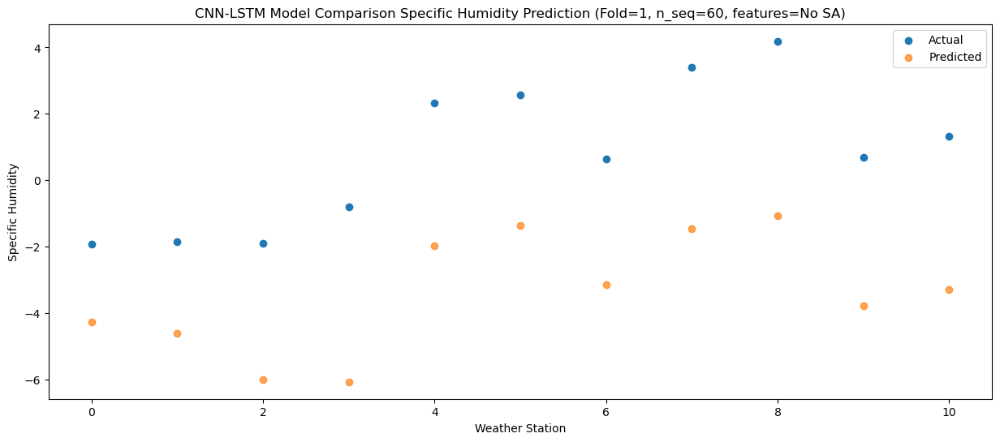

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.19  -2.674040
1                 1    0.31  -3.126741
2                 2    0.74  -4.145072
3                 3    2.12  -4.556299
4                 4    5.26  -0.493617
5                 5    1.53  -1.313440
6                 6    2.50  -1.748789
7                 7    5.04  -0.520078
8                 8    3.58  -0.704265
9                 9   -0.28  -3.980184
10               10    1.20  -3.257226


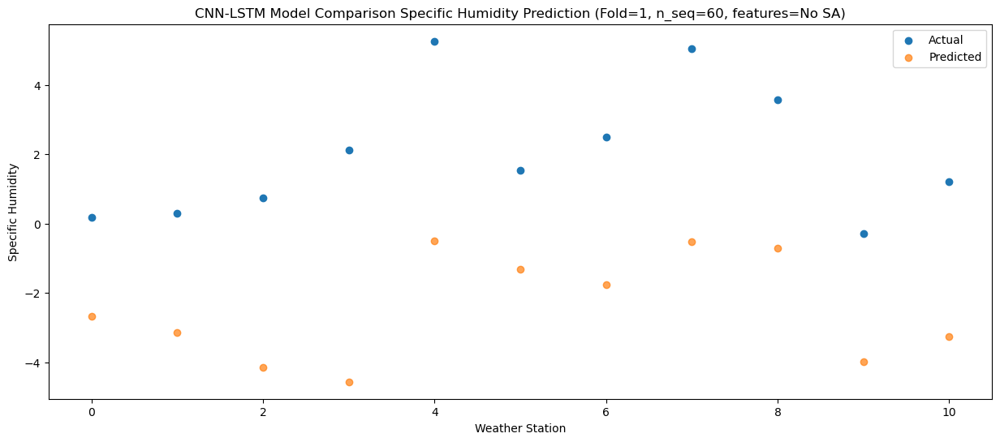

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -3.06  -6.112734
1                 1   -2.69  -6.486520
2                 2   -3.14  -7.889280
3                 3   -3.53  -8.093144
4                 4   -0.28  -3.996884
5                 5    0.26  -3.375521
6                 6   -0.50  -4.999281
7                 7    1.29  -3.480582
8                 8    1.60  -3.161512
9                 9   -0.92  -5.832830
10               10   -0.41  -5.197919


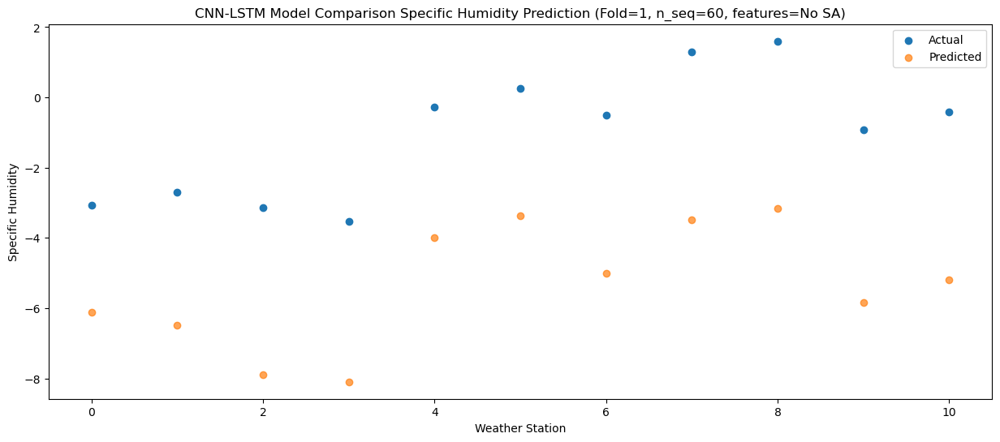

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.12  -5.189997
1                 1   -1.74  -5.611750
2                 2   -2.11  -6.968093
3                 3   -3.36  -7.368857
4                 4   -0.08  -3.285284
5                 5    0.14  -3.143343
6                 6    0.63  -4.133793
7                 7    1.97  -2.857004
8                 8    2.13  -2.761597
9                 9   -1.00  -5.661905
10               10    0.33  -4.600528


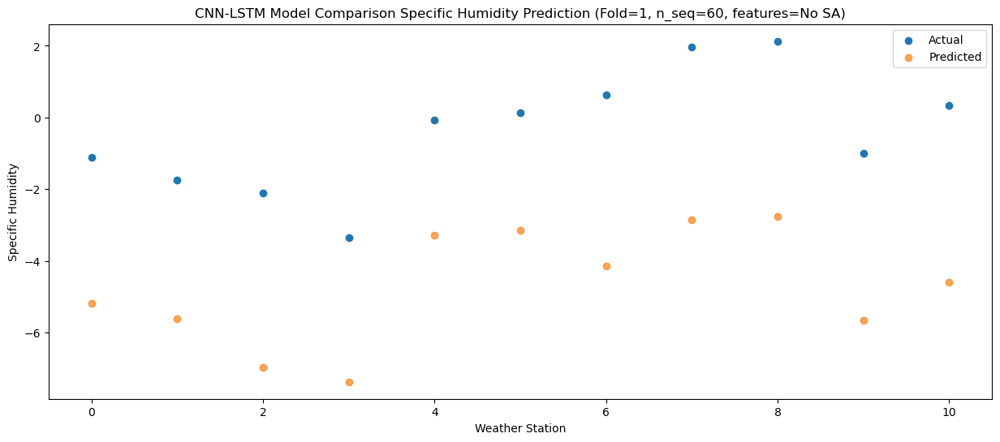

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -0.01  -3.947656
1                 1   -1.06  -4.361183
2                 2   -1.32  -5.668231
3                 3   -1.68  -6.043085
4                 4    1.62  -1.960921
5                 5    0.69  -1.853430
6                 6    1.38  -2.899871
7                 7    3.50  -1.593731
8                 8    3.22  -1.508486
9                 9   -0.04  -4.406024
10               10    1.35  -3.515757


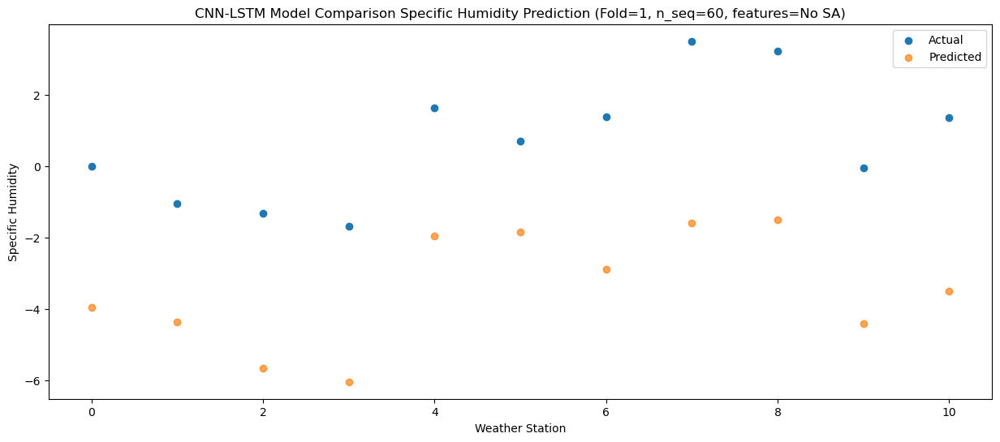

Predictions for (t+29):
    Weather_Station        Actual  Predicted
0                 0  1.010000e+00  -2.633541
1                 1  1.332268e-15  -3.013923
2                 2  4.400000e-01  -4.111734
3                 3  2.480000e+00  -4.372087
4                 4  5.720000e+00  -0.295928
5                 5  2.960000e+00  -0.759955
6                 6  2.570000e+00  -1.620713
7                 7  5.690000e+00  -0.179208
8                 8  6.340000e+00  -0.153101
9                 9  9.300000e-01  -3.296944
10               10  2.010000e+00  -2.840482


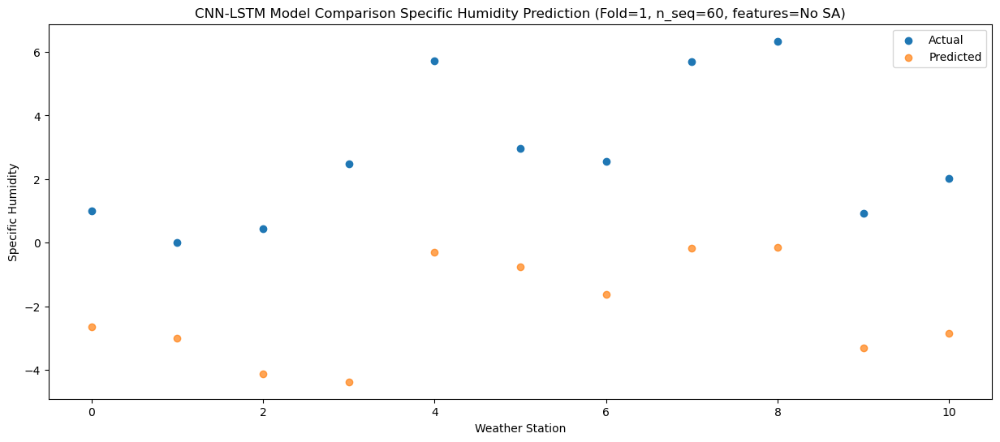

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    4.99   1.570529
1                 1    4.17   1.206482
2                 2    4.80   0.200655
3                 3    6.29  -0.167686
4                 4    9.60   3.898041
5                 5    4.73   2.547194
6                 6    6.83   2.566029
7                 7   10.14   3.902587
8                 8   10.58   3.735489
9                 9    3.49   0.115777
10               10    6.14   0.907500


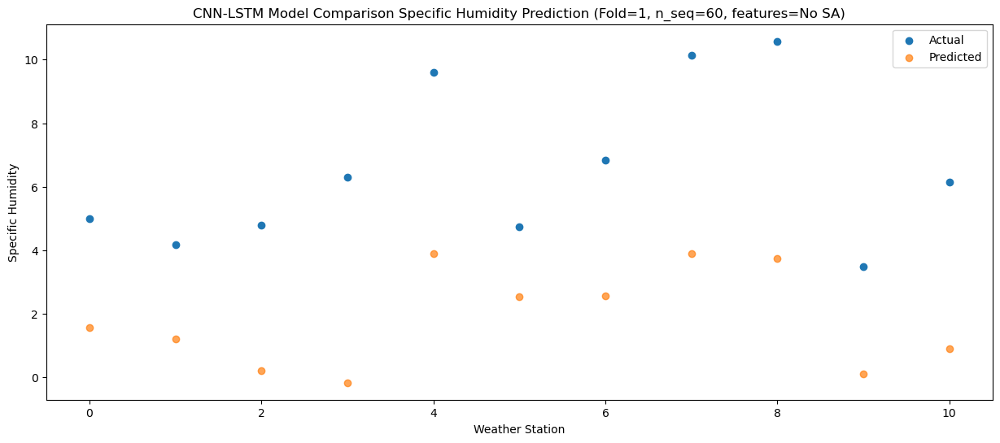

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    7.29   3.566348
1                 1    6.57   3.223079
2                 2    7.89   2.267168
3                 3    7.34   1.998258
4                 4   10.72   6.066394
5                 5    7.33   4.715494
6                 6    9.55   4.565675
7                 7   12.90   6.018382
8                 8   12.48   5.902240
9                 9    7.67   2.296275
10               10    7.73   2.810273


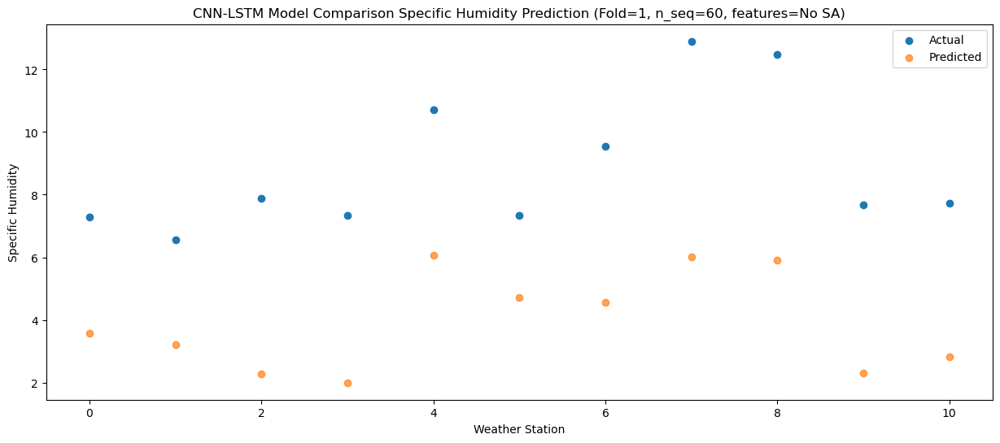

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    9.91   5.660718
1                 1    9.24   5.278061
2                 2    9.52   4.133298
3                 3    8.26   3.605021
4                 4   11.47   7.670649
5                 5    8.28   6.200681
6                 6   12.54   6.680721
7                 7   13.87   7.839983
8                 8   11.84   7.609995
9                 9    8.32   3.850812
10               10   11.36   5.320866


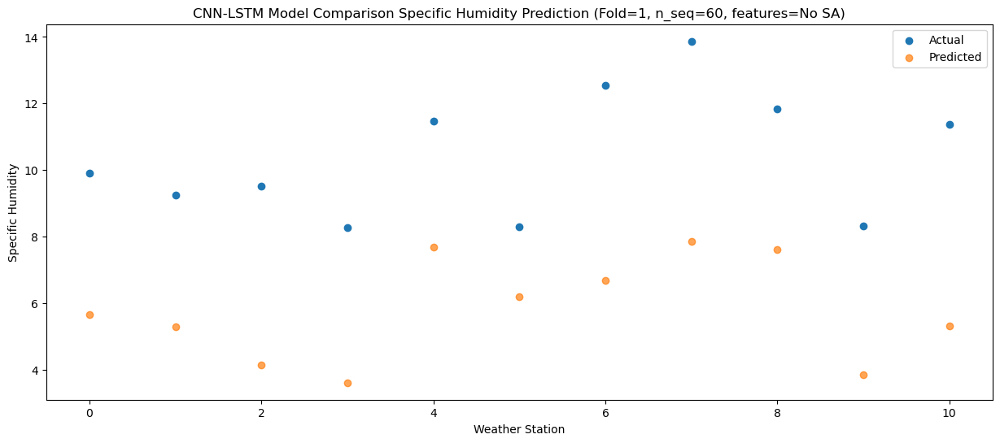

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    8.91   5.461293
1                 1    8.83   5.078886
2                 2    8.65   3.894040
3                 3    8.51   3.443327
4                 4   11.85   7.514914
5                 5   10.39   6.253802
6                 6   11.45   6.495566
7                 7   13.78   7.741758
8                 8   12.58   7.611408
9                 9    8.73   3.929066
10               10   10.93   5.339075


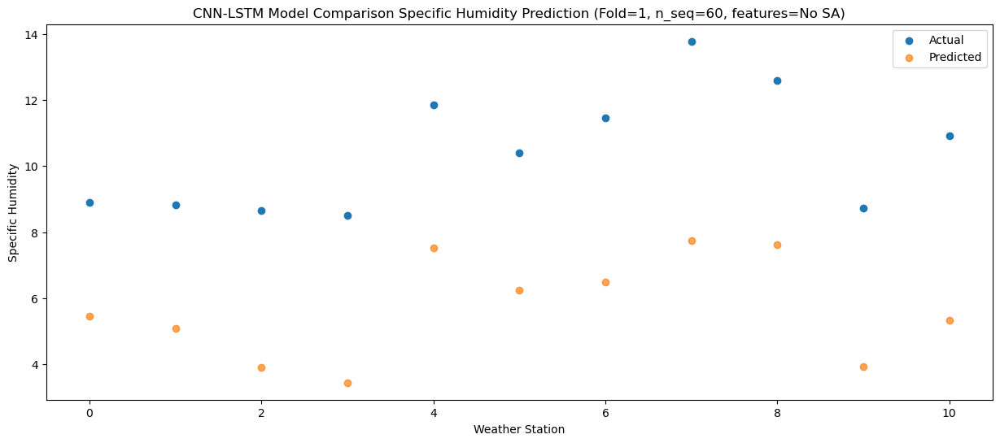

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.29   2.404552
1                 1    5.47   1.983618
2                 2    5.14   0.705844
3                 3    5.22   0.200432
4                 4    8.50   4.274028
5                 5    9.12   3.543438
6                 6    7.97   3.434139
7                 7    9.82   4.596474
8                 8    9.84   4.497340
9                 9    6.73   1.098807
10               10    7.68   2.571535


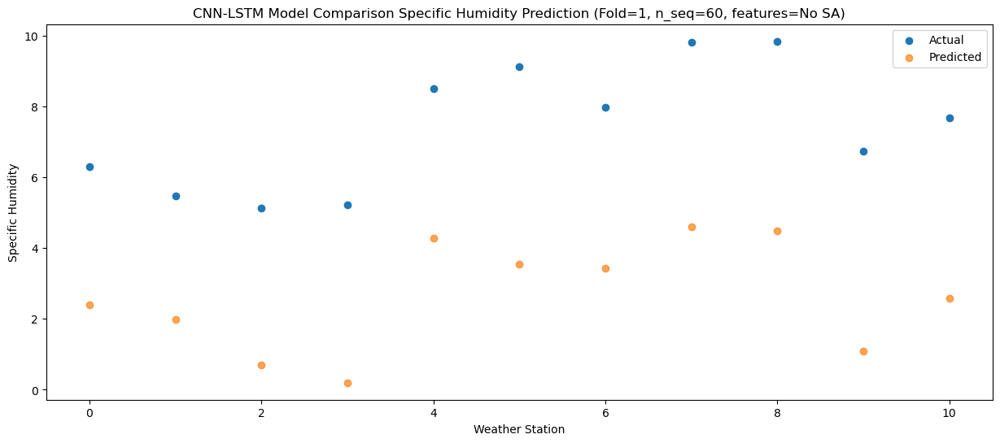

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    1.43  -3.144738
1                 1    0.58  -3.591296
2                 2    0.03  -5.011072
3                 3    0.26  -5.445588
4                 4    3.60  -1.360311
5                 5    5.93  -0.944521
6                 6    2.91  -2.090184
7                 7    5.28  -0.868080
8                 8    5.89  -0.764077
9                 9    3.34  -3.538051
10               10    4.24  -2.374535


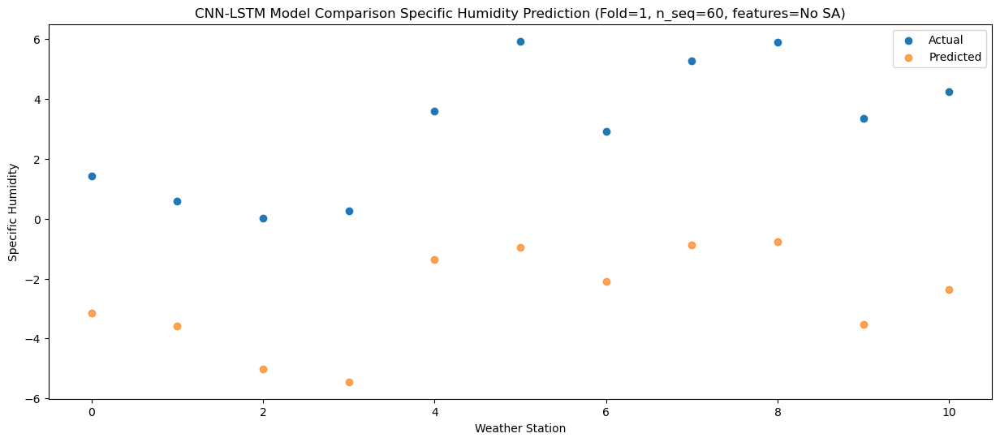

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    0.90  -3.688831
1                 1    0.10  -4.167543
2                 2   -0.34  -5.472416
3                 3   -0.24  -6.079363
4                 4    3.22  -2.008893
5                 5    3.06  -2.363471
6                 6    2.42  -2.699050
7                 7    4.03  -1.683880
8                 8    4.91  -1.835374
9                 9    1.36  -4.981266
10               10    2.74  -3.460418


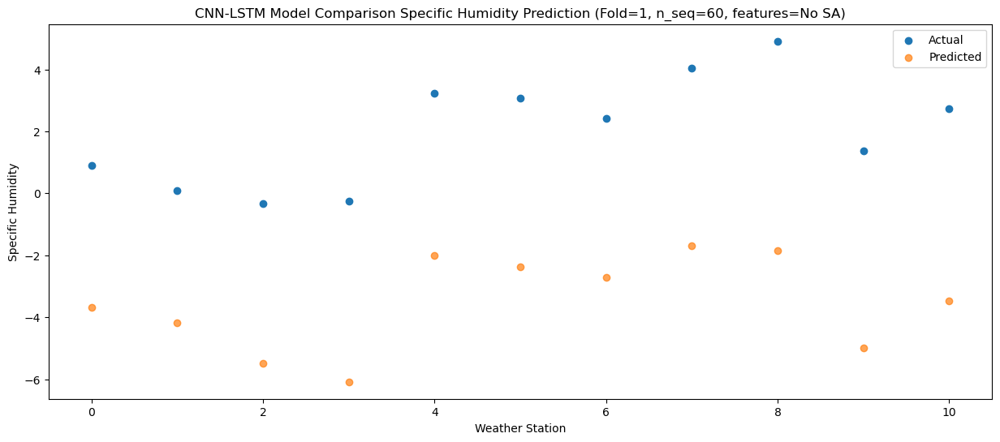

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.82  -5.496930
1                 1   -1.49  -5.946656
2                 2   -1.03  -7.200545
3                 3   -1.05  -7.655938
4                 4    2.40  -3.580384
5                 5    2.39  -3.598275
6                 6    0.52  -4.496322
7                 7    3.12  -3.303770
8                 8    3.17  -3.334889
9                 9    0.15  -6.263053
10               10    0.61  -5.311215


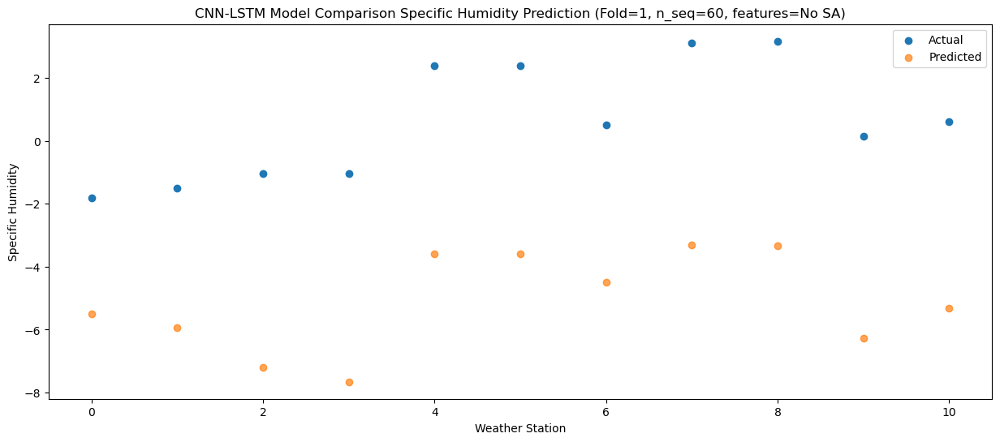

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -1.36  -5.024058
1                 1   -1.08  -5.480791
2                 2   -1.06  -6.841554
3                 3   -1.47  -7.353465
4                 4    1.92  -3.274987
5                 5    0.84  -3.067795
6                 6    0.88  -3.998246
7                 7    3.24  -2.866354
8                 8    2.69  -2.870076
9                 9   -0.16  -5.714527
10               10    1.47  -4.530886


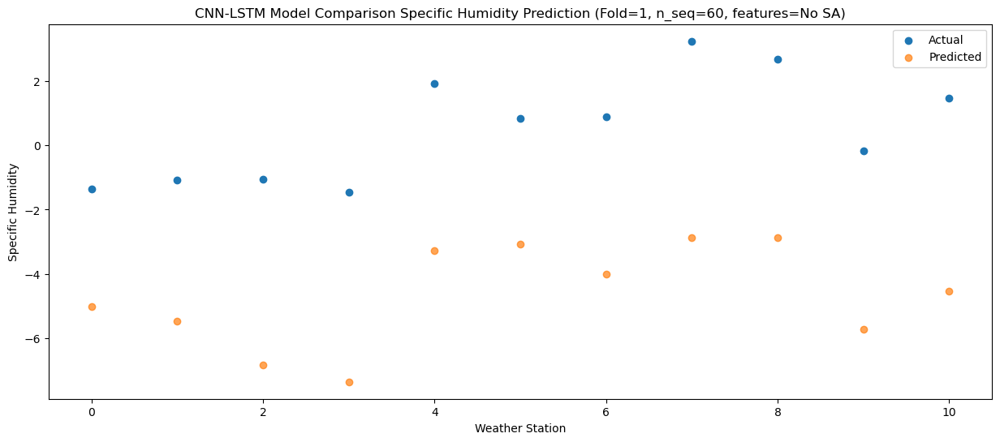

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.25  -4.948428
1                 1    0.04  -5.453156
2                 2   -0.01  -6.577939
3                 3   -0.69  -7.207541
4                 4    2.52  -3.148137
5                 5    0.87  -3.614528
6                 6    2.08  -4.037244
7                 7    3.34  -3.066454
8                 8    3.02  -3.350122
9                 9   -0.30  -6.427964
10               10    0.67  -5.365024


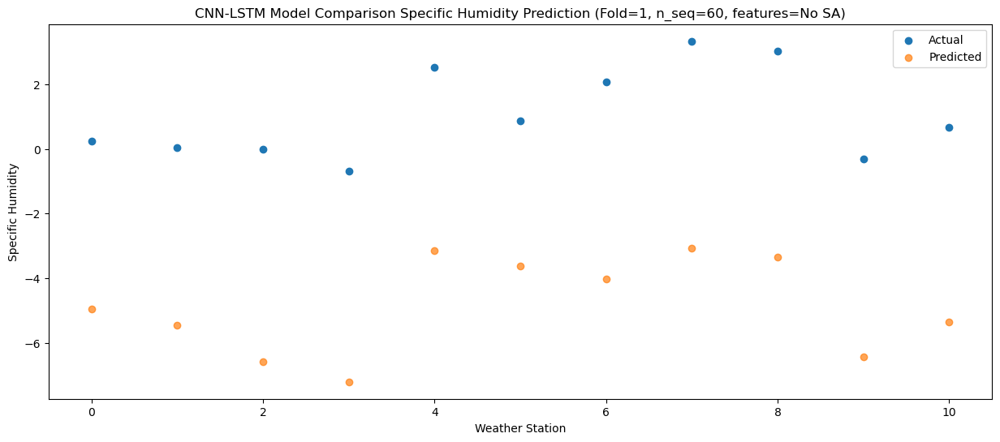

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -0.13  -4.819023
1                 1   -0.83  -5.305178
2                 2   -0.48  -6.337234
3                 3    0.86  -6.801378
4                 4    4.22  -2.738098
5                 5    1.92  -3.084877
6                 6    1.32  -3.917357
7                 7    4.10  -2.763363
8                 8    4.44  -2.953574
9                 9    0.49  -5.941691
10               10    0.70  -5.394962


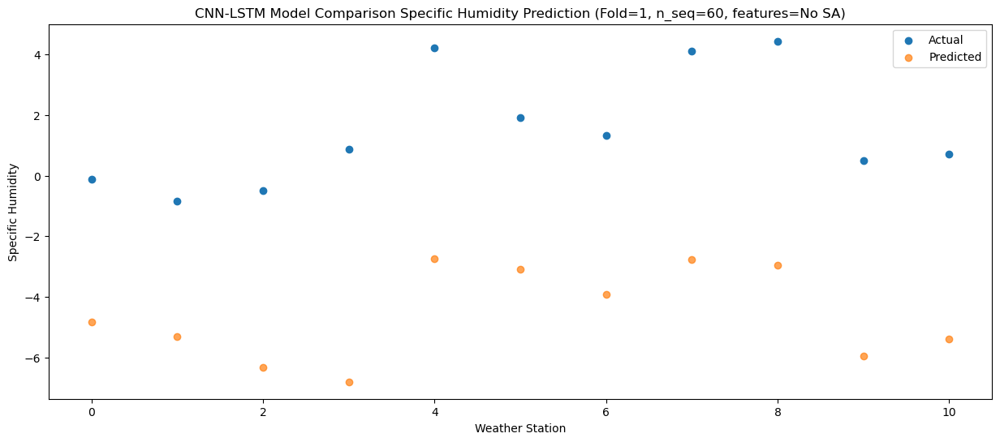

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    1.57  -3.345834
1                 1    0.77  -3.865821
2                 2    0.88  -5.040603
3                 3    1.23  -5.706181
4                 4    4.67  -1.645504
5                 5    2.18  -2.134336
6                 6    3.13  -2.431867
7                 7    5.30  -1.511672
8                 8    5.66  -1.797962
9                 9    1.01  -4.934666
10               10    3.31  -3.602724


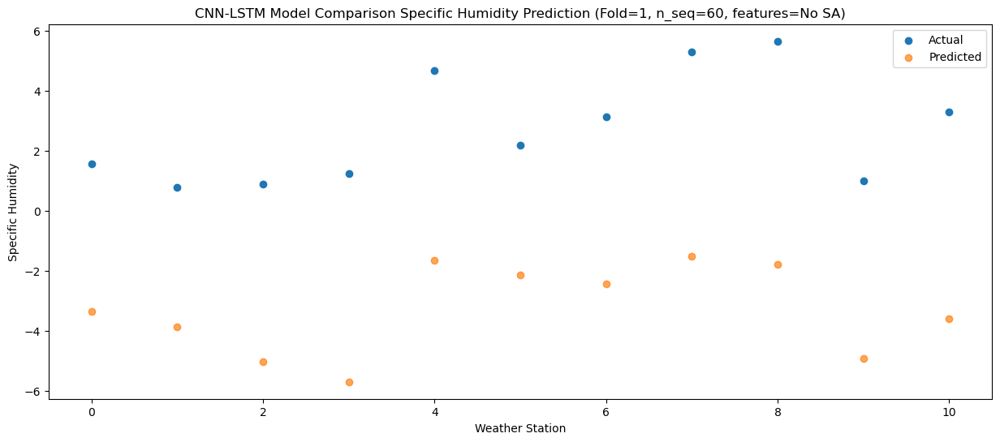

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    2.77  -1.990334
1                 1    3.51  -2.346801
2                 2    4.18  -3.194812
3                 3    5.01  -3.325440
4                 4    8.34   0.744718
5                 5    6.55   0.252664
6                 6    5.69  -1.032962
7                 7    9.34   0.546902
8                 8   10.71   0.528423
9                 9    6.74  -2.489709
10               10    3.61  -2.980640


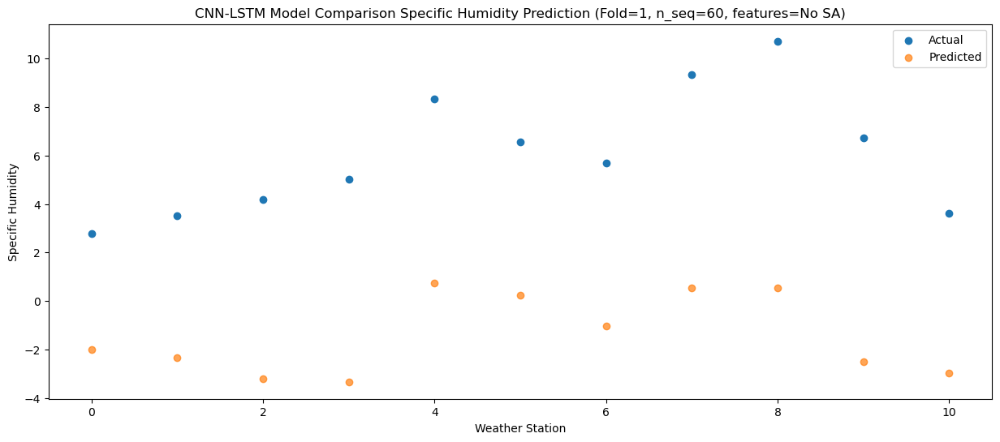

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.12   0.906195
1                 1    5.86   0.515577
2                 2    6.83  -0.311464
3                 3    8.41  -0.569318
4                 4   11.60   3.492908
5                 5    6.50   2.230536
6                 6    8.27   1.826920
7                 7   12.26   3.254805
8                 8   13.29   3.074793
9                 9    8.35  -0.400420
10               10    6.90  -0.262962


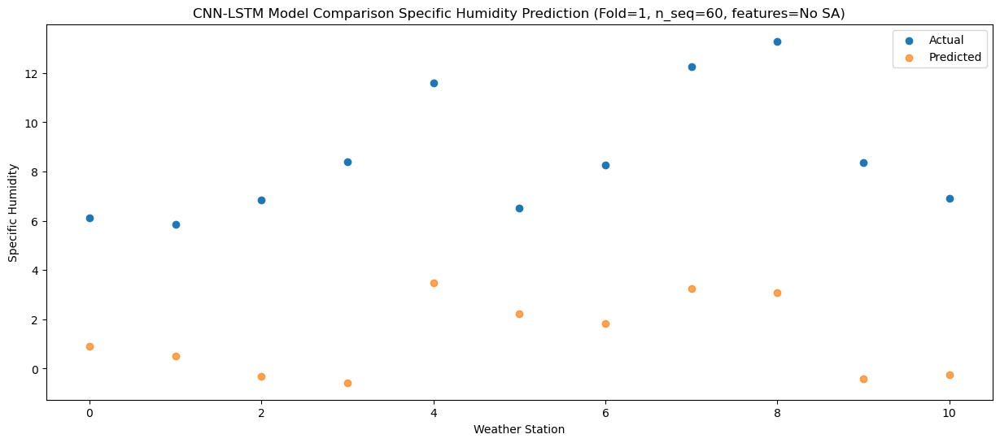

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    9.53   4.709457
1                 1    8.82   4.233324
2                 2    9.97   3.055398
3                 3    8.97   2.274668
4                 4   11.68   6.330436
5                 5    8.67   4.636641
6                 6   11.89   5.658574
7                 7   14.83   6.493049
8                 8   13.52   6.058704
9                 9   10.28   2.172317
10               10   11.61   4.304299


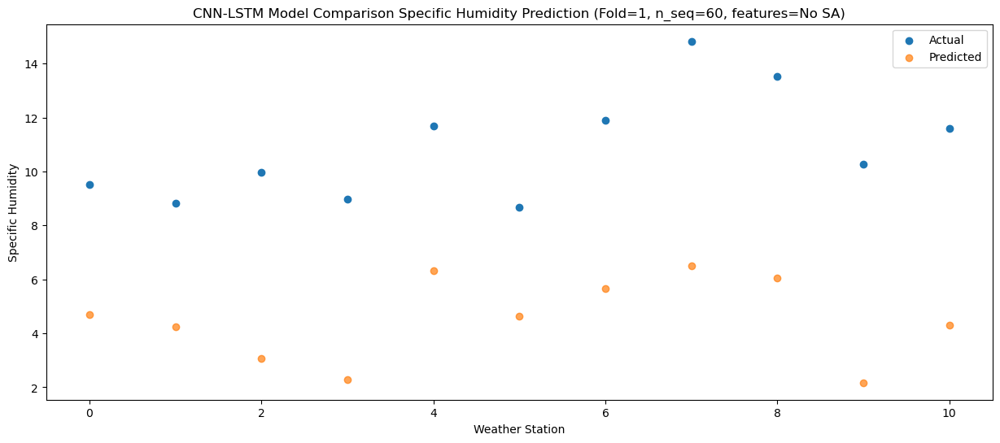

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.36   4.128946
1                 1    8.95   3.683302
2                 2    9.90   2.655904
3                 3    7.30   2.068043
4                 4   10.28   6.125491
5                 5    8.82   4.654214
6                 6   11.78   5.060221
7                 7   14.41   6.117341
8                 8   11.69   5.768784
9                 9    8.37   2.088222
10               10    9.32   3.369978


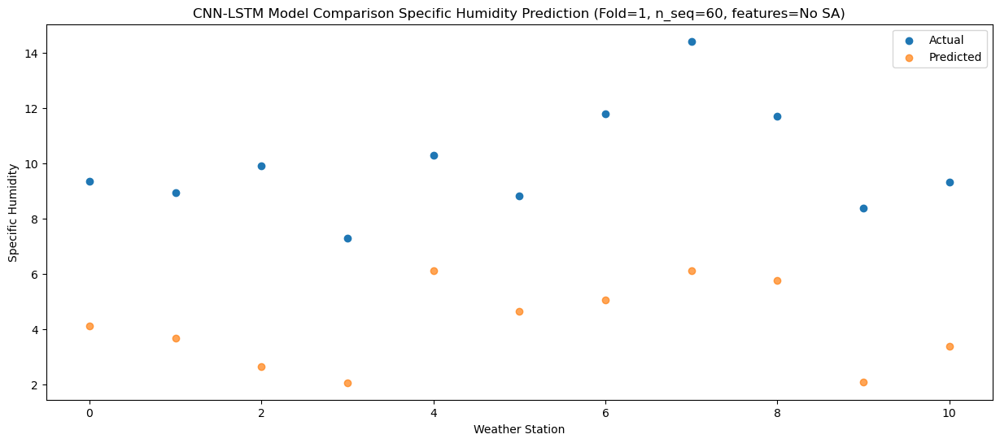

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    5.50   1.475424
1                 1    5.84   1.009514
2                 2    6.09  -0.171997
3                 3    6.10  -0.735168
4                 4    9.53   3.331839
5                 5    8.46   2.464739
6                 6    8.81   2.437934
7                 7    9.92   3.512585
8                 8   10.74   3.305962
9                 9    6.72  -0.107741
10               10    8.06   1.292942


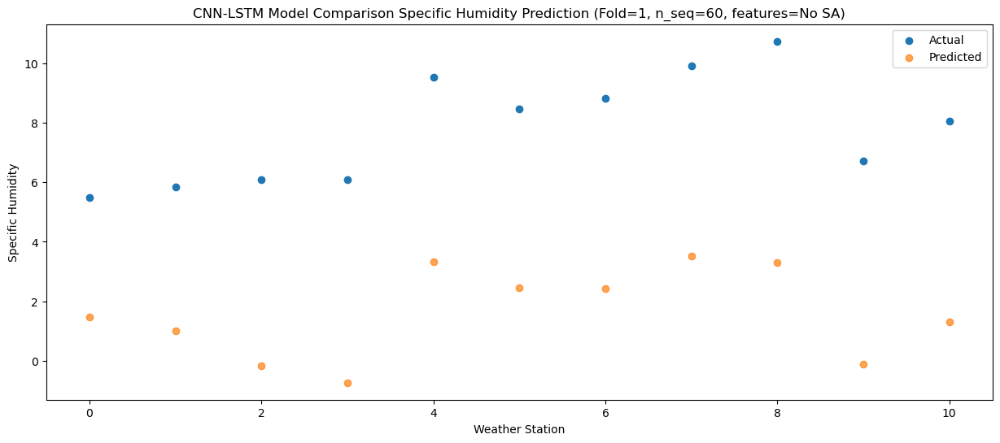

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    2.10  -2.464319
1                 1    1.99  -2.933755
2                 2    1.58  -4.261536
3                 3    2.68  -4.746012
4                 4    6.14  -0.666909
5                 5    6.48  -0.711068
6                 6    4.56  -1.457760
7                 7    6.67  -0.299900
8                 8    7.31  -0.312095
9                 9    3.61  -3.318746
10               10    5.01  -2.050438


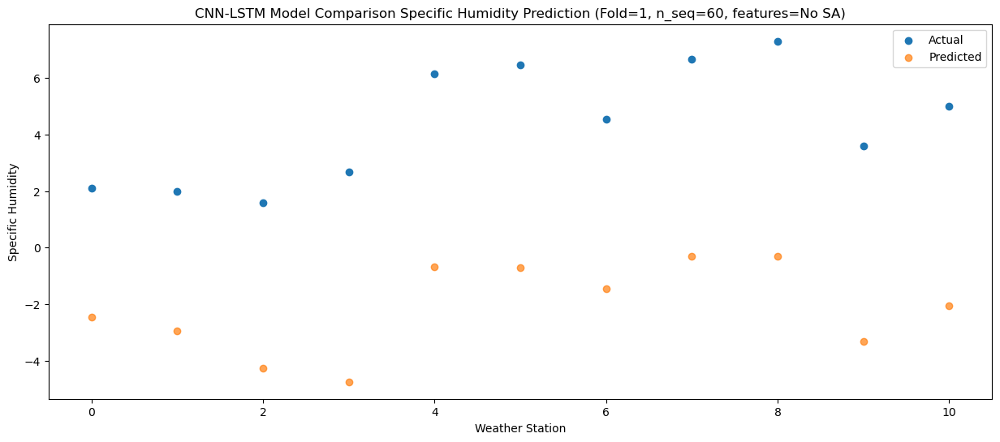

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.96  -5.906327
1                 1   -1.02  -6.366353
2                 2   -0.97  -7.562677
3                 3   -0.65  -7.951400
4                 4    2.80  -3.874991
5                 5    3.85  -3.743989
6                 6    1.21  -4.931256
7                 7    3.96  -3.672857
8                 8    4.64  -3.679388
9                 9    1.29  -6.483796
10               10    1.35  -5.875155


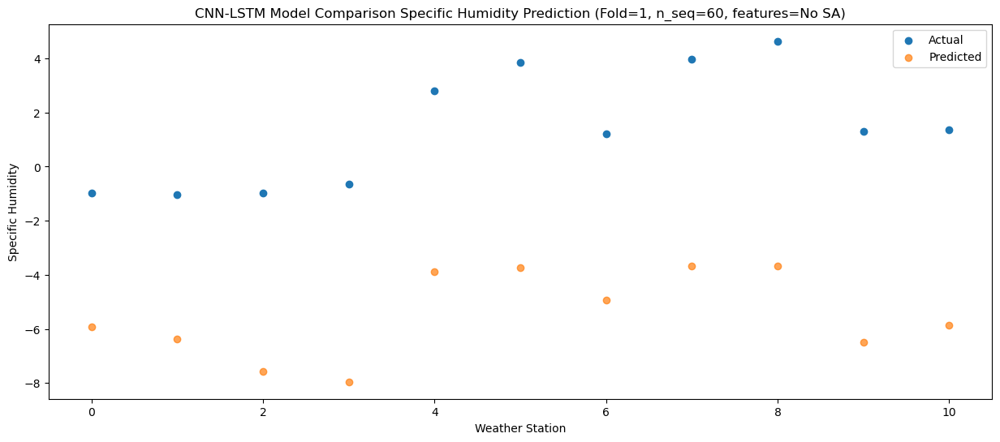

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -1.71  -6.382567
1                 1   -1.60  -6.840260
2                 2   -1.99  -8.270095
3                 3   -2.29  -8.676722
4                 4    1.08  -4.588103
5                 5    1.98  -3.967391
6                 6    0.71  -5.333400
7                 7    2.57  -4.080683
8                 8    3.59  -3.935496
9                 9    0.85  -6.592104
10               10    1.59  -5.557777


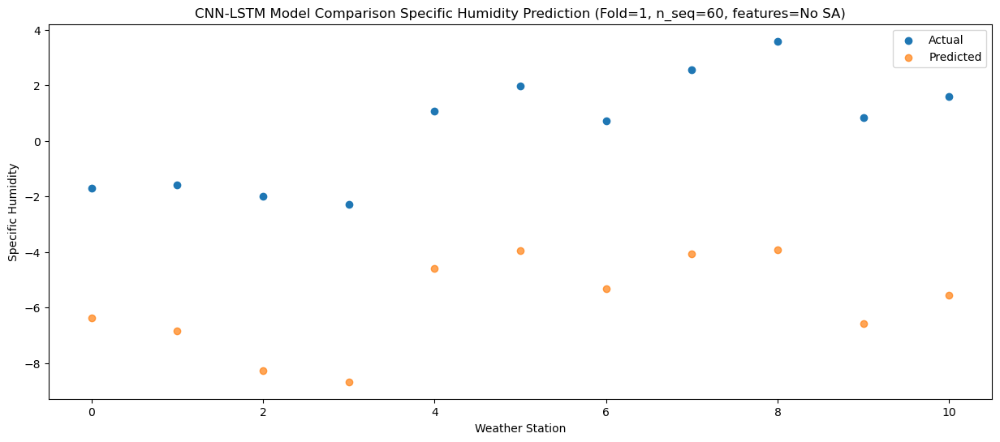

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -2.10  -7.486411
1                 1   -2.37  -7.976815
2                 2   -2.62  -9.415226
3                 3   -3.39  -9.843285
4                 4   -0.09  -5.755740
5                 5    0.83  -4.961666
6                 6   -0.11  -6.461750
7                 7    1.50  -5.251595
8                 8    2.28  -5.116298
9                 9    0.11  -7.662768
10               10    0.54  -6.633597


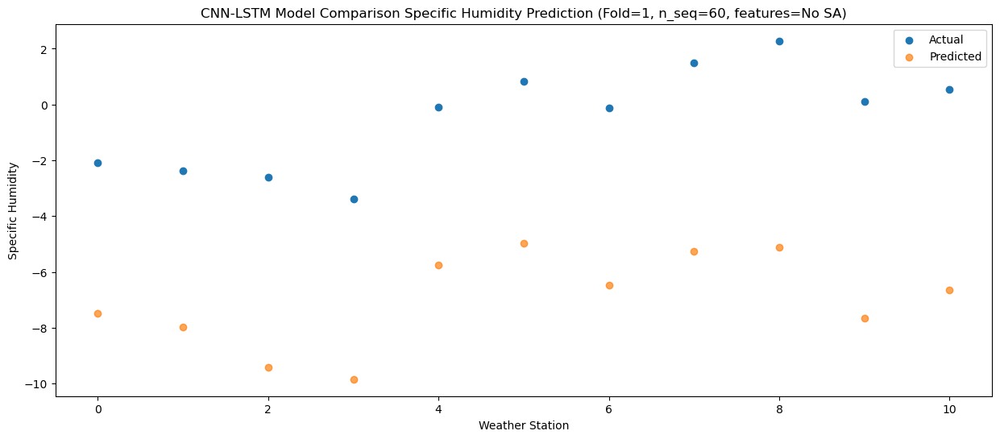

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -2.49  -7.408234
1                 1   -2.03  -7.836126
2                 2   -1.82  -9.089975
3                 3   -1.14  -9.255471
4                 4    2.16  -5.165668
5                 5    1.24  -4.497881
6                 6    0.37  -6.384949
7                 7    3.25  -4.864427
8                 8    4.03  -4.627184
9                 9    0.78  -7.189156
10               10    0.41  -6.997886


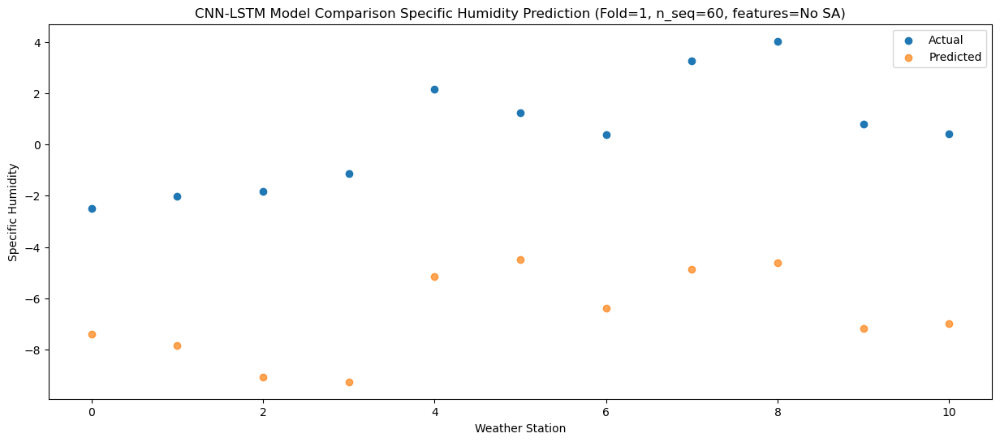

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -0.08  -5.697454
1                 1   -0.52  -6.196893
2                 2   -0.28  -7.329980
3                 3    0.77  -7.710267
4                 4    4.09  -3.637999
5                 5    2.20  -3.647623
6                 6    1.71  -4.774437
7                 7    4.44  -3.534466
8                 8    5.58  -3.589986
9                 9    1.09  -6.468250
10               10    1.44  -5.857592


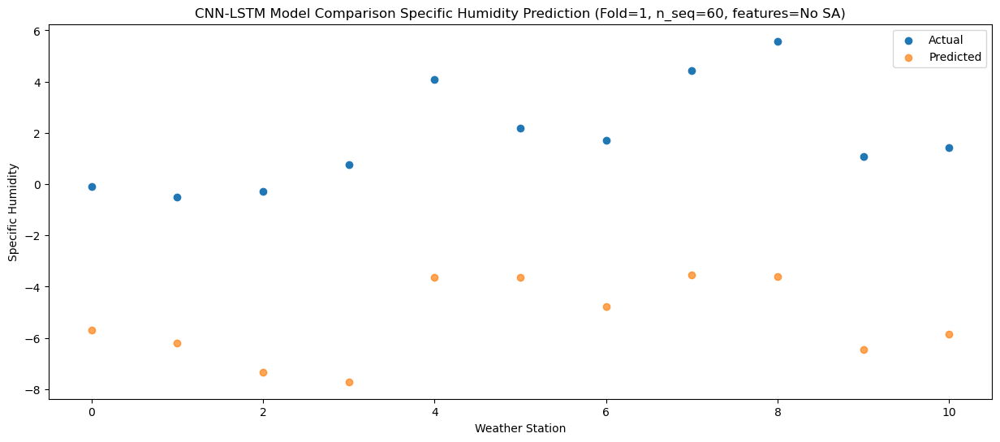

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    0.99  -3.981592
1                 1    1.37  -4.434275
2                 2    1.71  -5.521410
3                 3    3.02  -5.856163
4                 4    6.29  -1.783382
5                 5    2.84  -2.119695
6                 6    3.86  -3.033321
7                 7    6.21  -1.714526
8                 8    7.90  -1.765357
9                 9    1.95  -4.833916
10               10    3.05  -4.279505


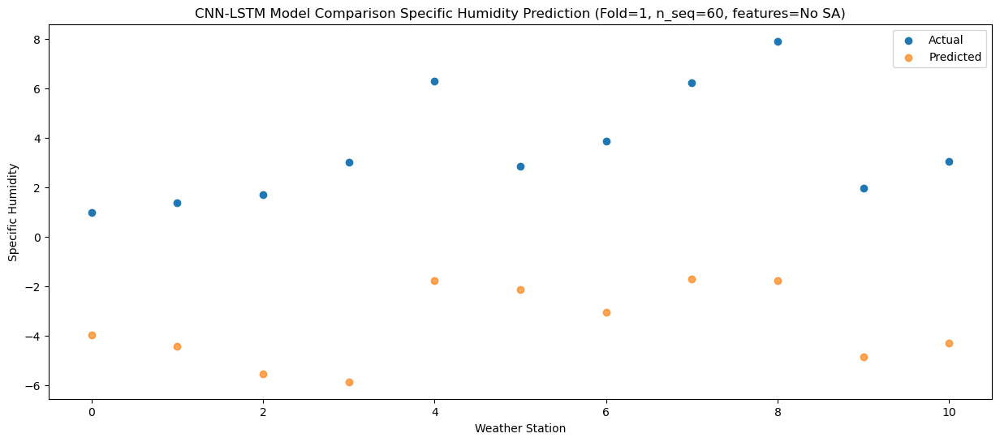

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.19   0.240535
1                 1    5.17  -0.245805
2                 2    5.84  -1.218017
3                 3    7.37  -1.772303
4                 4   10.27   2.282617
5                 5    5.27   0.860821
6                 6    8.00   1.120851
7                 7   10.52   2.185558
8                 8   11.50   1.819911
9                 9    4.68  -1.815324
10               10    6.63  -0.661695


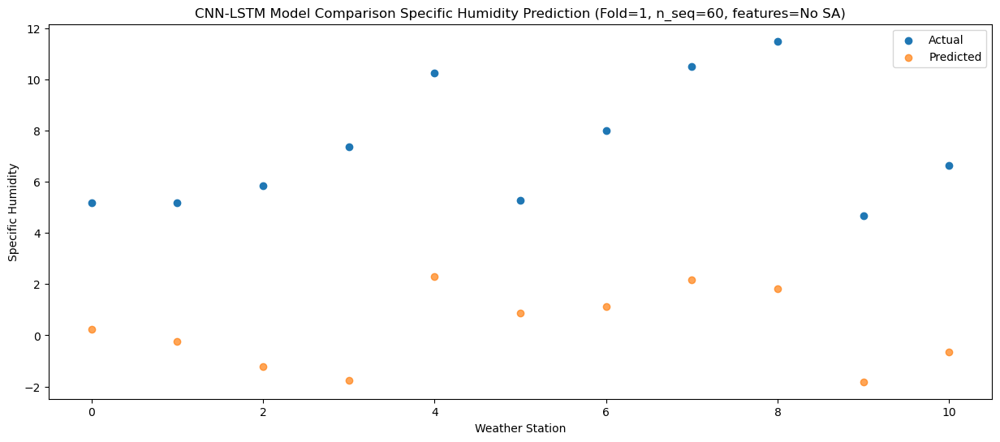

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    7.26   1.902058
1                 1    6.68   1.495508
2                 2    7.27   0.471841
3                 3    8.76   0.135432
4                 4   11.78   4.204872
5                 5   10.12   2.986338
6                 6    9.96   2.867888
7                 7   12.54   4.224955
8                 8   14.41   4.096482
9                 9   10.35   0.504499
10               10    8.45   1.322243


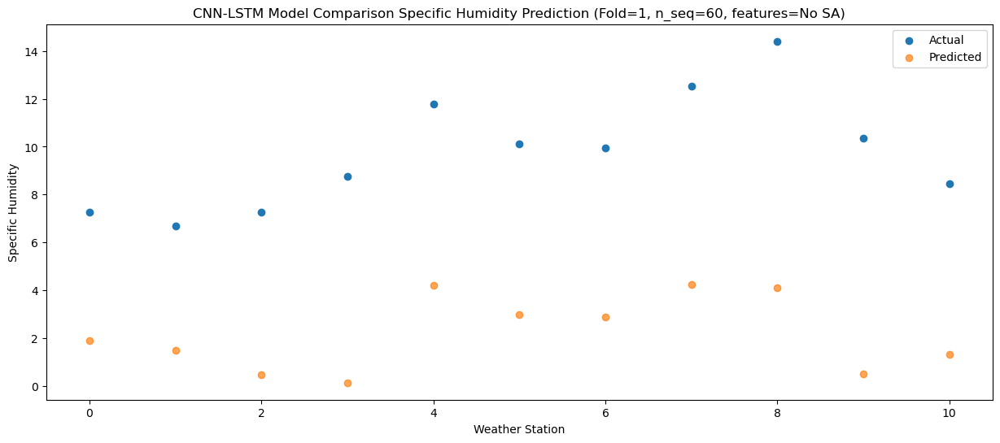

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    9.68   3.207161
1                 1    9.28   2.691586
2                 2   10.44   1.579100
3                 3    8.84   0.859584
4                 4   12.10   4.914441
5                 5    9.97   3.374338
6                 6   12.34   4.103559
7                 7   13.21   4.992628
8                 8   13.02   4.570958
9                 9    8.60   0.795232
10               10   11.82   2.636090


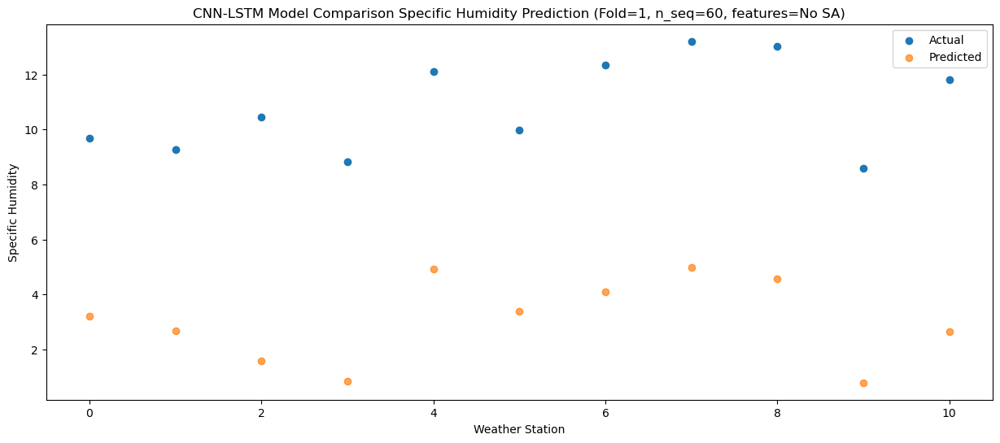

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.04   1.731264
1                 1    7.55   1.281748
2                 2    8.32   0.179219
3                 3    8.93  -0.324442
4                 4   12.15   3.740753
5                 5    8.83   2.537593
6                 6   10.62   2.682540
7                 7   11.97   3.844103
8                 8   12.43   3.623103
9                 9    8.79   0.022519
10               10   10.24   1.288593


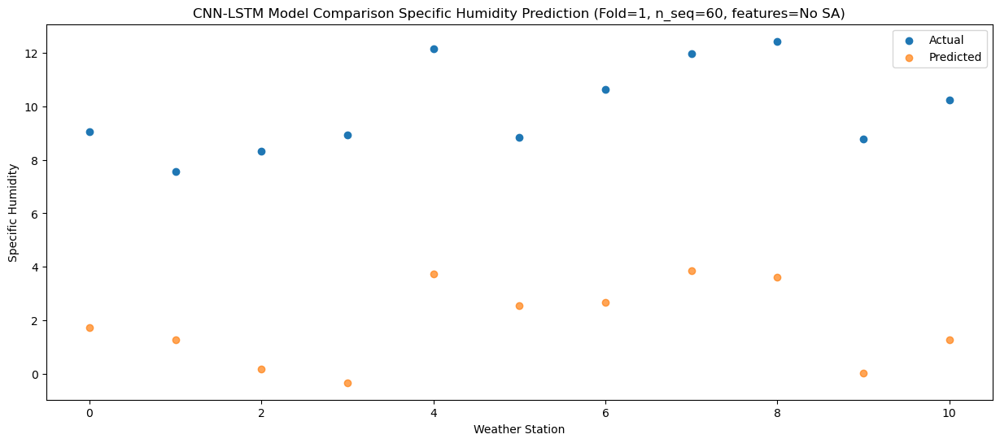

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.05  -0.322286
1                 1    6.03  -0.890508
2                 2    6.77  -1.913123
3                 3    6.01  -2.651683
4                 4    9.61   1.396764
5                 5    9.31   0.097249
6                 6    9.33   0.503145
7                 7   10.21   1.339958
8                 8   10.52   0.851519
9                 9    6.35  -2.695536
10               10    7.75  -1.183033


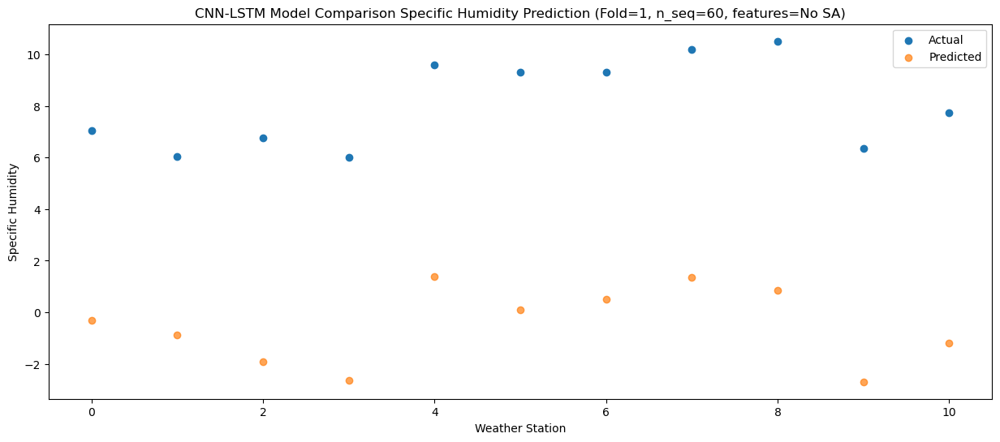

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.10  -4.853025
1                 1    2.20  -5.386489
2                 2    2.27  -6.530289
3                 3    1.96  -7.098890
4                 4    5.28  -3.034294
5                 5    5.04  -3.404481
6                 6    5.19  -3.957654
7                 7    5.17  -2.913422
8                 8    7.16  -3.128649
9                 9    3.36  -6.206007
10               10    3.44  -5.130838


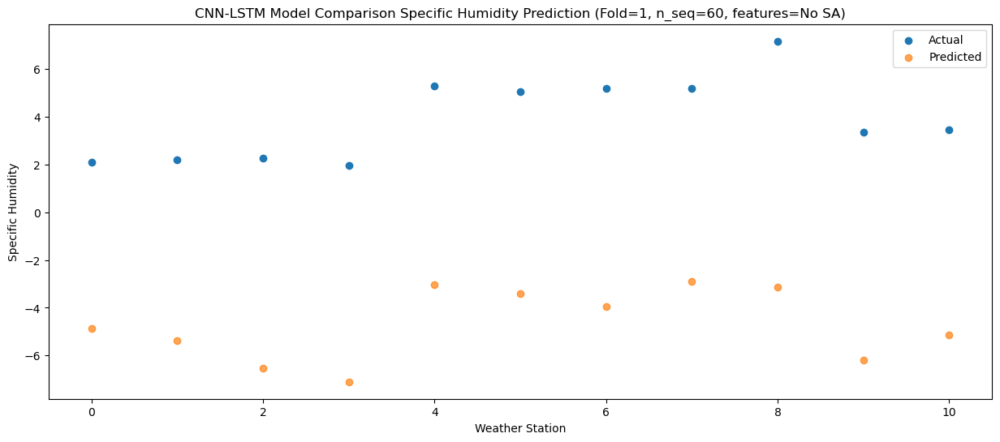

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_1 (Conv1D)           (None, 1, 1024)           1859584   
                                                                 
 max_pooling1d_1 (MaxPooling  (None, 1, 1024)          0         
 1D)                                                             
                                                                 
 dropout_3 (Dropout)         (None, 1, 1024)           0         
                                                                 
 lstm_2 (LSTM)               (None, 1, 512)            3147776   
                                                                 
 dropout_4 (Dropout)         (None, 1, 512)            0         
                                                                 
 lstm_3 (LSTM)               (None, 512)               2099200   
                                                      

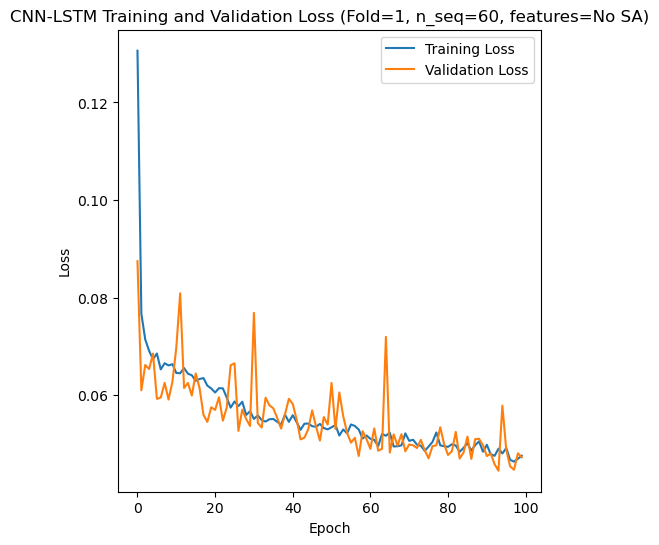

Epoch 1/100
84/84 [==============================] - 23s 89ms/step - loss: 0.1318 - accuracy: 0.1786 - mae: 0.1120 - rmse: 0.1318 - mape: 23.7763 - pearson: 0.5771 - val_loss: 0.0545 - val_accuracy: 0.8000 - val_mae: 0.0430 - val_rmse: 0.0545 - val_mape: 10.2129 - val_pearson: 0.8707
Epoch 2/100
84/84 [==============================] - 3s 35ms/step - loss: 0.0773 - accuracy: 0.4286 - mae: 0.0616 - rmse: 0.0773 - mape: 13.7733 - pearson: 0.7350 - val_loss: 0.0519 - val_accuracy: 0.8000 - val_mae: 0.0406 - val_rmse: 0.0519 - val_mape: 10.0300 - val_pearson: 0.8863
Epoch 3/100
84/84 [==============================] - 3s 34ms/step - loss: 0.0716 - accuracy: 0.4167 - mae: 0.0566 - rmse: 0.0716 - mape: 12.7509 - pearson: 0.7574 - val_loss: 0.0601 - val_accuracy: 0.8000 - val_mae: 0.0457 - val_rmse: 0.0601 - val_mape: 10.2639 - val_pearson: 0.8734
Epoch 4/100
84/84 [==============================] - 3s 36ms/step - loss: 0.0697 - accuracy: 0.4881 - mae: 0.0552 - rmse: 0.0697 - mape: 12.4180 - 

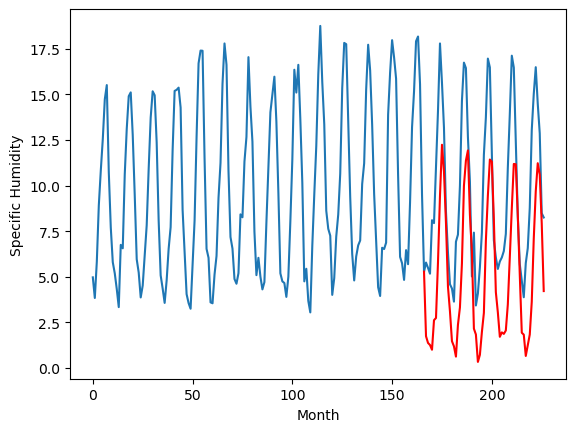

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.26		0.07		-0.19
-0.25		-0.36		-0.11
-0.27		-0.49		-0.22
-0.21		-0.83		-0.62
1.58		0.43		-1.15
1.87		0.87		-1.00
4.77		3.72		-1.05
6.19		6.92		0.73
11.00		9.44		-1.56
9.57		7.97		-1.60
5.51		5.44		-0.07
1.78		2.02		0.24
1.56		1.07		-0.49
-0.17		-0.17		0.00
-0.22		-0.28		-0.06
-0.90		-0.98		-0.08
0.95		0.55		-0.40
1.07		1.45		0.38
6.19		3.64		-2.55
9.10		7.38		-1.72
10.71		8.69		-2.02
9.09		9.13		0.04
6.27		5.95		-0.32
2.88		4.04		1.16
0.45		0.86		0.41
-0.61		-0.10		0.51
-0.94		-0.99		-0.05
-1.03		-0.97		0.06
-0.15		0.31		0.46
1.00		1.13		0.13
3.39		4.54		1.15
7.75		7.03		-0.72
9.09		8.80		-0.29
8.59		8.82		0.23
6.02		5.91		-0.11
2.34		2.59		0.25
0.84		1.01		0.17
-0.35		0.12		0.47
-0.36		0.32		0.68
-0.44		-0.09		0.35
0.25		0.24		-0.01
0.87		1.45		0.58
6.65		4.23		-2.42
9.30		6.40		-2.90
11.36		8.28		-3.08
9.47		8.56		-0.91
6.88		6.05		-0.83
3.42		3.19		-0.23
0.86		0.32		-0.54
0.47		0.35		-0.1

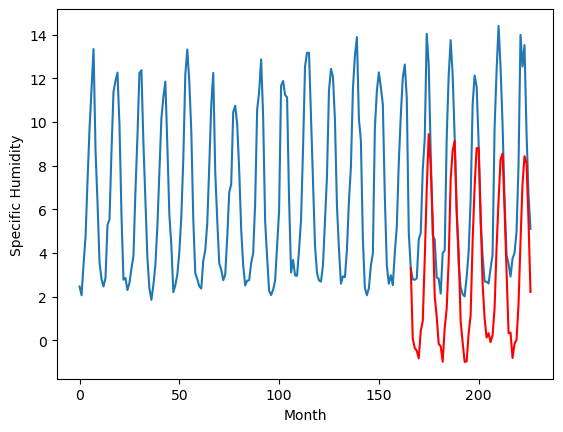

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.12		1.30		1.18
0.43		1.22		0.79
-1.13		1.15		2.28
-0.25		1.13		1.38
0.92		2.97		2.05
2.40		2.77		0.37
3.51		5.36		1.85
6.85		8.74		1.89
7.87		10.93		3.06
8.57		10.48		1.91
7.87		8.16		0.29
5.28		5.39		0.11
2.33		3.16		0.83
-2.34		0.95		3.29
-1.85		0.82		2.67
0.28		0.78		0.50
0.50		2.28		1.78
1.47		2.84		1.37
2.78		5.22		2.44
6.56		9.28		2.72
6.96		10.54		3.58
7.58		10.96		3.38
6.30		8.03		1.73
3.64		5.81		2.17
-0.31		1.59		1.90
1.09		2.22		1.13
-2.56		0.06		2.62
-1.37		0.75		2.12
0.44		1.86		1.42
1.80		2.81		1.01
4.90		6.58		1.68
6.83		8.97		2.14
7.66		10.95		3.29
7.55		10.60		3.05
7.40		7.55		0.15
3.01		3.81		0.80
2.90		2.96		0.06
-0.76		1.48		2.24
-1.14		1.71		2.85
0.71		2.17		1.46
1.10		2.10		1.00
2.61		3.44		0.83
3.42		5.83		2.41
6.58		8.26		1.68
7.55		10.44		2.89
8.27		10.57		2.30
5.88		7.66		1.78
2.96		4.37		1.41
0.46		1.50		1.04
-0.11		1.01		1.12
-1.18		0.16		1.34
-1.60		0.54		2.14
1

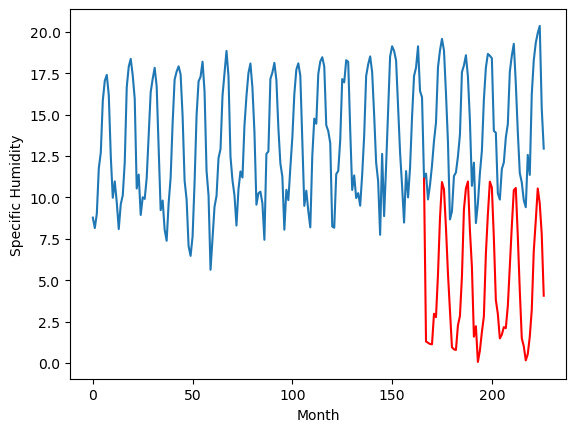

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.77		1.99		1.22
0.21		1.70		1.49
0.03		1.58		1.55
0.05		1.36		1.31
0.57		3.03		2.46
0.95		3.08		2.13
3.20		6.04		2.84
7.21		9.64		2.43
10.59		12.35		1.76
9.76		11.07		1.31
6.67		8.33		1.66
4.16		4.98		0.82
2.29		3.44		1.15
0.37		1.72		1.35
-0.71		1.43		2.14
-0.54		0.97		1.51
0.10		2.69		2.59
1.45		3.60		2.15
3.13		6.00		2.87
7.73		10.24		2.51
10.33		11.61		1.28
11.07		12.15		1.08
8.41		8.70		0.29
5.45		6.64		1.19
1.00		2.35		1.35
0.64		2.21		1.57
-0.69		0.58		1.27
-0.12		1.05		1.17
0.64		2.23		1.59
1.34		3.27		1.93
4.64		7.18		2.54
6.90		9.61		2.71
10.26		11.62		1.36
10.94		11.44		0.50
7.14		8.29		1.15
4.27		4.33		0.06
2.45		3.27		0.82
0.36		1.88		1.52
0.87		2.13		1.26
0.11		2.13		2.02
0.36		2.27		1.91
2.44		3.72		1.28
3.25		6.23		2.98
7.15		8.90		1.75
11.41		11.34		-0.07
9.07		11.30		2.23
8.06		8.49		0.43
4.70		5.22		0.52
0.87		2.07		1.20
1.16		1.92		0.76
-0.17		0.82		0.99
-0.22		1.36		1.58

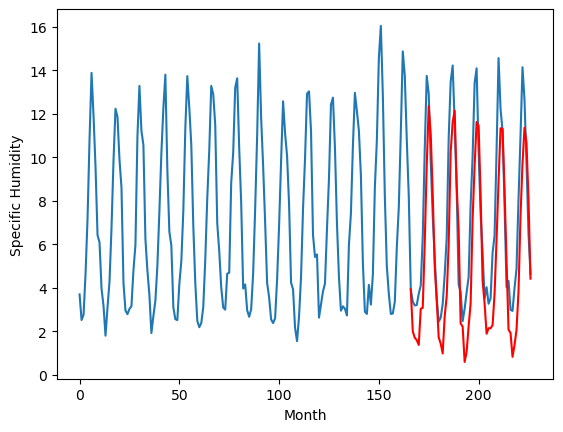

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.79		0.91		1.70
0.01		0.78		0.77
0.04		0.70		0.66
0.36		0.67		0.31
3.85		2.65		-1.20
2.89		2.37		-0.52
5.01		5.21		0.20
8.35		8.89		0.54
10.48		11.36		0.88
9.75		10.65		0.90
7.95		8.04		0.09
4.74		5.05		0.31
2.01		2.84		0.83
-1.27		0.55		1.82
-1.14		0.31		1.45
-1.16		0.21		1.37
2.13		1.86		-0.27
2.15		2.54		0.39
5.35		5.04		-0.31
9.24		9.39		0.15
10.27		10.74		0.47
9.87		11.26		1.39
7.73		8.01		0.28
5.20		5.78		0.58
-0.46		1.05		1.51
2.82		1.76		-1.06
-2.09		-0.54		1.55
-0.63		0.25		0.88
0.22		1.39		1.17
2.65		2.50		-0.15
6.68		6.61		-0.07
8.98		9.03		0.05
10.27		11.11		0.84
10.67		10.74		0.07
7.16		7.53		0.37
1.98		3.39		1.41
1.54		2.73		1.19
0.99		1.06		0.07
0.90		1.31		0.41
2.20		1.82		-0.38
3.08		1.74		-1.34
3.63		3.19		-0.44
6.69		5.57		-1.12
10.00		8.30		-1.70
11.34		10.79		-0.55
11.37		10.77		-0.60
9.02		7.71		-1.31
3.79		4.21		0.42
1.27		1.15		-0.12
-0.32		0.67		0.99
-1.19		-0.27		0

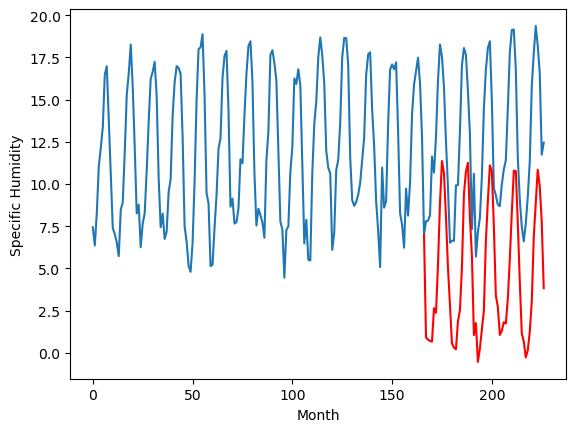

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.21		-0.55		0.66
-2.40		-0.86		1.54
-1.57		-0.97		0.60
-2.24		-1.19		1.05
2.37		0.46		-1.91
1.85		0.52		-1.33
3.93		3.49		-0.44
6.05		7.06		1.01
8.63		9.75		1.12
7.19		8.46		1.27
5.74		5.74		0.00
1.87		2.39		0.52
-0.19		0.88		1.07
-2.51		-0.83		1.68
-2.64		-1.08		1.56
-2.69		-1.56		1.13
0.30		0.14		-0.16
1.87		1.03		-0.84
6.70		3.43		-3.27
9.34		7.65		-1.69
8.30		9.01		0.71
8.43		9.53		1.10
4.87		6.12		1.25
3.28		4.05		0.77
-0.91		-0.15		0.76
1.96		-0.32		-2.28
-3.67		-1.93		1.74
-3.45		-1.49		1.96
-1.83		-0.28		1.55
2.13		0.75		-1.38
5.78		4.65		-1.13
6.81		7.09		0.28
7.91		9.07		1.16
8.37		8.92		0.55
5.01		5.77		0.76
0.19		1.85		1.66
0.05		0.77		0.72
-0.86		-0.59		0.27
-1.24		-0.35		0.89
-0.79		-0.36		0.43
0.99		-0.20		-1.19
1.54		1.21		-0.33
5.24		3.76		-1.48
8.70		6.38		-2.32
8.41		8.78		0.37
6.98		8.77		1.79
6.43		5.97		-0.46
2.90		2.71		-0.19
-0.27		-0.41		-0.14
-2.20		-0.57		1.63
-3.

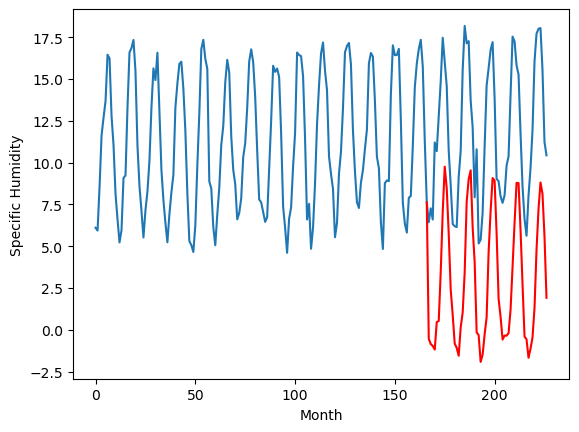

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.57		5.95		0.38
4.47		5.57		1.10
5.15		5.45		0.30
4.59		5.18		0.59
8.81		6.79		-2.02
8.39		6.93		-1.46
11.33		10.00		-1.33
13.61		13.65		0.04
16.52		16.46		-0.06
13.82		14.95		1.13
12.88		12.12		-0.76
8.39		8.60		0.21
6.80		7.29		0.49
4.09		5.68		1.59
3.99		5.40		1.41
3.66		4.81		1.15
6.52		6.55		0.03
7.84		7.52		-0.32
12.04		9.93		-2.11
15.79		14.18		-1.61
16.61		15.57		-1.04
16.99		16.13		-0.86
12.54		12.60		0.06
9.93		10.57		0.64
5.94		6.37		0.43
8.44		6.02		-2.42
3.15		4.54		1.39
3.62		4.91		1.29
5.25		6.17		0.92
9.15		7.23		-1.92
13.24		11.19		-2.05
14.04		13.66		-0.38
13.36		15.64		2.28
14.42		15.53		1.11
11.75		12.35		0.60
6.97		8.38		1.41
6.52		7.26		0.74
5.35		5.93		0.58
4.57		6.18		1.61
4.97		6.07		1.10
6.88		6.27		-0.61
7.55		7.69		0.14
11.44		10.31		-1.13
15.34		12.98		-2.36
14.63		15.41		0.78
12.58		15.39		2.81
11.95		12.58		0.63
8.80		9.32		0.52
6.18		6.17		-0.01
4.36		6.07		1.

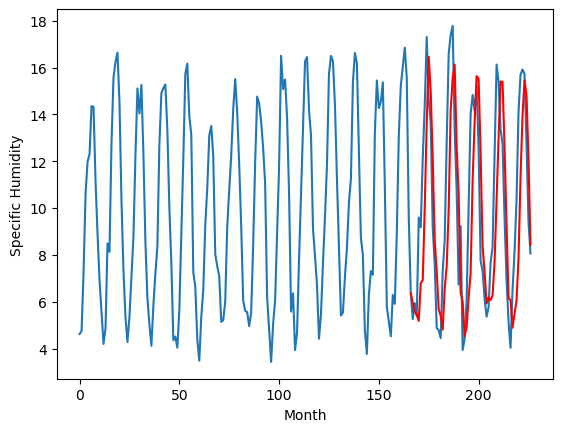

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.62		2.21		-0.41
2.17		1.96		-0.21
1.22		1.83		0.61
1.75		1.56		-0.19
3.21		2.62		-0.59
1.81		3.10		1.29
2.05		5.47		3.42
3.73		8.11		4.38
7.17		10.07		2.90
5.44		9.23		3.79
4.79		7.24		2.45
1.72		4.33		2.61
1.77		3.17		1.40
0.51		1.98		1.47
0.79		2.06		1.27
0.66		1.57		0.91
0.75		2.80		2.05
1.05		3.47		2.42
1.17		5.44		4.27
3.83		8.70		4.87
9.07		9.85		0.78
9.36		10.10		0.74
6.60		7.51		0.91
2.89		5.58		2.69
1.24		3.19		1.95
1.37		2.27		0.90
1.09		1.49		0.40
0.10		1.42		1.32
0.50		2.58		2.08
0.51		3.12		2.61
0.44		5.91		5.47
5.94		8.30		2.36
8.50		9.93		1.43
10.47		9.92		-0.55
7.43		7.32		-0.11
5.35		4.66		-0.69
1.38		2.81		1.43
2.20		2.20		-0.00
1.31		2.36		1.05
1.19		1.93		0.74
1.53		2.26		0.73
0.69		3.27		2.58
2.69		6.00		3.31
2.49		7.64		5.15
5.84		9.03		3.19
8.03		9.54		1.51
6.22		7.29		1.07
3.77		4.77		1.00
2.85		2.21		-0.64
1.33		2.17		0.84
1.75		1.21		-0.54
1.77		1.75		-0.02
1.99		1

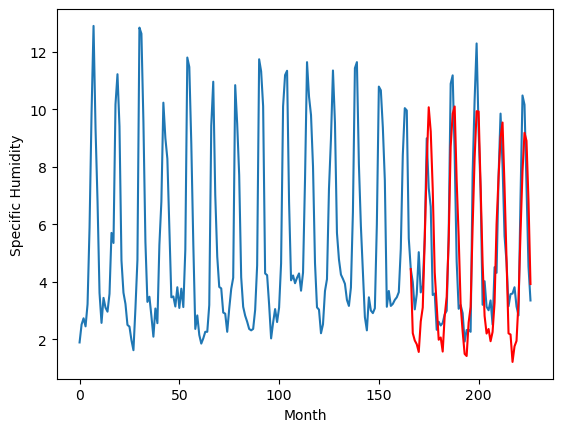

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
7.78		6.61		-1.17
7.60		6.45		-1.15
7.39		6.30		-1.09
6.67		6.05		-0.62
8.31		6.84		-1.47
9.72		7.46		-2.26
10.48		9.41		-1.07
10.46		11.50		1.04
11.23		12.98		1.75
12.31		12.57		0.26
10.53		11.06		0.53
9.40		8.51		-0.89
7.16		7.36		0.20
5.59		6.37		0.78
6.44		6.64		0.20
6.97		6.24		-0.73
7.08		7.19		0.11
8.40		7.69		-0.71
9.88		9.42		-0.46
11.13		12.15		1.02
12.28		13.16		0.88
11.68		13.23		1.55
11.22		11.19		-0.03
8.42		9.29		0.87
7.88		7.83		-0.05
7.70		6.68		-1.02
6.34		6.22		-0.12
5.60		5.94		0.34
7.34		7.03		-0.31
8.18		7.29		-0.89
9.44		9.44		0.00
11.21		11.77		0.56
12.10		13.23		1.13
12.20		13.25		1.05
13.05		10.96		-2.09
11.28		9.00		-2.28
6.64		6.79		0.15
7.49		6.53		-0.96
7.58		6.64		-0.94
6.17		6.08		-0.09
8.09		6.45		-1.64
8.79		7.25		-1.54
10.19		10.01		-0.18
10.57		11.09		0.52
11.91		11.92		0.01
12.52		12.71		0.19
12.27		10.75		-1.52
9.97		8.63		-1.34
6.94		6.37		-0.57
7.73		6.

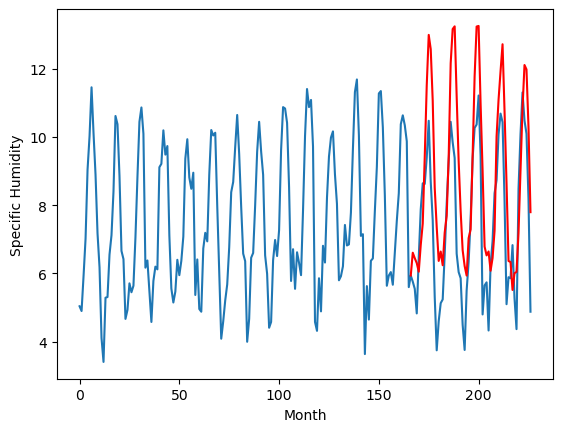

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.89		2.46		1.57
1.00		2.26		1.26
0.98		2.17		1.19
1.37		2.06		0.69
3.00		3.90		0.90
2.91		3.76		0.85
6.24		6.64		0.40
9.75		10.27		0.52
12.60		12.84		0.24
12.59		11.90		-0.69
8.87		9.25		0.38
6.25		6.12		-0.13
3.60		4.18		0.58
0.38		2.14		1.76
0.26		1.88		1.62
0.33		1.63		1.30
2.06		3.31		1.25
2.59		4.08		1.49
5.30		6.54		1.24
9.80		10.84		1.04
11.32		12.19		0.87
11.90		12.71		0.81
8.30		9.39		1.09
6.14		7.23		1.09
0.58		2.69		2.11
2.43		3.05		0.62
-0.35		1.03		1.38
0.96		1.68		0.72
1.92		2.83		0.91
2.96		3.90		0.94
7.28		7.92		0.64
9.08		10.34		1.26
12.66		12.39		-0.27
11.09		12.10		1.01
7.66		8.92		1.26
3.30		4.86		1.56
2.83		4.02		1.19
0.59		2.48		1.89
1.45		2.73		1.28
2.21		3.02		0.81
1.90		3.03		1.13
4.03		4.49		0.46
5.56		6.91		1.35
8.42		9.61		1.19
12.26		12.08		-0.18
11.77		12.05		0.28
8.63		9.10		0.47
4.44		5.70		1.26
1.33		2.60		1.27
1.24		2.27		1.03
0.55		1.26		0.71
0.69		1.73		1

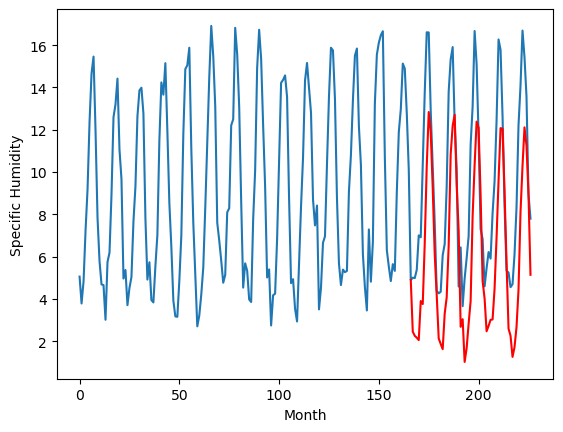

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.08		1.29		1.21
0.53		1.04		0.51
0.33		0.94		0.61
0.44		0.77		0.33
2.29		2.52		0.23
1.72		2.48		0.76
4.51		5.40		0.89
7.95		9.01		1.06
10.65		11.65		1.00
10.41		10.53		0.12
7.80		7.83		0.03
4.61		4.59		-0.02
1.49		2.86		1.37
-0.30		1.00		1.30
-0.29		0.72		1.01
-0.05		0.37		0.42
0.98		2.06		1.08
1.59		2.91		1.32
4.26		5.33		1.07
8.36		9.60		1.24
9.77		10.96		1.19
10.16		11.49		1.33
6.95		8.10		1.15
5.22		5.99		0.77
-0.14		1.59		1.73
1.42		1.68		0.26
-1.00		-0.12		0.88
-0.10		0.43		0.53
0.52		1.60		1.08
1.79		2.65		0.86
5.95		6.60		0.65
7.91		9.03		1.12
11.12		11.05		-0.07
10.13		10.83		0.70
6.65		7.66		1.01
1.99		3.66		1.67
1.37		2.70		1.33
0.28		1.24		0.96
0.55		1.49		0.94
0.95		1.62		0.67
0.55		1.71		1.16
2.19		3.15		0.96
4.78		5.63		0.85
6.62		8.30		1.68
9.93		10.76		0.83
10.04		10.72		0.68
7.62		7.85		0.23
3.51		4.52		1.01
0.56		1.39		0.83
0.35		1.16		0.81
-0.27		0.11		0.38
0.13		0.61		0

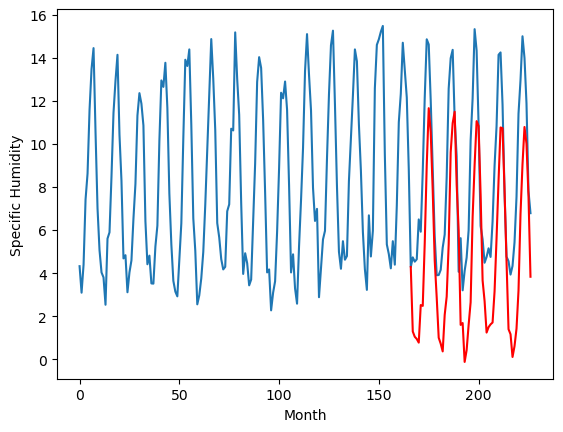

RangeIndex(start=1, stop=12, step=1)
[0.41000000000000014, 0.26000000000000045, 0.1200000000000001, 0.7699999999999987, -0.79, -1.2099999999999995, 5.569999999999999, 2.62, 7.780000000000001, 0.8900000000000006, 0.08000000000000007]
[1.744422311782837, 0.06588114738464346, 1.2960079097747803, 1.98705225944519, 0.9141099166870115, -0.5492422962188721, 5.948181896209716, 2.213459792137146, 6.607568445205689, 2.455945825576782, 1.2900217723846437]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.41   1.744422
1                 1    0.26   0.065881
2                 2    0.12   1.296008
3                 3    0.77   1.987052
4                 4   -0.79   0.914110
5                 5   -1.21  -0.549242
6                 6    5.57   5.948182
7                 7    2.62   2.213460
8                 8    7.78   6.607568
9                 9    0.89   2.455946
10               10    0.08   1.290022


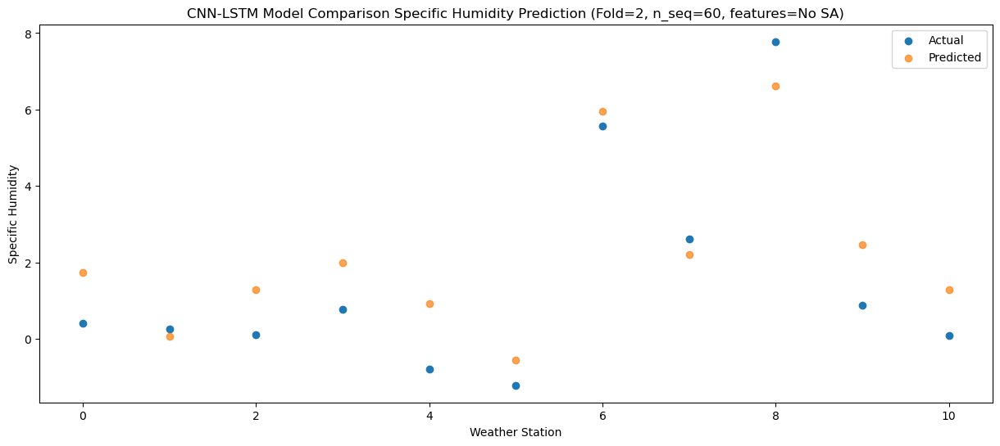

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.91   1.379307
1                 1   -0.25  -0.358942
2                 2    0.43   1.220170
3                 3    0.21   1.696206
4                 4    0.01   0.778635
5                 5   -2.40  -0.856981
6                 6    4.47   5.566074
7                 7    2.17   1.958905
8                 8    7.60   6.447221
9                 9    1.00   2.263137
10               10    0.53   1.044892


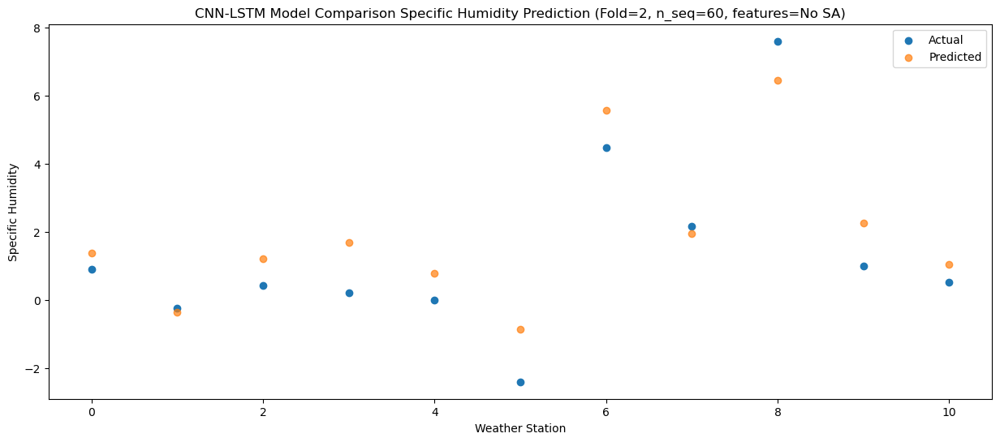

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.62   1.263053
1                 1   -0.27  -0.486630
2                 2   -1.13   1.145299
3                 3    0.03   1.583931
4                 4    0.04   0.704609
5                 5   -1.57  -0.969600
6                 6    5.15   5.449083
7                 7    1.22   1.827246
8                 8    7.39   6.304160
9                 9    0.98   2.172374
10               10    0.33   0.941853


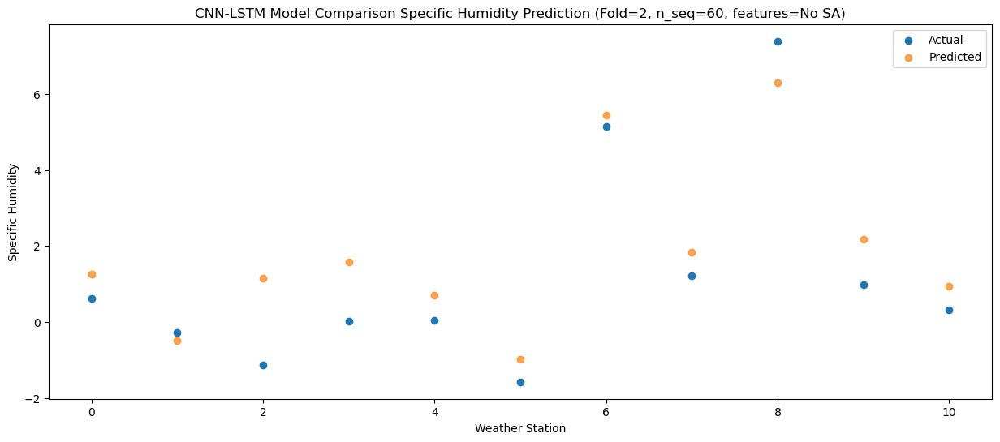

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.30   1.004664
1                 1   -0.21  -0.827930
2                 2   -0.25   1.128048
3                 3    0.05   1.364894
4                 4    0.36   0.666093
5                 5   -2.24  -1.186751
6                 6    4.59   5.182435
7                 7    1.75   1.559896
8                 8    6.67   6.052715
9                 9    1.37   2.059745
10               10    0.44   0.772190


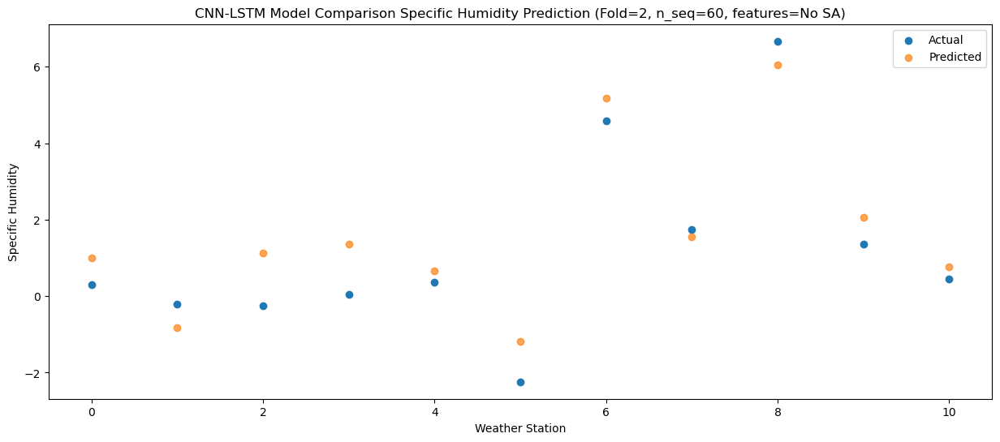

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.23   2.621589
1                 1    1.58   0.429120
2                 2    0.92   2.972786
3                 3    0.57   3.028764
4                 4    3.85   2.648370
5                 5    2.37   0.456501
6                 6    8.81   6.788628
7                 7    3.21   2.621271
8                 8    8.31   6.836182
9                 9    3.00   3.904536
10               10    2.29   2.515854


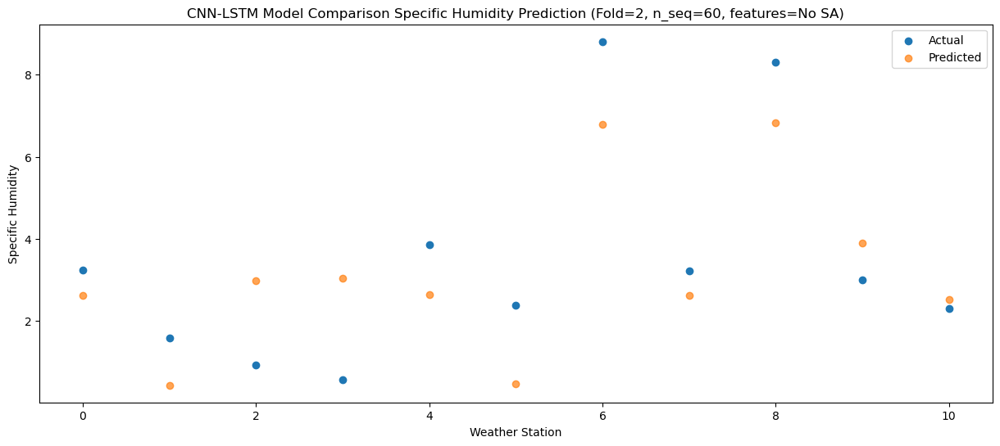

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.07   2.744617
1                 1    1.87   0.868565
2                 2    2.40   2.765398
3                 3    0.95   3.077875
4                 4    2.89   2.372604
5                 5    1.85   0.522691
6                 6    8.39   6.927977
7                 7    1.81   3.102739
8                 8    9.72   7.460522
9                 9    2.91   3.763019
10               10    1.72   2.477898


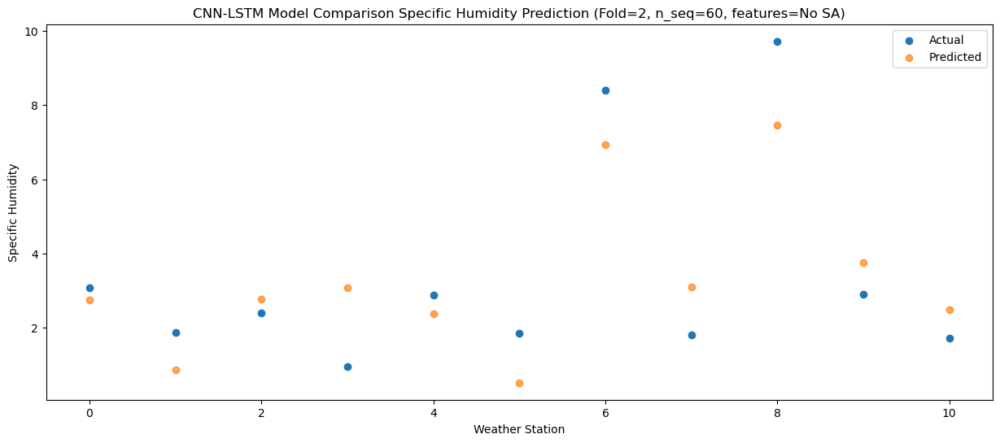

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.06   5.798417
1                 1    4.77   3.717890
2                 2    3.51   5.363792
3                 3    3.20   6.043891
4                 4    5.01   5.206892
5                 5    3.93   3.485944
6                 6   11.33  10.001500
7                 7    2.05   5.466084
8                 8   10.48   9.411795
9                 9    6.24   6.640045
10               10    4.51   5.400076


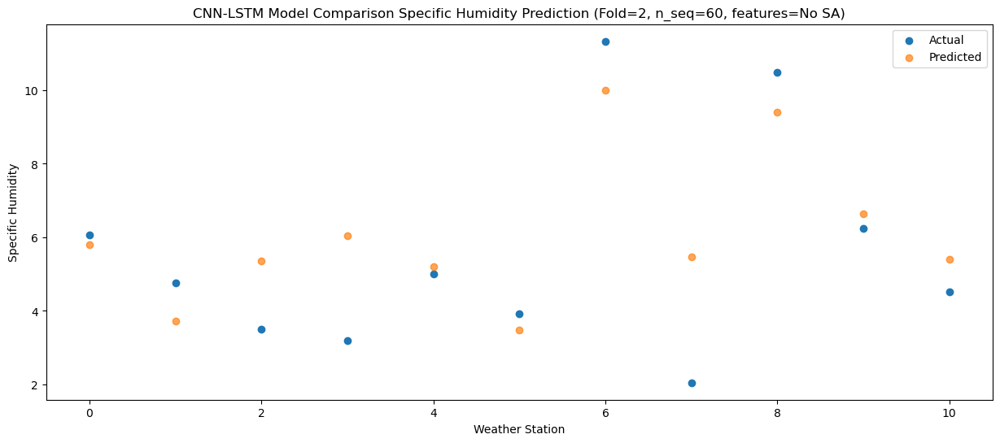

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.21   9.435056
1                 1    6.19   6.920086
2                 2    6.85   8.739628
3                 3    7.21   9.641277
4                 4    8.35   8.887962
5                 5    6.05   7.059008
6                 6   13.61  13.646566
7                 7    3.73   8.106643
8                 8   10.46  11.504823
9                 9    9.75  10.273553
10               10    7.95   9.008846


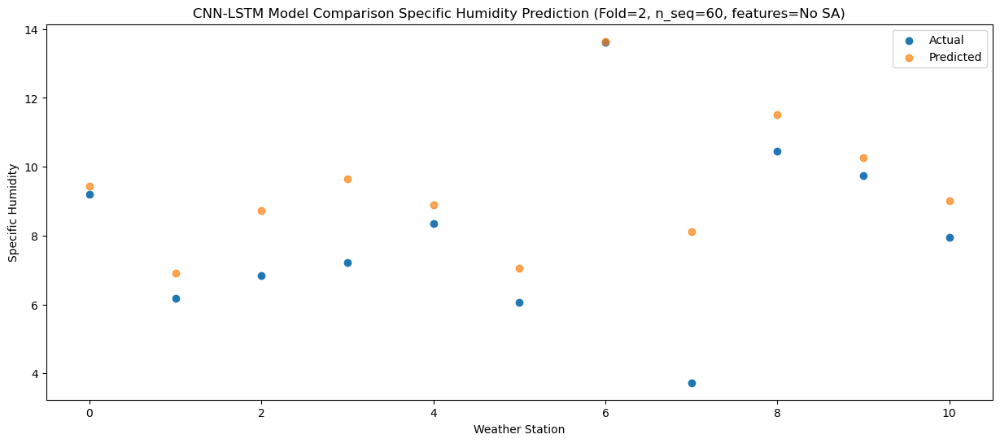

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   12.91  12.231471
1                 1   11.00   9.440861
2                 2    7.87  10.927185
3                 3   10.59  12.352587
4                 4   10.48  11.363055
5                 5    8.63   9.753413
6                 6   16.52  16.462115
7                 7    7.17  10.070151
8                 8   11.23  12.984479
9                 9   12.60  12.840319
10               10   10.65  11.652556


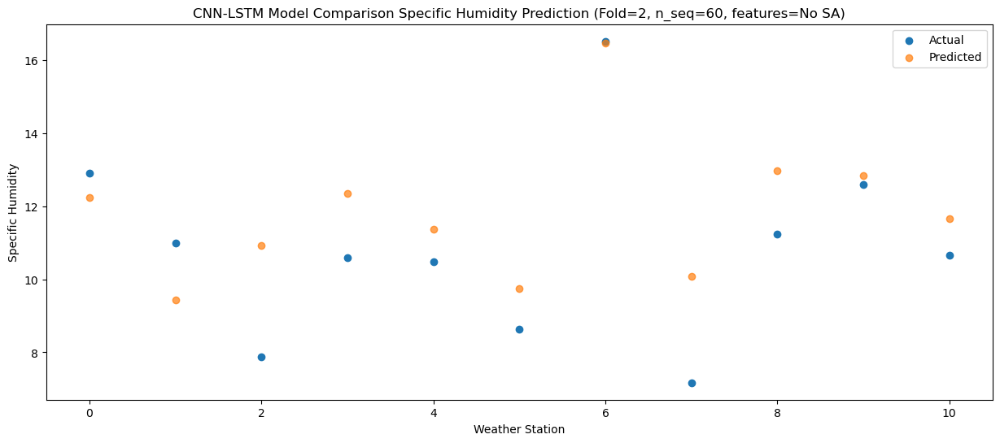

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.75  10.760272
1                 1    9.57   7.973480
2                 2    8.57  10.482736
3                 3    9.76  11.070565
4                 4    9.75  10.645964
5                 5    7.19   8.462191
6                 6   13.82  14.948460
7                 7    5.44   9.230673
8                 8   12.31  12.569683
9                 9   12.59  11.901705
10               10   10.41  10.529638


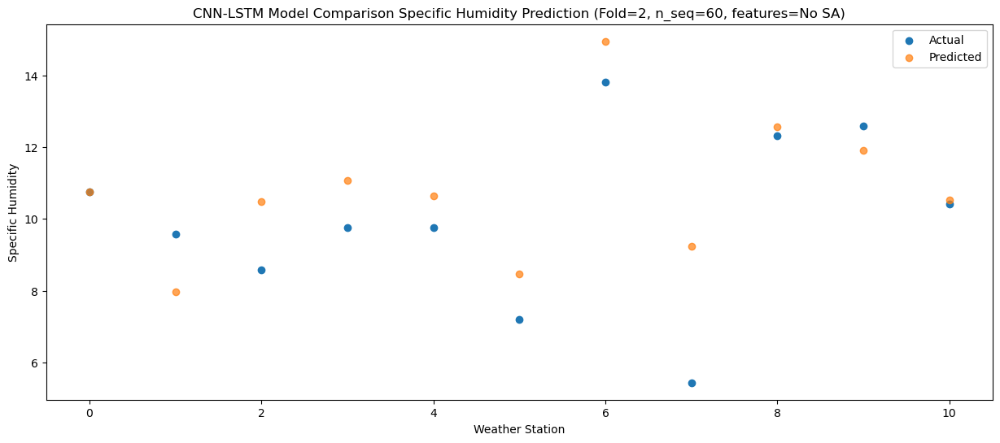

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.29   7.948411
1                 1    5.51   5.444309
2                 2    7.87   8.158833
3                 3    6.67   8.325179
4                 4    7.95   8.044009
5                 5    5.74   5.743625
6                 6   12.88  12.122061
7                 7    4.79   7.241140
8                 8   10.53  11.055569
9                 9    8.87   9.249829
10               10    7.80   7.831587


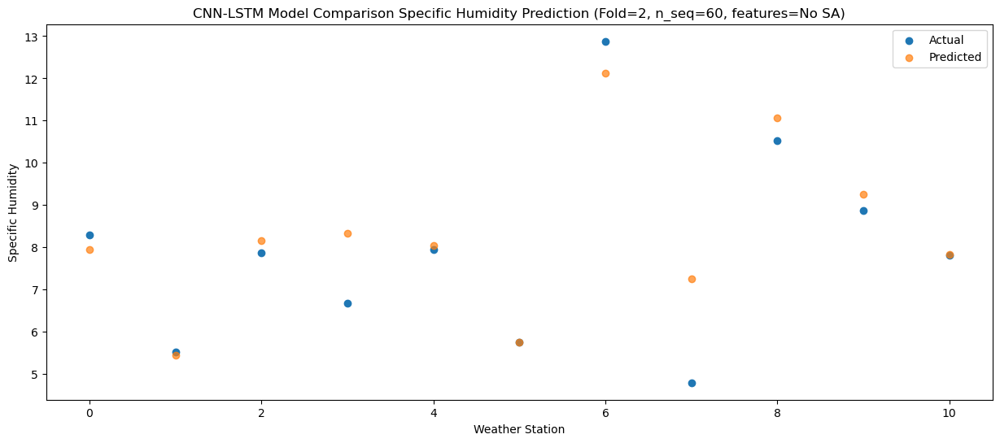

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.70   4.461704
1                 1    1.78   2.020769
2                 2    5.28   5.393300
3                 3    4.16   4.975744
4                 4    4.74   5.049314
5                 5    1.87   2.388615
6                 6    8.39   8.604694
7                 7    1.72   4.329920
8                 8    9.40   8.511724
9                 9    6.25   6.120091
10               10    4.61   4.585142


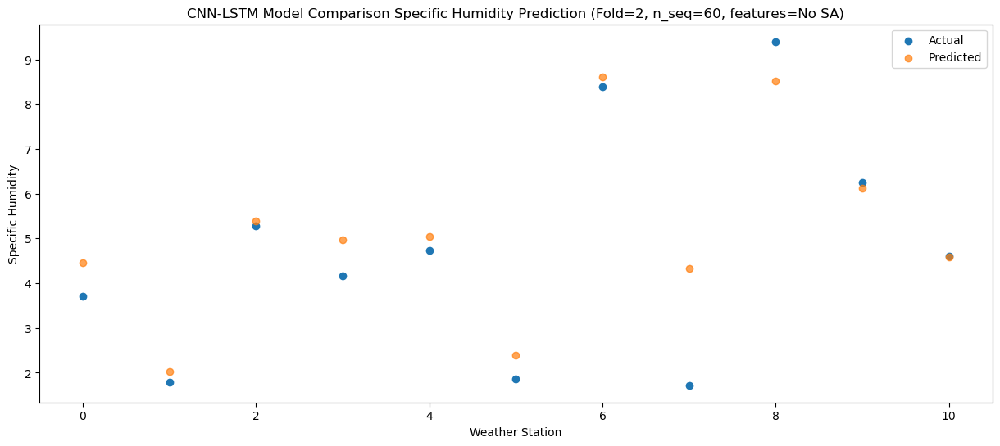

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.45   3.105264
1                 1    1.56   1.071499
2                 2    2.33   3.162177
3                 3    2.29   3.437115
4                 4    2.01   2.844579
5                 5   -0.19   0.882485
6                 6    6.80   7.288946
7                 7    1.77   3.165619
8                 8    7.16   7.356947
9                 9    3.60   4.184639
10               10    1.49   2.864984


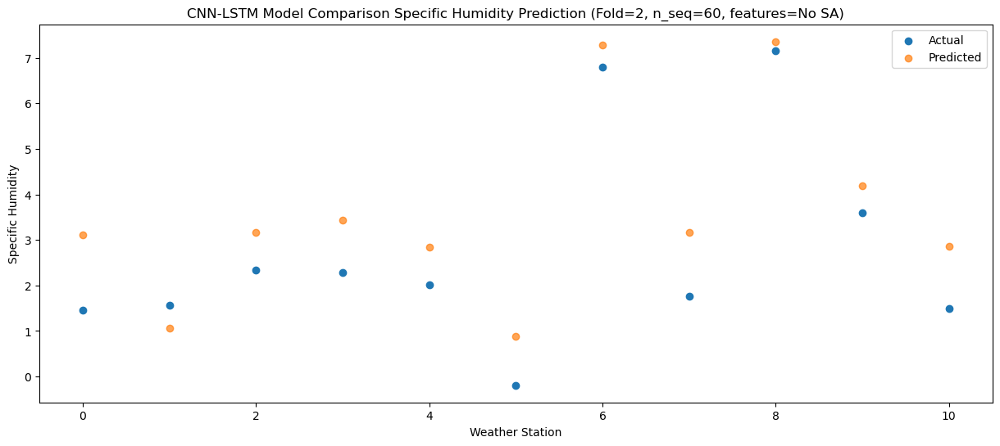

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.28   1.474338
1                 1   -0.17  -0.167268
2                 2   -2.34   0.947484
3                 3    0.37   1.715840
4                 4   -1.27   0.554718
5                 5   -2.51  -0.825103
6                 6    4.09   5.677950
7                 7    0.51   1.984507
8                 8    5.59   6.367504
9                 9    0.38   2.138190
10               10   -0.30   0.998604


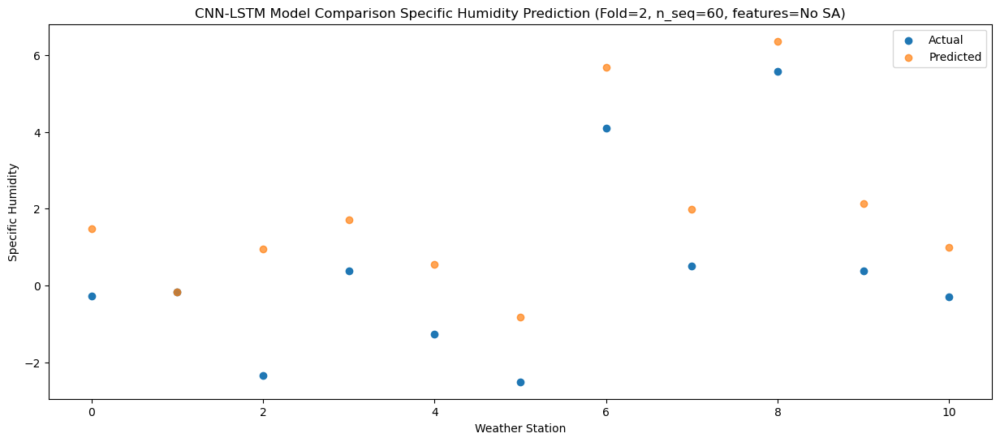

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.51   1.191831
1                 1   -0.22  -0.279204
2                 2   -1.85   0.824406
3                 3   -0.71   1.426990
4                 4   -1.14   0.313915
5                 5   -2.64  -1.084898
6                 6    3.99   5.397149
7                 7    0.79   2.062430
8                 8    6.44   6.641744
9                 9    0.26   1.876359
10               10   -0.29   0.723626


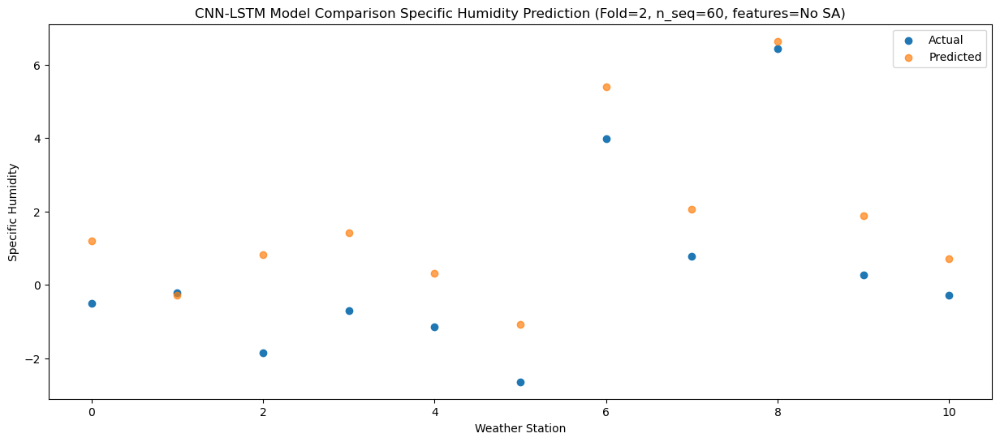

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.23   0.629238
1                 1   -0.90  -0.984205
2                 2    0.28   0.784932
3                 3   -0.54   0.974048
4                 4   -1.16   0.205362
5                 5   -2.69  -1.555585
6                 6    3.66   4.809794
7                 7    0.66   1.572393
8                 8    6.97   6.240776
9                 9    0.33   1.631033
10               10   -0.05   0.365977


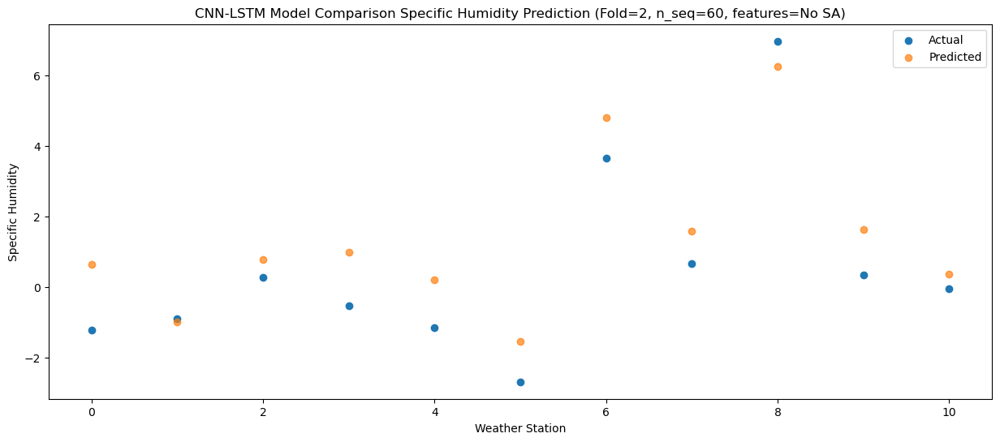

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.05   2.368417
1                 1    0.95   0.549717
2                 2    0.50   2.276213
3                 3    0.10   2.685345
4                 4    2.13   1.860965
5                 5    0.30   0.138717
6                 6    6.52   6.554782
7                 7    0.75   2.804338
8                 8    7.08   7.191927
9                 9    2.06   3.305403
10               10    0.98   2.058505


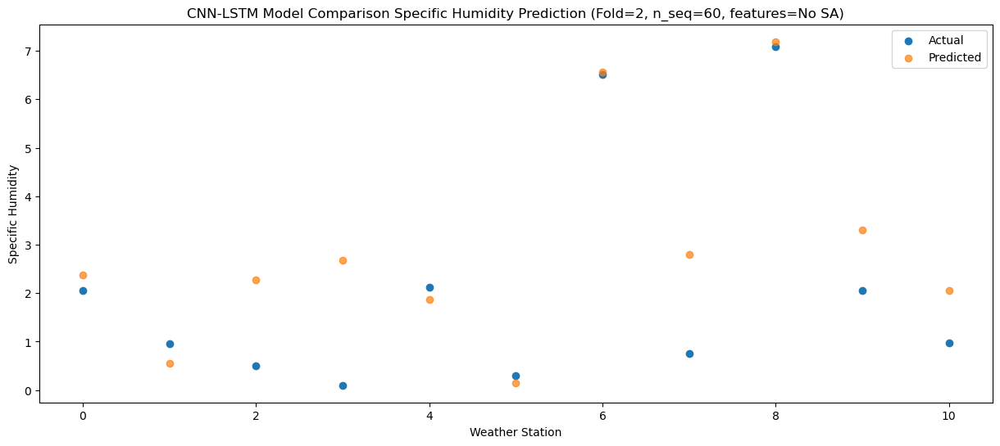

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.44   3.322062
1                 1    1.07   1.451608
2                 2    1.47   2.836553
3                 3    1.45   3.595522
4                 4    2.15   2.536567
5                 5    1.87   1.032361
6                 6    7.84   7.517653
7                 7    1.05   3.473971
8                 8    8.40   7.687053
9                 9    2.59   4.078755
10               10    1.59   2.905385


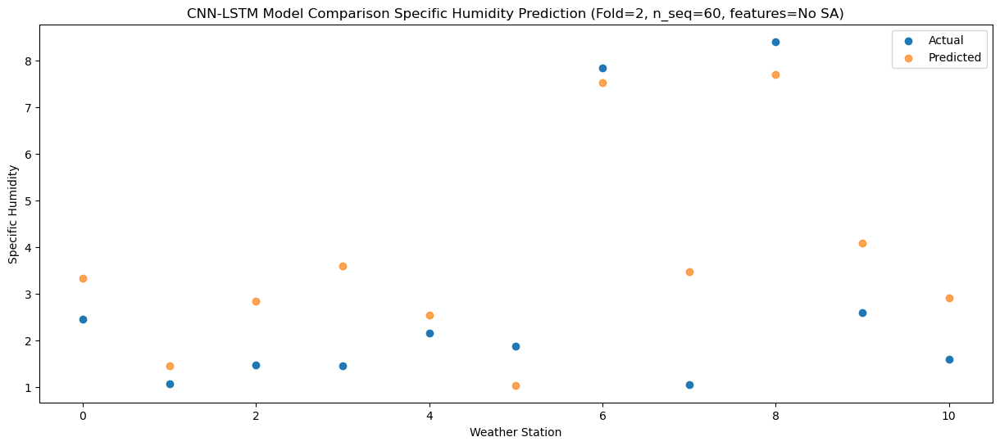

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.11   5.733318
1                 1    6.19   3.637925
2                 2    2.78   5.215573
3                 3    3.13   5.998257
4                 4    5.35   5.041107
5                 5    6.70   3.432115
6                 6   12.04   9.930966
7                 7    1.17   5.439953
8                 8    9.88   9.415809
9                 9    5.30   6.535632
10               10    4.26   5.332046


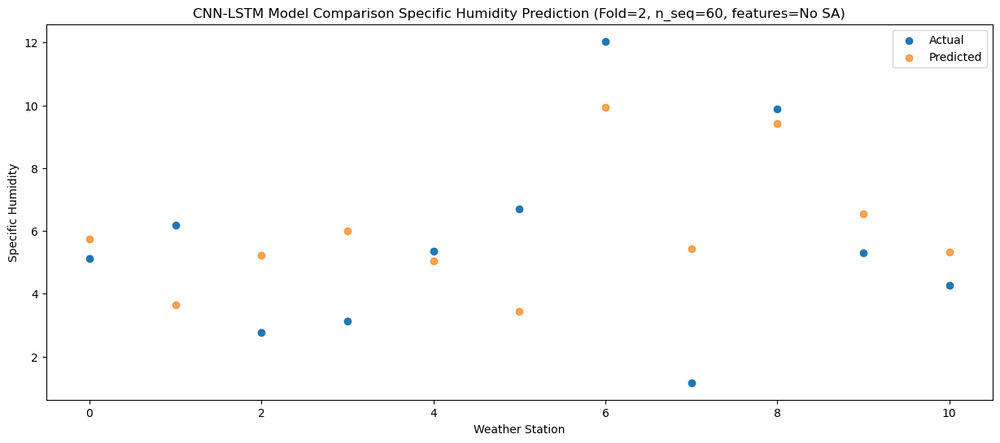

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    9.76   9.980908
1                 1    9.10   7.384697
2                 2    6.56   9.275351
3                 3    7.73  10.242880
4                 4    9.24   9.393157
5                 5    9.34   7.647550
6                 6   15.79  14.179159
7                 7    3.83   8.700757
8                 8   11.13  12.151870
9                 9    9.80  10.838214
10               10    8.36   9.601643


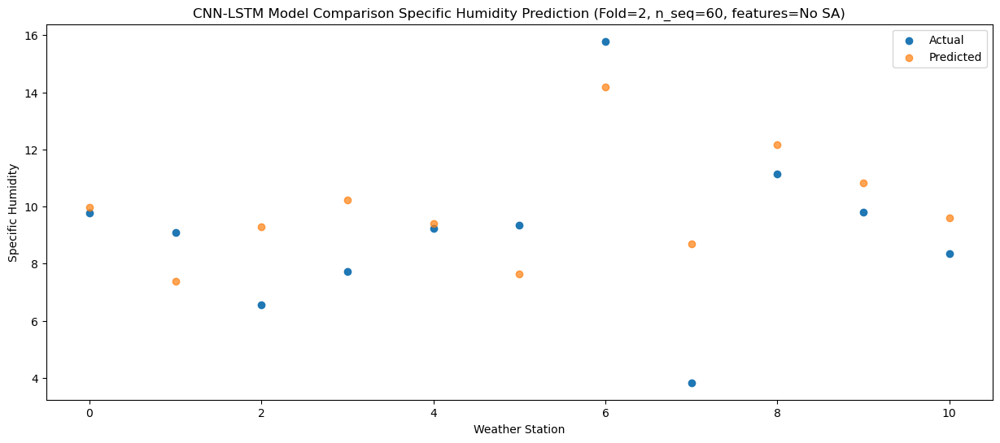

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   11.86  11.366683
1                 1   10.71   8.692296
2                 2    6.96  10.542008
3                 3   10.33  11.610331
4                 4   10.27  10.740455
5                 5    8.30   9.005431
6                 6   16.61  15.568851
7                 7    9.07   9.845105
8                 8   12.28  13.156095
9                 9   11.32  12.190059
10               10    9.77  10.959622


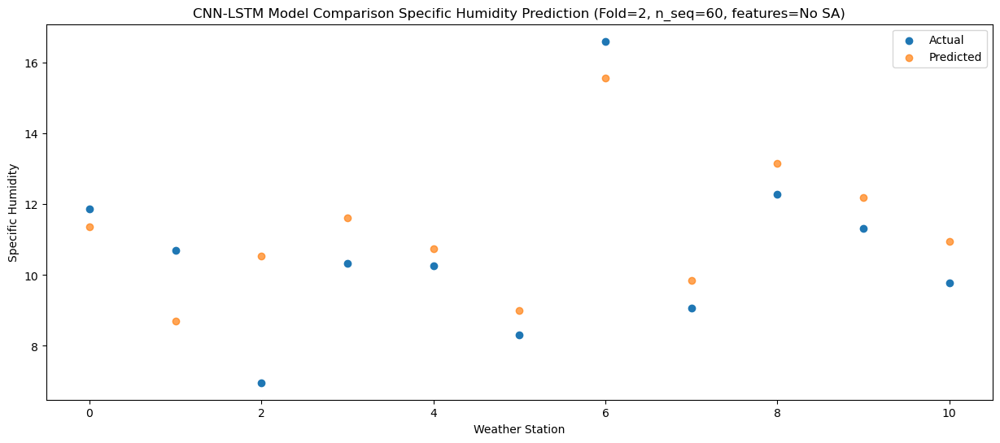

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   11.56  11.921383
1                 1    9.09   9.131563
2                 2    7.58  10.961788
3                 3   11.07  12.145107
4                 4    9.87  11.256860
5                 5    8.43   9.533310
6                 6   16.99  16.128316
7                 7    9.36  10.097336
8                 8   11.68  13.234922
9                 9   11.90  12.710523
10               10   10.16  11.486448


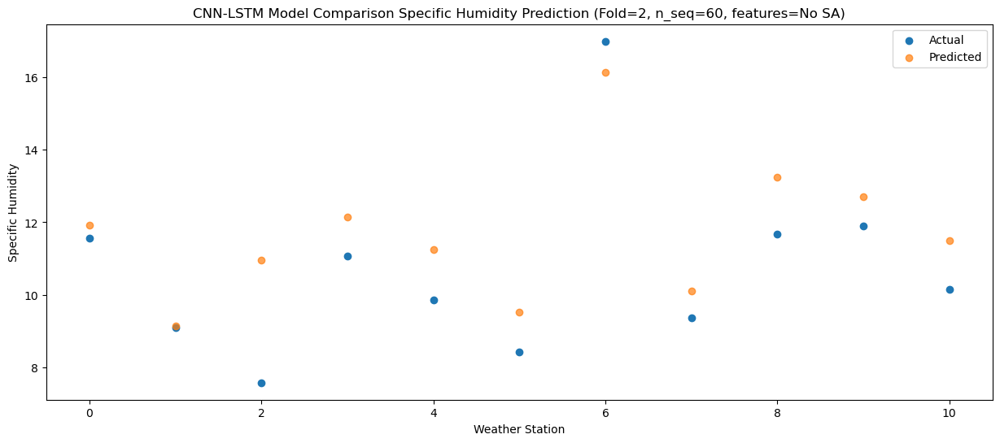

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    7.79   8.407572
1                 1    6.27   5.949479
2                 2    6.30   8.026744
3                 3    8.41   8.704190
4                 4    7.73   8.006496
5                 5    4.87   6.122741
6                 6   12.54  12.598540
7                 7    6.60   7.514584
8                 8   11.22  11.185784
9                 9    8.30   9.388840
10               10    6.95   8.103684


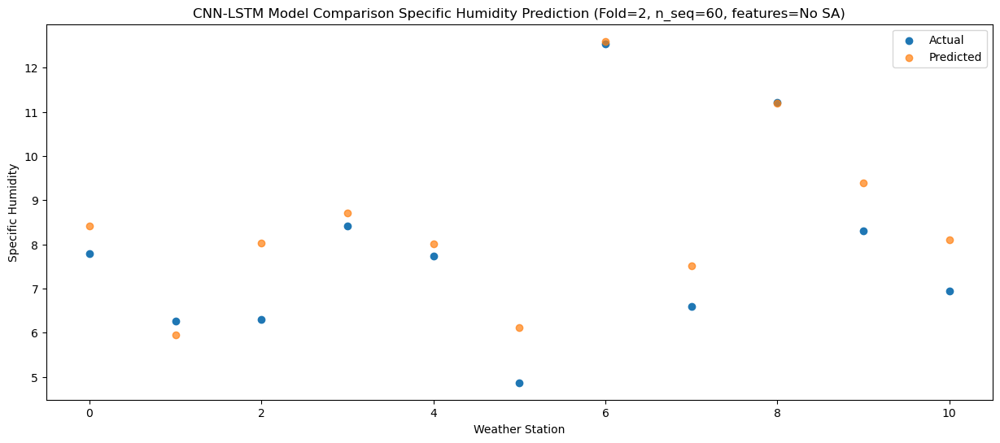

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.34   6.371034
1                 1    2.88   4.040866
2                 2    3.64   5.808970
3                 3    5.45   6.636035
4                 4    5.20   5.779511
5                 5    3.28   4.052522
6                 6    9.93  10.568611
7                 7    2.89   5.584735
8                 8    8.42   9.288944
9                 9    6.14   7.226577
10               10    5.22   5.990976


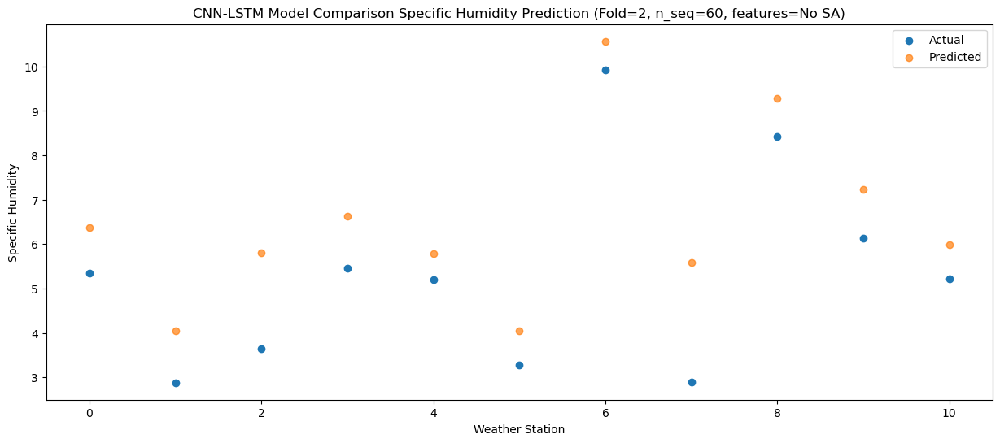

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.15   2.160140
1                 1    0.45   0.858897
2                 2   -0.31   1.587894
3                 3    1.00   2.350229
4                 4   -0.46   1.051074
5                 5   -0.91  -0.154776
6                 6    5.94   6.374601
7                 7    1.24   3.187506
8                 8    7.88   7.825989
9                 9    0.58   2.688054
10               10   -0.14   1.594860


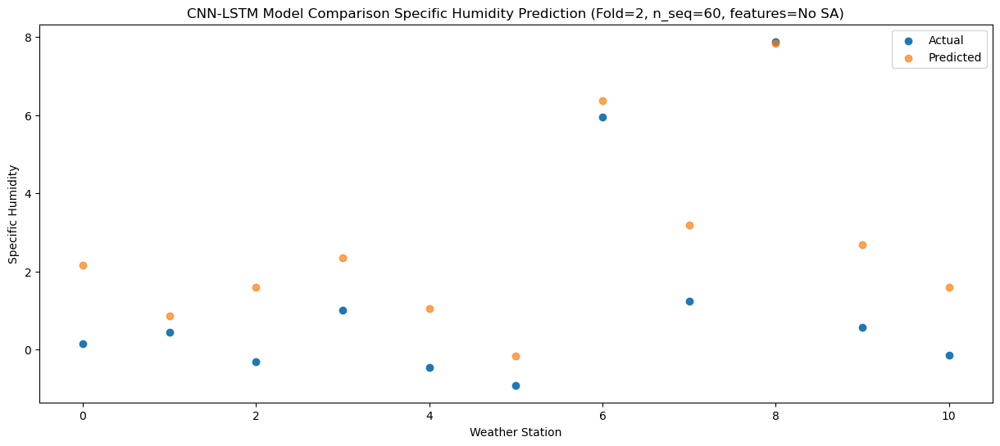

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.55   1.840308
1                 1   -0.61  -0.095069
2                 2    1.09   2.220364
3                 3    0.64   2.210311
4                 4    2.82   1.761809
5                 5    1.96  -0.322032
6                 6    8.44   6.015094
7                 7    1.37   2.267036
8                 8    7.70   6.681545
9                 9    2.43   3.045450
10               10    1.42   1.681478


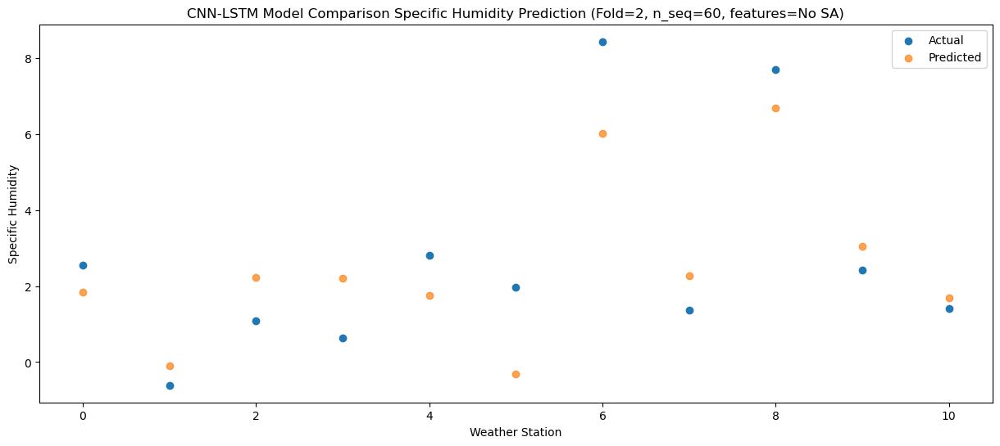

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.44   0.337971
1                 1   -0.94  -0.994167
2                 2   -2.56   0.062799
3                 3   -0.69   0.583243
4                 4   -2.09  -0.538246
5                 5   -3.67  -1.925317
6                 6    3.15   4.539961
7                 7    1.09   1.490915
8                 8    6.34   6.218766
9                 9   -0.35   1.027498
10               10   -1.00  -0.123038


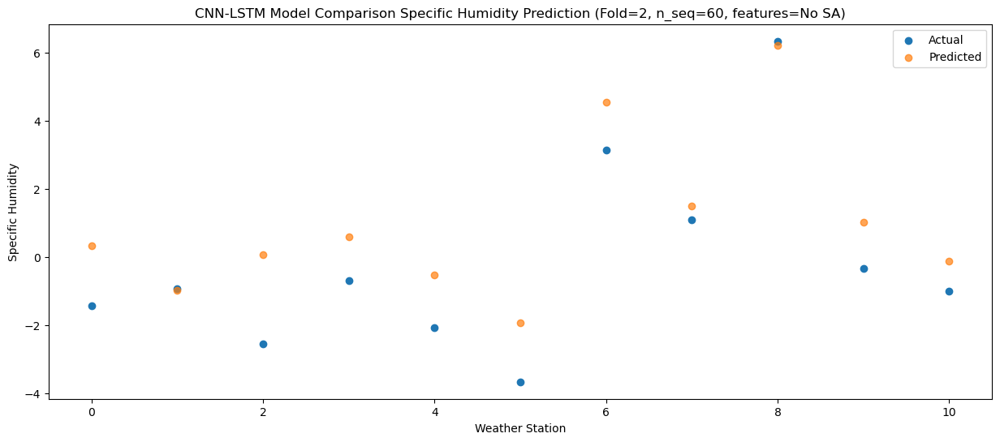

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.78   0.726549
1                 1   -1.03  -0.970226
2                 2   -1.37   0.751023
3                 3   -0.12   1.045707
4                 4   -0.63   0.248192
5                 5   -3.45  -1.485641
6                 6    3.62   4.911947
7                 7    0.10   1.417832
8                 8    5.60   5.938529
9                 9    0.96   1.680589
10               10   -0.10   0.426270


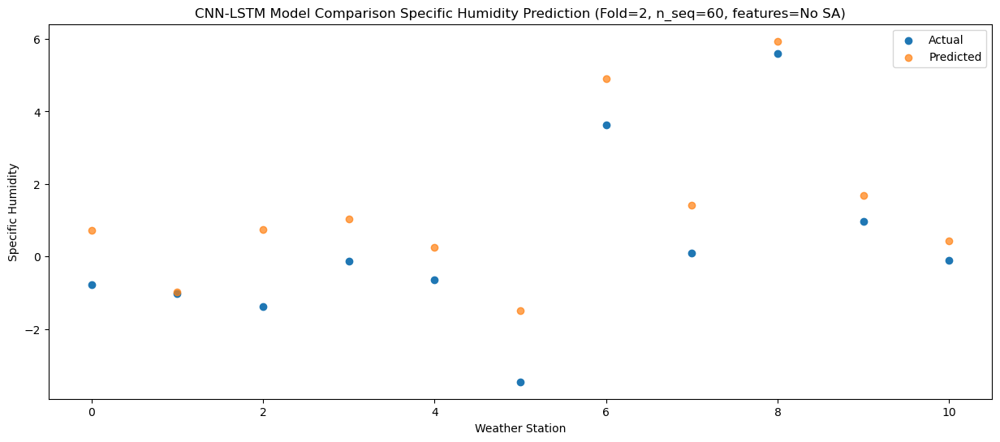

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.65   1.967477
1                 1   -0.15   0.306284
2                 2    0.44   1.863004
3                 3    0.64   2.229753
4                 4    0.22   1.392744
5                 5   -1.83  -0.277748
6                 6    5.25   6.165994
7                 7    0.50   2.582337
8                 8    7.34   7.034717
9                 9    1.92   2.834068
10               10    0.52   1.595937


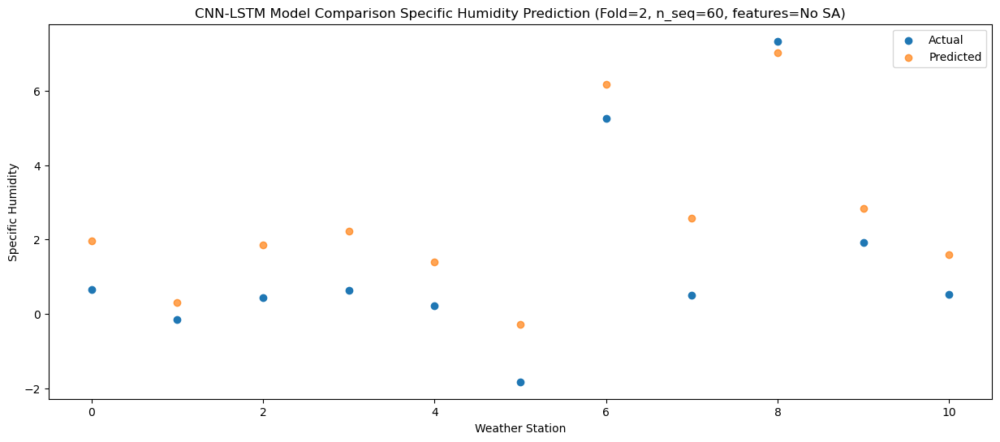

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.55   3.023154
1                 1    1.00   1.132767
2                 2    1.80   2.813510
3                 3    1.34   3.269432
4                 4    2.65   2.495697
5                 5    2.13   0.749486
6                 6    9.15   7.225168
7                 7    0.51   3.124874
8                 8    8.18   7.289836
9                 9    2.96   3.904337
10               10    1.79   2.646967


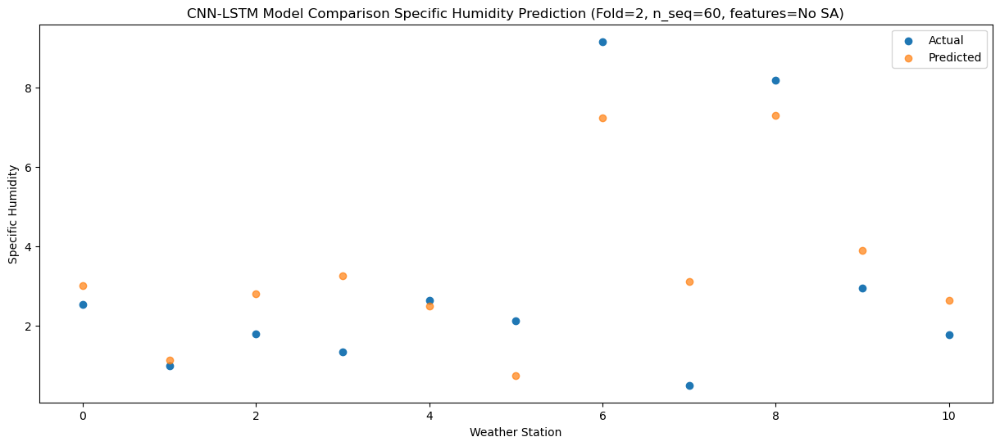

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    6.81   6.974483
1                 1    3.39   4.539730
2                 2    4.90   6.584431
3                 3    4.64   7.177322
4                 4    6.68   6.610615
5                 5    5.78   4.650004
6                 6   13.24  11.186841
7                 7    0.44   5.912142
8                 8    9.44   9.442539
9                 9    7.28   7.917644
10               10    5.95   6.599615


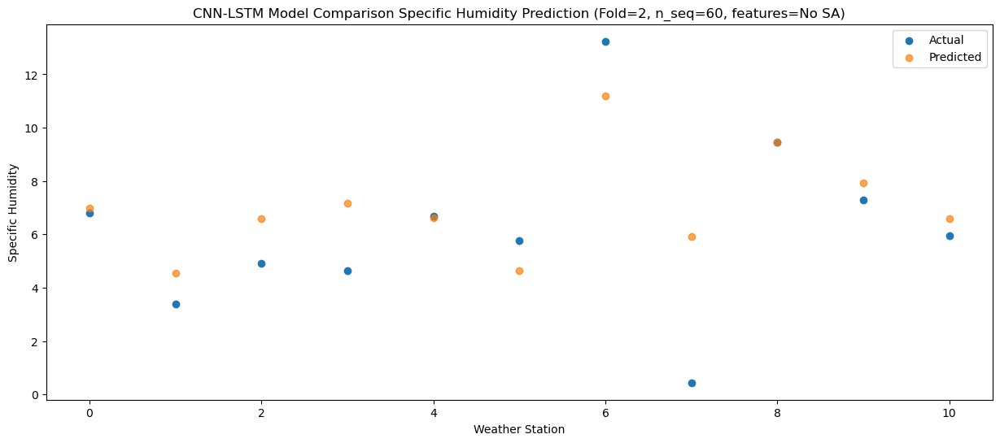

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    8.86   9.443415
1                 1    7.75   7.025360
2                 2    6.83   8.973039
3                 3    6.90   9.613219
4                 4    8.98   9.030671
5                 5    6.81   7.092706
6                 6   14.04  13.663330
7                 7    5.94   8.302073
8                 8   11.21  11.772662
9                 9    9.08  10.337642
10               10    7.91   9.026071


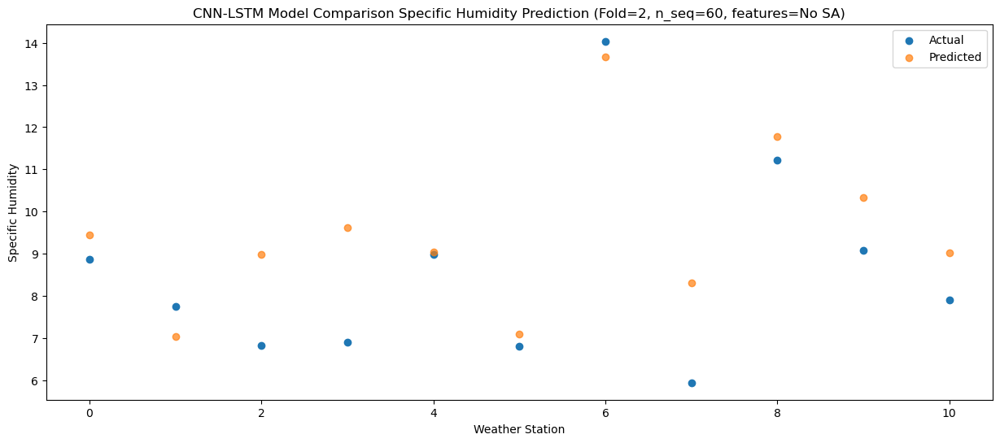

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.08  11.422773
1                 1    9.09   8.797268
2                 2    7.66  10.952673
3                 3   10.26  11.621471
4                 4   10.27  11.106814
5                 5    7.91   9.073785
6                 6   13.36  15.635993
7                 7    8.50   9.934260
8                 8   12.10  13.228847
9                 9   12.66  12.387172
10               10   11.12  11.051812


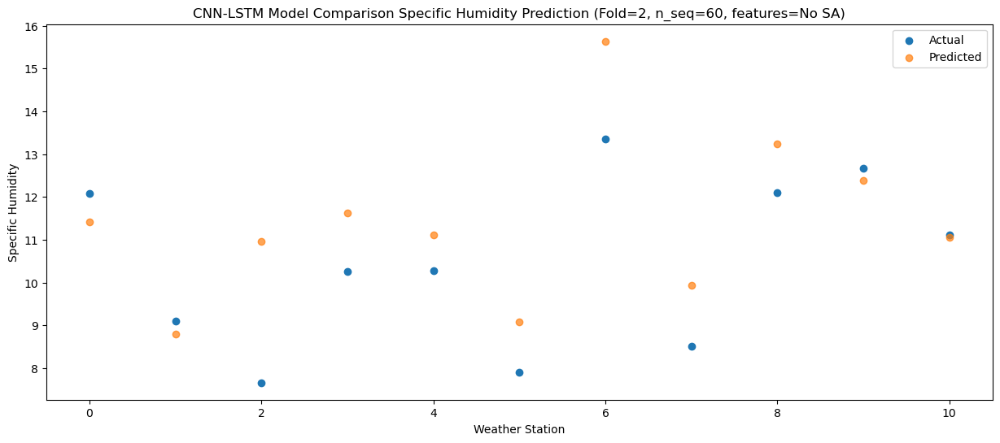

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   11.60  11.304613
1                 1    8.59   8.815032
2                 2    7.55  10.596756
3                 3   10.94  11.444873
4                 4   10.67  10.741997
5                 5    8.37   8.917236
6                 6   14.42  15.531190
7                 7   10.47   9.921083
8                 8   12.20  13.247276
9                 9   11.09  12.099139
10               10   10.13  10.825819


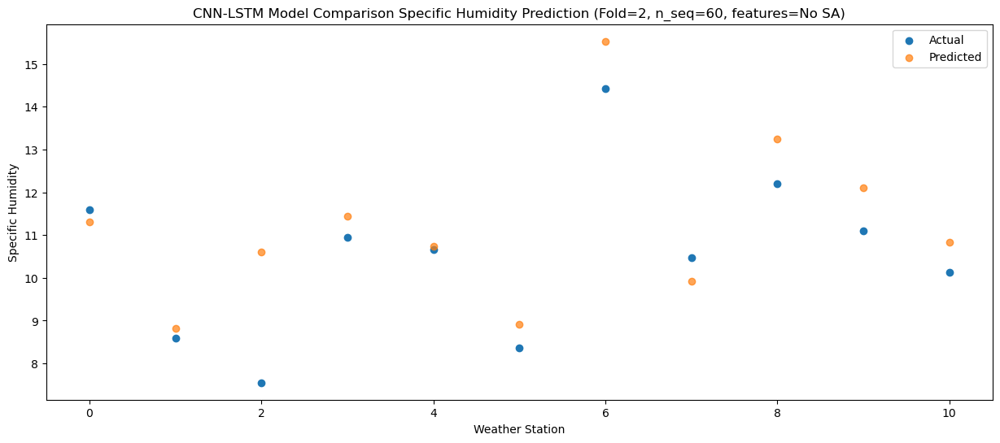

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.85   8.128894
1                 1    6.02   5.910545
2                 2    7.40   7.553529
3                 3    7.14   8.292086
4                 4    7.16   7.526299
5                 5    5.01   5.767979
6                 6   11.75  12.349943
7                 7    7.43   7.321436
8                 8   13.05  10.960728
9                 9    7.66   8.915616
10               10    6.65   7.659685


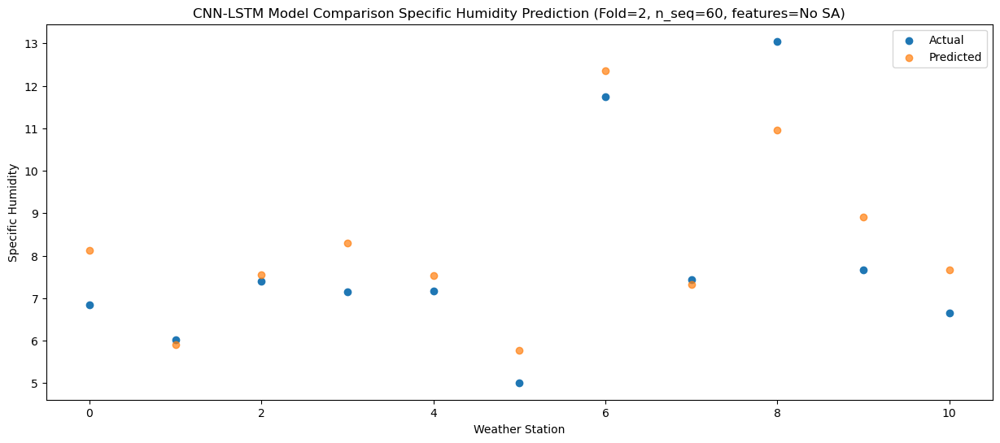

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.13   4.160117
1                 1    2.34   2.586046
2                 2    3.01   3.807161
3                 3    4.27   4.327416
4                 4    1.98   3.391245
5                 5    0.19   1.849889
6                 6    6.97   8.380650
7                 7    5.35   4.661314
8                 8   11.28   8.999492
9                 9    3.30   4.861283
10               10    1.99   3.659284


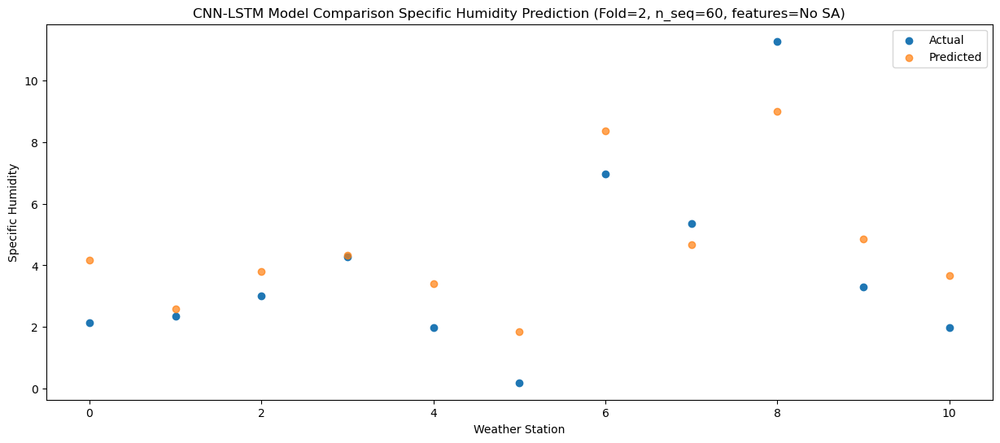

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.19   3.051621
1                 1    0.84   1.014950
2                 2    2.90   2.959003
3                 3    2.45   3.267611
4                 4    1.54   2.726346
5                 5    0.05   0.768115
6                 6    6.52   7.261380
7                 7    1.38   2.813370
8                 8    6.64   6.785924
9                 9    2.83   4.024504
10               10    1.37   2.697880


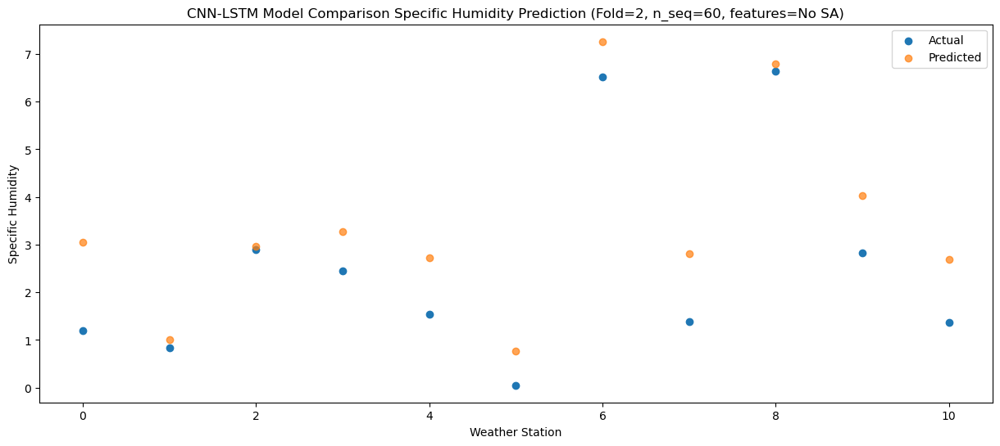

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    0.56   1.713312
1                 1   -0.35   0.124215
2                 2   -0.76   1.483394
3                 3    0.36   1.879836
4                 4    0.99   1.059959
5                 5   -0.86  -0.589021
6                 6    5.35   5.934206
7                 7    2.20   2.199100
8                 8    7.49   6.528314
9                 9    0.59   2.476268
10               10    0.28   1.238887


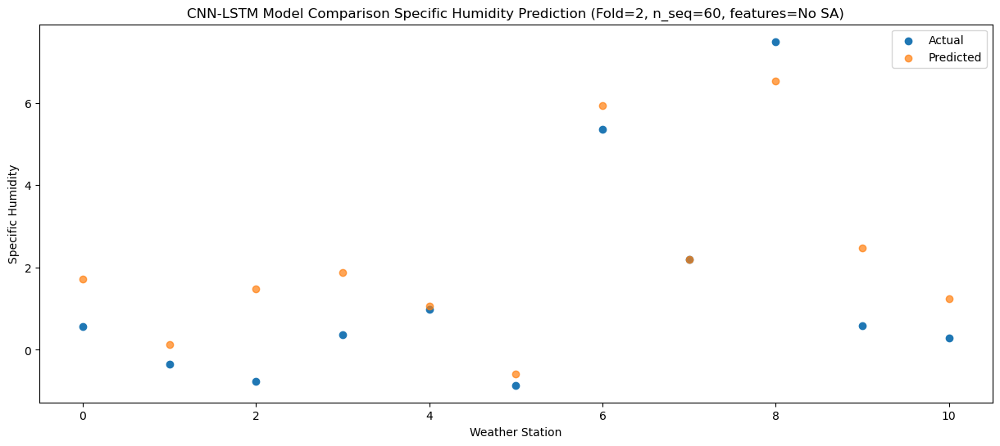

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.97   1.956981
1                 1   -0.36   0.321163
2                 2   -1.14   1.707869
3                 3    0.87   2.133776
4                 4    0.90   1.310805
5                 5   -1.24  -0.347210
6                 6    4.57   6.175426
7                 7    1.31   2.357826
8                 8    7.58   6.644006
9                 9    1.45   2.729604
10               10    0.55   1.491871


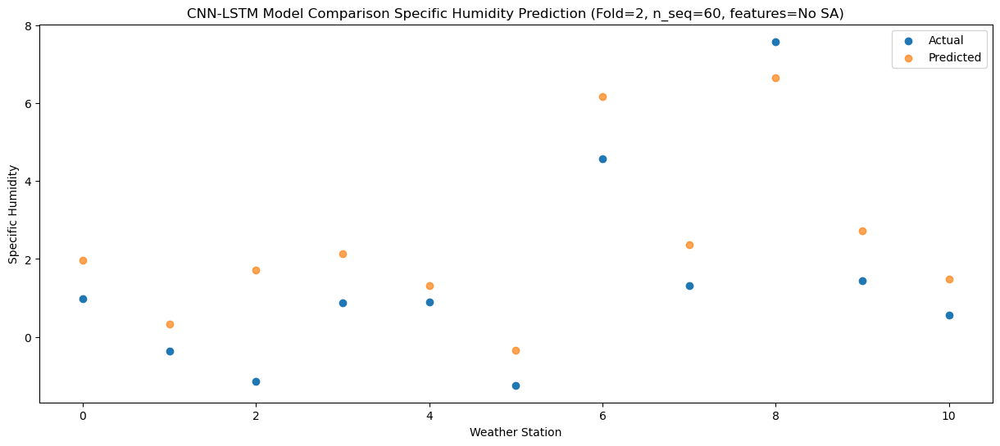

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.19   1.872955
1                 1   -0.44  -0.089056
2                 2    0.71   2.166164
3                 3    0.11   2.131408
4                 4    2.20   1.816659
5                 5   -0.79  -0.357685
6                 6    4.97   6.073568
7                 7    1.19   1.931777
8                 8    6.17   6.078896
9                 9    2.21   3.018672
10               10    0.95   1.620249


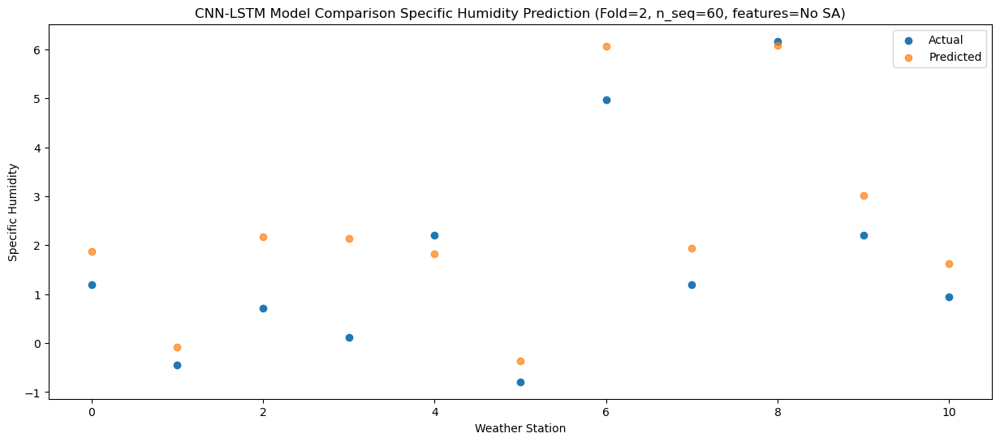

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.54   2.060560
1                 1    0.25   0.237691
2                 2    1.10   2.104486
3                 3    0.36   2.274502
4                 4    3.08   1.736332
5                 5    0.99  -0.202657
6                 6    6.88   6.271374
7                 7    1.53   2.255410
8                 8    8.09   6.452051
9                 9    1.90   3.033503
10               10    0.55   1.706876


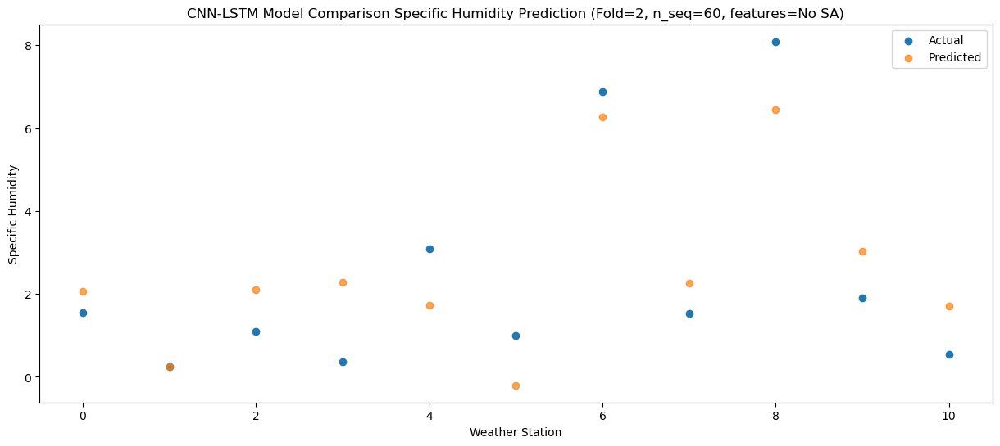

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.48   3.485108
1                 1    0.87   1.449244
2                 2    2.61   3.442653
3                 3    2.44   3.717096
4                 4    3.63   3.194818
5                 5    1.54   1.208476
6                 6    7.55   7.691258
7                 7    0.69   3.273785
8                 8    8.79   7.251954
9                 9    4.03   4.486425
10               10    2.19   3.152201


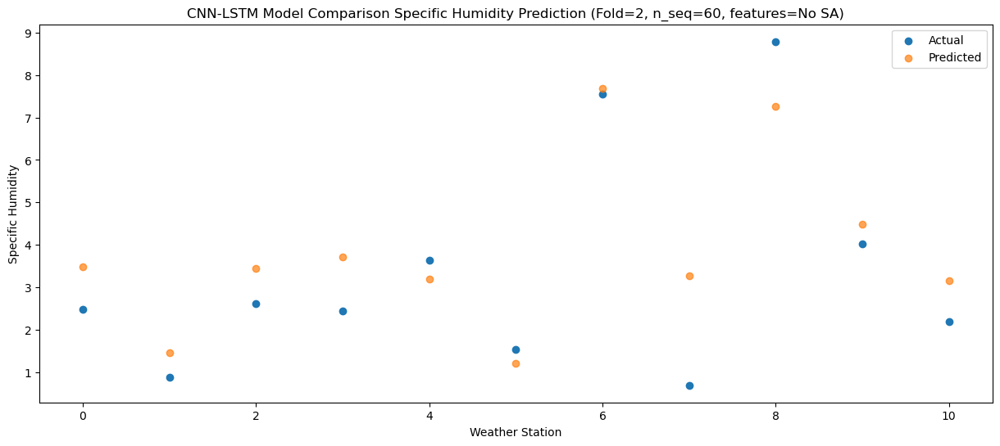

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.09   6.085993
1                 1    6.65   4.231830
2                 2    3.42   5.834539
3                 3    3.25   6.232586
4                 4    6.69   5.570878
5                 5    5.24   3.761622
6                 6   11.44  10.311738
7                 7    2.69   6.001984
8                 8   10.19  10.006236
9                 9    5.56   6.911588
10               10    4.78   5.626329


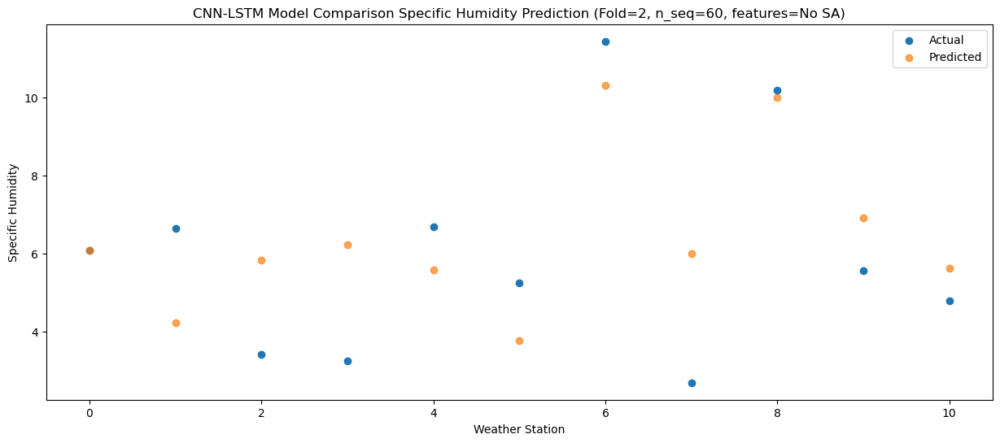

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.06   8.755178
1                 1    9.30   6.404600
2                 2    6.58   8.256989
3                 3    7.15   8.898912
4                 4   10.00   8.303922
5                 5    8.70   6.384216
6                 6   15.34  12.981189
7                 7    2.49   7.644360
8                 8   10.57  11.088715
9                 9    8.42   9.611587
10               10    6.62   8.304171


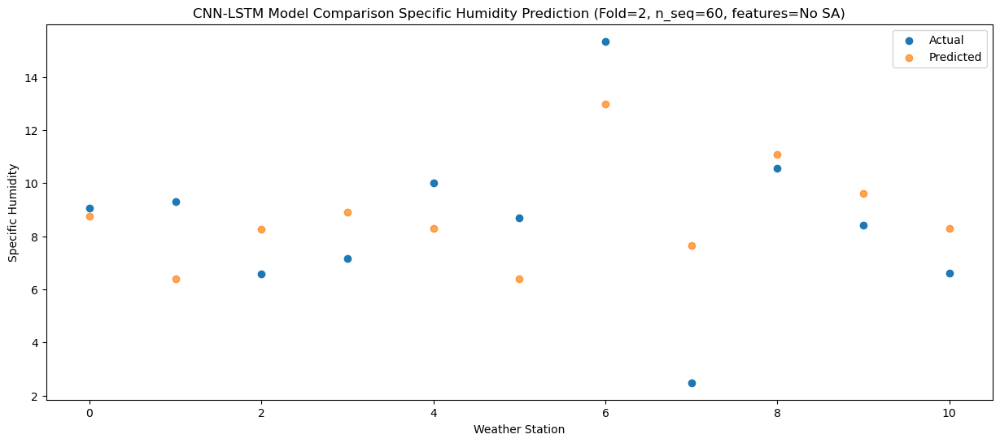

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.24  11.181752
1                 1   11.36   8.279349
2                 2    7.55  10.438421
3                 3   11.41  11.336142
4                 4   11.34  10.792915
5                 5    8.41   8.783071
6                 6   14.63  15.405549
7                 7    5.84   9.026885
8                 8   11.91  11.922659
9                 9   12.26  12.080561
10               10    9.93  10.756523


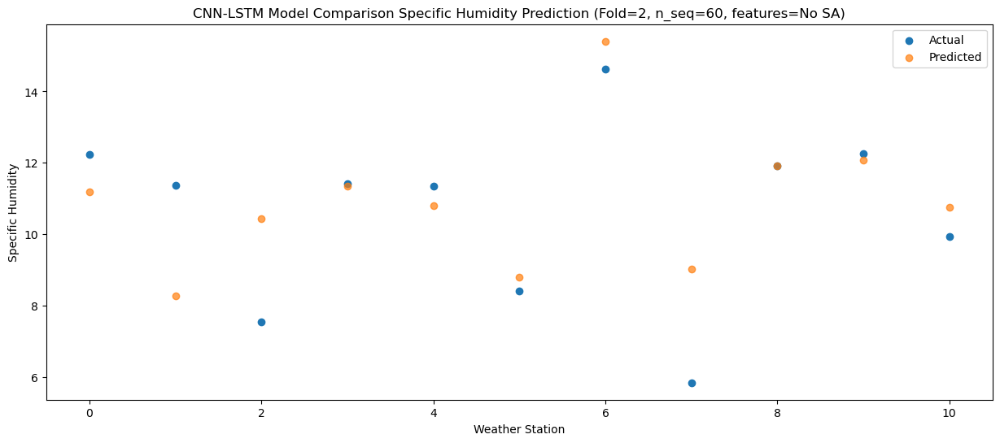

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   11.59  11.164229
1                 1    9.47   8.559214
2                 2    8.27  10.571555
3                 3    9.07  11.304816
4                 4   11.37  10.769108
5                 5    6.98   8.774292
6                 6   12.58  15.391124
7                 7    8.03   9.539968
8                 8   12.52  12.710954
9                 9   11.77  12.049107
10               10   10.04  10.723116


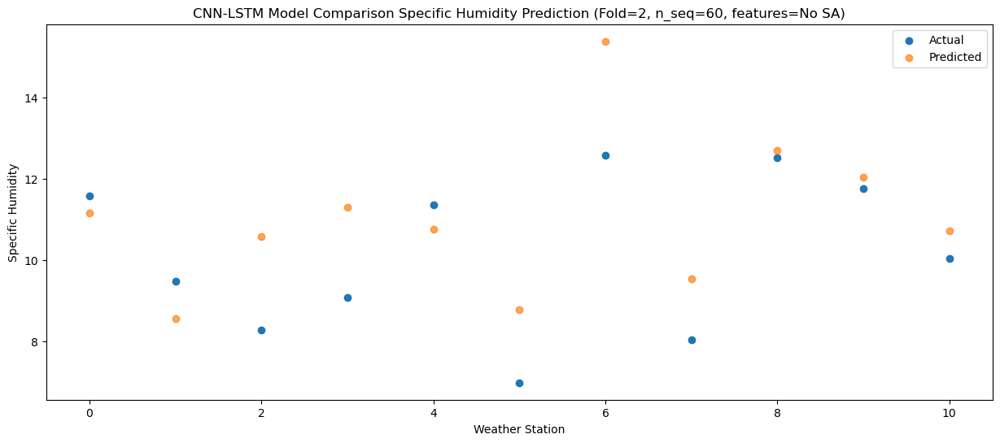

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    7.56   8.357324
1                 1    6.88   6.054864
2                 2    5.88   7.659830
3                 3    8.06   8.493905
4                 4    9.02   7.709366
5                 5    6.43   5.967052
6                 6   11.95  12.584795
7                 7    6.22   7.287622
8                 8   12.27  10.749499
9                 9    8.63   9.102076
10               10    7.62   7.852725


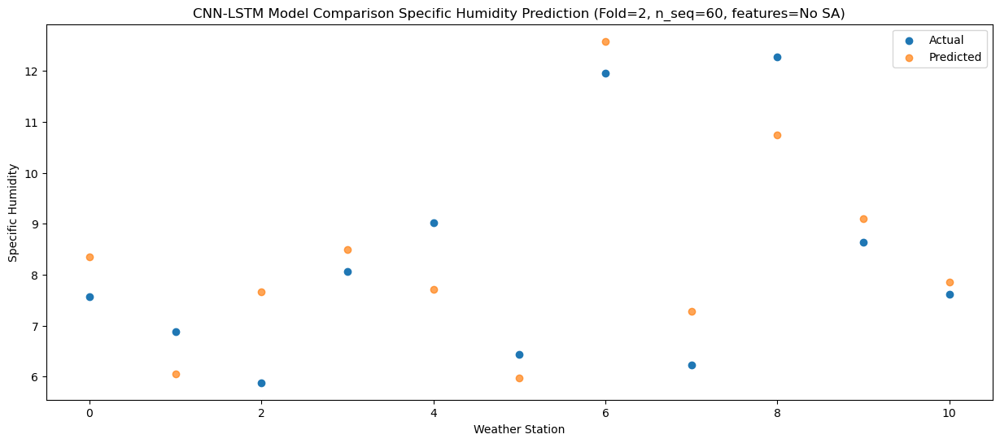

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    3.46   5.087336
1                 1    3.42   3.189879
2                 2    2.96   4.368346
3                 3    4.70   5.220479
4                 4    3.79   4.207852
5                 5    2.90   2.705571
6                 6    8.80   9.315350
7                 7    3.77   4.772443
8                 8    9.97   8.626586
9                 9    4.44   5.703986
10               10    3.51   4.524688


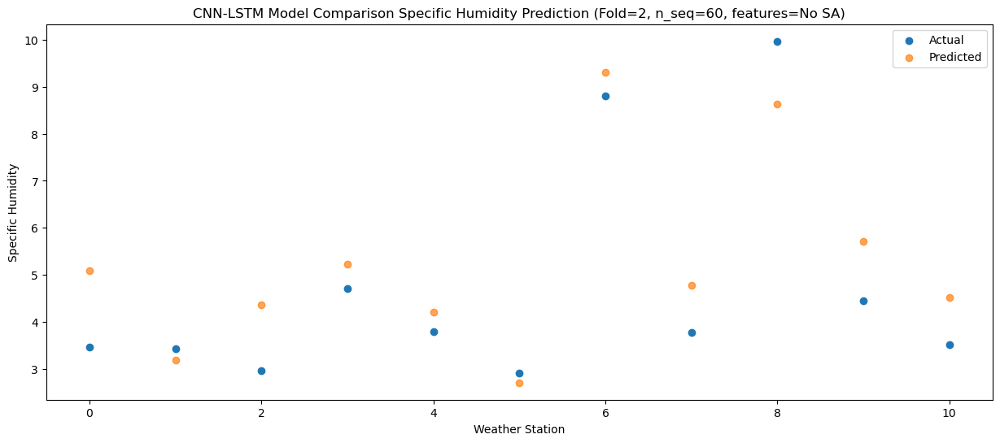

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.82   1.937666
1                 1    0.86   0.324150
2                 2    0.46   1.496436
3                 3    0.87   2.066671
4                 4    1.27   1.145554
5                 5   -0.27  -0.410565
6                 6    6.18   6.167315
7                 7    2.85   2.205582
8                 8    6.94   6.366247
9                 9    1.33   2.600381
10               10    0.56   1.394240


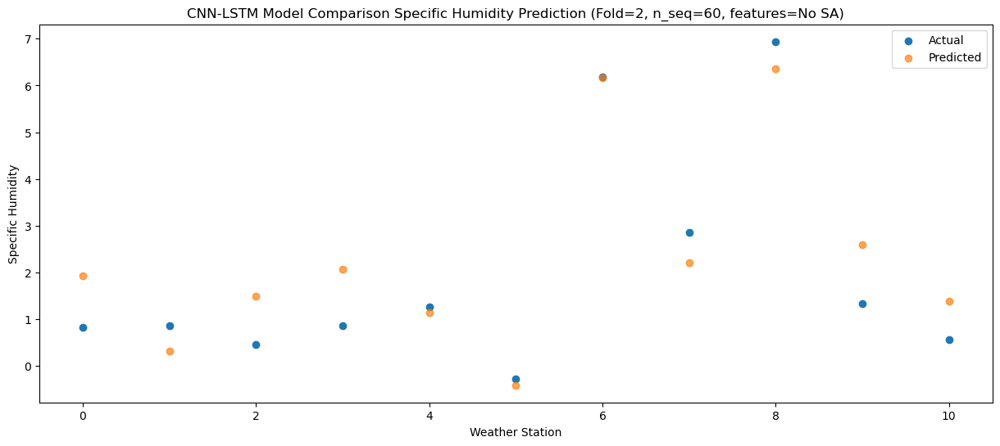

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.10   1.830168
1                 1    0.47   0.348718
2                 2   -0.11   1.007170
3                 3    1.16   1.920108
4                 4   -0.32   0.672320
5                 5   -2.20  -0.572502
6                 6    4.36   6.067772
7                 7    1.33   2.165119
8                 8    7.73   6.332536
9                 9    1.24   2.267046
10               10    0.35   1.162119


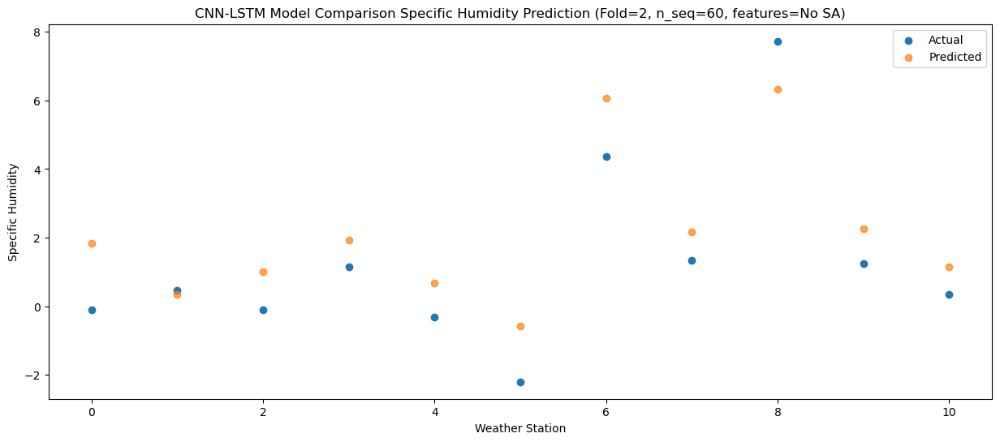

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.99   0.665632
1                 1   -0.12  -0.812679
2                 2   -1.18   0.155036
3                 3   -0.17   0.817518
4                 4   -1.19  -0.268878
5                 5   -3.21  -1.677766
6                 6    3.24   4.889383
7                 7    1.75   1.212248
8                 8    7.70   5.516942
9                 9    0.55   1.264819
10               10   -0.27   0.106992


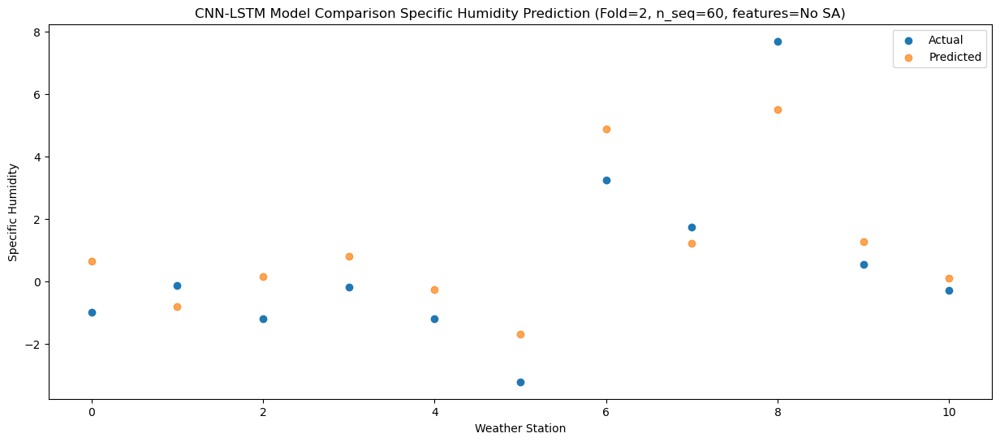

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.88   1.252284
1                 1    0.70  -0.165916
2                 2   -1.60   0.538680
3                 3   -0.22   1.356134
4                 4   -0.13   0.145631
5                 5   -0.81  -1.131142
6                 6    5.71   5.487033
7                 7    1.77   1.754543
8                 8    8.67   6.008106
9                 9    0.69   1.726874
10               10    0.13   0.609673


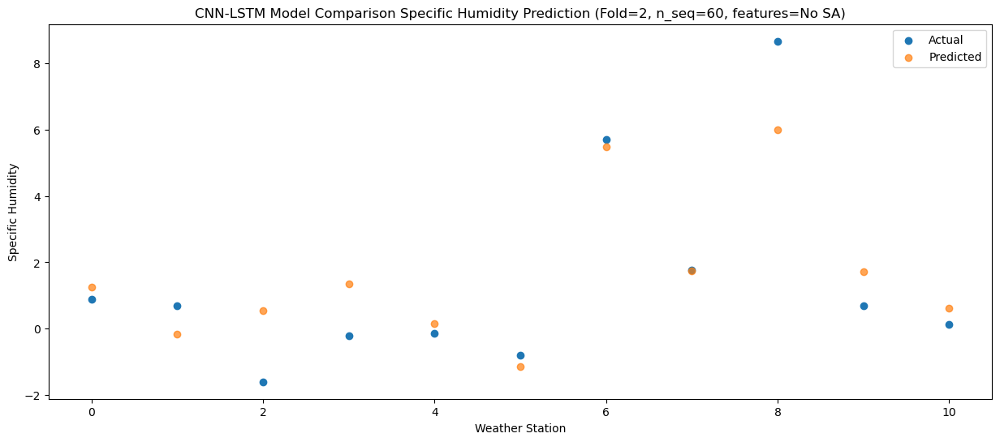

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    1.70   1.836402
1                 1    0.95   0.021282
2                 2    1.56   1.582606
3                 3    0.83   2.060487
4                 4    1.47   1.254093
5                 5    0.83  -0.463205
6                 6    7.33   6.044000
7                 7    1.99   1.943719
8                 8    7.11   6.045383
9                 9    2.10   2.673605
10               10    1.23   1.424732


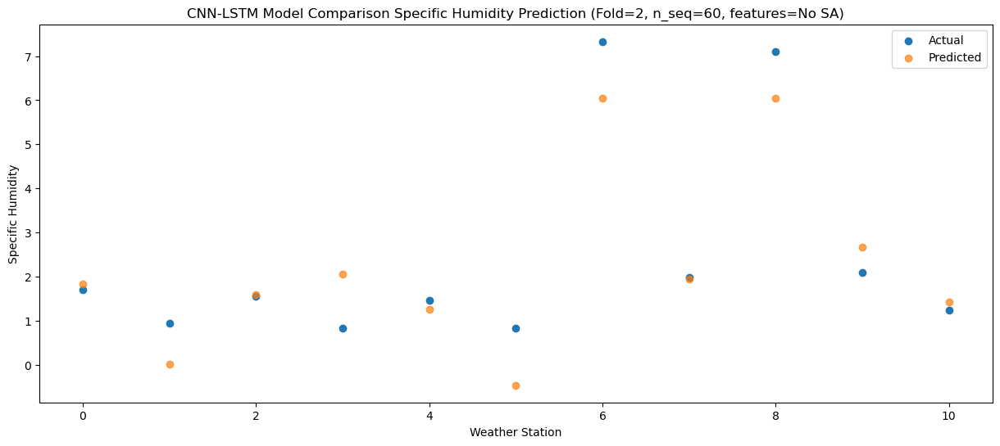

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    3.91   3.634322
1                 1    1.91   1.644678
2                 2    0.35   3.212822
3                 3    1.72   3.828769
4                 4    3.54   3.016306
5                 5    3.11   1.301111
6                 6    9.53   7.848823
7                 7    1.32   3.315806
8                 8    6.21   7.182940
9                 9    4.32   4.432994
10               10    3.34   3.187766


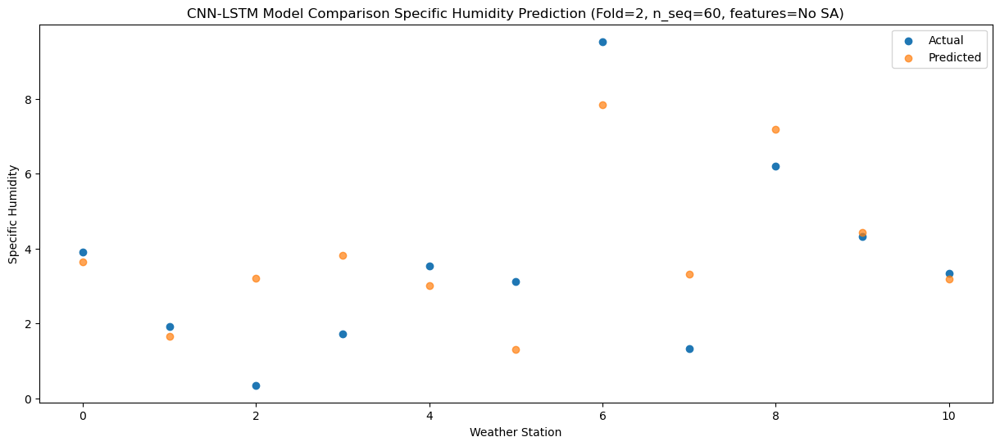

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.17   7.081598
1                 1    4.94   4.497629
2                 2    5.21   6.744083
3                 3    4.90   7.287303
4                 4    7.97   6.835037
5                 5    7.21   4.748598
6                 6   13.31  11.294203
7                 7    1.01   5.698142
8                 8   10.31   9.009736
9                 9    8.20   8.091761
10               10    7.20   6.736074


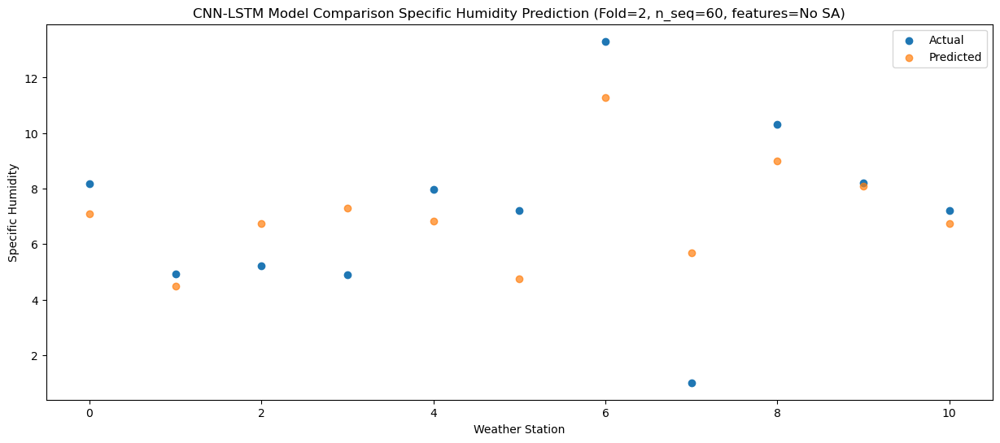

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.14   9.680337
1                 1   10.95   7.153033
2                 2    7.27   8.587013
3                 3    7.82   9.710911
4                 4    9.94   8.877978
5                 5    8.87   7.195303
6                 6   14.90  13.932225
7                 7    5.06   7.840478
8                 8   11.91  10.825732
9                 9   10.07  10.274322
10               10    8.75   9.045386


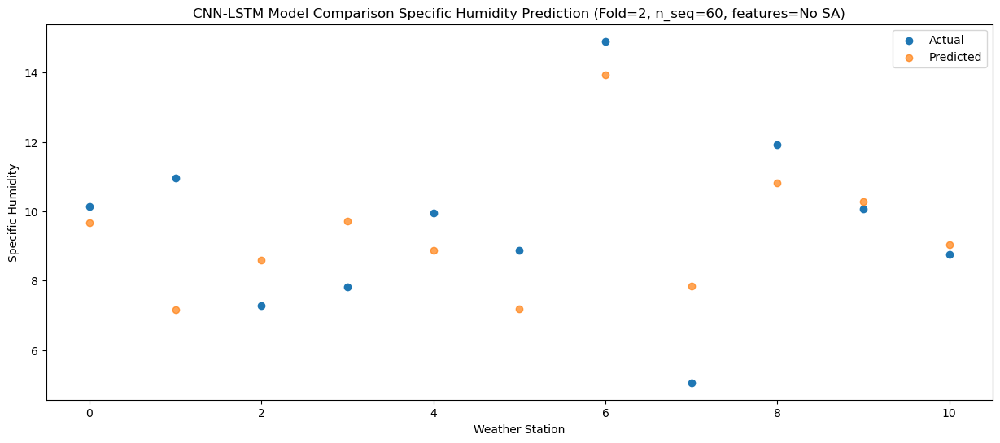

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   11.61  11.220726
1                 1    9.50   8.434272
2                 2    8.32  10.540989
3                 3   10.99  11.357144
4                 4   11.58  10.849067
5                 5    9.17   8.807108
6                 6   15.13  15.448471
7                 7    8.66   9.180988
8                 8   13.14  12.102957
9                 9   12.68  12.115921
10               10   10.79  10.779746


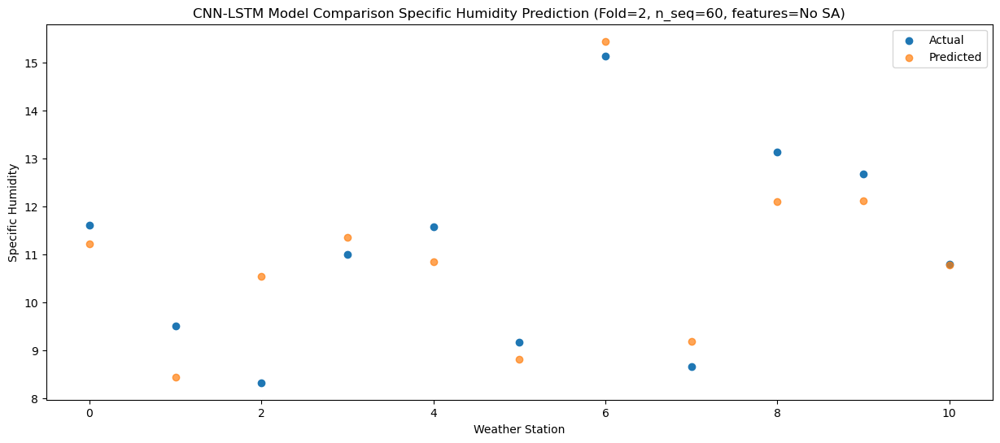

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.61  10.595535
1                 1   10.48   8.108783
2                 2    8.92   9.638920
3                 3    9.49  10.652768
4                 4   10.41   9.874788
5                 5    9.21   8.132347
6                 6   14.95  14.841122
7                 7    8.34   8.904027
8                 8   12.32  11.973470
9                 9   11.42  11.250487
10               10    9.78  10.002607


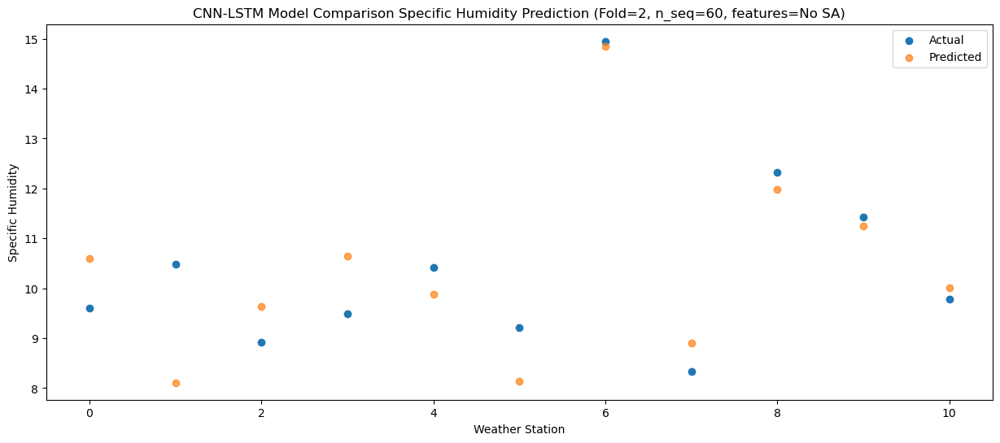

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.99   7.922977
1                 1    6.53   5.503055
2                 2    9.35   7.767834
3                 3    6.60   8.117987
4                 4    8.81   7.757872
5                 5    6.72   5.600889
6                 6   12.05  12.137886
7                 7    5.60   6.836088
8                 8   11.93  10.293929
9                 9    9.57   8.969838
10               10    7.68   7.586447


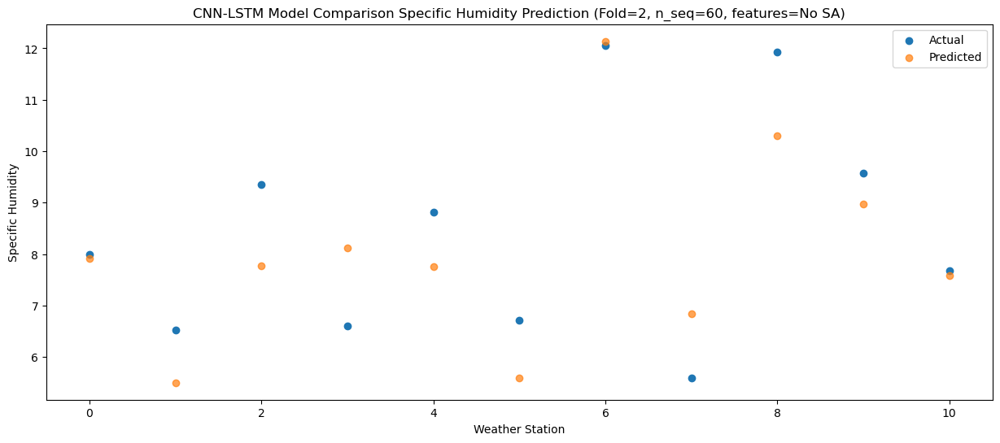

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.61   4.217954
1                 1    3.67   2.212067
2                 2    4.37   4.062047
3                 3    3.36   4.414234
4                 4    3.95   3.830881
5                 5    2.40   1.909491
6                 6    8.63   8.432354
7                 7    2.71   3.922305
8                 8   10.03   7.794875
9                 9    4.95   5.145098
10               10    3.61   3.830156


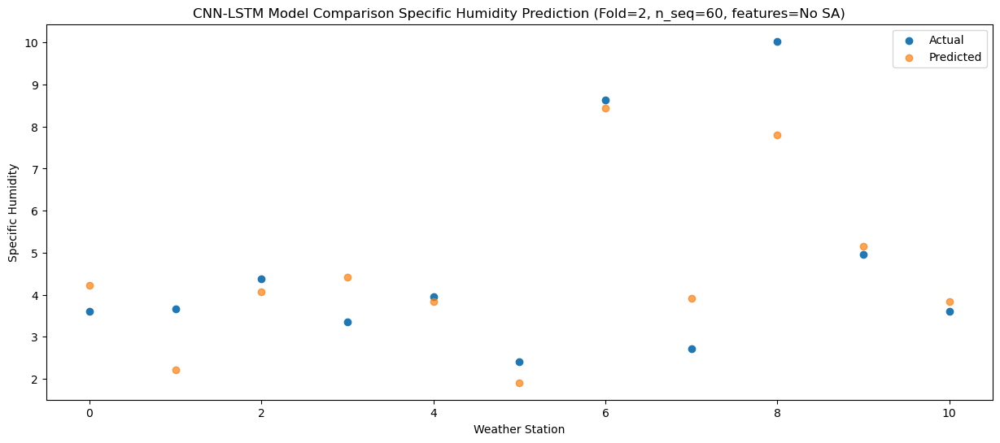

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_2 (Conv1D)           (None, 1, 1024)           1859584   
                                                                 
 max_pooling1d_2 (MaxPooling  (None, 1, 1024)          0         
 1D)                                                             
                                                                 
 dropout_6 (Dropout)         (None, 1, 1024)           0         
                                                                 
 lstm_4 (LSTM)               (None, 1, 512)            3147776   
                                                                 
 dropout_7 (Dropout)         (None, 1, 512)            0         
                                                                 
 lstm_5 (LSTM)               (None, 512)               2099200   
                                                      

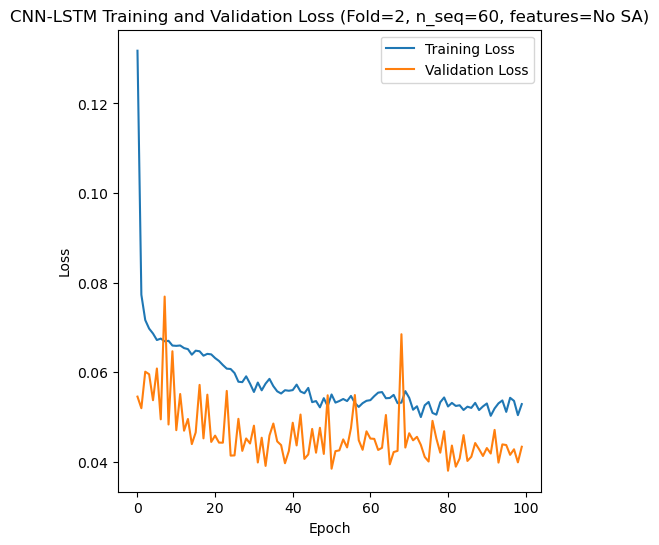

Epoch 1/100
84/84 [==============================] - 23s 88ms/step - loss: 0.1310 - accuracy: 0.2024 - mae: 0.1117 - rmse: 0.1310 - mape: 23.6958 - pearson: 0.6027 - val_loss: 0.0816 - val_accuracy: 0.0000e+00 - val_mae: 0.0655 - val_rmse: 0.0816 - val_mape: 13.6306 - val_pearson: 0.7074
Epoch 2/100
84/84 [==============================] - 4s 43ms/step - loss: 0.0743 - accuracy: 0.3690 - mae: 0.0587 - rmse: 0.0743 - mape: 13.1432 - pearson: 0.7641 - val_loss: 0.0626 - val_accuracy: 0.0000e+00 - val_mae: 0.0492 - val_rmse: 0.0626 - val_mape: 10.7912 - val_pearson: 0.7285
Epoch 3/100
84/84 [==============================] - 3s 39ms/step - loss: 0.0706 - accuracy: 0.3929 - mae: 0.0556 - rmse: 0.0706 - mape: 12.6956 - pearson: 0.7801 - val_loss: 0.0734 - val_accuracy: 0.6000 - val_mae: 0.0579 - val_rmse: 0.0734 - val_mape: 12.3627 - val_pearson: 0.6978
Epoch 4/100
84/84 [==============================] - 3s 39ms/step - loss: 0.0672 - accuracy: 0.4286 - mae: 0.0531 - rmse: 0.0672 - mape: 12

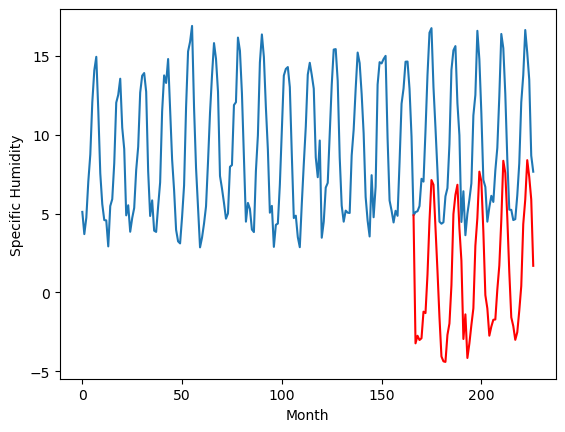

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.14		-0.58		-0.44
-0.55		-0.60		-0.05
-0.58		-0.53		0.05
-0.94		-0.84		0.10
1.66		1.44		-0.22
1.81		1.49		-0.32
4.78		4.39		-0.39
8.31		7.47		-0.84
11.05		10.49		-0.56
8.38		8.76		0.38
6.94		6.07		-0.87
2.37		2.16		-0.21
0.87		0.33		-0.54
-1.17		-1.53		-0.36
-1.26		-1.75		-0.49
-1.82		-2.52		-0.70
0.69		-0.00		-0.69
1.86		0.98		-0.88
5.38		4.10		-1.28
9.91		8.16		-1.75
10.79		9.40		-1.39
10.96		9.52		-1.44
6.99		6.14		-0.85
4.80		3.93		-0.87
0.37		-0.30		-0.67
1.34		0.57		-0.77
-1.85		-1.95		-0.10
-1.48		-1.57		-0.09
-0.01		-0.22		-0.21
2.29		1.71		-0.58
6.74		5.80		-0.94
9.36		7.83		-1.53
9.57		9.86		0.29
10.18		9.54		-0.64
6.33		5.92		-0.41
1.87		1.78		-0.09
0.84		0.63		-0.21
-0.35		-0.53		-0.18
-0.43		-0.21		0.22
-0.27		-0.17		0.10
0.67		0.54		-0.13
1.54		1.94		0.40
5.95		5.20		-0.75
8.59		7.99		-0.60
10.86		10.67		-0.19
11.10		9.90		-1.20
7.03		7.22		0.19
3.59		3.72		0.13
0.71		0.92		0.

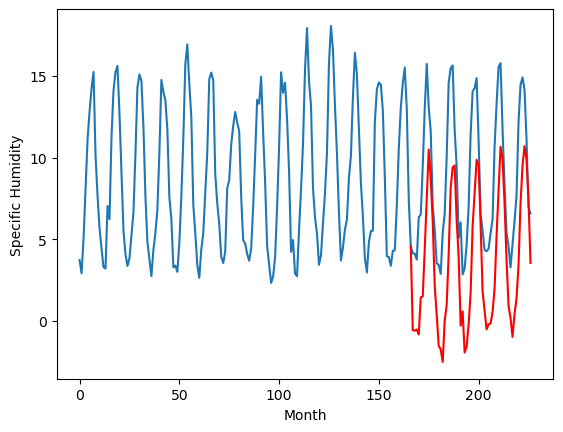

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.99		5.55		-0.44
6.53		5.62		-0.91
6.15		5.50		-0.65
5.46		5.41		-0.05
6.54		5.71		-0.83
7.91		6.20		-1.71
7.72		7.37		-0.35
9.26		8.36		-0.90
9.48		8.82		-0.66
11.00		9.00		-2.00
10.52		8.12		-2.40
8.64		7.07		-1.57
5.95		5.91		-0.04
5.35		4.95		-0.40
5.79		5.14		-0.65
5.73		4.87		-0.86
5.81		4.88		-0.93
6.43		4.77		-1.66
6.83		6.57		-0.26
9.28		8.23		-1.05
9.98		9.28		-0.70
9.51		9.12		-0.39
8.22		8.45		0.23
7.08		6.96		-0.12
7.66		6.85		-0.81
6.16		5.38		-0.78
5.88		5.51		-0.37
5.10		5.25		0.15
6.44		6.32		-0.12
6.11		5.85		-0.26
6.29		7.04		0.75
7.46		8.92		1.46
8.63		10.34		1.71
9.42		10.65		1.23
9.13		8.86		-0.27
7.96		8.38		0.42
5.24		5.85		0.61
6.08		5.46		-0.62
6.23		5.80		-0.43
5.10		5.26		0.16
6.62		5.74		-0.88
6.82		6.84		0.02
7.76		9.20		1.44
8.53		9.72		1.19
9.63		10.74		1.11
10.70		11.33		0.63
9.16		9.79		0.63
8.00		8.79		0.79
5.89		7.35		1.46
6.12		7.02		0.90
6.66		6.60		-0.0

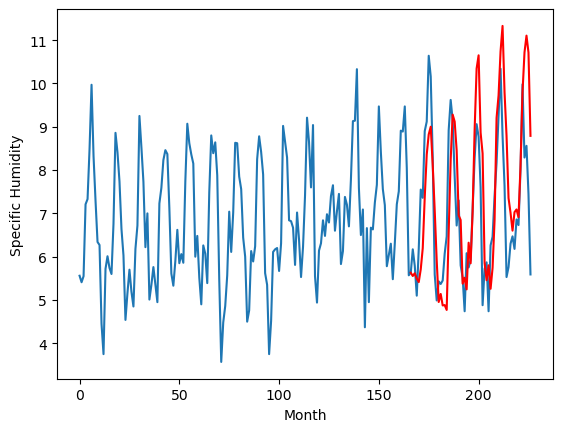

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.83		-0.51		0.32
-0.30		-0.14		0.16
-0.70		-0.34		0.36
-0.88		-0.41		0.47
0.98		1.09		0.11
0.90		1.17		0.27
4.33		3.83		-0.50
7.57		7.25		-0.32
10.67		10.15		-0.52
9.59		9.31		-0.28
7.02		6.34		-0.68
3.33		3.29		-0.04
0.44		0.89		0.45
-1.17		-1.11		0.06
-1.44		-1.51		-0.07
-1.51		-1.89		-0.38
-0.21		-0.07		0.14
0.98		0.86		-0.12
3.51		3.21		-0.30
8.93		7.78		-1.15
9.56		9.15		-0.41
10.44		9.77		-0.67
6.97		6.69		-0.28
4.91		4.74		-0.17
-0.78		-0.00		0.78
0.36		0.94		0.58
-1.96		-1.25		0.71
-1.44		-0.58		0.86
-0.46		0.60		1.06
0.81		1.68		0.87
5.23		5.67		0.44
7.49		7.44		-0.05
10.53		10.37		-0.16
9.40		9.89		0.49
6.15		6.58		0.43
1.00		2.59		1.59
0.19		1.53		1.34
-0.84		-0.02		0.82
-0.30		0.63		0.93
-0.48		0.65		1.13
-0.61		0.78		1.39
0.93		2.72		1.79
3.84		4.42		0.58
5.86		7.30		1.44
9.51		11.20		1.69
8.96		10.28		1.32
6.49		7.59		1.10
2.96		4.25		1.29
-0.43		1.24		1.67
-0.41		0.99		1.40
-

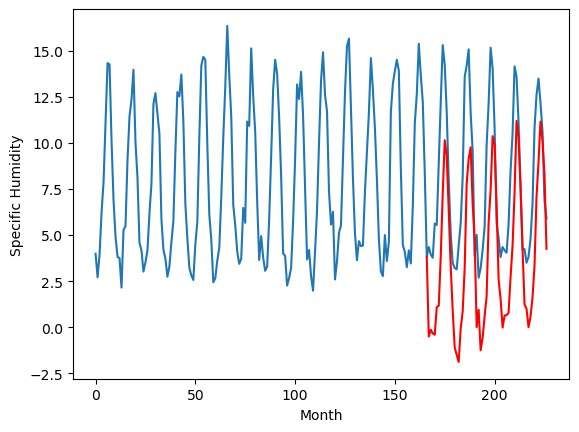

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.61		1.63		-1.98
2.11		1.76		-0.35
-0.18		1.66		1.84
-0.94		1.40		2.34
1.13		3.11		1.98
1.45		3.29		1.84
5.15		6.26		1.11
8.24		9.65		1.41
12.19		12.76		0.57
9.81		11.23		1.42
6.85		8.11		1.26
2.13		4.49		2.36
1.03		2.67		1.64
-0.90		1.00		1.90
-1.10		0.64		1.74
-1.93		-0.12		1.81
0.55		2.10		1.55
1.61		3.14		1.53
4.03		5.77		1.74
8.49		10.20		1.71
10.44		11.63		1.19
10.53		12.02		1.49
6.76		8.62		1.86
4.81		6.62		1.81
-0.31		2.14		2.45
0.39		2.67		2.28
-2.07		0.66		2.73
-1.45		1.09		2.54
0.12		2.39		2.27
1.68		3.78		2.10
5.77		7.87		2.10
7.87		9.83		1.96
10.46		12.49		2.03
9.96		12.05		2.09
6.86		8.52		1.66
1.86		4.39		2.53
0.47		3.17		2.70
-0.65		1.85		2.50
-0.27		2.44		2.71
0.61		2.25		1.64
0.28		2.66		2.38
1.51		4.39		2.88
4.69		6.86		2.17
6.82		9.74		2.92
10.59		13.24		2.65
10.98		12.45		1.47
6.87		9.69		2.82
3.25		6.28		3.03
0.08		3.31		3.23
-0.33		3.05		3.38
-1.20		1.91		3.11
-0.29		2

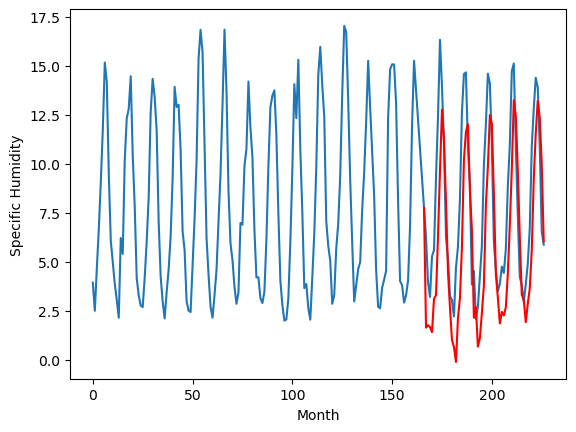

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.24		-0.06		-0.30
0.53		0.18		-0.35
0.03		0.03		-0.00
-0.22		-0.16		0.06
1.77		1.41		-0.36
1.89		1.57		-0.32
5.10		4.43		-0.67
7.83		7.88		0.05
10.99		10.94		-0.05
9.77		9.68		-0.09
6.59		6.56		-0.03
3.17		3.18		0.01
1.40		1.14		-0.26
-0.26		-0.64		-0.38
-0.57		-1.03		-0.46
-1.09		-1.65		-0.56
0.94		0.39		-0.55
2.24		1.41		-0.83
4.48		3.87		-0.61
9.70		8.41		-1.29
10.95		9.84		-1.11
11.12		10.35		-0.77
7.82		7.06		-0.76
6.20		5.10		-1.10
0.33		0.47		0.14
1.38		1.13		-0.25
-1.13		-0.90		0.23
-0.60		-0.37		0.23
0.71		0.87		0.16
2.24		2.10		-0.14
6.47		6.17		-0.30
8.54		8.04		-0.50
11.32		10.88		-0.44
10.12		10.41		0.29
7.35		6.96		-0.39
2.05		2.86		0.81
0.83		1.71		0.88
0.07		0.28		0.21
0.65		0.92		0.27
0.32		0.79		0.47
0.75		1.06		0.31
2.06		2.91		0.85
4.66		5.00		0.34
6.82		7.90		1.08
11.33		11.66		0.33
10.45		10.81		0.36
7.22		8.06		0.84
3.84		4.67		0.83
0.65		1.66		1.01
0.61		1.46		0.85
-0

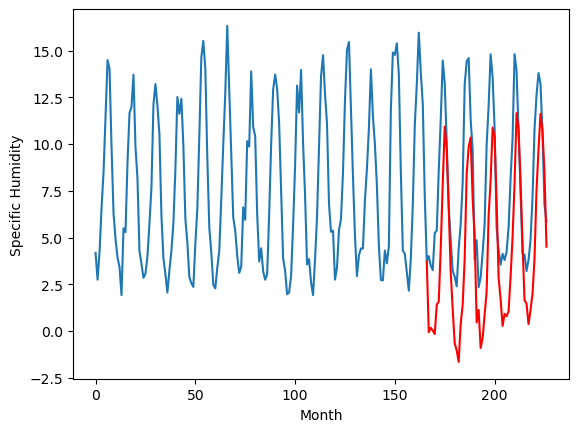

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
6.16		4.41		-1.75
5.79		4.45		-1.34
5.75		4.38		-1.37
5.71		4.22		-1.49
6.34		5.03		-1.31
6.69		5.44		-1.25
7.82		7.18		-0.64
8.88		8.82		-0.06
10.40		10.11		-0.29
9.19		9.68		0.49
8.05		8.15		0.10
6.40		6.24		-0.16
6.34		4.99		-1.35
5.53		3.86		-1.67
5.70		3.91		-1.79
5.76		3.44		-2.32
6.07		4.19		-1.88
6.54		4.44		-2.10
7.94		6.59		-1.35
9.27		9.01		-0.26
11.72		10.18		-1.54
10.29		10.10		-0.19
8.59		8.58		-0.01
7.50		6.92		-0.58
6.79		5.59		-1.20
6.08		4.69		-1.39
5.60		4.19		-1.41
5.39		4.09		-1.30
6.07		5.26		-0.81
6.57		5.45		-1.12
7.38		7.54		0.16
9.32		9.48		0.16
12.31		11.16		-1.15
12.15		11.28		-0.87
9.20		8.93		-0.27
7.59		7.36		-0.23
5.93		5.19		-0.74
5.96		4.58		-1.38
5.93		4.96		-0.97
5.55		4.53		-1.02
5.85		5.07		-0.78
6.48		6.29		-0.19
8.64		8.89		0.25
8.87		10.10		1.23
9.71		11.68		1.97
11.36		11.86		0.50
8.74		9.98		1.24
7.49		8.26		0.77
6.16		6.41		0.25
6.03		6.05		0.02
5.9

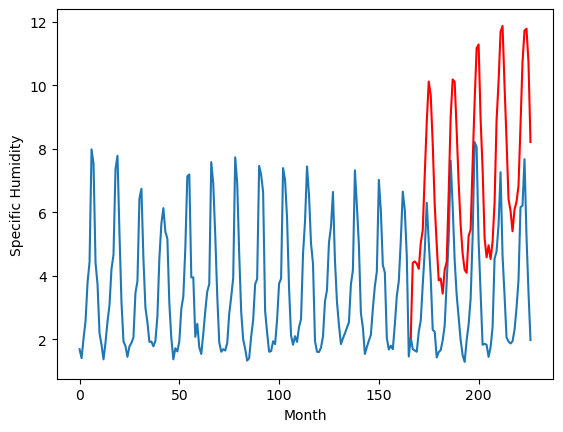

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.99		3.68		-1.31
5.98		3.67		-2.31
4.86		3.59		-1.27
4.44		3.46		-0.98
6.18		3.91		-2.27
5.99		4.38		-1.61
5.29		5.72		0.43
5.62		6.78		1.16
6.10		7.43		1.33
6.97		7.35		0.38
5.71		6.34		0.63
4.70		5.02		0.32
4.68		3.98		-0.70
3.85		3.07		-0.78
4.66		3.24		-1.42
4.18		2.84		-1.34
4.48		3.07		-1.41
4.17		3.04		-1.13
4.73		4.99		0.26
6.15		6.71		0.56
11.51		7.80		-3.71
9.08		7.57		-1.51
7.36		6.70		-0.66
6.26		5.16		-1.10
4.99		4.95		-0.04
5.13		3.48		-1.65
4.14		3.55		-0.59
3.71		3.25		-0.46
4.33		4.37		0.04
4.33		4.09		-0.24
4.59		5.46		0.87
6.35		7.40		1.05
9.78		8.77		-1.01
12.85		9.05		-3.80
8.94		7.12		-1.82
6.21		6.44		0.23
4.44		3.93		-0.51
5.19		3.56		-1.63
5.58		3.89		-1.69
4.33		3.34		-0.99
5.37		3.91		-1.46
4.52		4.96		0.44
6.06		7.59		1.53
6.56		8.21		1.65
7.53		9.18		1.65
10.11		9.71		-0.40
9.17		8.12		-1.05
6.11		6.99		0.88
5.10		5.51		0.41
5.02		5.15		0.13
5.56		4.66		-0.90
6.3

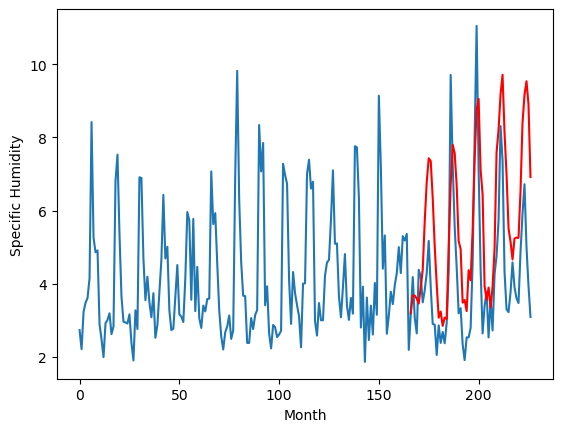

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.53		3.40		-1.13
5.76		3.50		-2.26
5.08		3.37		-1.71
4.19		3.32		-0.87
4.67		3.62		-1.05
5.73		4.08		-1.65
6.59		5.16		-1.43
6.81		6.12		-0.69
7.28		6.48		-0.80
8.08		6.82		-1.26
7.69		6.05		-1.64
5.49		5.13		-0.36
4.33		3.82		-0.51
3.99		2.75		-1.24
4.66		2.96		-1.70
4.31		2.80		-1.51
3.96		2.72		-1.24
4.89		2.56		-2.33
5.33		4.34		-0.99
6.76		5.98		-0.78
7.24		6.98		-0.26
7.63		6.85		-0.78
6.99		6.29		-0.70
5.96		4.78		-1.18
6.18		4.66		-1.52
4.93		3.31		-1.62
4.60		3.34		-1.26
3.76		3.13		-0.63
4.76		4.19		-0.57
4.86		3.68		-1.18
5.23		4.81		-0.42
6.72		6.67		-0.05
7.55		8.08		0.53
8.01		8.38		0.37
7.41		6.67		-0.74
6.10		6.24		0.14
3.85		3.75		-0.10
4.64		3.32		-1.32
4.47		3.65		-0.82
3.61		3.17		-0.44
4.41		3.61		-0.80
4.79		4.73		-0.06
6.38		6.97		0.59
6.44		7.46		1.02
7.28		8.47		1.19
8.55		9.08		0.53
8.00		7.55		-0.45
6.57		6.57		-0.00
5.48		5.15		-0.33
5.86		4.75		-1.11
5.87		4.38		

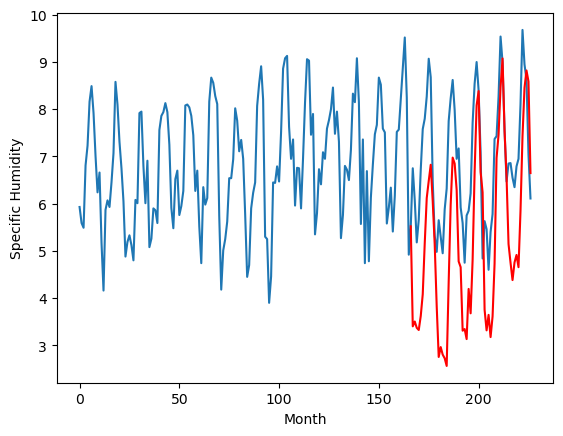

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.50		0.27		-0.23
0.14		0.72		0.58
-0.14		0.46		0.60
-0.06		0.40		0.46
0.43		1.44		1.01
0.93		1.64		0.71
3.16		4.10		0.94
7.27		7.37		0.10
11.25		10.14		-1.11
10.18		9.51		-0.67
6.81		6.62		-0.19
4.28		3.97		-0.31
2.12		1.65		-0.47
0.16		-0.09		-0.25
-0.93		-0.55		0.38
-0.78		-0.88		-0.10
0.00		0.50		0.50
1.38		1.42		0.04
2.95		3.40		0.45
7.85		7.89		0.04
10.06		9.30		-0.76
10.44		10.07		-0.37
7.84		7.22		-0.62
5.30		5.43		0.13
0.77		1.06		0.29
0.47		1.53		1.06
-1.01		-0.09		0.92
-0.42		0.50		0.92
0.42		1.58		1.16
1.07		2.19		1.12
4.46		5.89		1.43
6.80		7.52		0.72
9.96		10.62		0.66
10.10		10.28		0.18
6.43		7.22		0.79
3.80		3.72		-0.08
1.95		2.47		0.52
-0.02		0.94		0.96
0.55		1.71		1.16
-0.16		1.46		1.62
0.05		1.47		1.42
2.29		3.55		1.26
2.81		4.73		1.92
6.51		7.46		0.95
11.36		11.62		0.26
8.79		10.60		1.81
7.82		8.15		0.33
4.43		5.20		0.77
0.63		2.16		1.53
0.96		2.23		1.27
-0.34		1.32		1.66


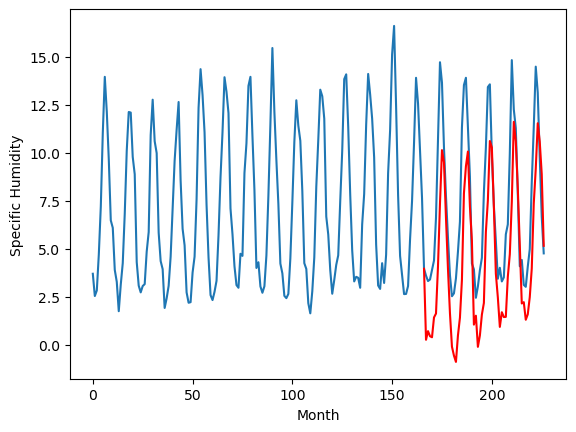

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.56		-2.42		0.14
-2.68		-1.96		0.72
-2.76		-2.23		0.53
-2.77		-2.28		0.49
-1.81		-1.18		0.63
-1.38		-1.01		0.37
1.15		1.54		0.39
4.72		4.94		0.22
8.07		7.85		-0.22
7.43		7.16		-0.27
4.14		4.14		-0.00
1.37		1.37		-0.00
-0.96		-1.00		-0.04
-2.81		-2.80		0.01
-3.50		-3.30		0.20
-3.64		-3.65		-0.01
-2.36		-2.16		0.20
-0.95		-1.19		-0.24
0.64		0.83		0.19
5.51		5.47		-0.04
7.20		6.91		-0.29
7.52		7.70		0.18
4.60		4.71		0.11
2.70		2.89		0.19
-2.22		-1.71		0.51
-2.32		-1.12		1.20
-3.83		-2.86		0.97
-3.13		-2.21		0.92
-2.19		-1.12		1.07
-1.55		-0.43		1.12
2.63		3.43		0.80
4.03		5.06		1.03
7.01		8.24		1.23
6.64		7.84		1.20
3.62		4.68		1.06
0.20		0.99		0.79
-1.02		-0.18		0.84
-2.94		-1.77		1.17
-2.16		-0.98		1.18
-2.91		-1.19		1.72
-2.78		-1.20		1.58
-0.35		0.92		1.27
0.12		2.09		1.97
3.81		4.95		1.14
7.79		9.24		1.45
6.55		8.15		1.60
4.86		5.63		0.77
1.59		2.55		0.96
-2.09		-0.56		1.53
-1.71		-0.49	

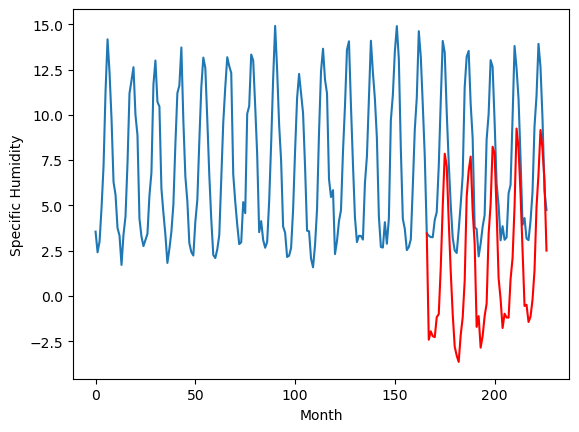

RangeIndex(start=1, stop=12, step=1)
[-3.310000000000001, -0.13999999999999968, 5.989999999999999, -0.8299999999999992, 3.6100000000000003, 0.2400000000000002, 6.16, 4.990000000000001, 4.529999999999999, 0.49999999999999956, -2.56]
[-3.2306018447875977, -0.5794589710235596, 5.5543252158164975, -0.5101008796691895, 1.6308141803741458, -0.06143738746643068, 4.410559830665588, 3.675203313827515, 3.401913576126099, 0.27337711334228487, -2.4170609092712403]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -3.31  -3.230602
1                 1   -0.14  -0.579459
2                 2    5.99   5.554325
3                 3   -0.83  -0.510101
4                 4    3.61   1.630814
5                 5    0.24  -0.061437
6                 6    6.16   4.410560
7                 7    4.99   3.675203
8                 8    4.53   3.401914
9                 9    0.50   0.273377
10               10   -2.56  -2.417061


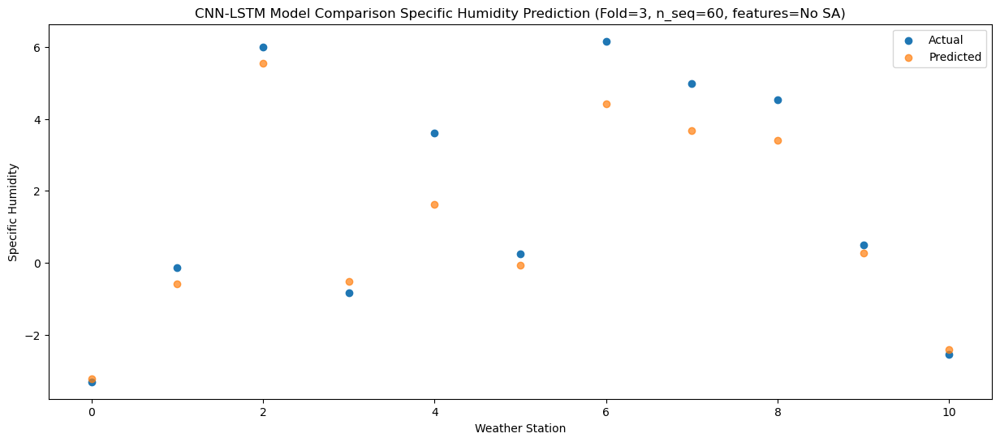

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.10  -2.750035
1                 1   -0.55  -0.604811
2                 2    6.53   5.616657
3                 3   -0.30  -0.141601
4                 4    2.11   1.759969
5                 5    0.53   0.175858
6                 6    5.79   4.452216
7                 7    5.98   3.673723
8                 8    5.76   3.504337
9                 9    0.14   0.722528
10               10   -2.68  -1.956730


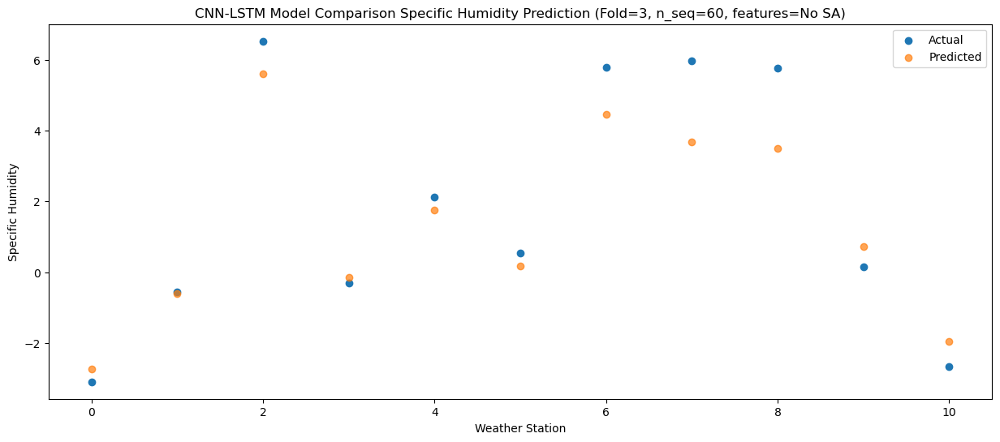

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.05  -3.020535
1                 1   -0.58  -0.532552
2                 2    6.15   5.496268
3                 3   -0.70  -0.336517
4                 4   -0.18   1.660905
5                 5    0.03   0.026699
6                 6    5.75   4.383243
7                 7    4.86   3.591136
8                 8    5.08   3.370181
9                 9   -0.14   0.456830
10               10   -2.76  -2.225732


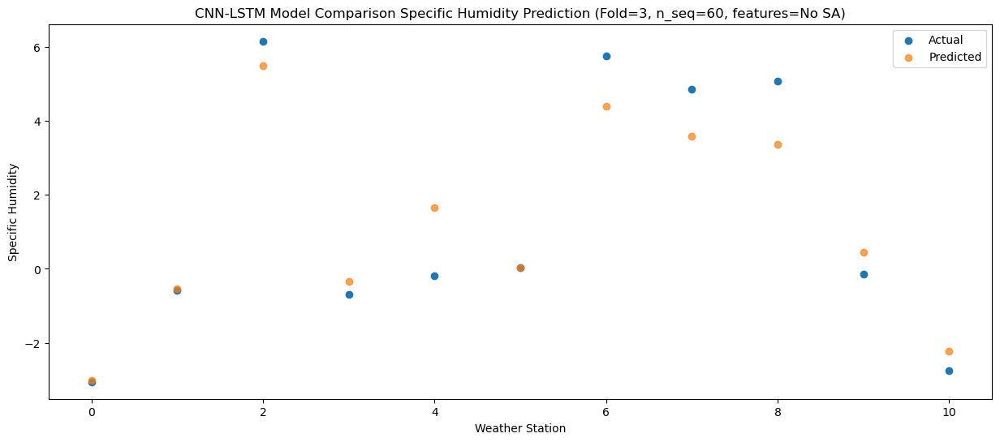

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -2.72  -2.906624
1                 1   -0.94  -0.840813
2                 2    5.46   5.413778
3                 3   -0.88  -0.410251
4                 4   -0.94   1.401938
5                 5   -0.22  -0.158570
6                 6    5.71   4.220196
7                 7    4.44   3.458321
8                 8    4.19   3.324743
9                 9   -0.06   0.404353
10               10   -2.77  -2.277929


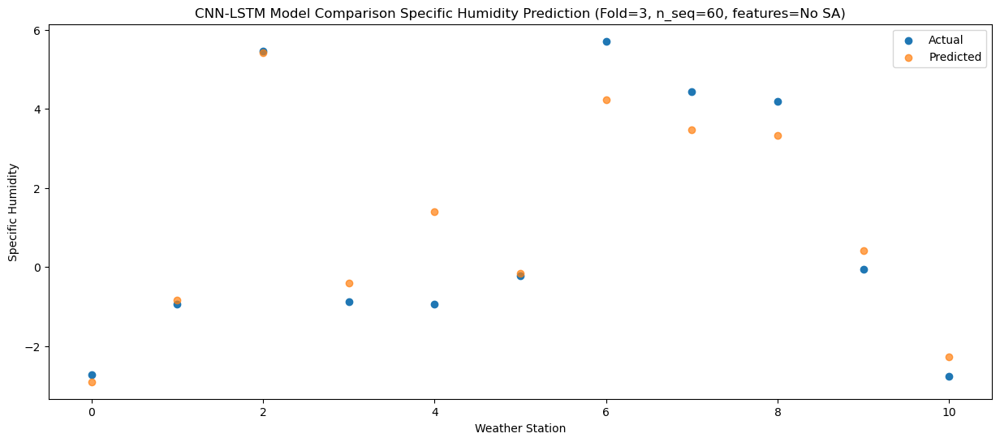

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -0.99  -1.221461
1                 1    1.66   1.436880
2                 2    6.54   5.710184
3                 3    0.98   1.094230
4                 4    1.13   3.108016
5                 5    1.77   1.414652
6                 6    6.34   5.031610
7                 7    6.18   3.905974
8                 8    4.67   3.620827
9                 9    0.43   1.435005
10               10   -1.81  -1.177103


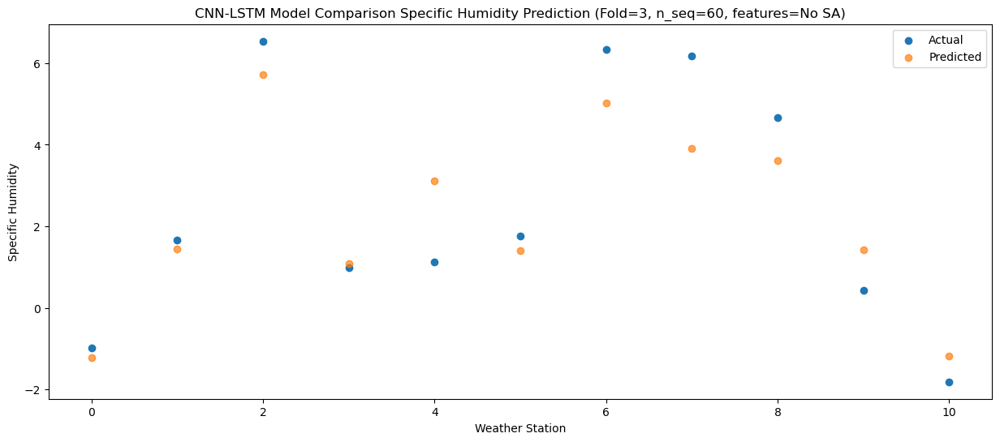

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -1.17  -1.310631
1                 1    1.81   1.486569
2                 2    7.91   6.195615
3                 3    0.90   1.165312
4                 4    1.45   3.292041
5                 5    1.89   1.567386
6                 6    6.69   5.435231
7                 7    5.99   4.384825
8                 8    5.73   4.082003
9                 9    0.93   1.639095
10               10   -1.38  -1.005327


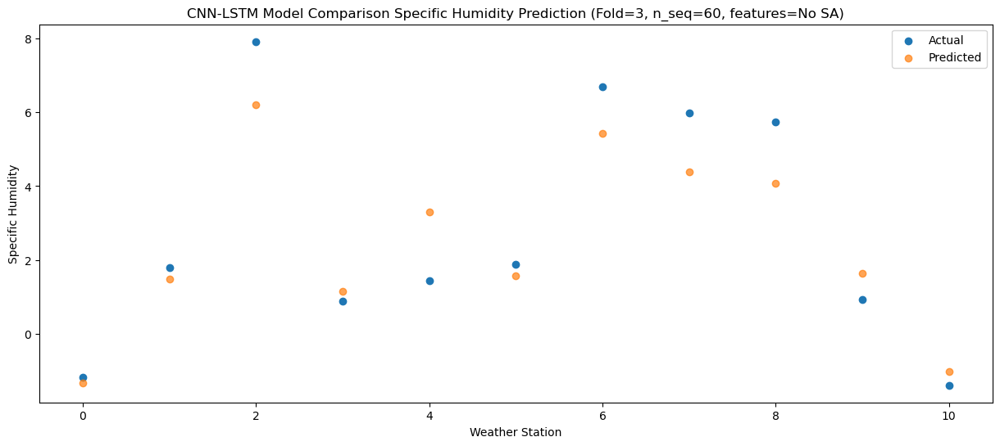

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    2.05   1.128665
1                 1    4.78   4.387626
2                 2    7.72   7.371332
3                 3    4.33   3.826513
4                 4    5.15   6.260979
5                 5    5.10   4.434911
6                 6    7.82   7.180151
7                 7    5.29   5.717843
8                 8    6.59   5.162414
9                 9    3.16   4.095808
10               10    1.15   1.538331


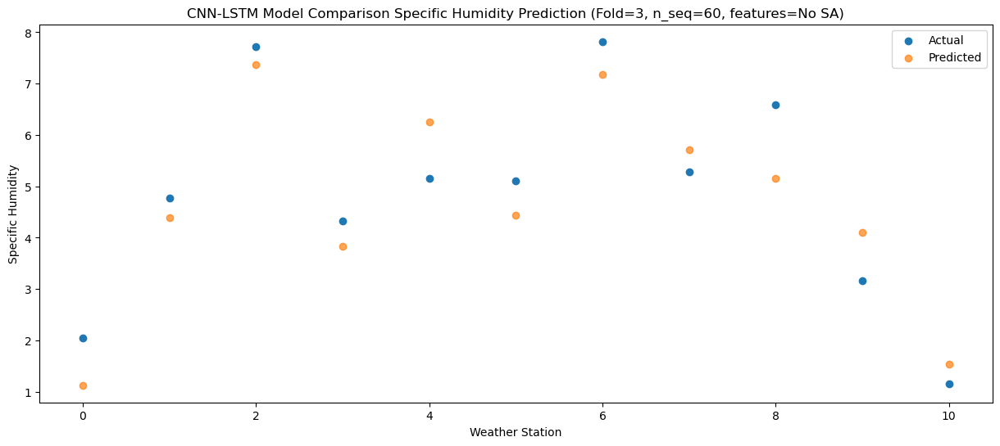

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    5.59   4.541312
1                 1    8.31   7.471705
2                 2    9.26   8.360554
3                 3    7.57   7.246512
4                 4    8.24   9.648408
5                 5    7.83   7.880566
6                 6    8.88   8.824366
7                 7    5.62   6.782588
8                 8    6.81   6.119499
9                 9    7.27   7.370140
10               10    4.72   4.944791


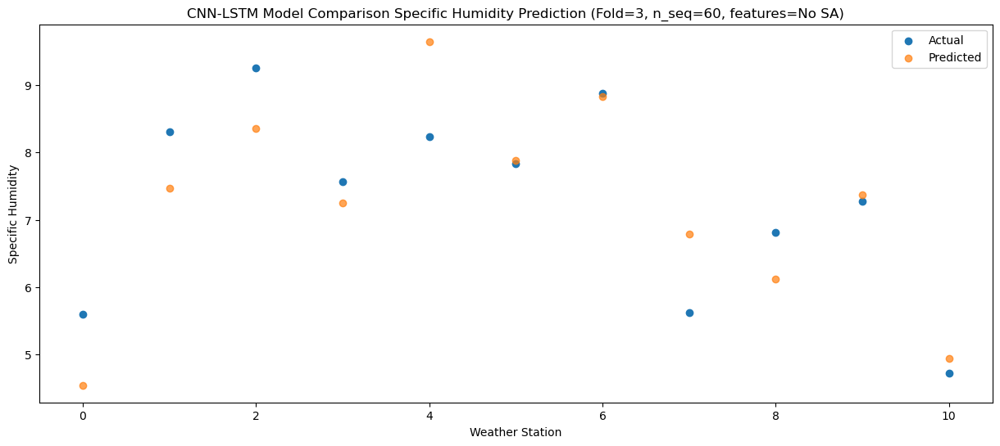

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    8.28   7.130058
1                 1   11.05  10.493358
2                 2    9.48   8.824558
3                 3   10.67  10.150770
4                 4   12.19  12.760221
5                 5   10.99  10.937334
6                 6   10.40  10.112693
7                 7    6.10   7.430586
8                 8    7.28   6.481077
9                 9   11.25  10.144854
10               10    8.07   7.851632


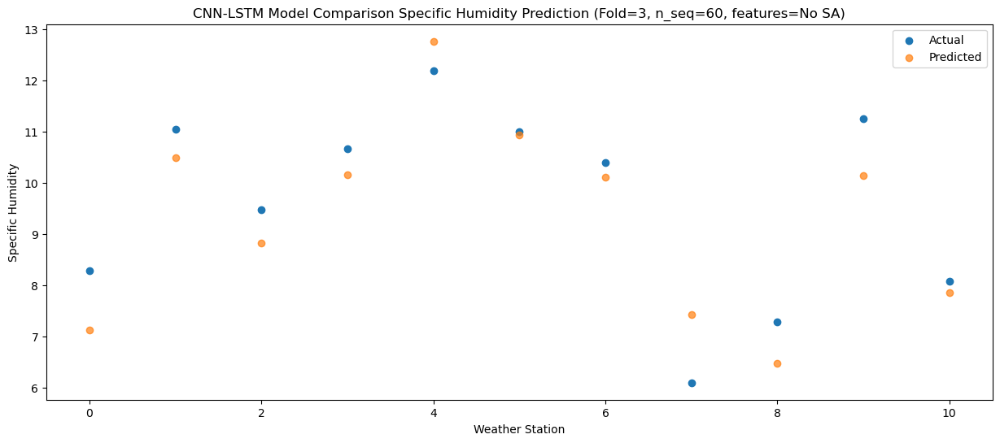

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    8.57   6.831972
1                 1    8.38   8.763957
2                 2   11.00   9.000577
3                 3    9.59   9.314344
4                 4    9.81  11.230149
5                 5    9.77   9.683975
6                 6    9.19   9.679936
7                 7    6.97   7.353589
8                 8    8.08   6.824257
9                 9   10.18   9.510197
10               10    7.43   7.157086


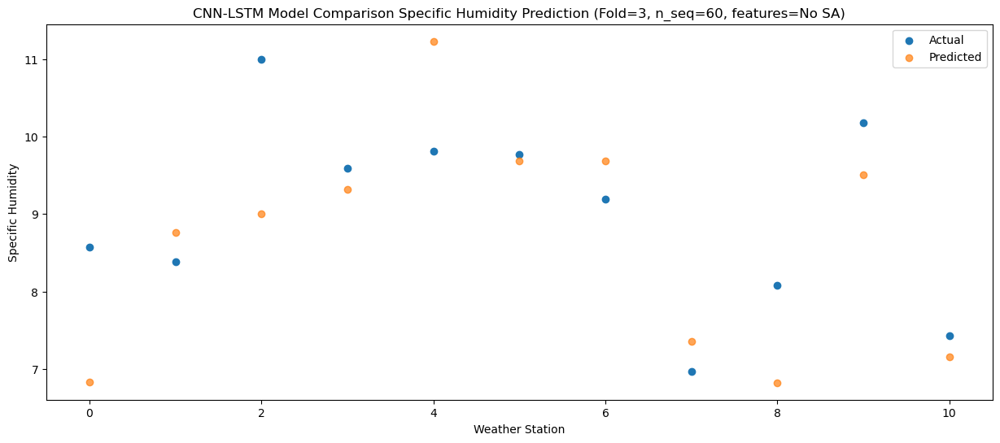

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    4.83   4.121569
1                 1    6.94   6.066849
2                 2   10.52   8.116753
3                 3    7.02   6.340452
4                 4    6.85   8.106075
5                 5    6.59   6.558370
6                 6    8.05   8.153205
7                 7    5.71   6.341941
8                 8    7.69   6.051417
9                 9    6.81   6.619053
10               10    4.14   4.137638


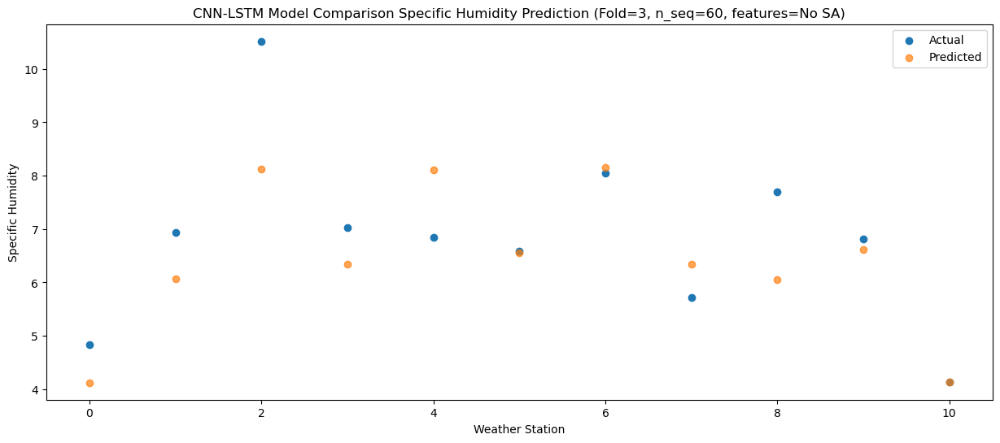

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    2.25   1.380772
1                 1    2.37   2.163618
2                 2    8.64   7.069202
3                 3    3.33   3.290166
4                 4    2.13   4.492622
5                 5    3.17   3.179426
6                 6    6.40   6.244631
7                 7    4.70   5.021495
8                 8    5.49   5.132954
9                 9    4.28   3.965176
10               10    1.37   1.369255


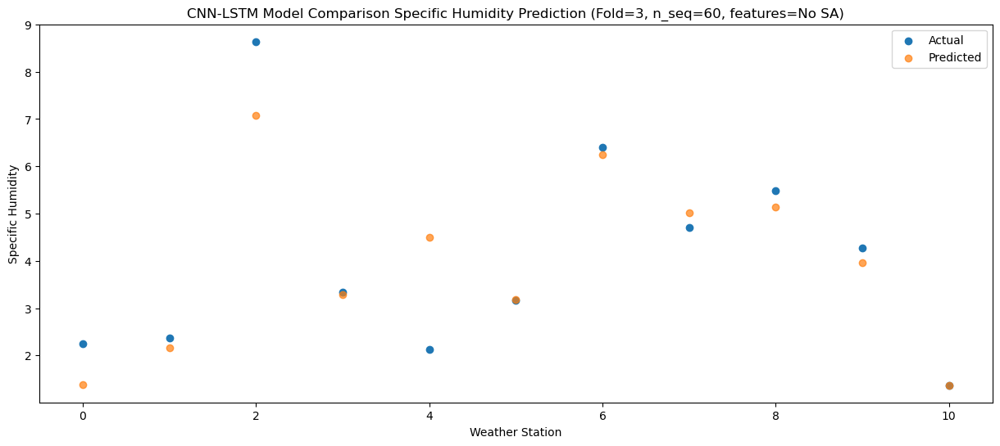

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -0.49  -1.565069
1                 1    0.87   0.331332
2                 2    5.95   5.908684
3                 3    0.44   0.894751
4                 4    1.03   2.671102
5                 5    1.40   1.138557
6                 6    6.34   4.985869
7                 7    4.68   3.979051
8                 8    4.33   3.824817
9                 9    2.12   1.653947
10               10   -0.96  -1.002785


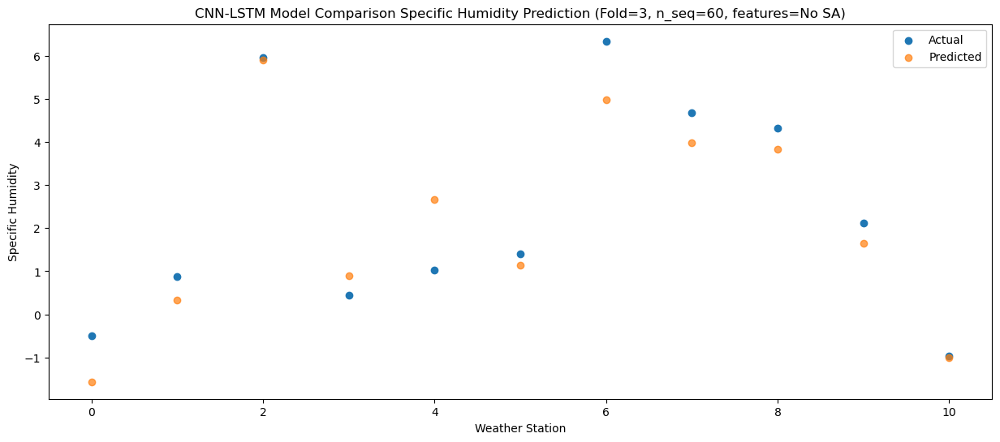

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -3.71  -4.065472
1                 1   -1.17  -1.527812
2                 2    5.35   4.953758
3                 3   -1.17  -1.105442
4                 4   -0.90   1.004836
5                 5   -0.26  -0.636992
6                 6    5.53   3.856595
7                 7    3.85   3.068842
8                 8    3.99   2.753898
9                 9    0.16  -0.086389
10               10   -2.81  -2.797401


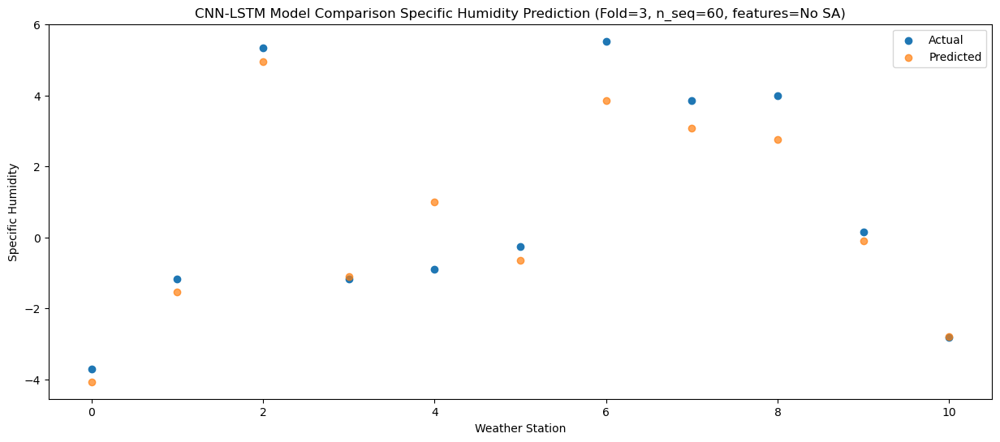

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -3.84  -4.372605
1                 1   -1.26  -1.750973
2                 2    5.79   5.139515
3                 3   -1.44  -1.507052
4                 4   -1.10   0.639499
5                 5   -0.57  -1.034223
6                 6    5.70   3.912808
7                 7    4.66   3.237857
8                 8    4.66   2.963063
9                 9   -0.93  -0.549655
10               10   -3.50  -3.296670


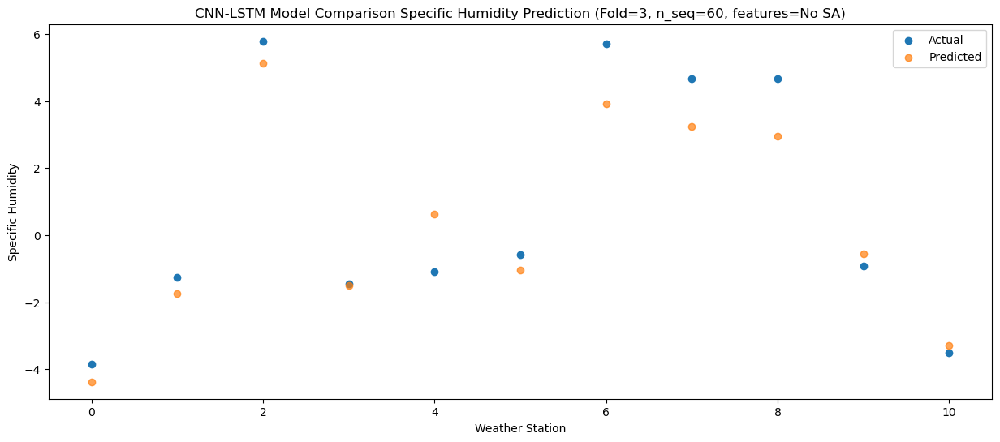

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.75  -4.410093
1                 1   -1.82  -2.520491
2                 2    5.73   4.874428
3                 3   -1.51  -1.887650
4                 4   -1.93  -0.118458
5                 5   -1.09  -1.649424
6                 6    5.76   3.441272
7                 7    4.18   2.844940
8                 8    4.31   2.803568
9                 9   -0.78  -0.879675
10               10   -3.64  -3.645582


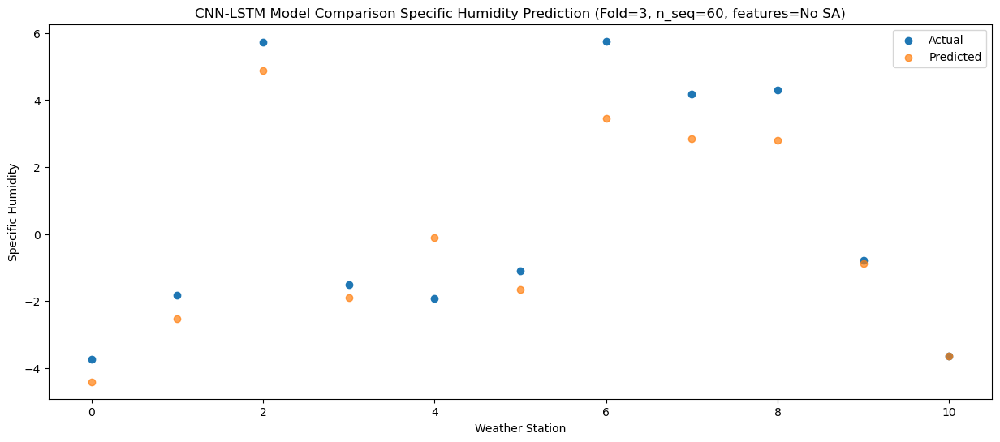

Predictions for (t+16):
    Weather_Station        Actual  Predicted
0                 0 -2.100000e+00  -2.692370
1                 1  6.900000e-01  -0.003496
2                 2  5.810000e+00   4.882568
3                 3 -2.100000e-01  -0.071606
4                 4  5.500000e-01   2.096044
5                 5  9.400000e-01   0.391825
6                 6  6.070000e+00   4.192516
7                 7  4.480000e+00   3.072724
8                 8  3.960000e+00   2.724996
9                 9  2.220446e-16   0.495221
10               10 -2.360000e+00  -2.162908


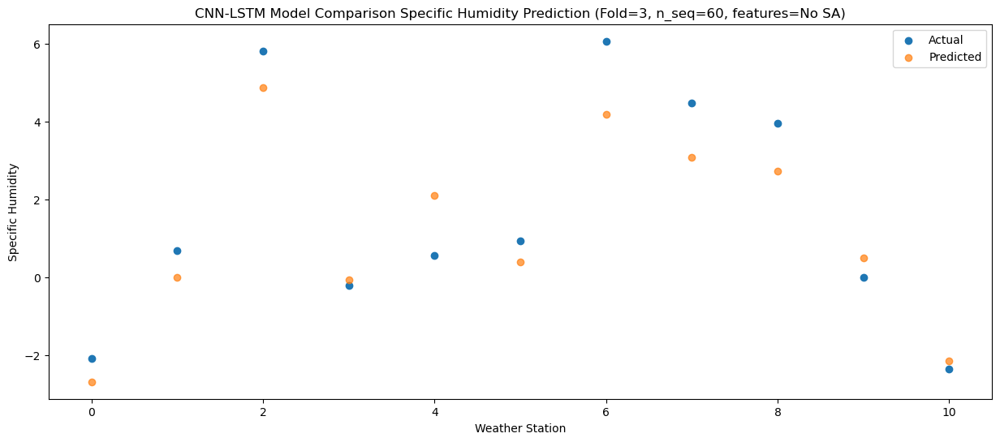

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   -1.58  -1.973806
1                 1    1.86   0.975838
2                 2    6.43   4.770109
3                 3    0.98   0.855403
4                 4    1.61   3.142701
5                 5    2.24   1.406659
6                 6    6.54   4.436478
7                 7    4.17   3.035751
8                 8    4.89   2.563891
9                 9    1.38   1.421177
10               10   -0.95  -1.191615


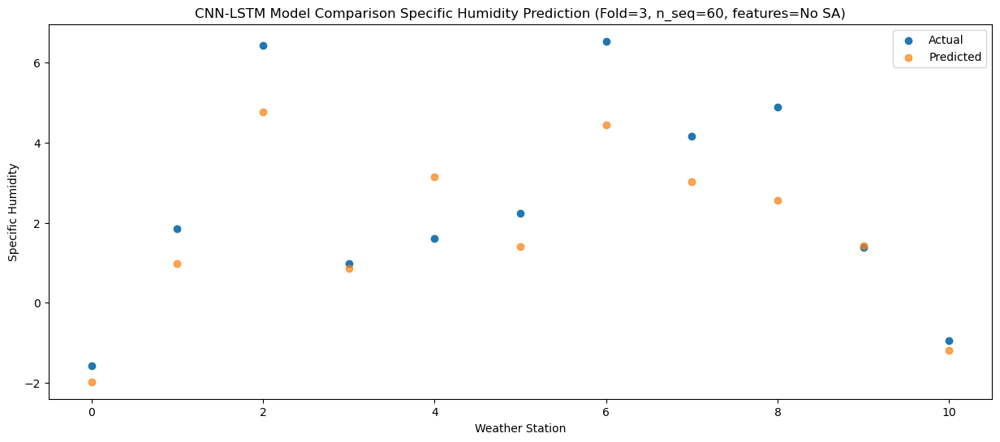

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    1.20   0.452790
1                 1    5.38   4.102599
2                 2    6.83   6.571547
3                 3    3.51   3.208314
4                 4    4.03   5.766282
5                 5    4.48   3.872539
6                 6    7.94   6.592855
7                 7    4.73   4.989129
8                 8    5.33   4.342439
9                 9    2.95   3.397397
10               10    0.64   0.826435


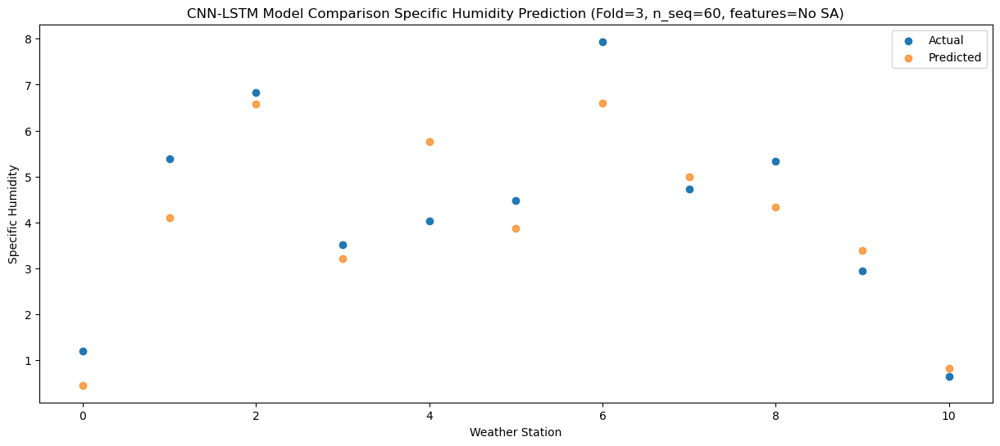

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    5.92   4.973265
1                 1    9.91   8.163045
2                 2    9.28   8.231762
3                 3    8.93   7.781378
4                 4    8.49  10.200348
5                 5    9.70   8.412541
6                 6    9.27   9.005455
7                 7    6.15   6.714579
8                 8    6.76   5.977528
9                 9    7.85   7.891273
10               10    5.51   5.470918


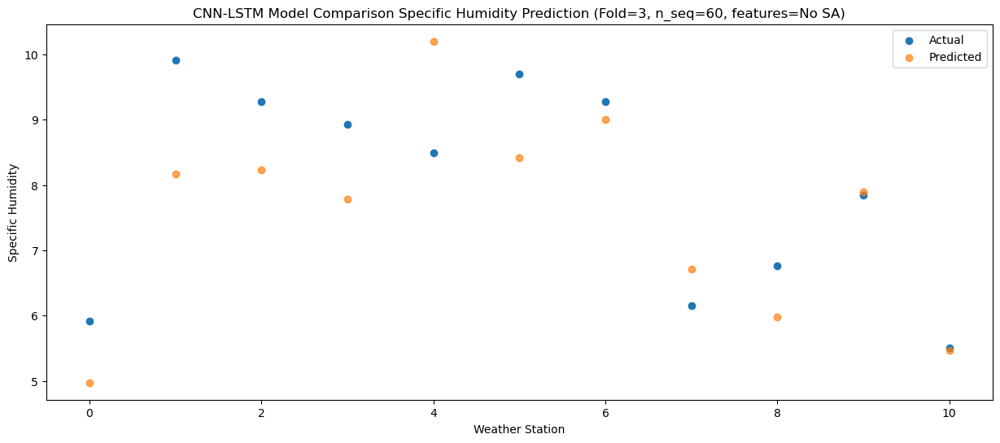

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    7.16   6.189477
1                 1   10.79   9.397742
2                 2    9.98   9.280480
3                 3    9.56   9.148670
4                 4   10.44  11.630886
5                 5   10.95   9.843106
6                 6   11.72  10.180826
7                 7   11.51   7.798128
8                 8    7.24   6.976389
9                 9   10.06   9.304594
10               10    7.20   6.911643


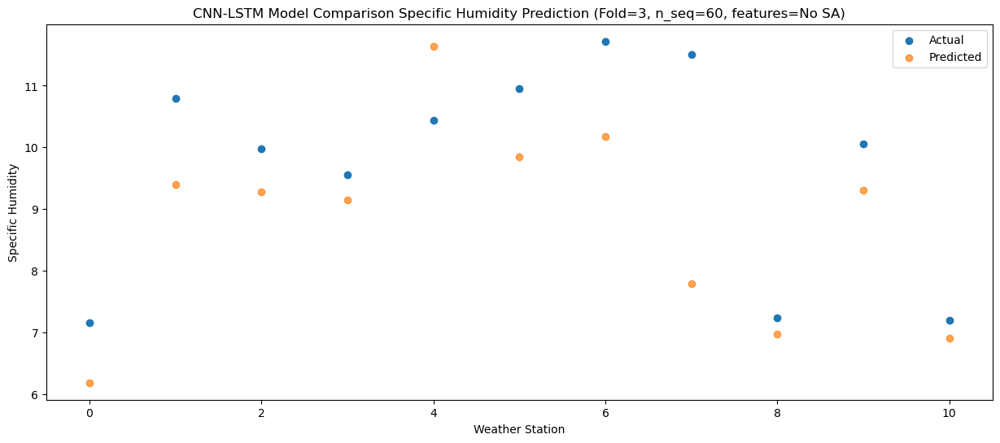

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    7.43   6.831151
1                 1   10.96   9.521922
2                 2    9.51   9.119573
3                 3   10.44   9.770147
4                 4   10.53  12.019408
5                 5   11.12  10.351627
6                 6   10.29  10.102332
7                 7    9.08   7.572794
8                 8    7.63   6.848847
9                 9   10.44  10.071070
10               10    7.52   7.695859


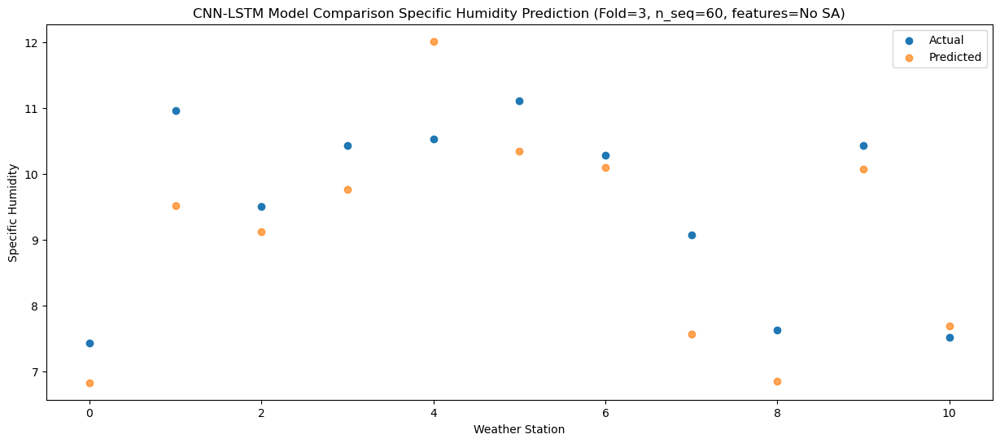

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    3.81   4.055817
1                 1    6.99   6.138502
2                 2    8.22   8.453622
3                 3    6.97   6.693883
4                 4    6.76   8.617107
5                 5    7.82   7.059251
6                 6    8.59   8.577270
7                 7    7.36   6.698269
8                 8    6.99   6.289180
9                 9    7.84   7.217281
10               10    4.60   4.710495


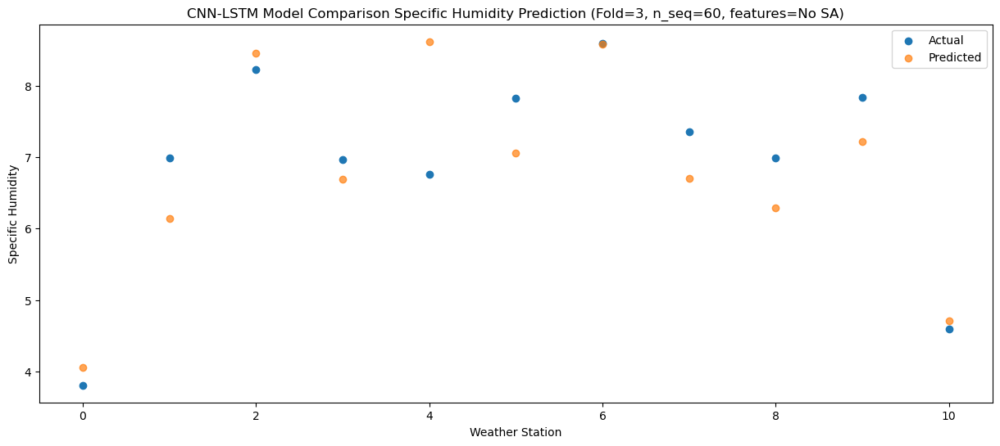

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    1.77   2.014166
1                 1    4.80   3.926136
2                 2    7.08   6.955556
3                 3    4.91   4.740095
4                 4    4.81   6.618830
5                 5    6.20   5.099152
6                 6    7.50   6.917585
7                 7    6.26   5.164019
8                 8    5.96   4.777117
9                 9    5.30   5.426609
10               10    2.70   2.894563


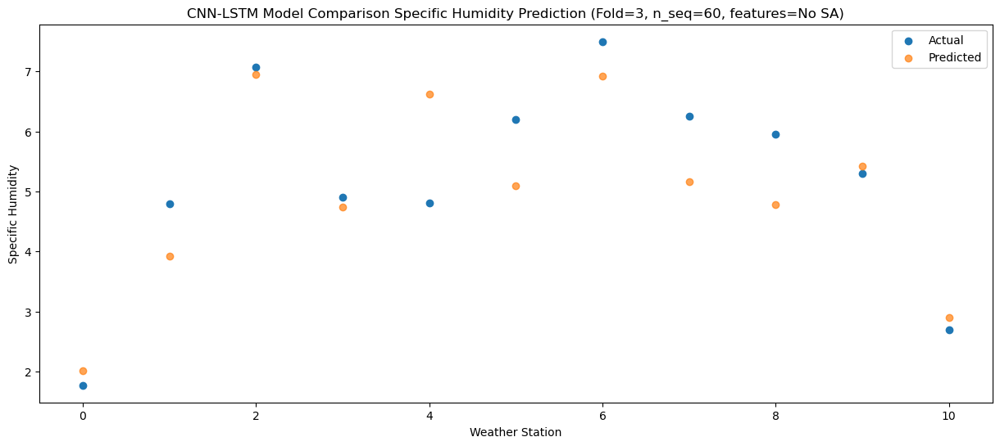

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -3.73  -2.954168
1                 1    0.37  -0.302630
2                 2    7.66   6.847645
3                 3   -0.78  -0.002786
4                 4   -0.31   2.135275
5                 5    0.33   0.467081
6                 6    6.79   5.593945
7                 7    4.99   4.945219
8                 8    6.18   4.655654
9                 9    0.77   1.062142
10               10   -2.22  -1.709522


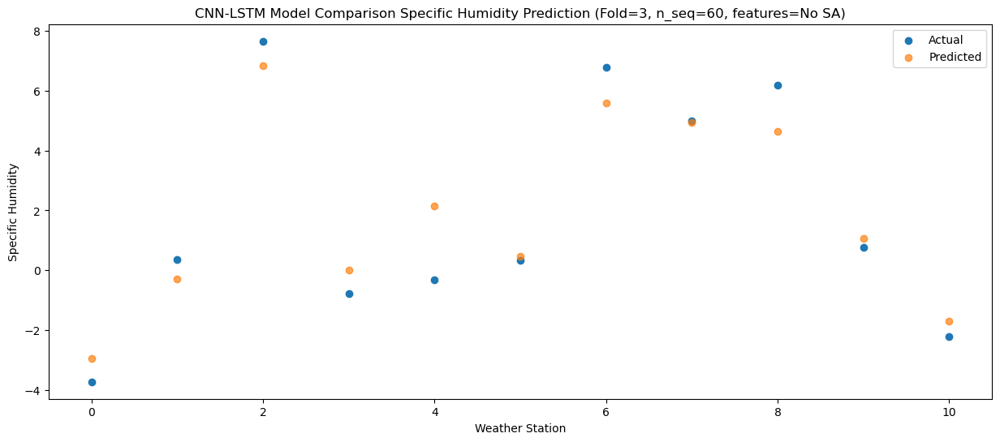

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -1.392451
1                 1    1.34   0.569973
2                 2    6.16   5.377052
3                 3    0.36   0.939909
4                 4    0.39   2.667084
5                 5    1.38   1.131116
6                 6    6.08   4.694682
7                 7    5.13   3.480902
8                 8    4.93   3.310101
9                 9    0.47   1.525834
10               10   -2.32  -1.116432


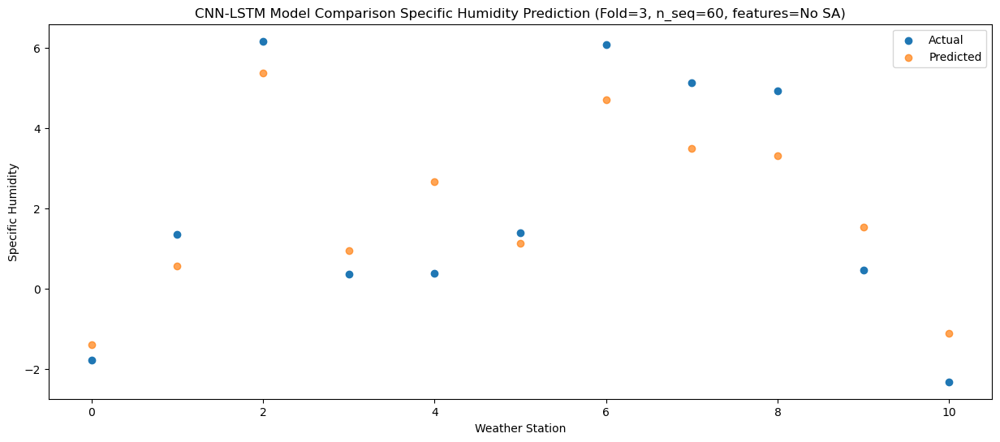

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.57  -4.159619
1                 1   -1.85  -1.950972
2                 2    5.88   5.514387
3                 3   -1.96  -1.254721
4                 4   -2.07   0.660604
5                 5   -1.13  -0.902869
6                 6    5.60   4.190672
7                 7    4.14   3.552660
8                 8    4.60   3.344440
9                 9   -1.01  -0.094099
10               10   -3.83  -2.858017


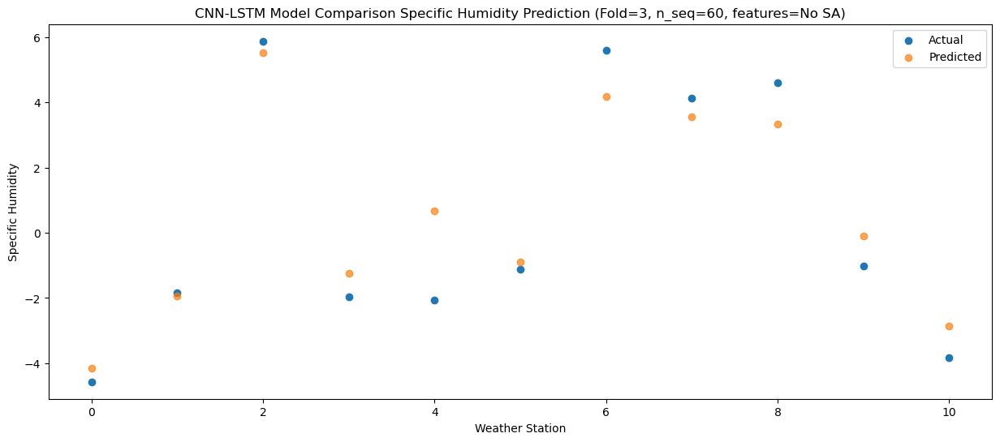

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -3.21  -3.234914
1                 1   -1.48  -1.565030
2                 2    5.10   5.245346
3                 3   -1.44  -0.576709
4                 4   -1.45   1.093266
5                 5   -0.60  -0.369822
6                 6    5.39   4.094426
7                 7    3.71   3.250402
8                 8    3.76   3.132401
9                 9   -0.42   0.496691
10               10   -3.13  -2.214918


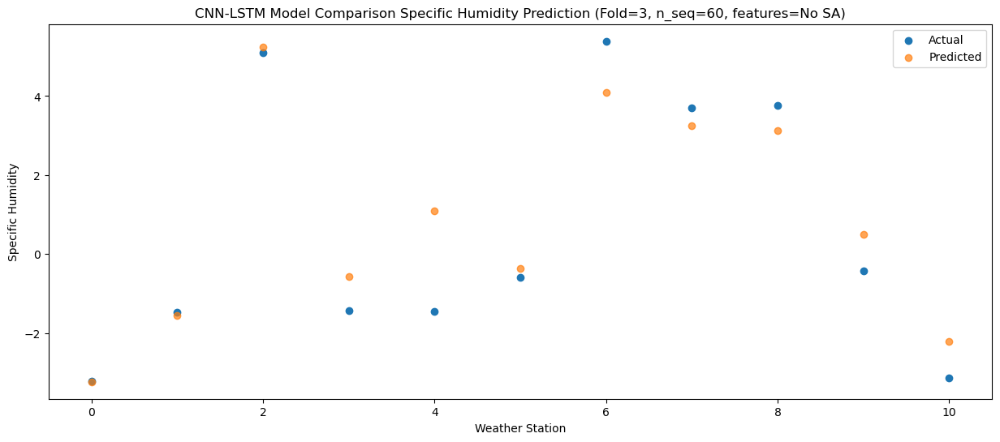

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.31  -2.070337
1                 1   -0.01  -0.221663
2                 2    6.44   6.323039
3                 3   -0.46   0.600357
4                 4    0.12   2.388853
5                 5    0.71   0.874895
6                 6    6.07   5.257930
7                 7    4.33   4.369848
8                 8    4.76   4.194644
9                 9    0.42   1.583515
10               10   -2.19  -1.117564


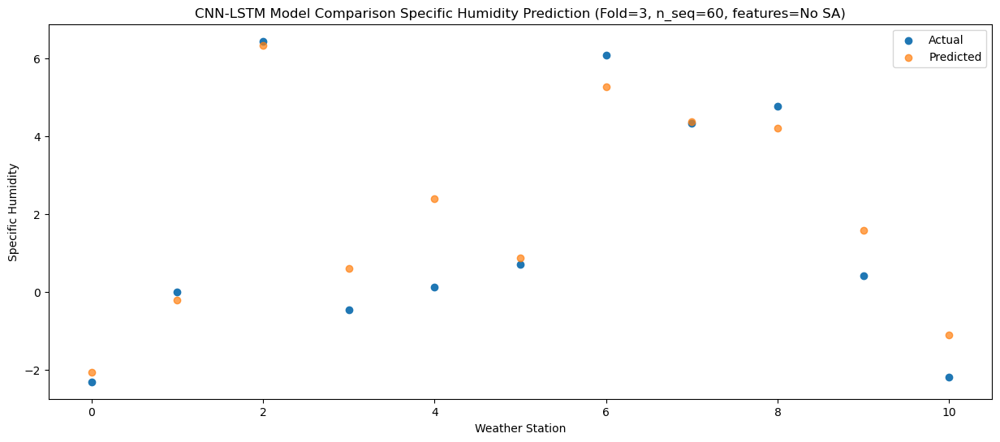

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   -1.28  -1.005927
1                 1    2.29   1.711505
2                 2    6.11   5.847637
3                 3    0.81   1.677595
4                 4    1.68   3.775841
5                 5    2.24   2.097494
6                 6    6.57   5.451556
7                 7    4.33   4.093318
8                 8    4.86   3.678057
9                 9    1.07   2.188408
10               10   -1.55  -0.426585


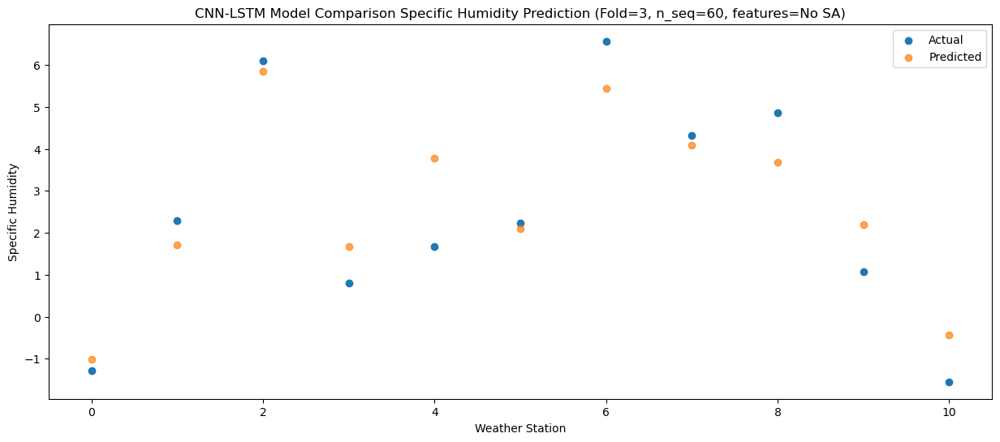

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    3.03   2.964868
1                 1    6.74   5.796922
2                 2    6.29   7.039904
3                 3    5.23   5.672530
4                 4    5.77   7.871357
5                 5    6.47   6.166066
6                 6    7.38   7.535353
7                 7    4.59   5.458185
8                 8    5.23   4.811221
9                 9    4.46   5.885313
10               10    2.63   3.425549


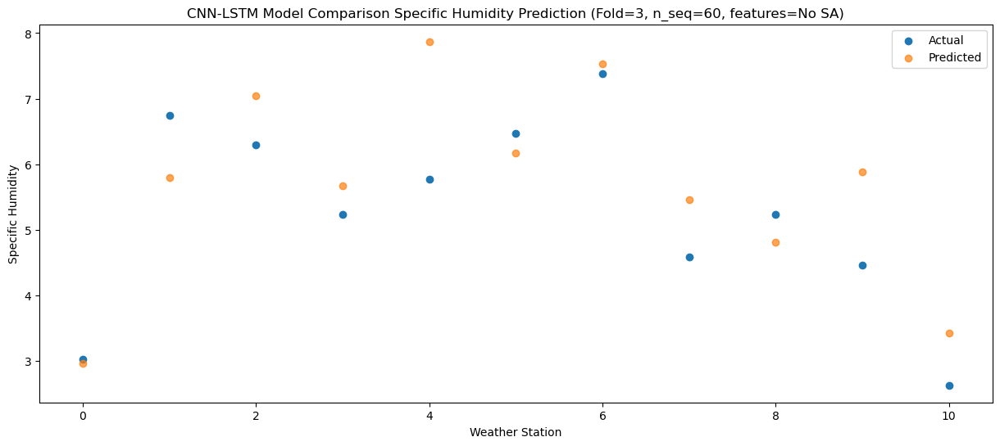

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    4.33   4.727652
1                 1    9.36   7.832528
2                 2    7.46   8.923644
3                 3    7.49   7.438119
4                 4    7.87   9.832636
5                 5    8.54   8.042848
6                 6    9.32   9.482759
7                 7    6.35   7.396600
8                 8    6.72   6.669788
9                 9    6.80   7.519480
10               10    4.03   5.060938


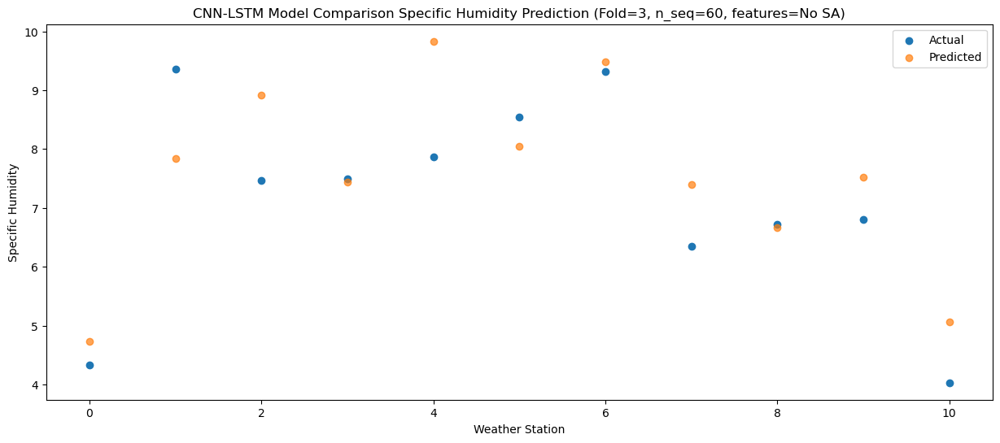

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    8.40   7.663114
1                 1    9.57   9.863276
2                 2    8.63  10.344936
3                 3   10.53  10.374231
4                 4   10.46  12.485853
5                 5   11.32  10.876389
6                 6   12.31  11.163820
7                 7    9.78   8.765673
8                 8    7.55   8.083124
9                 9    9.96  10.618278
10               10    7.01   8.236108


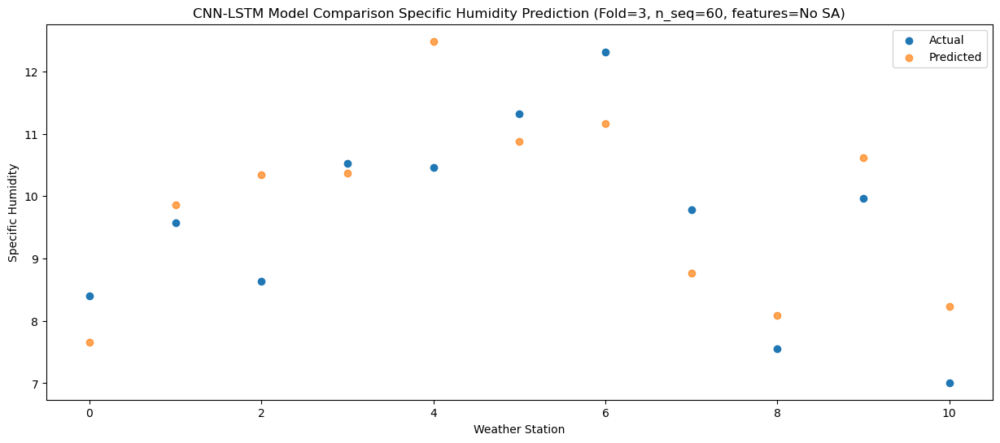

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    6.59   7.046981
1                 1   10.18   9.539755
2                 2    9.42  10.650030
3                 3    9.40   9.885605
4                 4    9.96  12.054479
5                 5   10.12  10.406778
6                 6   12.15  11.282127
7                 7   12.85   9.054061
8                 8    8.01   8.384816
9                 9   10.10  10.281594
10               10    6.64   7.838355


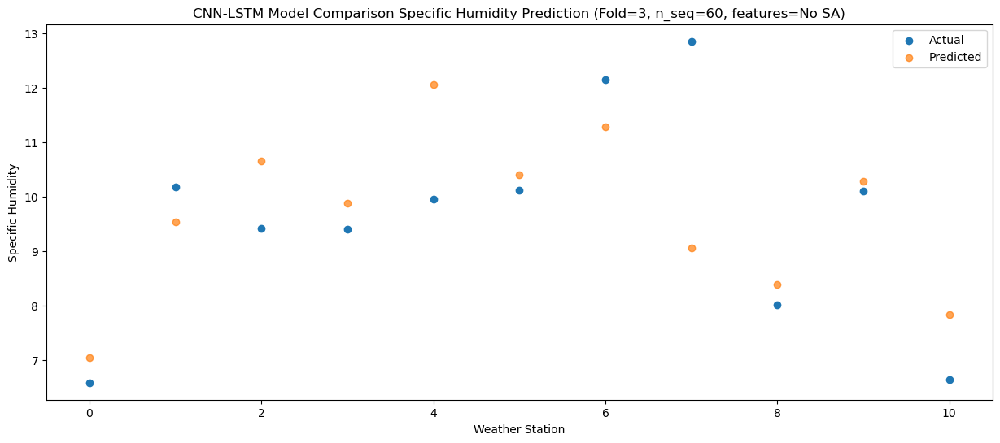

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    3.17   3.871169
1                 1    6.33   5.918010
2                 2    9.13   8.864913
3                 3    6.15   6.576088
4                 4    6.86   8.520074
5                 5    7.35   6.958192
6                 6    9.20   8.932343
7                 7    8.94   7.117004
8                 8    7.41   6.672051
9                 9    6.43   7.218307
10               10    3.62   4.680732


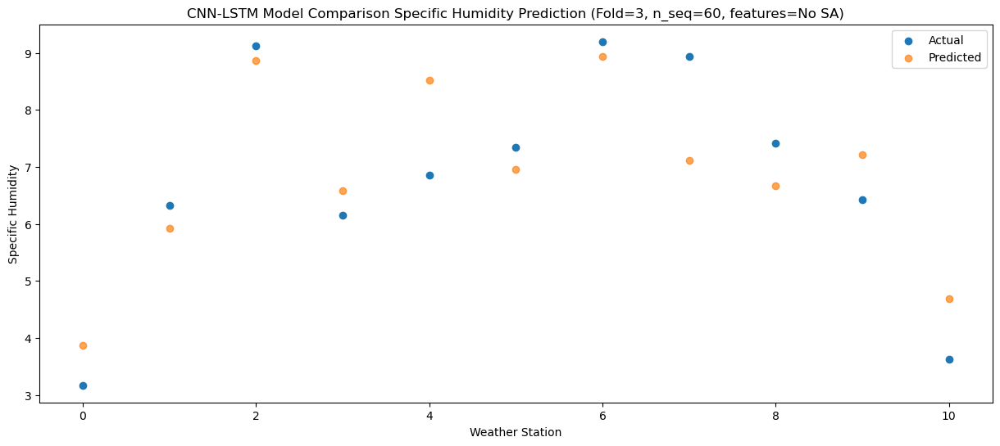

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.06  -0.169164
1                 1    1.87   1.777758
2                 2    7.96   8.383428
3                 3    1.00   2.589804
4                 4    1.86   4.385430
5                 5    2.05   2.863712
6                 6    7.59   7.363630
7                 7    6.21   6.442783
8                 8    6.10   6.240118
9                 9    3.80   3.715214
10               10    0.20   0.987810


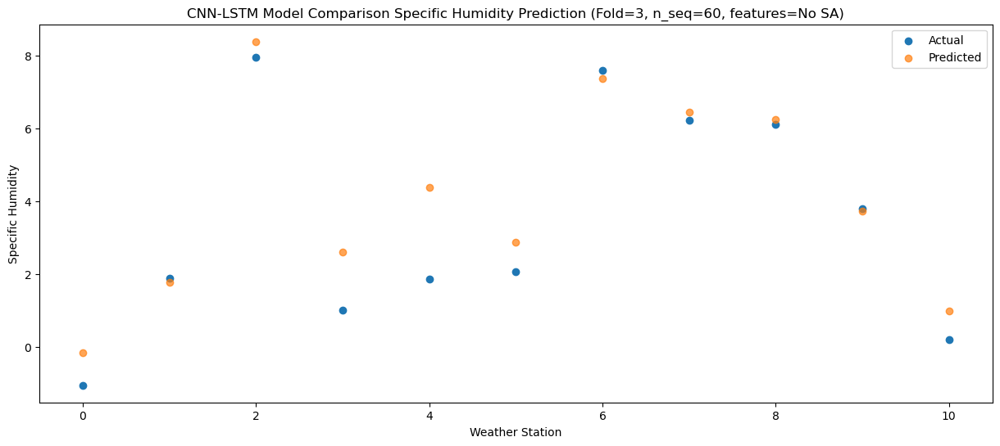

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.51  -1.014827
1                 1    0.84   0.634646
2                 2    5.24   5.853874
3                 3    0.19   1.531580
4                 4    0.47   3.170266
5                 5    0.83   1.707610
6                 6    5.93   5.187799
7                 7    4.44   3.926542
8                 8    3.85   3.753893
9                 9    1.95   2.474676
10               10   -1.02  -0.176947


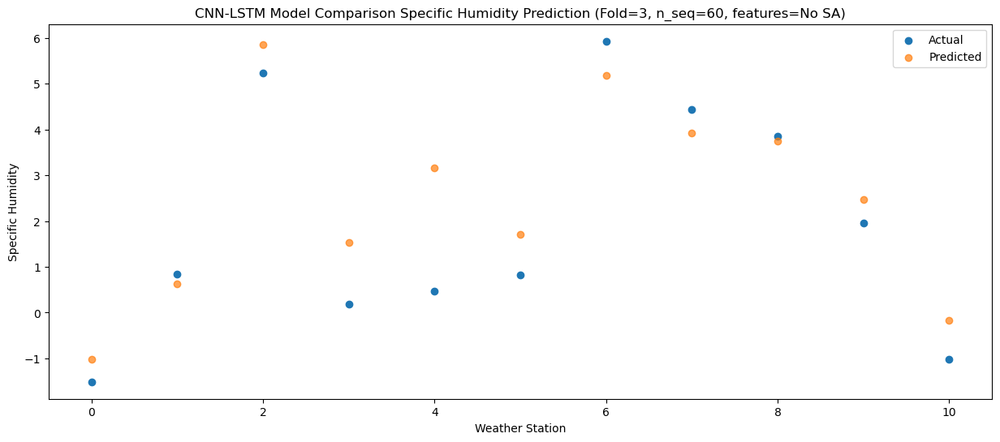

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.71  -2.744017
1                 1   -0.35  -0.525074
2                 2    6.08   5.456931
3                 3   -0.84  -0.020191
4                 4   -0.65   1.847786
5                 5    0.07   0.277408
6                 6    5.96   4.579892
7                 7    5.19   3.557237
8                 8    4.64   3.317186
9                 9   -0.02   0.943501
10               10   -2.94  -1.771840


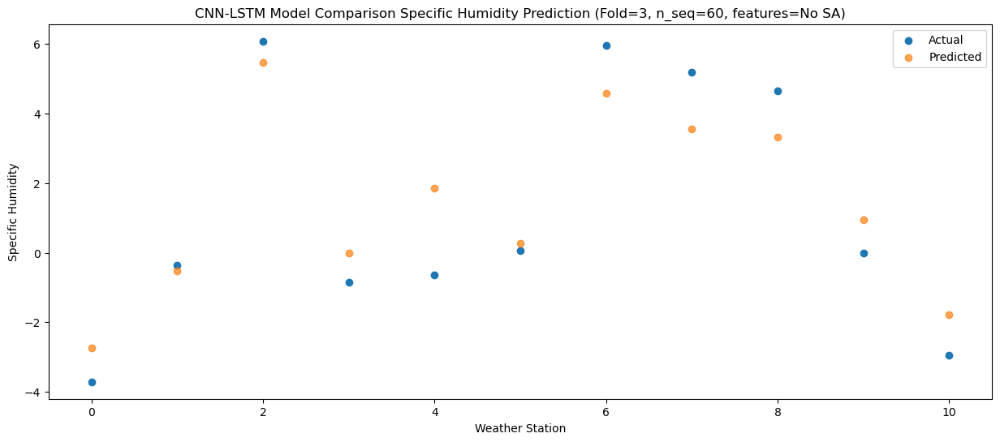

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -2.80  -2.166986
1                 1   -0.43  -0.211820
2                 2    6.23   5.801497
3                 3   -0.30   0.630878
4                 4   -0.27   2.435289
5                 5    0.65   0.918368
6                 6    5.93   4.961428
7                 7    5.58   3.893120
8                 8    4.47   3.645184
9                 9    0.55   1.707117
10               10   -2.16  -0.984398


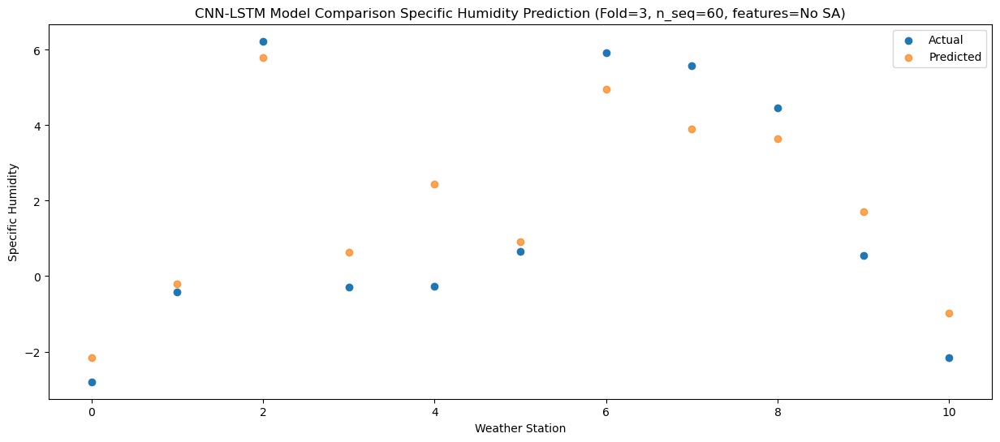

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -2.07  -1.736234
1                 1   -0.27  -0.167612
2                 2    5.10   5.258788
3                 3   -0.48   0.650657
4                 4    0.61   2.250293
5                 5    0.32   0.789723
6                 6    5.55   4.530713
7                 7    4.33   3.343084
8                 8    3.61   3.174779
9                 9   -0.16   1.456659
10               10   -2.91  -1.191569


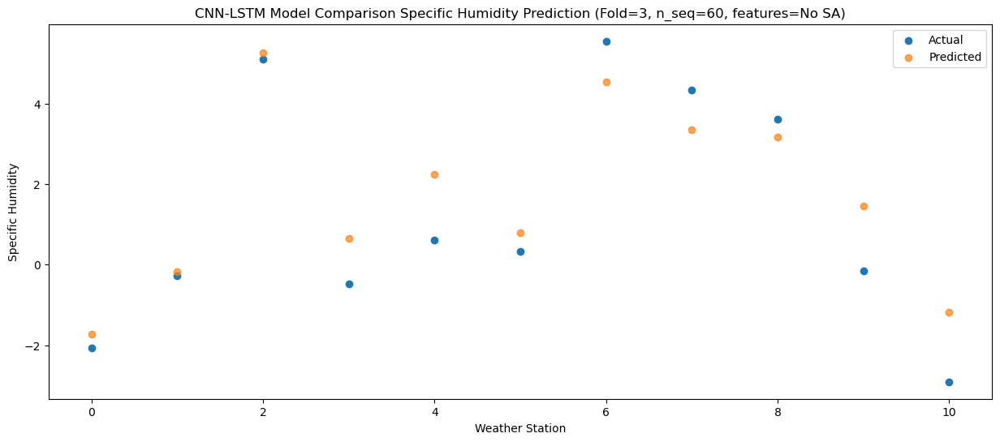

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.46  -1.716638
1                 1    0.67   0.543154
2                 2    6.62   5.742606
3                 3   -0.61   0.782643
4                 4    0.28   2.661260
5                 5    0.75   1.062381
6                 6    5.85   5.073957
7                 7    5.37   3.913542
8                 8    4.41   3.612529
9                 9    0.05   1.465218
10               10   -2.78  -1.200532


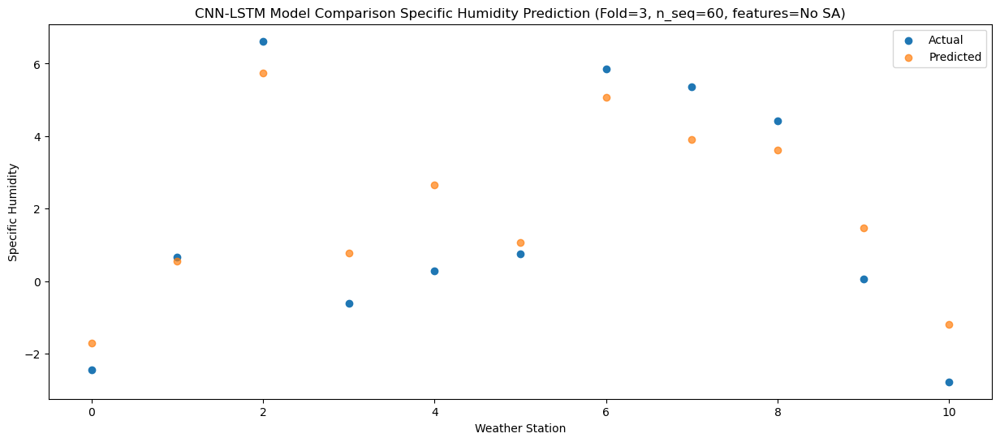

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   -0.47   0.179584
1                 1    1.54   1.943991
2                 2    6.82   6.841452
3                 3    0.93   2.717194
4                 4    1.51   4.391380
5                 5    2.06   2.910162
6                 6    6.48   6.286302
7                 7    4.52   4.962875
8                 8    4.79   4.727155
9                 9    2.29   3.553326
10               10   -0.35   0.922036


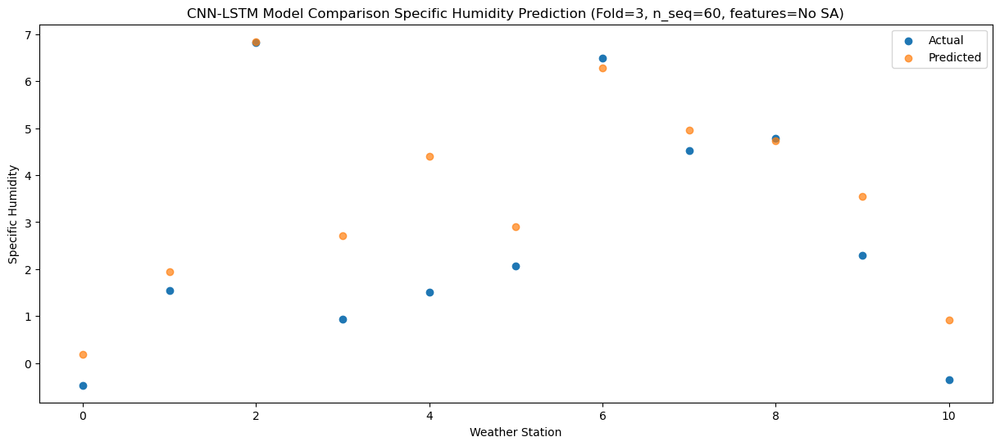

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    0.98   1.705626
1                 1    5.95   5.202722
2                 2    7.76   9.203014
3                 3    3.84   4.415977
4                 4    4.69   6.862737
5                 5    4.66   5.003607
6                 6    8.64   8.891478
7                 7    6.06   7.588796
8                 8    6.38   6.968288
9                 9    2.81   4.725707
10               10    0.12   2.087354


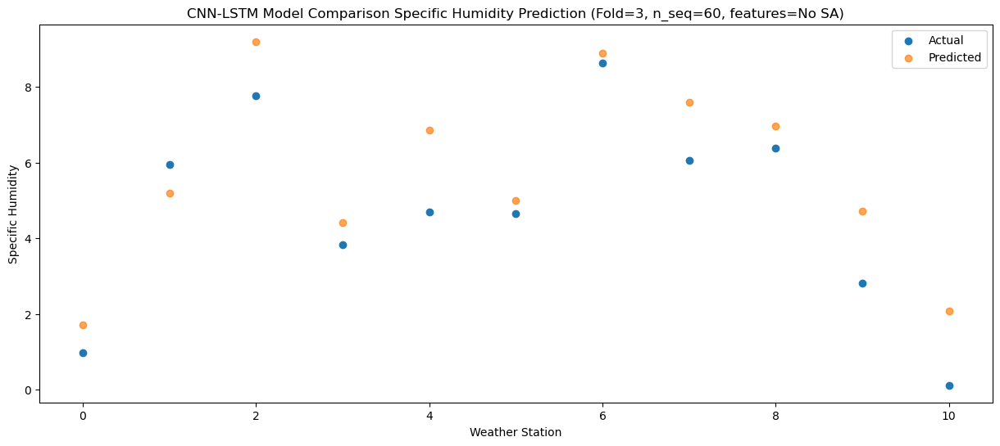

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    4.25   4.594347
1                 1    8.59   7.989092
2                 2    8.53   9.724662
3                 3    5.86   7.300227
4                 4    6.82   9.737899
5                 5    6.82   7.899929
6                 6    8.87  10.096750
7                 7    6.56   8.209399
8                 8    6.44   7.460638
9                 9    6.51   7.461989
10               10    3.81   4.945178


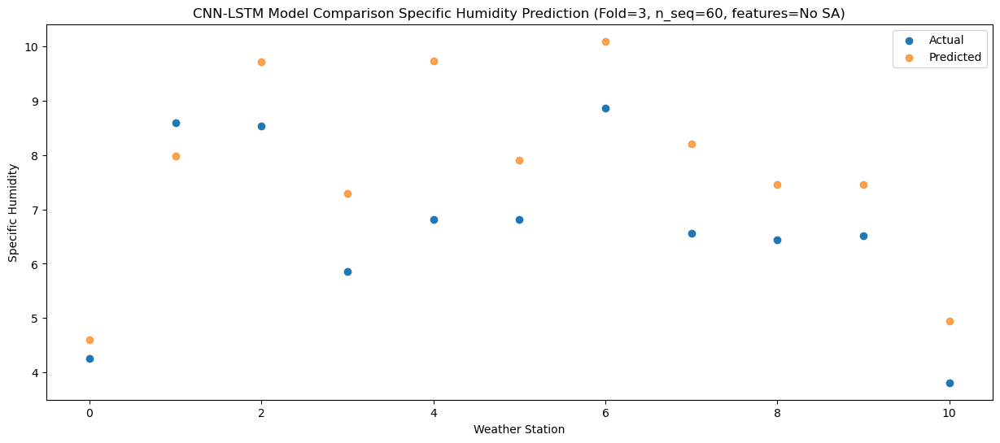

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    8.20   8.352326
1                 1   10.86  10.666581
2                 2    9.63  10.741127
3                 3    9.51  11.200978
4                 4   10.59  13.244578
5                 5   11.33  11.660256
6                 6    9.71  11.681244
7                 7    7.53   9.181494
8                 8    7.28   8.466434
9                 9   11.36  11.618022
10               10    7.79   9.243128


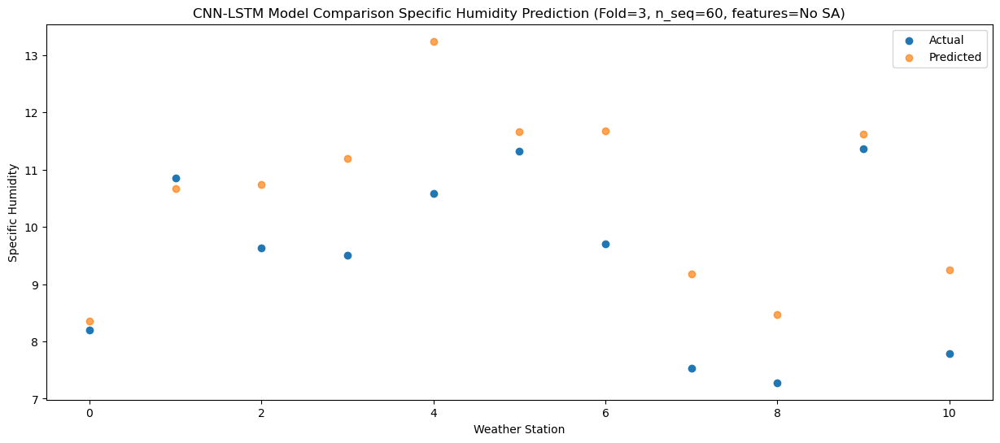

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    7.30   7.582116
1                 1   11.10   9.895487
2                 2   10.70  11.328871
3                 3    8.96  10.283343
4                 4   10.98  12.445538
5                 5   10.45  10.807422
6                 6   11.36  11.864423
7                 7   10.11   9.713311
8                 8    8.55   9.075505
9                 9    8.79  10.601226
10               10    6.55   8.150099


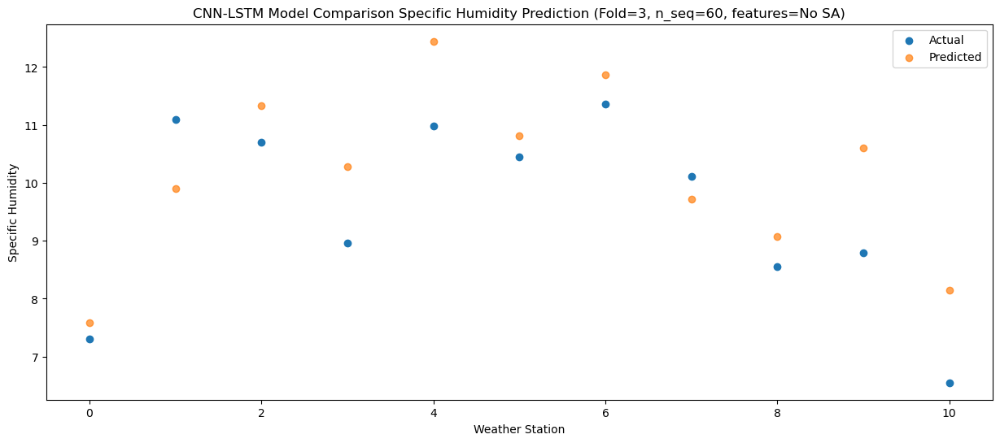

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    4.39   4.748235
1                 1    7.03   7.220748
2                 2    9.16   9.794720
3                 3    6.49   7.590865
4                 4    6.87   9.691112
5                 5    7.22   8.062777
6                 6    8.74   9.984594
7                 7    9.17   8.119543
8                 8    8.00   7.553294
9                 9    7.82   8.152060
10               10    4.86   5.632147


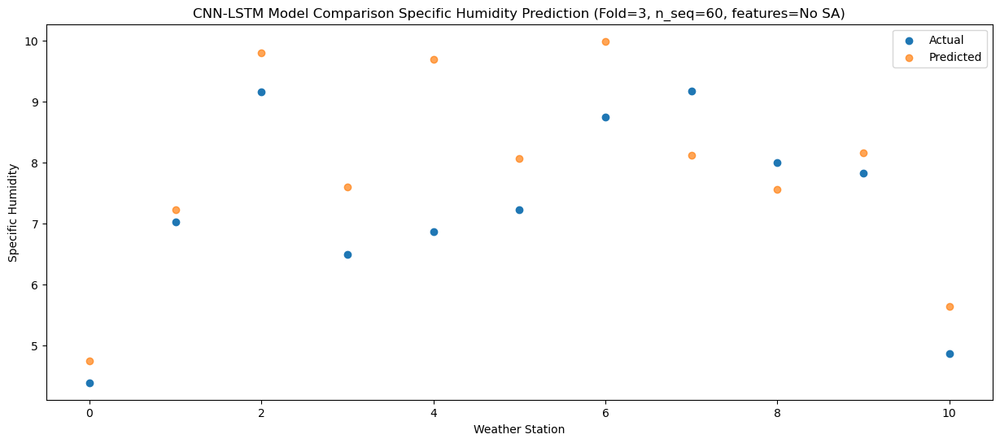

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    0.28   1.296429
1                 1    3.59   3.724963
2                 2    8.00   8.790594
3                 3    2.96   4.253410
4                 4    3.25   6.277882
5                 5    3.84   4.674425
6                 6    7.49   8.259698
7                 7    6.11   6.985637
8                 8    6.57   6.568582
9                 9    4.43   5.197657
10               10    1.59   2.548662


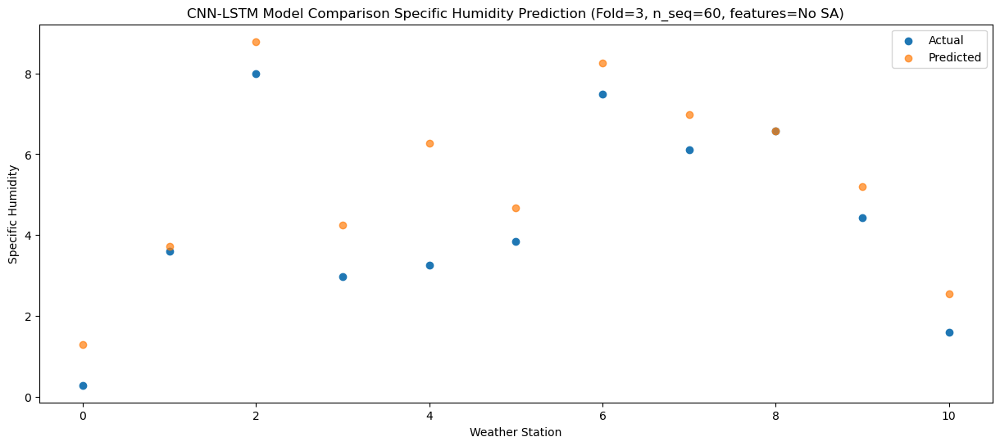

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -2.95  -1.584010
1                 1    0.71   0.915383
2                 2    5.89   7.353082
3                 3   -0.43   1.242960
4                 4    0.08   3.305193
5                 5    0.65   1.661311
6                 6    6.16   6.411155
7                 7    5.10   5.514425
8                 8    5.48   5.145848
9                 9    0.63   2.162706
10               10   -2.09  -0.555028


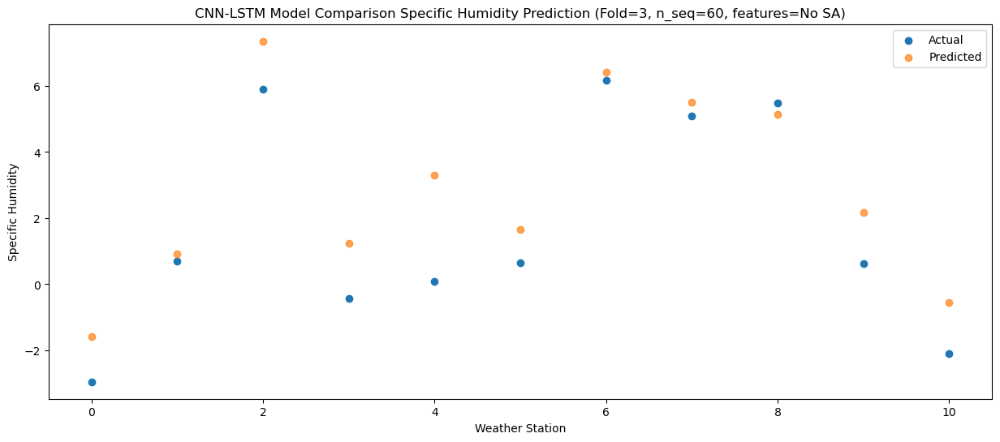

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.96  -2.136320
1                 1   -0.11   0.178472
2                 2    6.12   7.015023
3                 3   -0.41   0.993479
4                 4   -0.33   3.047621
5                 5    0.61   1.458659
6                 6    6.03   6.046097
7                 7    5.02   5.150906
8                 8    5.86   4.750359
9                 9    0.96   2.230346
10               10   -1.71  -0.486694


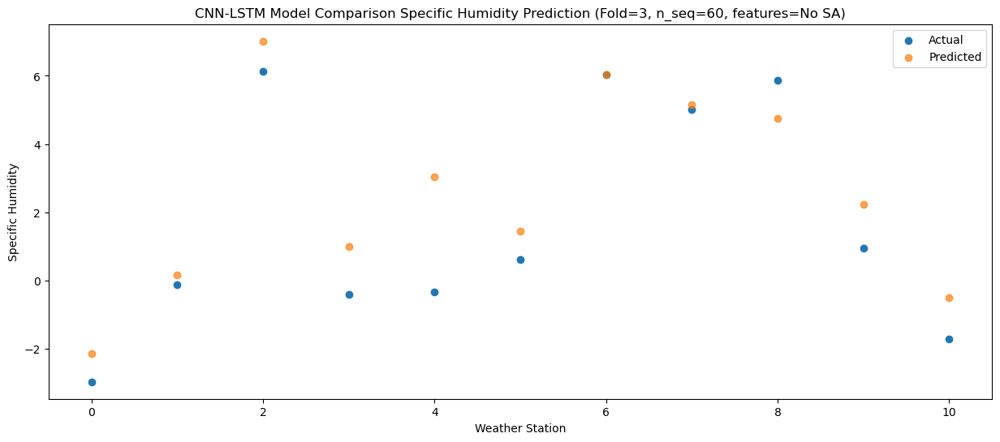

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -3.61  -3.009085
1                 1   -1.42  -0.988033
2                 2    6.66   6.601650
3                 3   -1.15   0.001289
4                 4   -1.20   1.908705
5                 5   -0.27   0.376165
6                 6    5.97   5.401313
7                 7    5.56   4.662167
8                 8    5.87   4.382231
9                 9   -0.34   1.315095
10               10   -2.84  -1.440771


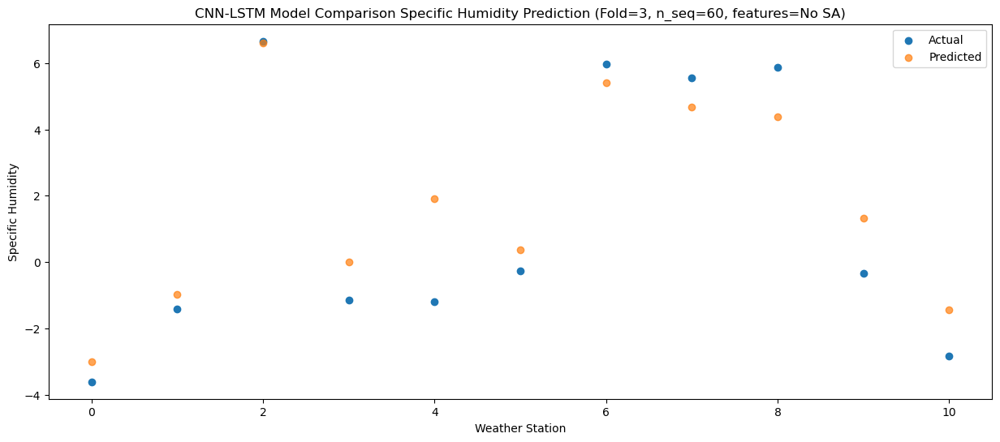

Predictions for (t+51):
    Weather_Station        Actual  Predicted
0                 0 -3.550000e+00  -2.525373
1                 1 -3.552714e-15   0.406397
2                 2  6.830000e+00   7.028767
3                 3 -8.300000e-01   0.568177
4                 4 -2.900000e-01   2.846612
5                 5  3.100000e-01   1.124249
6                 6  6.040000e+00   6.084230
7                 7  6.380000e+00   5.235427
8                 8  5.560000e+00   4.755527
9                 9 -4.400000e-01   1.597294
10               10 -2.930000e+00  -1.142613


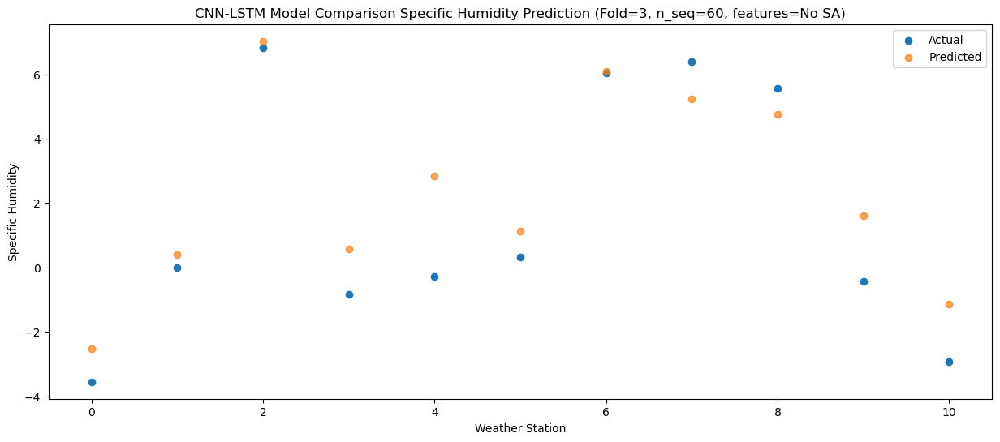

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.05  -1.162127
1                 1    1.42   1.375098
2                 2    6.54   7.090974
3                 3    0.13   1.604905
4                 4    0.75   3.627804
5                 5    1.39   1.985018
6                 6    6.40   6.335248
7                 7    5.70   5.262581
8                 8    5.36   4.914235
9                 9    0.61   2.491865
10               10   -1.88  -0.209582


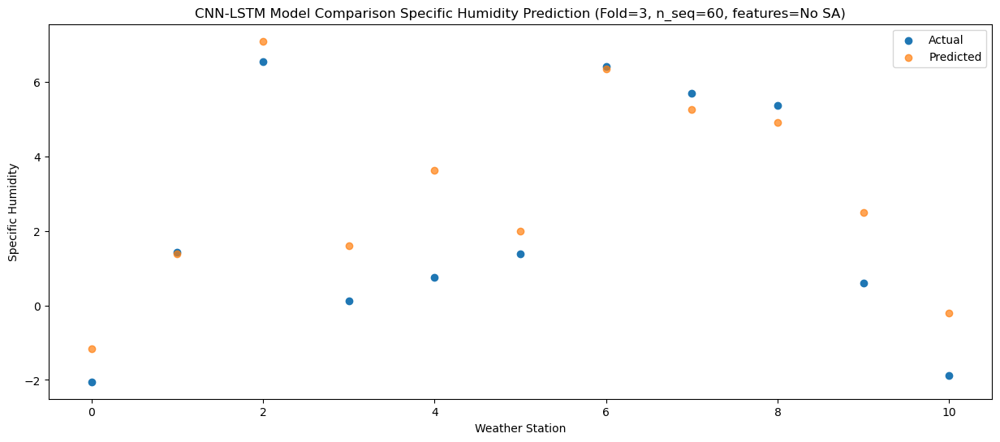

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -0.01   0.404200
1                 1    2.96   3.389400
2                 2    7.22   6.911027
3                 3    2.04   3.326919
4                 4    2.57   5.572763
5                 5    3.64   3.848207
6                 6    7.08   6.830521
7                 7    5.40   5.250423
8                 8    5.80   4.655117
9                 9    1.52   3.984317
10               10   -0.28   1.392374


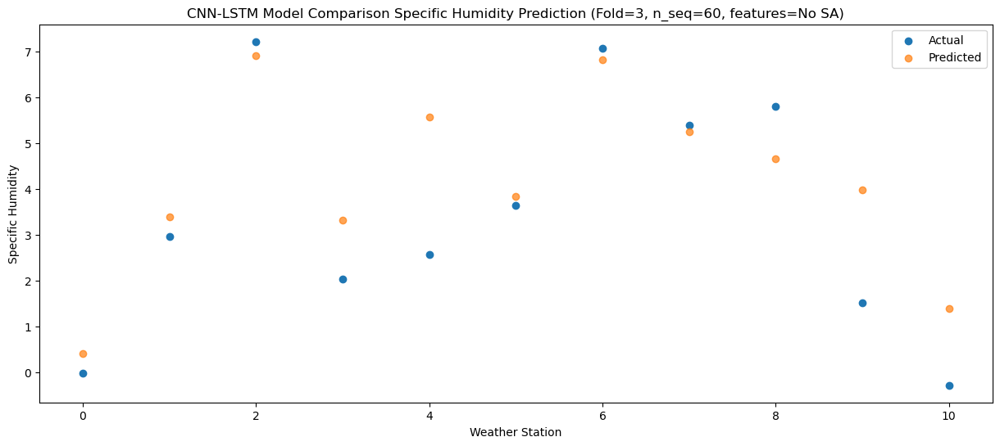

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    3.86   4.336520
1                 1    7.46   7.153375
2                 2    7.09   8.085857
3                 3    6.15   7.055276
4                 4    6.71   9.225925
5                 5    7.31   7.529116
6                 6    7.97   8.736025
7                 7    5.27   6.521375
8                 8    5.96   5.847641
9                 9    4.98   7.363101
10               10    3.35   4.904537


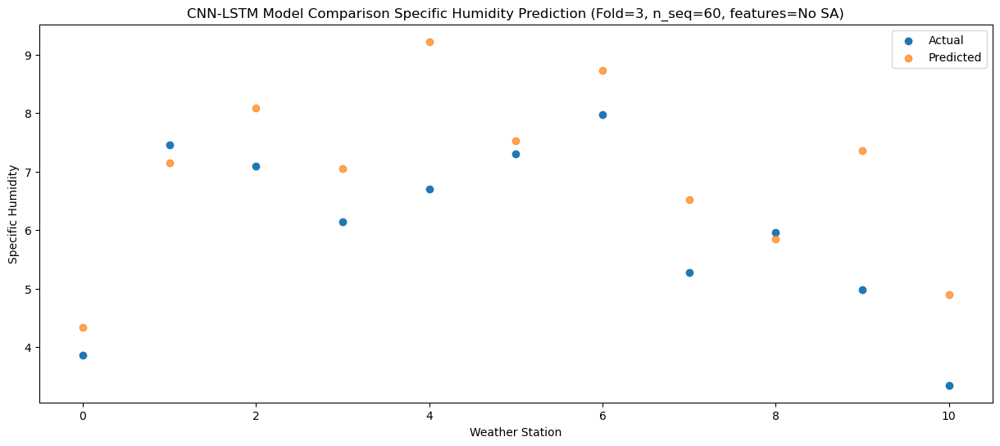

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    5.59   5.891649
1                 1    9.74   9.493952
2                 2    8.36   9.789516
3                 3    7.95   8.942839
4                 4    8.68  11.550732
5                 5    9.13   9.686620
6                 6   10.26  10.720035
7                 7    6.67   8.388141
8                 8    7.11   7.425065
9                 9    7.85   9.169457
10               10    5.03   6.736794


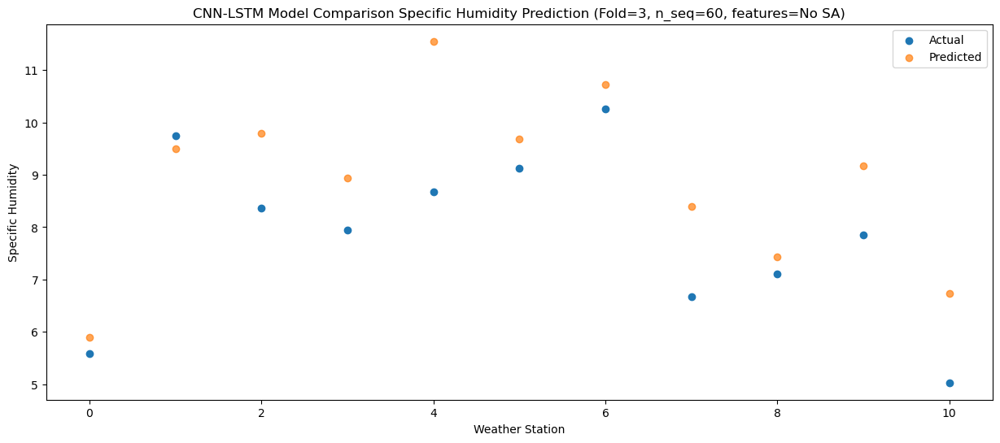

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    8.45   8.392360
1                 1   10.23  10.701711
2                 2   10.34  10.716350
3                 3    8.85  11.165032
4                 4   10.25  13.212726
5                 5   10.32  11.615802
6                 6   10.31  11.717139
7                 7    7.70   9.163707
8                 8    8.69   8.453928
9                 9   11.02  11.543960
10               10    7.91   9.163237


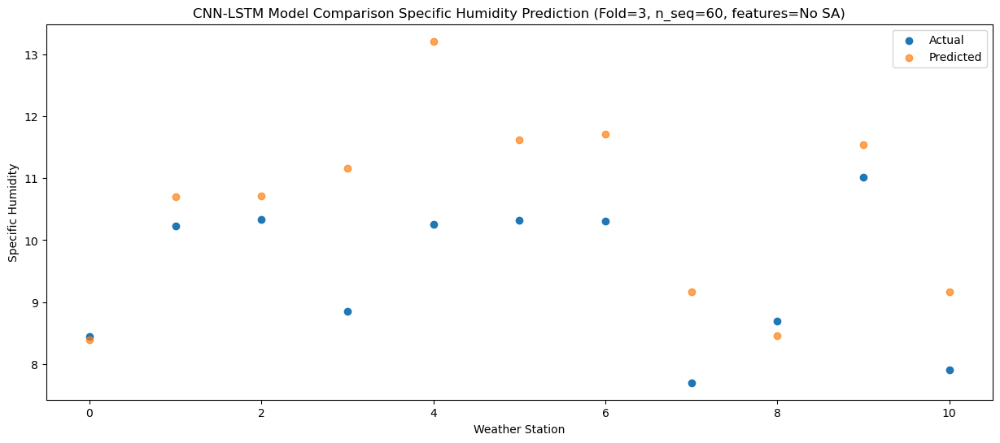

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    7.01   7.324132
1                 1    9.49   9.882608
2                 2    8.65  11.104644
3                 3    7.53  10.152648
4                 4    9.77  12.369925
5                 5    9.76  10.700097
6                 6   11.77  11.777359
7                 7    8.52   9.537840
8                 8    7.96   8.821265
9                 9    9.67  10.584947
10               10    6.63   8.131509


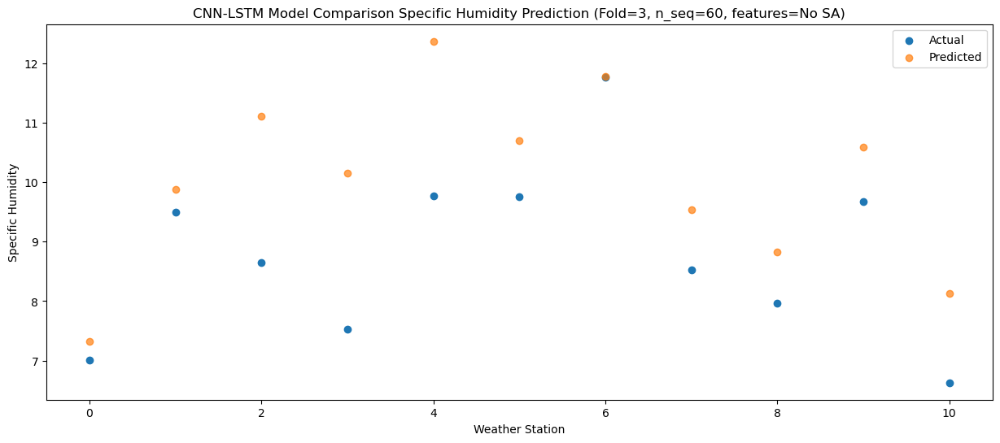

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    5.30   5.899839
1                 1    6.50   7.527845
2                 2    8.92  10.712914
3                 3    5.99   8.283259
4                 4    6.76   9.983292
5                 5    7.14   8.499463
6                 6    9.35  10.715934
7                 7    6.80   8.906625
8                 8    7.64   8.588968
9                 9    6.31   8.897060
10               10    3.81   6.350466


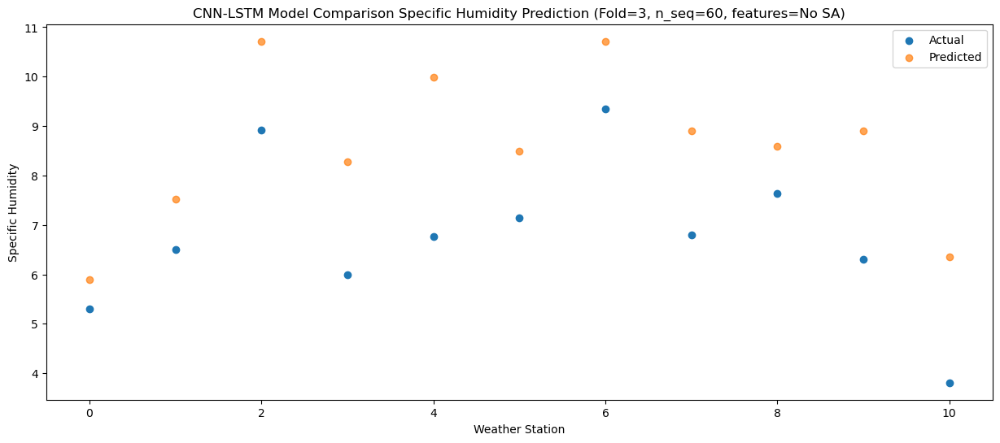

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    0.48   1.688045
1                 1    2.27   3.544825
2                 2    7.81   8.790313
3                 3    2.24   4.251645
4                 4    2.40   6.036450
5                 5    3.27   4.513257
6                 6    7.59   8.211466
7                 7    5.75   6.916590
8                 8    6.05   6.648184
9                 9    3.21   5.163968
10               10   -0.19   2.502595


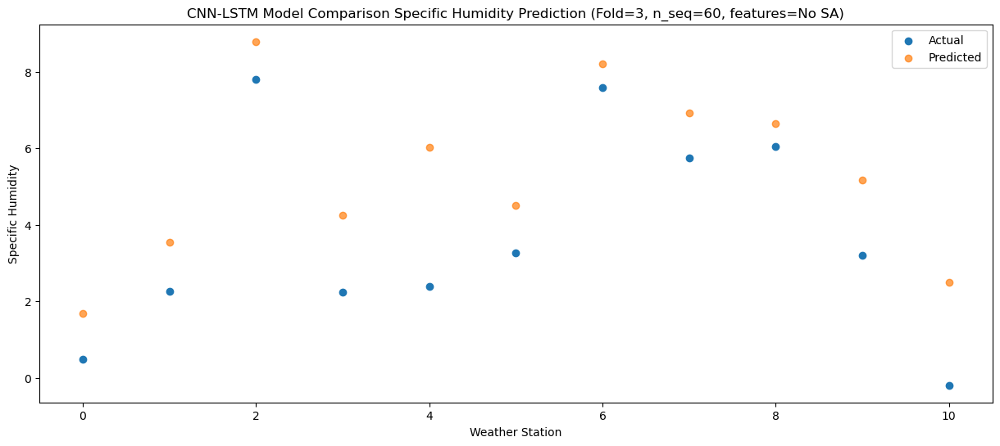

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_3 (Conv1D)           (None, 1, 1024)           1859584   
                                                                 
 max_pooling1d_3 (MaxPooling  (None, 1, 1024)          0         
 1D)                                                             
                                                                 
 dropout_9 (Dropout)         (None, 1, 1024)           0         
                                                                 
 lstm_6 (LSTM)               (None, 1, 512)            3147776   
                                                                 
 dropout_10 (Dropout)        (None, 1, 512)            0         
                                                                 
 lstm_7 (LSTM)               (None, 512)               2099200   
                                                      

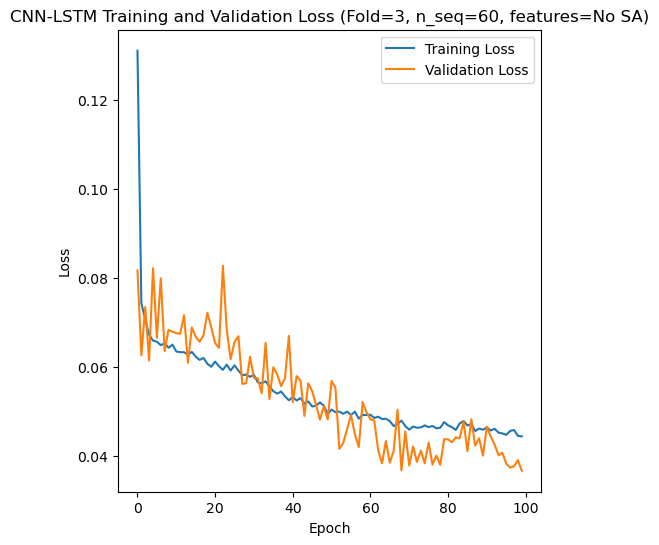

Epoch 1/100
84/84 [==============================] - 22s 97ms/step - loss: 0.1230 - accuracy: 0.2619 - mae: 0.1038 - rmse: 0.1230 - mape: 22.1505 - pearson: 0.5999 - val_loss: 0.0707 - val_accuracy: 0.7000 - val_mae: 0.0547 - val_rmse: 0.0707 - val_mape: 12.3661 - val_pearson: 0.7474
Epoch 2/100
84/84 [==============================] - 3s 34ms/step - loss: 0.0765 - accuracy: 0.3452 - mae: 0.0608 - rmse: 0.0765 - mape: 13.6284 - pearson: 0.7327 - val_loss: 0.0701 - val_accuracy: 0.1000 - val_mae: 0.0564 - val_rmse: 0.0701 - val_mape: 12.3245 - val_pearson: 0.7711
Epoch 3/100
84/84 [==============================] - 3s 33ms/step - loss: 0.0696 - accuracy: 0.3690 - mae: 0.0551 - rmse: 0.0696 - mape: 12.3964 - pearson: 0.7627 - val_loss: 0.0602 - val_accuracy: 0.7000 - val_mae: 0.0479 - val_rmse: 0.0602 - val_mape: 10.6554 - val_pearson: 0.7908
Epoch 4/100
84/84 [==============================] - 3s 34ms/step - loss: 0.0687 - accuracy: 0.4048 - mae: 0.0543 - rmse: 0.0687 - mape: 12.2102 - 

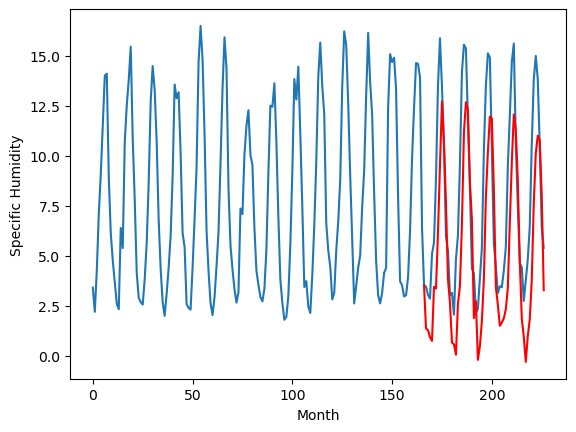

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.36		-1.12		0.24
-1.22		-0.71		0.51
-2.78		-1.26		1.52
-1.94		-1.15		0.79
-0.56		1.32		1.88
0.65		1.06		0.41
1.30		3.58		2.28
4.63		7.04		2.41
6.37		9.54		3.17
6.61		8.65		2.04
6.03		5.97		-0.06
3.99		2.92		-1.07
0.93		0.67		-0.26
-3.81		-1.92		1.89
-3.46		-1.96		1.50
-1.47		-1.95		-0.48
-1.50		0.14		1.64
-0.75		0.84		1.59
0.58		3.39		2.81
4.87		8.16		3.29
6.08		9.58		3.50
6.47		9.44		2.97
5.67		6.38		0.71
2.75		4.48		1.73
-1.91		-0.90		1.01
-0.17		0.66		0.83
-4.03		-2.72		1.31
-2.45		-1.62		0.83
-0.92		-0.48		0.44
0.37		1.18		0.81
2.76		5.24		2.48
5.66		7.16		1.50
6.69		9.29		2.60
6.77		8.77		2.00
5.90		5.60		-0.30
1.12		0.73		-0.39
1.29		0.14		-1.15
-2.23		-1.21		1.02
-2.74		-0.97		1.77
-0.80		-0.42		0.38
-0.42		-0.40		0.02
1.07		0.93		-0.14
1.87		3.18		1.31
5.38		6.14		0.76
7.29		8.96		1.67
7.59		8.36		0.77
5.14		5.77		0.63
1.52		1.59		0.07
-0.78		-1.18		-0.40
-1.87		-2.06		-0.19
-2.91		

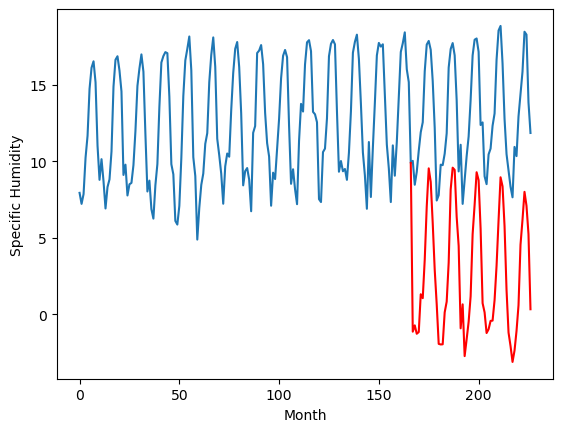

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.06		-1.42		-0.36
-0.22		-1.20		-0.98
-0.36		-1.64		-1.28
-0.55		-1.60		-1.05
3.00		1.72		-1.28
1.88		1.15		-0.73
4.12		3.97		-0.15
7.42		7.73		0.31
10.35		10.71		0.36
8.84		9.11		0.27
6.79		6.29		-0.50
3.44		2.45		-0.99
0.77		0.33		-0.44
-1.61		-2.52		-0.91
-1.72		-2.52		-0.80
-1.84		-2.71		-0.87
1.22		0.16		-1.06
1.47		0.81		-0.66
4.91		4.19		-0.72
9.15		9.09		-0.06
10.80		10.50		-0.30
10.81		10.16		-0.65
7.87		6.57		-1.30
5.09		4.43		-0.66
-0.35		-1.54		-1.19
2.60		0.66		-1.94
-2.13		-3.64		-1.51
-1.28		-2.49		-1.21
-0.23		-1.25		-1.02
2.22		1.26		-0.96
6.82		5.89		-0.93
9.20		8.09		-1.11
11.04		9.84		-1.20
10.86		9.35		-1.51
6.62		5.50		-1.12
1.66		-0.08		-1.74
0.91		-0.30		-1.21
0.37		-1.59		-1.96
0.27		-1.57		-1.84
0.94		-0.72		-1.66
1.27		-0.54		-1.81
2.11		0.54		-1.57
5.49		3.86		-1.63
9.06		7.08		-1.98
10.65		9.56		-1.09
9.07		8.86		-0.21
6.05		5.76		-0.29
2.12		1.06		-1.06
0.14		-

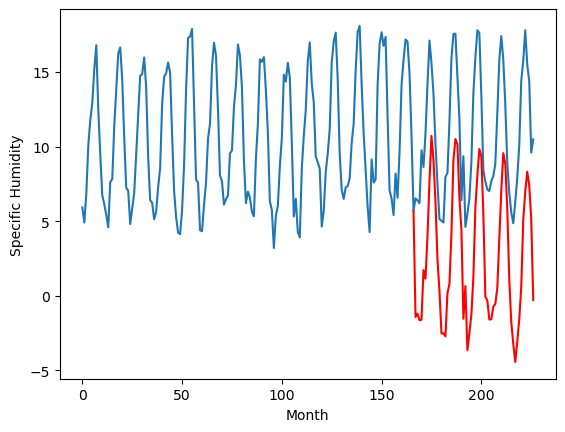

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.12		-0.25		-1.37
0.12		-0.35		-0.47
0.76		-0.69		-1.45
0.14		-0.86		-1.00
4.09		2.37		-1.72
3.69		2.07		-1.62
6.85		4.88		-1.97
9.01		8.28		-0.73
12.24		11.43		-0.81
9.65		9.26		-0.39
8.44		6.44		-2.00
3.87		2.35		-1.52
2.23		1.04		-1.19
-0.37		-1.22		-0.85
-0.48		-1.17		-0.69
-0.80		-1.69		-0.89
1.86		1.19		-0.67
3.15		1.94		-1.21
7.15		5.45		-1.70
10.84		9.95		-0.89
11.41		11.39		-0.02
11.80		10.83		-0.97
7.79		7.17		-0.62
4.94		5.12		0.18
1.32		0.03		-1.29
3.18		1.42		-1.76
-1.48		-2.17		-0.69
-0.95		-1.44		-0.49
0.64		-0.12		-0.76
4.15		2.40		-1.75
8.14		6.66		-1.48
9.91		9.07		-0.84
9.33		10.57		1.24
10.34		10.41		0.07
7.06		6.64		-0.42
2.60		1.45		-1.15
2.42		0.78		-1.64
0.84		-0.15		-0.99
0.15		-0.16		-0.31
0.51		0.34		-0.17
2.57		0.87		-1.70
3.25		1.71		-1.54
7.51		5.59		-1.92
11.45		8.57		-2.88
11.30		10.59		-0.71
9.20		9.96		0.76
8.30		7.11		-1.19
4.58		2.77		-1.81
2.05		0.03		-2.

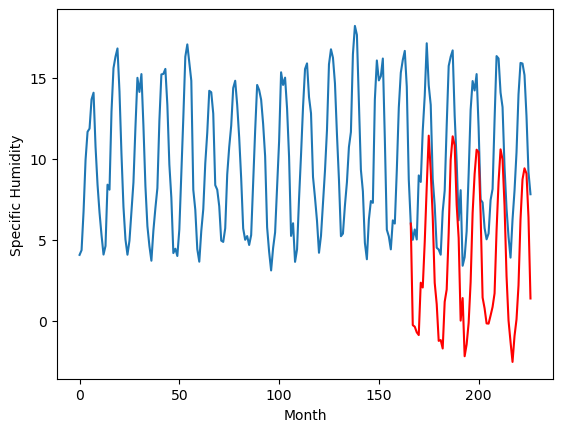

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.61		-0.43		-1.04
-0.36		-0.55		-0.19
0.33		-0.89		-1.22
-0.33		-1.09		-0.76
3.57		2.03		-1.54
3.06		1.81		-1.25
6.30		4.59		-1.71
8.28		7.88		-0.40
11.43		11.00		-0.43
8.78		8.82		0.04
7.89		6.02		-1.87
3.12		2.00		-1.12
1.76		0.80		-0.96
-0.81		-1.33		-0.52
-0.85		-1.27		-0.42
-1.30		-1.82		-0.52
1.28		0.96		-0.32
2.64		1.74		-0.90
6.93		5.17		-1.76
10.81		9.59		-1.22
11.19		11.03		-0.16
11.30		10.45		-0.85
7.40		6.85		-0.55
4.67		4.84		0.17
1.06		-0.03		-1.09
2.47		1.16		-1.31
-1.86		-2.20		-0.34
-1.42		-1.55		-0.13
0.10		-0.23		-0.33
3.78		2.19		-1.59
7.66		6.32		-1.34
9.34		8.73		-0.61
8.84		10.23		1.39
10.01		10.12		0.11
6.86		6.45		-0.41
2.40		1.41		-0.99
1.98		0.62		-1.36
0.39		-0.25		-0.64
-0.36		-0.24		0.12
0.04		0.17		0.13
2.01		0.74		-1.27
2.86		1.56		-1.30
7.13		5.41		-1.72
10.61		8.33		-2.28
9.71		10.29		0.58
8.33		9.70		1.37
8.00		6.95		-1.05
4.34		2.73		-1.61
1.92		0.03		-1.8

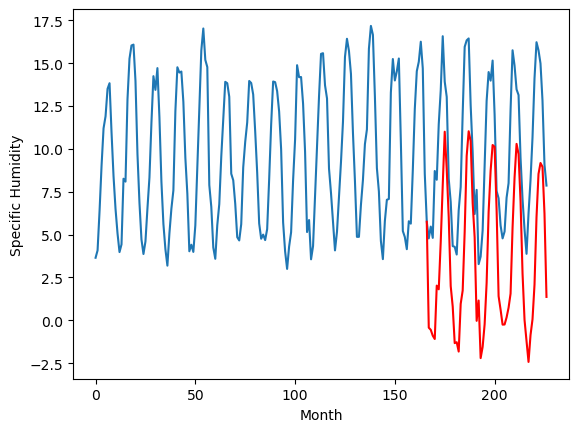

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
6.92		5.39		-1.53
5.68		5.30		-0.38
5.56		4.90		-0.66
5.44		4.70		-0.74
8.24		7.05		-1.19
7.49		7.25		-0.24
9.76		9.57		-0.19
11.47		12.13		0.66
12.70		14.58		1.88
11.39		12.97		1.58
11.20		10.61		-0.59
7.55		7.34		-0.21
7.09		6.37		-0.72
4.53		4.78		0.25
5.23		4.96		-0.27
4.59		4.51		-0.08
6.08		6.49		0.41
7.04		7.23		0.19
11.59		10.01		-1.58
13.89		13.78		-0.11
14.92		15.16		0.24
14.64		14.50		-0.14
11.39		11.60		0.21
8.34		9.81		1.47
6.62		6.35		-0.27
5.77		6.61		0.84
4.31		4.44		0.13
4.30		4.76		0.46
4.89		6.05		1.16
6.92		7.62		0.70
9.18		10.78		1.60
12.03		13.13		1.10
12.72		14.65		1.93
14.71		14.66		-0.05
13.46		11.79		-1.67
9.95		7.84		-2.11
7.25		6.37		-0.88
6.61		5.85		-0.76
5.06		5.97		0.91
5.18		6.04		0.86
6.47		6.70		0.23
6.44		7.45		1.01
11.28		10.82		-0.46
15.14		13.07		-2.07
12.81		14.72		1.91
11.95		14.60		2.65
12.46		12.36		-0.10
10.33		8.92		-1.41
8.03		6.56		-1.47
6.45		5.

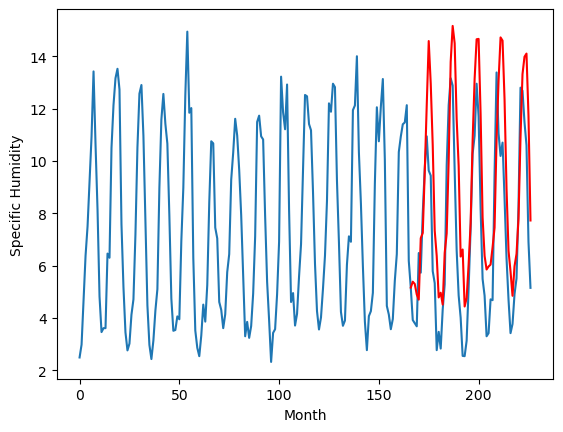

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.46		0.44		-0.02
0.53		0.81		0.28
0.37		0.31		-0.06
0.95		0.40		-0.55
3.14		2.89		-0.25
2.47		2.57		0.10
5.59		5.34		-0.25
9.42		9.18		-0.24
12.01		12.11		0.10
12.22		10.89		-1.33
8.38		7.84		-0.54
5.73		4.52		-1.21
2.90		2.32		-0.58
-0.44		-0.32		0.12
-0.56		-0.54		0.02
-0.31		-0.63		-0.32
1.40		1.66		0.26
1.81		2.51		0.70
4.79		5.12		0.33
9.48		10.28		0.80
11.08		11.80		0.72
11.46		11.82		0.36
7.88		8.37		0.49
5.67		6.49		0.82
-0.05		0.50		0.55
1.81		2.09		0.28
-1.17		-1.41		-0.24
0.15		-0.20		-0.35
0.99		0.91		-0.08
2.05		2.75		0.70
6.06		7.20		1.14
8.34		9.05		0.71
11.50		11.37		-0.13
10.31		10.87		0.56
6.76		7.41		0.65
2.08		2.17		0.09
1.90		1.77		-0.13
-0.09		0.16		0.25
0.54		0.47		-0.07
1.58		0.95		-0.63
1.07		0.91		-0.16
2.67		2.42		-0.25
4.89		4.52		-0.37
7.94		7.88		-0.06
11.33		11.12		-0.21
10.87		10.13		-0.74
7.42		7.54		0.12
3.51		3.16		-0.35
0.56		0.10		-0.46
0.28		-0.71		-0.99

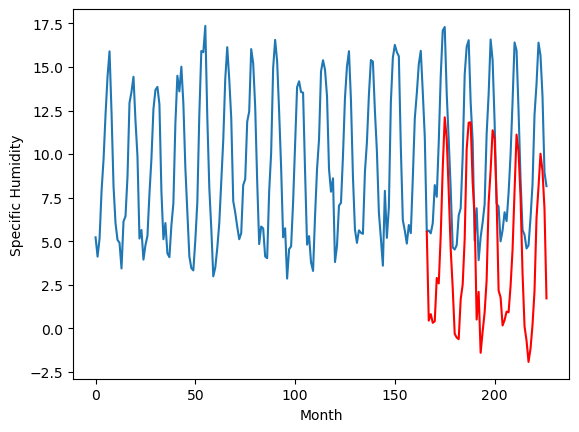

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.67		-0.44		-1.11
0.40		-0.41		-0.81
0.16		-0.79		-0.95
-0.07		-0.90		-0.83
2.48		2.07		-0.41
2.80		1.78		-1.02
6.18		4.63		-1.55
9.79		8.21		-1.58
11.84		11.39		-0.45
9.19		9.42		0.23
7.59		6.46		-1.13
3.04		2.56		-0.48
1.37		1.03		-0.34
-0.56		-1.32		-0.76
-0.71		-1.39		-0.68
-1.34		-1.81		-0.47
1.03		0.90		-0.13
1.95		1.74		-0.21
5.11		4.96		-0.15
9.71		9.73		0.02
10.66		11.21		0.55
10.40		10.86		0.46
7.14		7.18		0.04
5.05		5.21		0.16
0.36		-0.22		-0.58
1.83		1.17		-0.66
-1.37		-2.35		-0.98
-0.86		-1.48		-0.62
0.65		-0.22		-0.87
2.44		2.10		-0.34
7.15		6.47		-0.68
9.51		8.69		-0.82
10.31		10.47		0.16
10.78		10.24		-0.54
6.97		6.53		-0.44
2.31		1.28		-1.03
0.95		0.71		-0.24
0.08		-0.47		-0.55
0.36		-0.37		-0.73
0.17		0.08		-0.09
0.93		0.43		-0.50
1.83		1.51		-0.32
6.22		4.81		-1.41
8.78		7.97		-0.81
11.57		10.45		-1.12
11.85		9.63		-2.22
7.65		6.89		-0.76
4.04		2.53		-1.51
1.01		-0.36		-1.

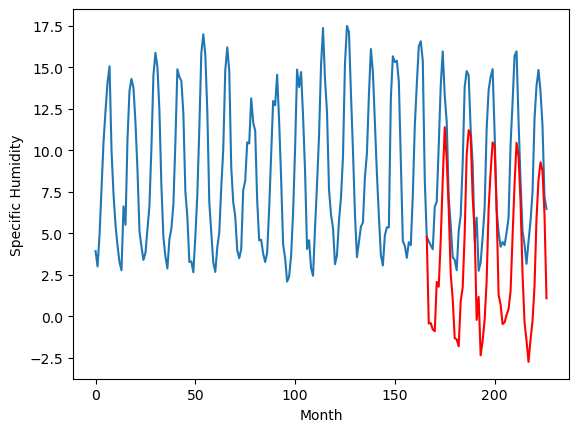

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.13		-1.02		-1.15
0.30		-0.82		-1.12
-0.07		-1.27		-1.20
-0.47		-1.34		-0.87
1.45		0.66		-0.79
1.73		0.66		-1.07
4.88		3.47		-1.41
7.62		7.21		-0.41
10.84		10.36		-0.48
9.17		8.80		-0.37
6.25		5.54		-0.71
2.87		2.22		-0.65
1.19		0.57		-0.62
-0.41		-1.55		-1.14
-0.76		-1.90		-1.14
-1.33		-2.20		-0.87
0.61		-0.17		-0.78
1.94		0.93		-1.01
4.23		3.25		-0.98
9.29		8.37		-0.92
10.55		9.99		-0.56
10.69		10.09		-0.60
7.21		6.51		-0.70
6.06		4.84		-1.22
0.29		-0.68		-0.97
1.00		-0.01		-1.01
-1.38		-2.62		-1.24
-0.80		-1.67		-0.87
0.51		-0.55		-1.06
2.00		1.00		-1.00
6.02		5.20		-0.82
7.46		6.99		-0.47
10.20		9.46		-0.74
9.84		9.21		-0.63
7.18		5.92		-1.26
1.85		1.02		-0.83
0.81		0.28		-0.53
-0.15		-1.32		-1.17
0.47		-0.88		-1.35
0.07		-0.88		-0.95
0.42		-0.80		-1.22
1.87		0.81		-1.06
4.12		2.64		-1.48
6.08		6.01		-0.07
10.38		9.43		-0.95
9.84		8.23		-1.61
7.04		6.09		-0.95
3.71		2.07		-1.64
0.64		-1.

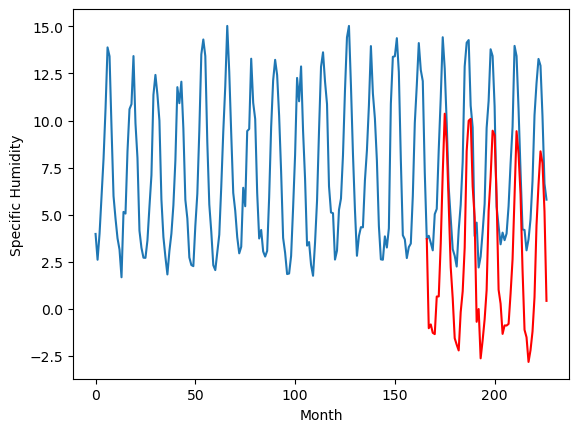

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.54		-1.88		-1.34
-0.37		-1.79		-1.42
-0.85		-2.20		-1.35
-1.12		-2.31		-1.19
0.93		0.01		-0.92
1.52		-0.04		-1.56
5.24		2.78		-2.46
7.72		6.38		-1.34
11.28		9.56		-1.72
9.09		7.76		-1.33
6.31		4.62		-1.69
2.15		1.07		-1.08
1.06		-0.39		-1.45
-0.85		-2.48		-1.63
-1.17		-2.71		-1.54
-1.81		-3.11		-1.30
0.56		-0.84		-1.40
1.87		0.18		-1.69
4.49		2.83		-1.66
9.24		7.74		-1.50
10.64		9.32		-1.32
10.89		9.22		-1.67
6.86		5.60		-1.26
4.99		3.85		-1.14
-0.30		-1.46		-1.16
0.24		-0.68		-0.92
-2.00		-3.47		-1.47
-1.30		-2.62		-1.32
0.22		-1.44		-1.66
1.52		0.37		-1.15
5.59		4.54		-1.05
7.83		6.53		-1.30
10.47		8.71		-1.76
9.70		8.53		-1.17
6.33		5.12		-1.21
1.57		0.18		-1.39
0.20		-0.60		-0.80
-0.91		-1.98		-1.07
-0.39		-1.66		-1.27
-0.62		-1.56		-0.94
-0.01		-1.31		-1.30
1.50		0.06		-1.44
4.28		2.51		-1.77
5.92		5.76		-0.16
10.62		8.74		-1.88
10.49		7.71		-2.78
6.71		5.40		-1.31
3.27		1.34		-1.93


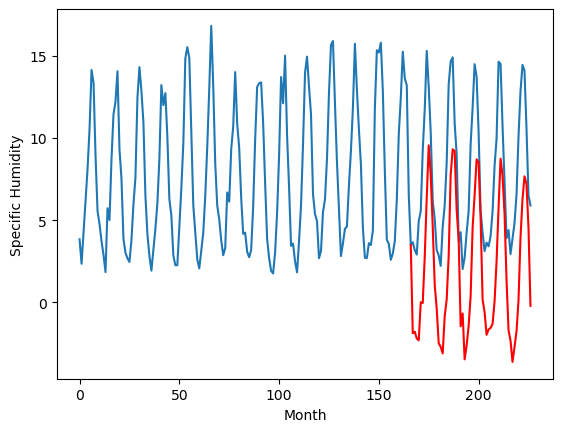

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.53		0.44		-1.09
1.68		0.72		-0.96
1.34		0.24		-1.10
0.99		0.20		-0.79
2.56		1.83		-0.73
2.40		1.93		-0.47
5.02		4.72		-0.30
8.21		8.50		0.29
11.13		11.62		0.49
9.71		10.25		0.54
7.57		6.90		-0.67
4.53		3.82		-0.71
2.60		2.08		-0.52
1.27		0.02		-1.25
0.89		-0.42		-1.31
0.32		-0.66		-0.98
1.61		1.10		-0.51
3.28		2.29		-0.99
4.88		4.25		-0.63
9.89		9.50		-0.39
11.16		11.17		0.01
12.03		11.44		-0.59
8.27		7.92		-0.35
7.26		6.37		-0.89
2.02		0.79		-1.23
1.98		1.24		-0.74
0.24		-1.06		-1.30
0.69		-0.06		-0.75
1.84		0.99		-0.85
2.83		2.24		-0.59
6.29		6.37		0.08
8.20		8.00		-0.20
9.93		10.73		0.80
10.39		10.46		0.07
8.40		7.34		-1.06
3.58		2.57		-1.01
2.86		1.77		-1.09
1.41		0.01		-1.40
2.03		0.58		-1.45
1.28		0.43		-0.85
1.49		0.40		-1.09
3.19		2.21		-0.98
4.09		3.46		-0.63
7.33		6.91		-0.42
10.95		10.69		-0.26
10.15		9.35		-0.80
8.44		7.42		-1.02
5.38		3.52		-1.86
1.94		0.24		-1.70
2.46		0.12		

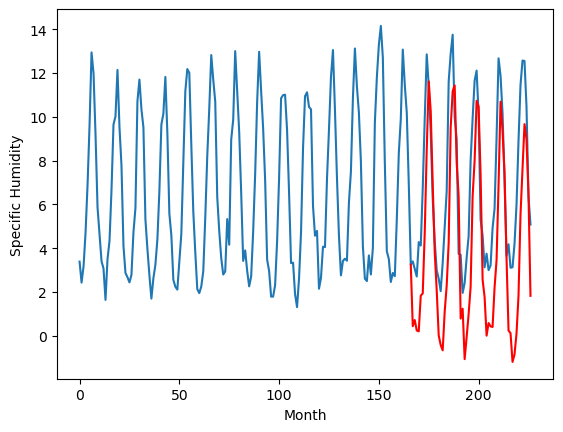

RangeIndex(start=1, stop=12, step=1)
[2.3299999999999996, -1.3599999999999994, -1.06, 1.1199999999999997, 0.6100000000000012, 6.92, 0.45999999999999996, 0.6700000000000013, 0.1299999999999999, -0.5399999999999991, 1.529999999999999]
[1.3508286190032956, -1.121675090789795, -1.4213447761535645, -0.25351921081542983, -0.4262658119201661, 5.385384740829468, 0.4368743133544921, -0.4390348625183105, -1.0245920181274415, -1.8775513267517088, 0.4375507545471189]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.33   1.350829
1                 1   -1.36  -1.121675
2                 2   -1.06  -1.421345
3                 3    1.12  -0.253519
4                 4    0.61  -0.426266
5                 5    6.92   5.385385
6                 6    0.46   0.436874
7                 7    0.67  -0.439035
8                 8    0.13  -1.024592
9                 9   -0.54  -1.877551
10               10    1.53   0.437551


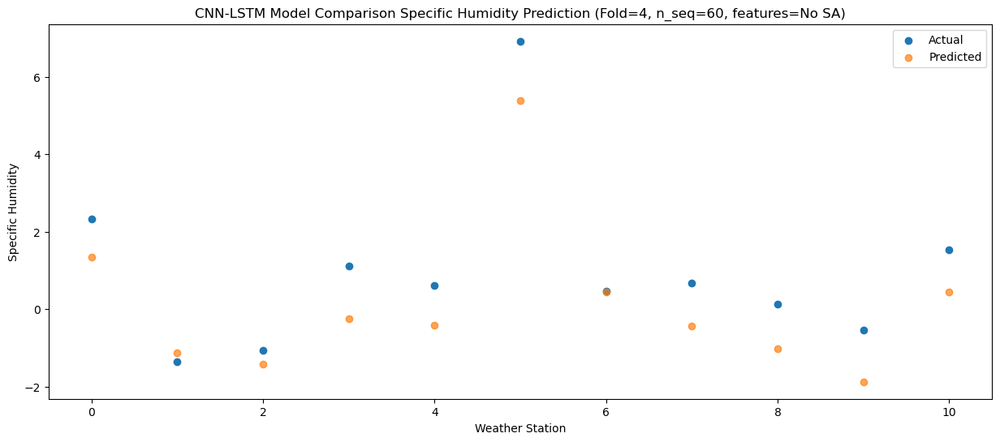

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    2.26   1.272367
1                 1   -1.22  -0.710482
2                 2   -0.22  -1.198046
3                 3    0.12  -0.349877
4                 4   -0.36  -0.552526
5                 5    5.68   5.298600
6                 6    0.53   0.811069
7                 7    0.40  -0.411495
8                 8    0.30  -0.822345
9                 9   -0.37  -1.791404
10               10    1.68   0.721569


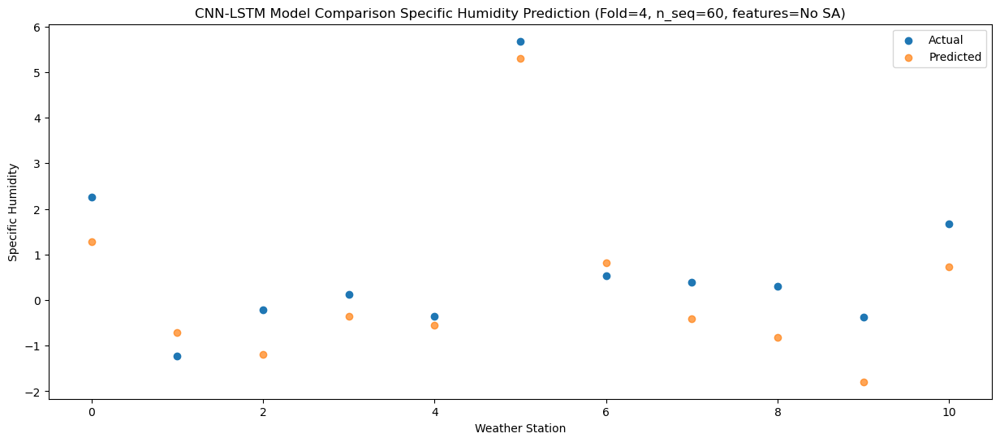

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.84   0.912932
1                 1   -2.78  -1.259615
2                 2   -0.36  -1.638147
3                 3    0.76  -0.694767
4                 4    0.33  -0.893883
5                 5    5.56   4.897478
6                 6    0.37   0.311452
7                 7    0.16  -0.790760
8                 8   -0.07  -1.268843
9                 9   -0.85  -2.198772
10               10    1.34   0.242547


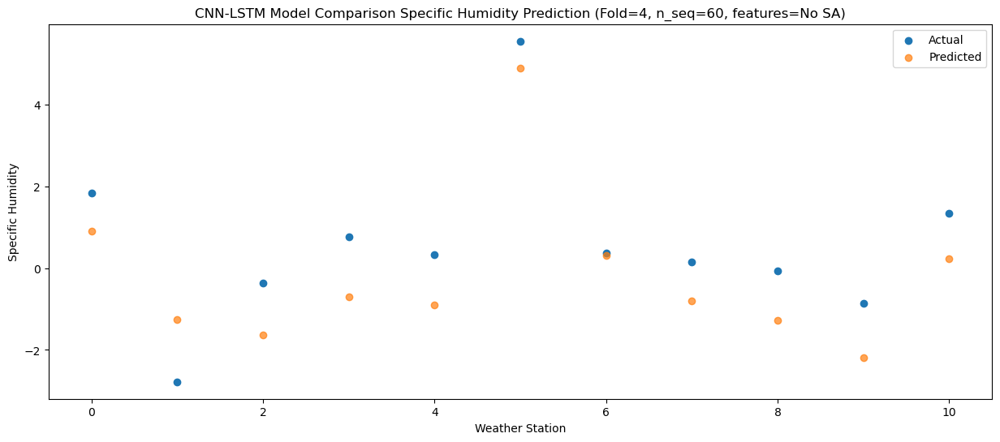

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    1.66   0.733448
1                 1   -1.94  -1.147955
2                 2   -0.55  -1.602016
3                 3    0.14  -0.864837
4                 4   -0.33  -1.087210
5                 5    5.44   4.699737
6                 6    0.95   0.397195
7                 7   -0.07  -0.902631
8                 8   -0.47  -1.336515
9                 9   -1.12  -2.311884
10               10    0.99   0.204600


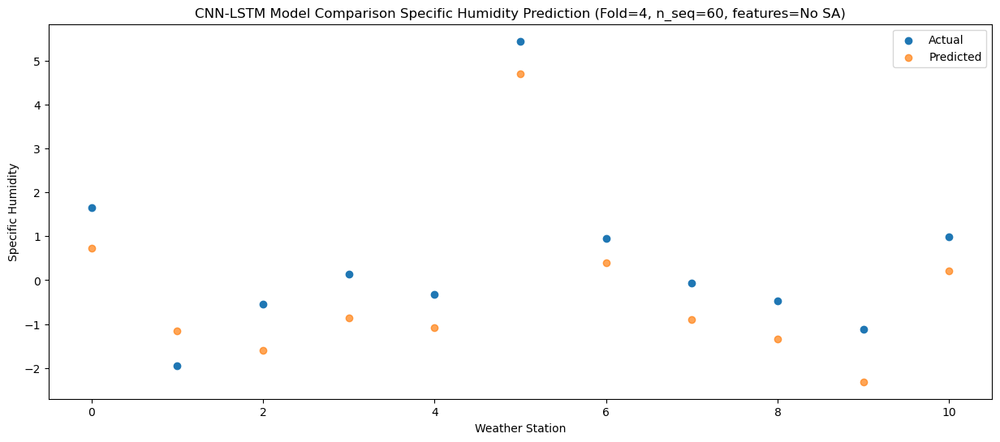

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.89   3.443218
1                 1   -0.56   1.320341
2                 2    3.00   1.722093
3                 3    4.09   2.365914
4                 4    3.57   2.027337
5                 5    8.24   7.047236
6                 6    3.14   2.888501
7                 7    2.48   2.069311
8                 8    1.45   0.657791
9                 9    0.93   0.008469
10               10    2.56   1.832348


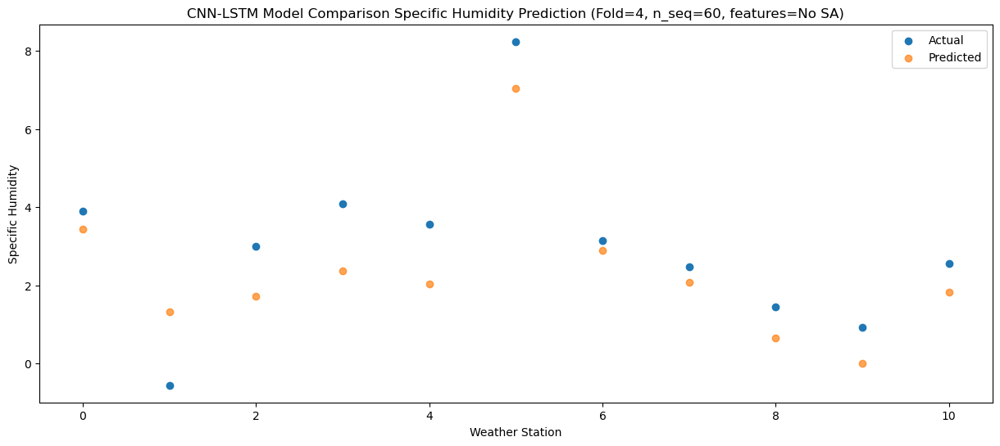

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    4.48   3.352887
1                 1    0.65   1.063786
2                 2    1.88   1.148915
3                 3    3.69   2.066454
4                 4    3.06   1.810449
5                 5    7.49   7.248688
6                 6    2.47   2.570019
7                 7    2.80   1.782677
8                 8    1.73   0.663861
9                 9    1.52  -0.039009
10               10    2.40   1.933176


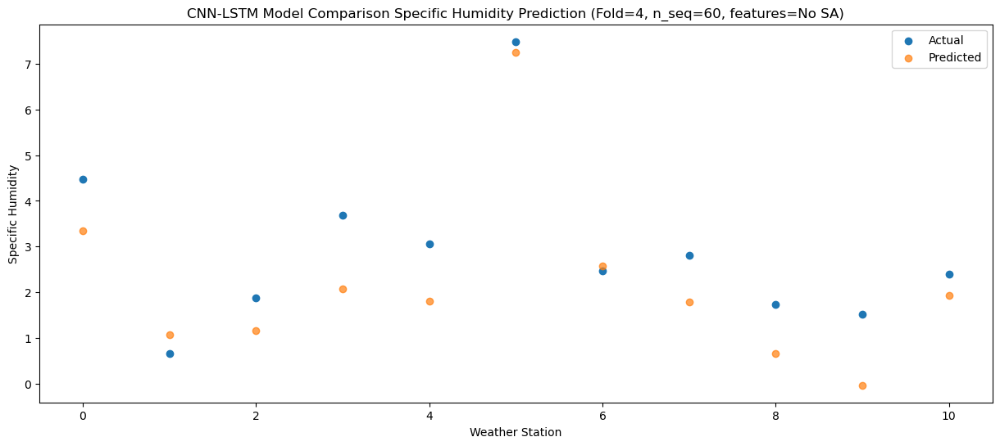

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    7.69   6.153535
1                 1    1.30   3.582143
2                 2    4.12   3.970534
3                 3    6.85   4.882578
4                 4    6.30   4.587359
5                 5    9.76   9.569613
6                 6    5.59   5.341638
7                 7    6.18   4.629218
8                 8    4.88   3.474979
9                 9    5.24   2.776866
10               10    5.02   4.717277


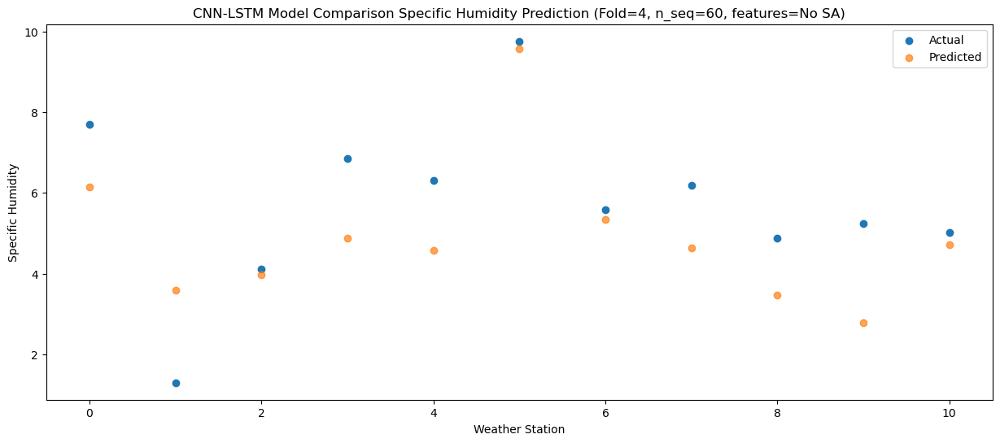

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.34   9.548558
1                 1    4.63   7.041546
2                 2    7.42   7.726227
3                 3    9.01   8.280919
4                 4    8.28   7.884983
5                 5   11.47  12.128534
6                 6    9.42   9.183633
7                 7    9.79   8.214819
8                 8    7.62   7.205553
9                 9    7.72   6.380147
10               10    8.21   8.502835


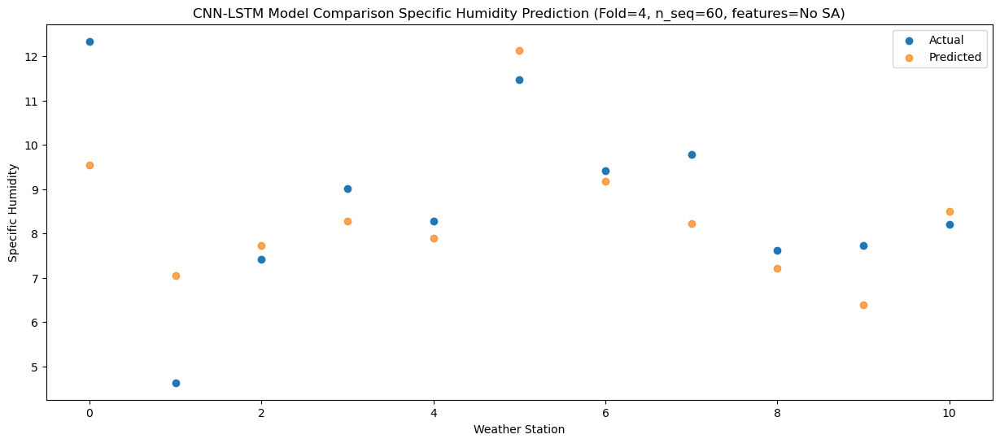

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   14.69  12.729129
1                 1    6.37   9.540072
2                 2   10.35  10.711077
3                 3   12.24  11.432861
4                 4   11.43  11.001182
5                 5   12.70  14.580695
6                 6   12.01  12.111988
7                 7   11.84  11.391149
8                 8   10.84  10.360926
9                 9   11.28   9.559177
10               10   11.13  11.616189


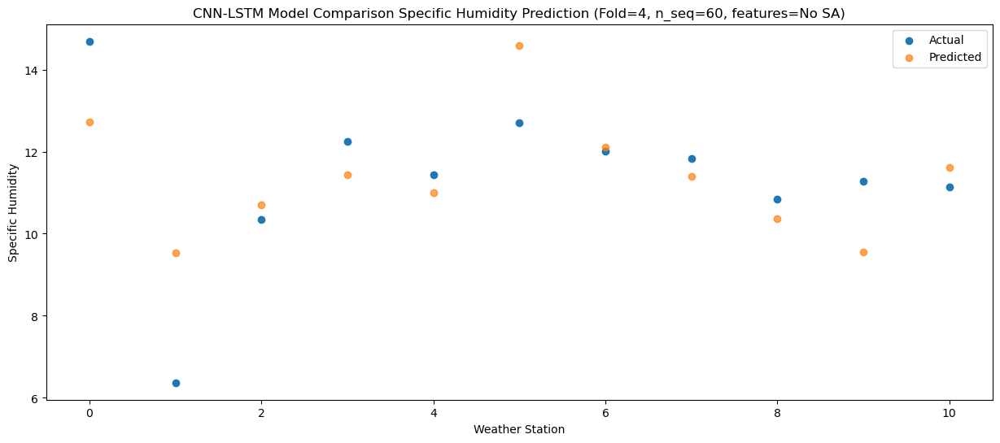

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   12.26  10.633423
1                 1    6.61   8.652042
2                 2    8.84   9.114365
3                 3    9.65   9.257997
4                 4    8.78   8.818486
5                 5   11.39  12.966425
6                 6   12.22  10.888425
7                 7    9.19   9.423617
8                 8    9.17   8.796800
9                 9    9.09   7.764463
10               10    9.71  10.251718


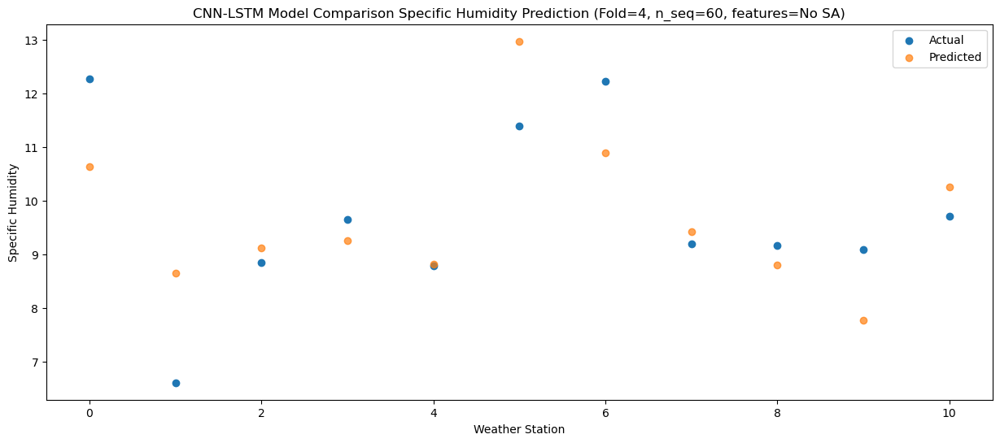

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    9.37   7.642773
1                 1    6.03   5.970742
2                 2    6.79   6.292316
3                 3    8.44   6.436263
4                 4    7.89   6.018502
5                 5   11.20  10.608398
6                 6    8.38   7.839713
7                 7    7.59   6.463840
8                 8    6.25   5.540470
9                 9    6.31   4.620810
10               10    7.57   6.897801


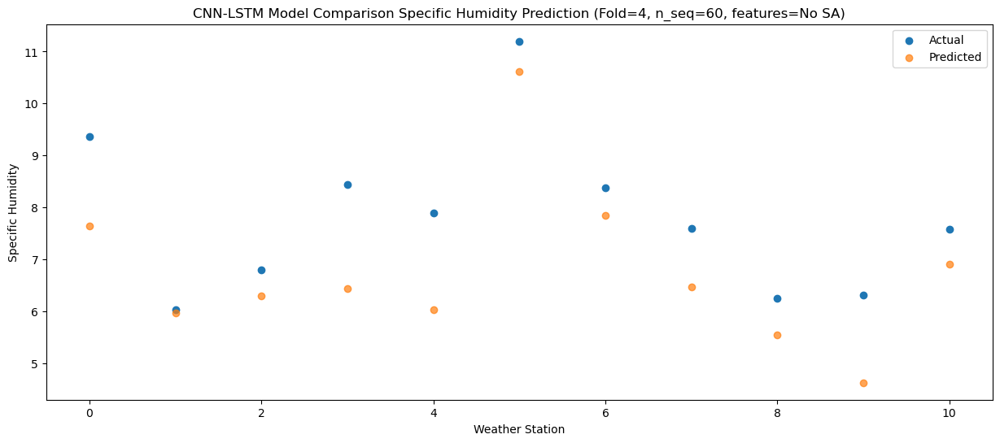

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.78   3.827820
1                 1    3.99   2.918492
2                 2    3.44   2.445658
3                 3    3.87   2.352825
4                 4    3.12   1.997076
5                 5    7.55   7.336233
6                 6    5.73   4.523874
7                 7    3.04   2.562230
8                 8    2.87   2.216562
9                 9    2.15   1.071008
10               10    4.53   3.819683


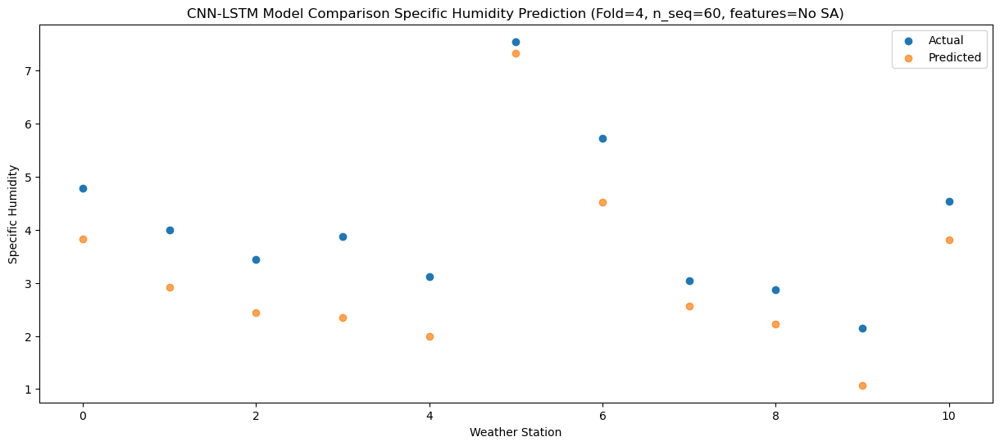

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.06   2.653652
1                 1    0.93   0.666625
2                 2    0.77   0.328991
3                 3    2.23   1.041706
4                 4    1.76   0.804789
5                 5    7.09   6.370114
6                 6    2.90   2.318014
7                 7    1.37   1.028604
8                 8    1.19   0.565046
9                 9    1.06  -0.392290
10               10    2.60   2.078629


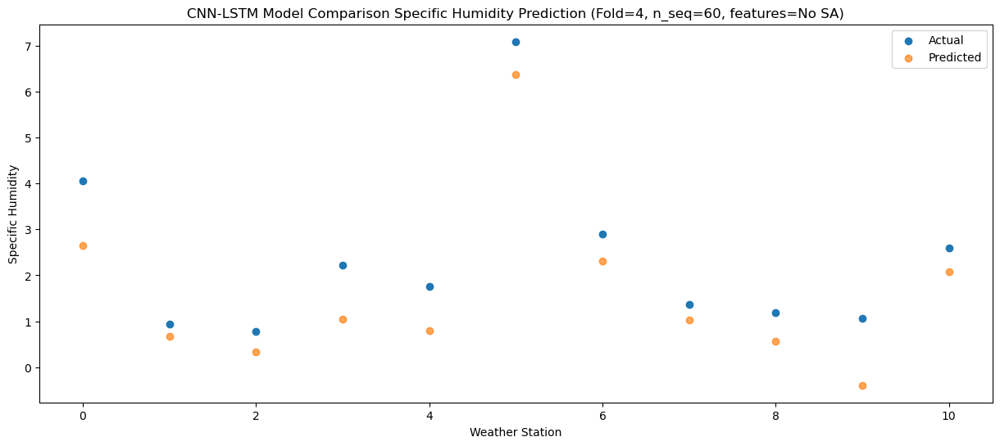

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    1.83   0.649183
1                 1   -3.81  -1.920082
2                 2   -1.61  -2.522403
3                 3   -0.37  -1.222404
4                 4   -0.81  -1.327128
5                 5    4.53   4.783760
6                 6   -0.44  -0.323118
7                 7   -0.56  -1.320902
8                 8   -0.41  -1.554572
9                 9   -0.85  -2.481860
10               10    1.27   0.022586


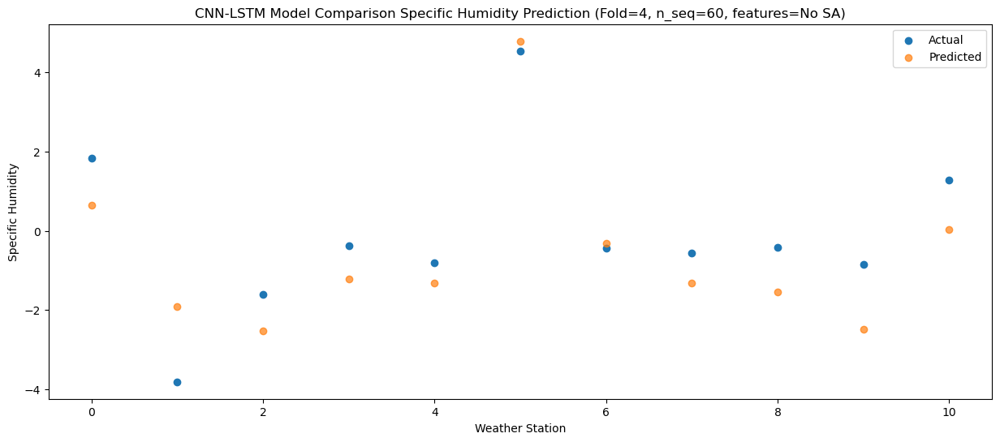

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    1.95   0.566563
1                 1   -3.46  -1.958404
2                 2   -1.72  -2.515245
3                 3   -0.48  -1.173252
4                 4   -0.85  -1.273493
5                 5    5.23   4.964687
6                 6   -0.56  -0.536289
7                 7   -0.71  -1.387856
8                 8   -0.76  -1.898765
9                 9   -1.17  -2.714550
10               10    0.89  -0.422587


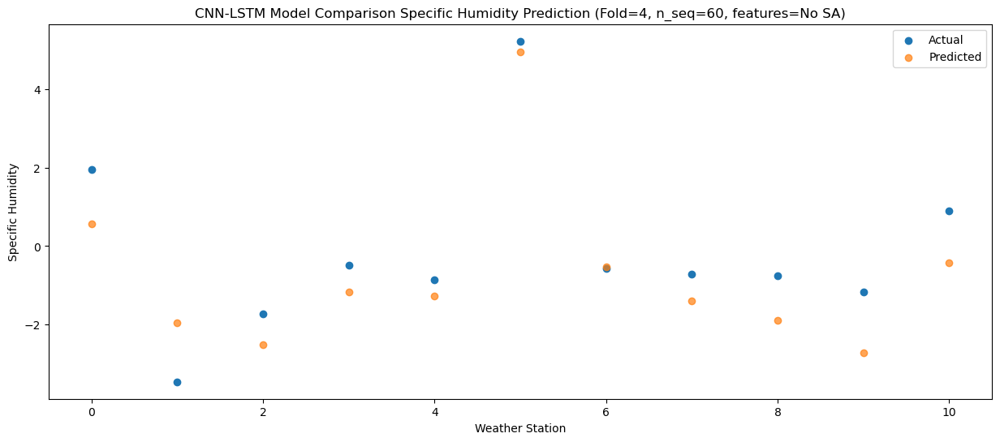

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0    0.86   0.042393
1                 1   -1.47  -1.947595
2                 2   -1.84  -2.713162
3                 3   -0.80  -1.692331
4                 4   -1.30  -1.819448
5                 5    4.59   4.512215
6                 6   -0.31  -0.626924
7                 7   -1.34  -1.810006
8                 8   -1.33  -2.203616
9                 9   -1.81  -3.111578
10               10    0.32  -0.663876


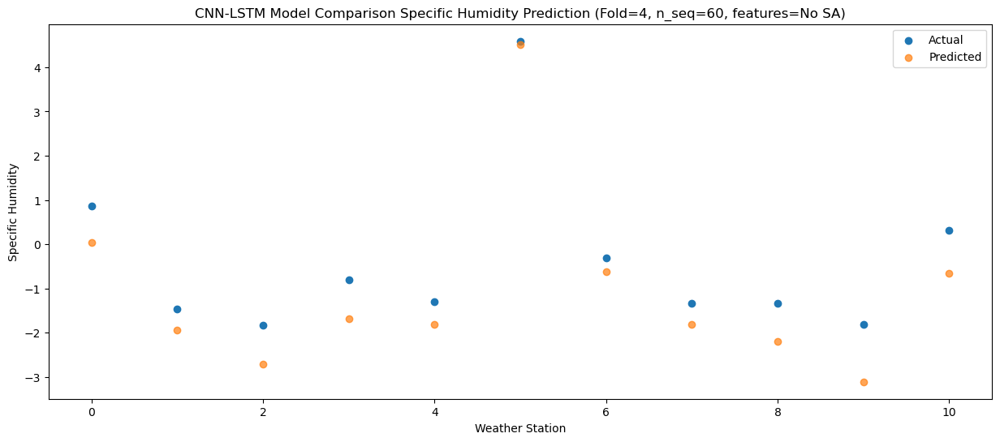

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    3.62   2.574288
1                 1   -1.50   0.138932
2                 2    1.22   0.164509
3                 3    1.86   1.185539
4                 4    1.28   0.962380
5                 5    6.08   6.485246
6                 6    1.40   1.659487
7                 7    1.03   0.904089
8                 8    0.61  -0.168259
9                 9    0.56  -0.844414
10               10    1.61   1.101075


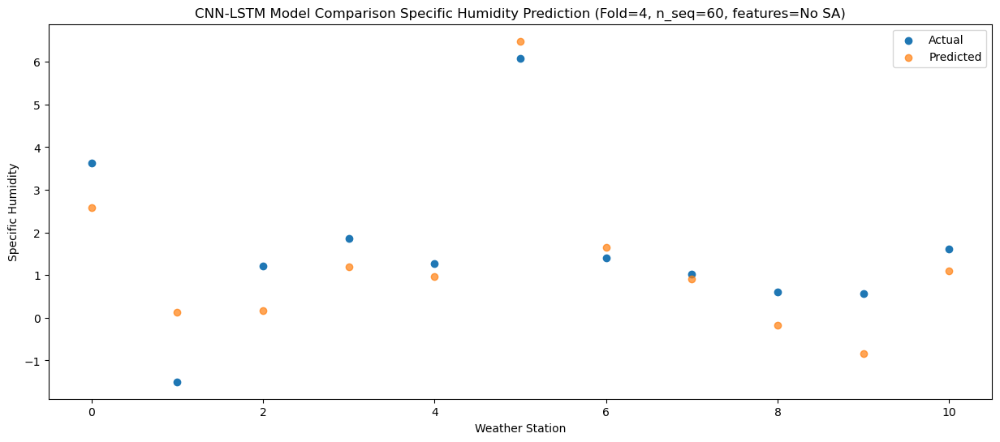

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.83   3.491656
1                 1   -0.75   0.836979
2                 2    1.47   0.807949
3                 3    3.15   1.942201
4                 4    2.64   1.740343
5                 5    7.04   7.229532
6                 6    1.81   2.514674
7                 7    1.95   1.736955
8                 8    1.94   0.932388
9                 9    1.87   0.175811
10               10    3.28   2.287654


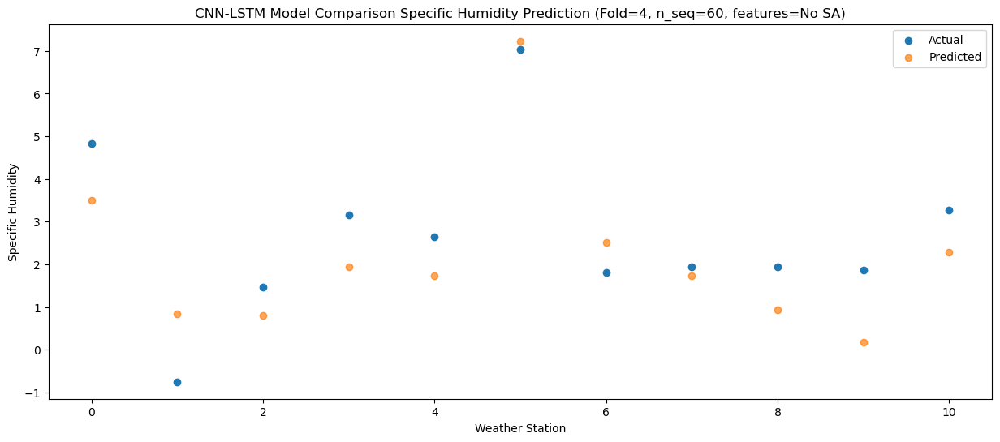

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.39   6.559488
1                 1    0.58   3.391975
2                 2    4.91   4.185411
3                 3    7.15   5.446194
4                 4    6.93   5.167339
5                 5   11.59  10.005963
6                 6    4.79   5.119184
7                 7    5.11   4.957713
8                 8    4.23   3.248167
9                 9    4.49   2.829657
10               10    4.88   4.249715


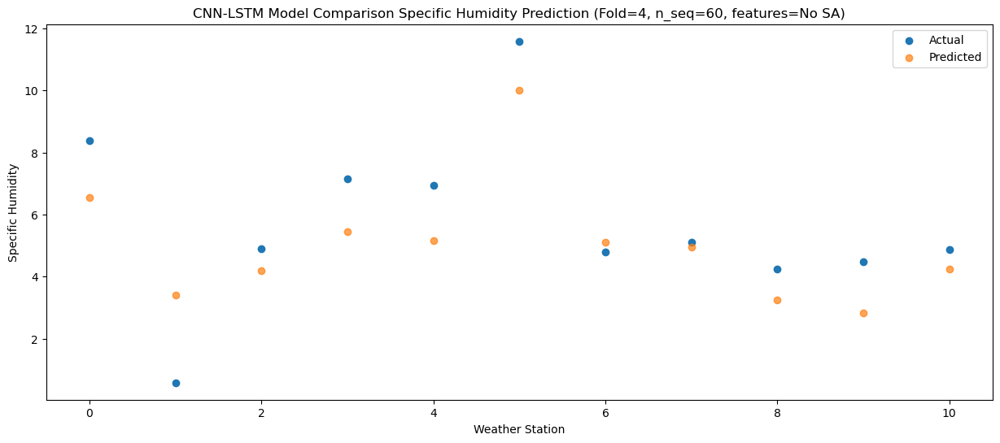

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.98  11.160871
1                 1    4.87   8.161871
2                 2    9.15   9.086990
3                 3   10.84   9.954392
4                 4   10.81   9.586591
5                 5   13.89  13.781829
6                 6    9.48  10.282308
7                 7    9.71   9.727292
8                 8    9.29   8.371488
9                 9    9.24   7.743733
10               10    9.89   9.503427


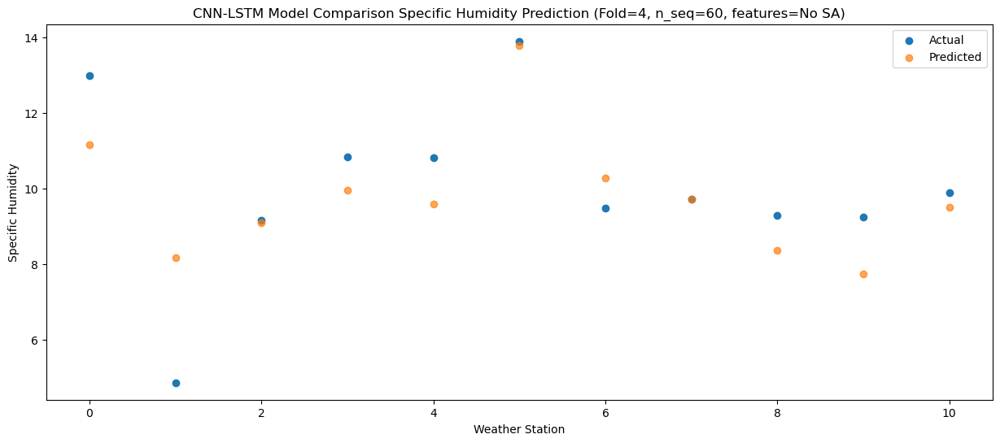

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   14.37  12.680266
1                 1    6.08   9.584222
2                 2   10.80  10.501001
3                 3   11.41  11.390759
4                 4   11.19  11.027077
5                 5   14.92  15.158418
6                 6   11.08  11.804815
7                 7   10.66  11.212755
8                 8   10.55   9.989832
9                 9   10.64   9.319829
10               10   11.16  11.165797


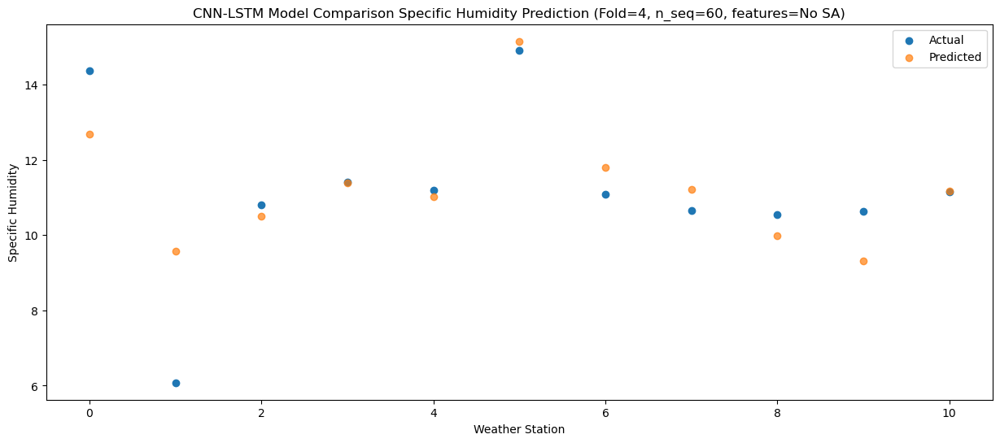

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   14.19  12.299043
1                 1    6.47   9.440018
2                 2   10.81  10.156593
3                 3   11.80  10.831929
4                 4   11.30  10.453303
5                 5   14.64  14.496797
6                 6   11.46  11.822687
7                 7   10.40  10.862548
8                 8   10.69  10.088453
9                 9   10.89   9.215990
10               10   12.03  11.437150


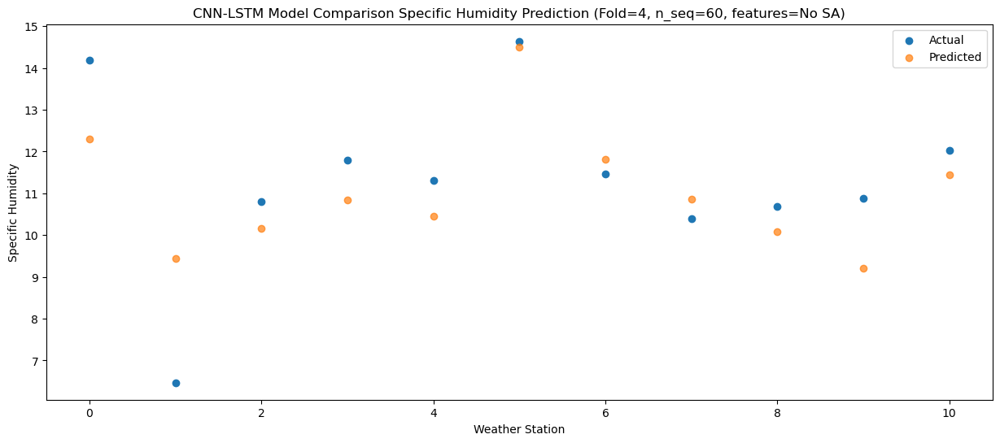

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.61   8.674184
1                 1    5.67   6.380024
2                 2    7.87   6.573632
3                 3    7.79   7.167780
4                 4    7.40   6.845026
5                 5   11.39  11.602123
6                 6    7.88   8.365123
7                 7    7.14   7.183021
8                 8    7.21   6.506311
9                 9    6.86   5.603401
10               10    8.27   7.920171


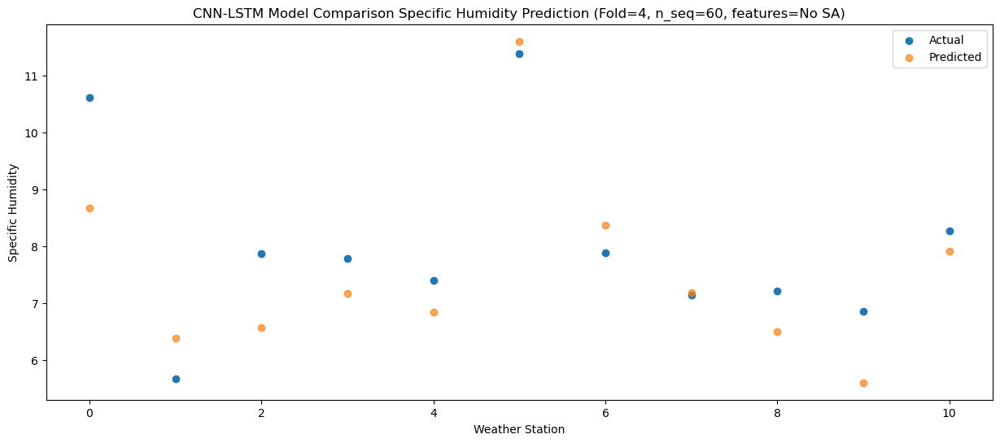

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.24   6.813854
1                 1    2.75   4.478784
2                 2    5.09   4.431203
3                 3    4.94   5.120035
4                 4    4.67   4.841571
5                 5    8.34   9.812559
6                 6    5.67   6.486062
7                 7    5.05   5.207045
8                 8    6.06   4.841441
9                 9    4.99   3.848005
10               10    7.26   6.366867


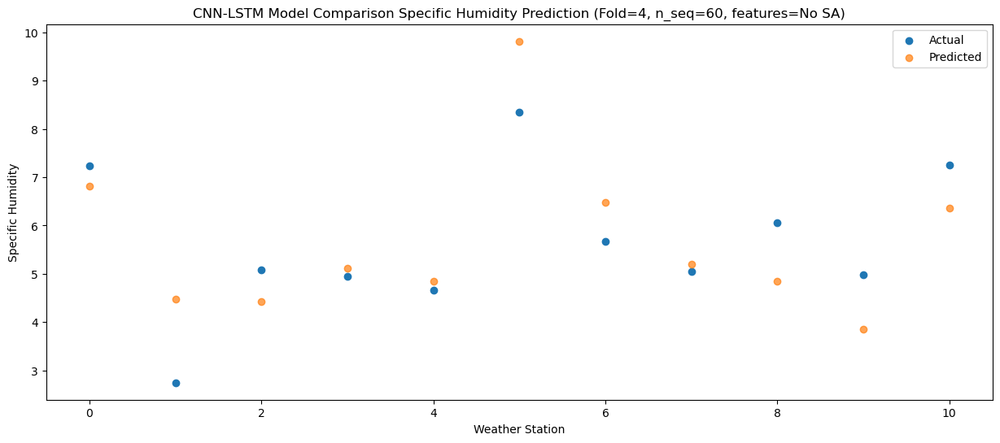

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    3.15   1.874920
1                 1   -1.91  -0.904210
2                 2   -0.35  -1.538046
3                 3    1.32   0.025391
4                 4    1.06  -0.027678
5                 5    6.62   6.346300
6                 6   -0.05   0.498524
7                 7    0.36  -0.218492
8                 8    0.29  -0.683093
9                 9   -0.30  -1.460465
10               10    2.02   0.788135


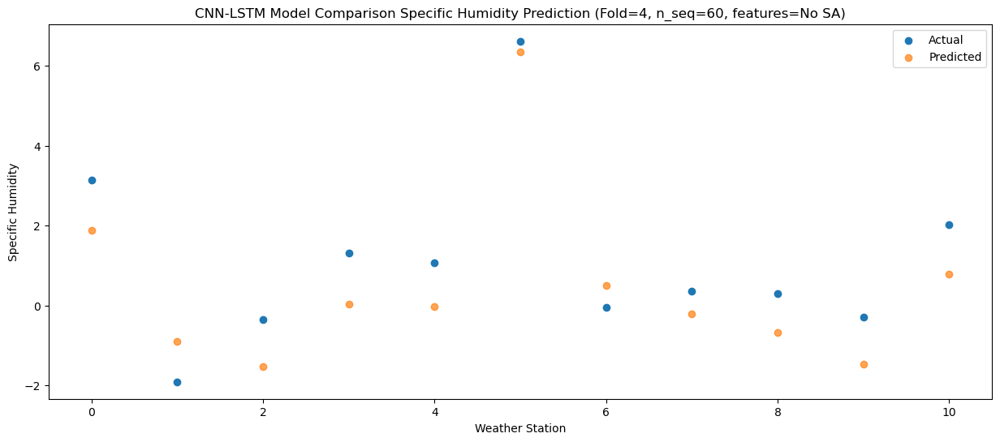

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.94   2.724292
1                 1   -0.17   0.660931
2                 2    2.60   0.655130
3                 3    3.18   1.417752
4                 4    2.47   1.156750
5                 5    5.77   6.614699
6                 6    1.81   2.088311
7                 7    1.83   1.166886
8                 8    1.00  -0.005341
9                 9    0.24  -0.677521
10               10    1.98   1.237086


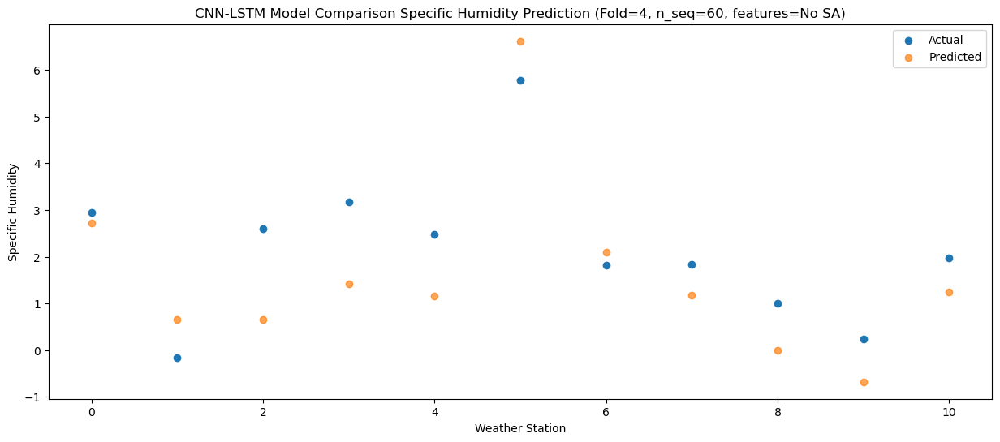

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0    0.93  -0.215188
1                 1   -4.03  -2.719045
2                 2   -2.13  -3.644634
3                 3   -1.48  -2.171297
4                 4   -1.86  -2.201214
5                 5    4.31   4.437692
6                 6   -1.17  -1.412479
7                 7   -1.37  -2.352777
8                 8   -1.38  -2.621976
9                 9   -2.00  -3.470644
10               10    0.24  -1.064279


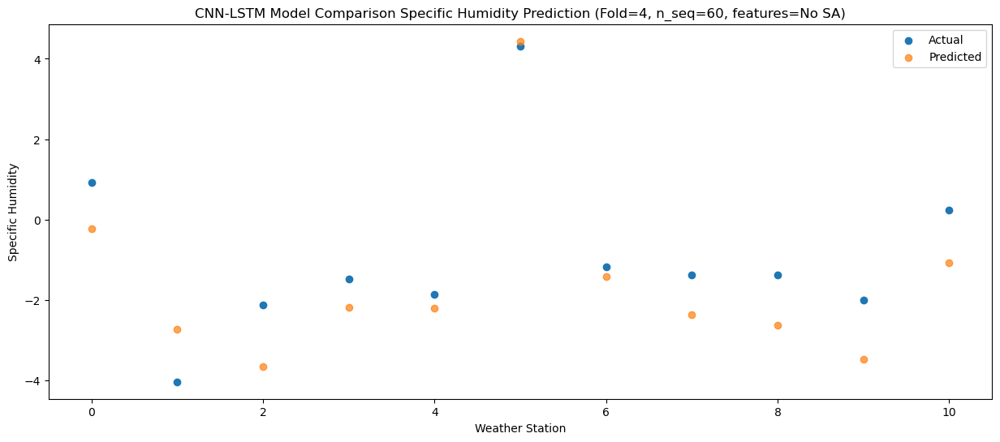

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    1.15   0.464584
1                 1   -2.45  -1.620064
2                 2   -1.28  -2.486574
3                 3   -0.95  -1.437502
4                 4   -1.42  -1.547238
5                 5    4.30   4.757572
6                 6    0.15  -0.198891
7                 7   -0.86  -1.476854
8                 8   -0.80  -1.666599
9                 9   -1.30  -2.622353
10               10    0.69  -0.061283


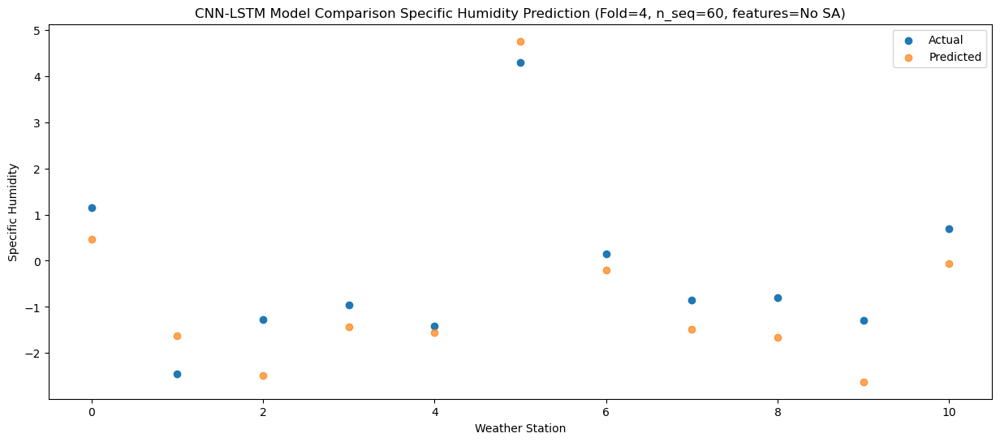

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    2.71   1.722666
1                 1   -0.92  -0.479629
2                 2   -0.23  -1.253219
3                 3    0.64  -0.118536
4                 4    0.10  -0.226000
5                 5    4.89   6.051848
6                 6    0.99   0.911609
7                 7    0.65  -0.221180
8                 8    0.51  -0.551238
9                 9    0.22  -1.444120
10               10    1.84   0.994306


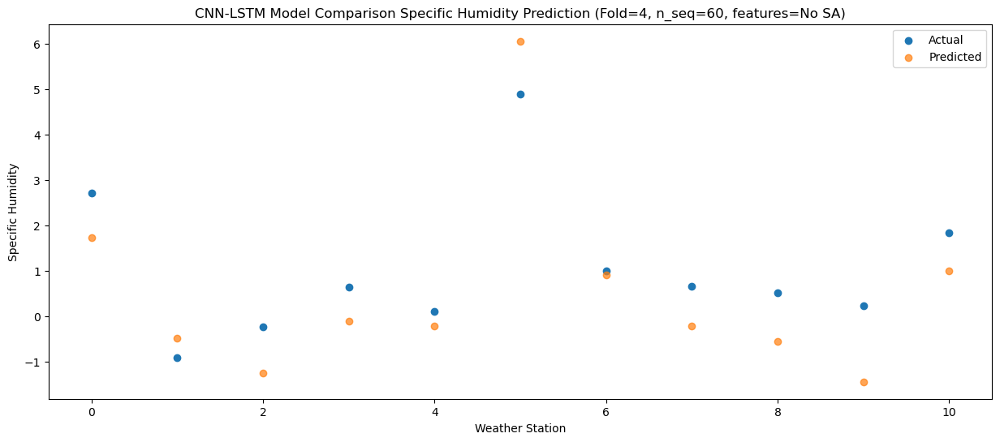

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.20   3.831602
1                 1    0.37   1.184249
2                 2    2.22   1.262217
3                 3    4.15   2.398336
4                 4    3.78   2.186736
5                 5    6.92   7.619762
6                 6    2.05   2.754288
7                 7    2.44   2.102050
8                 8    2.00   1.000676
9                 9    1.52   0.368021
10               10    2.83   2.242751


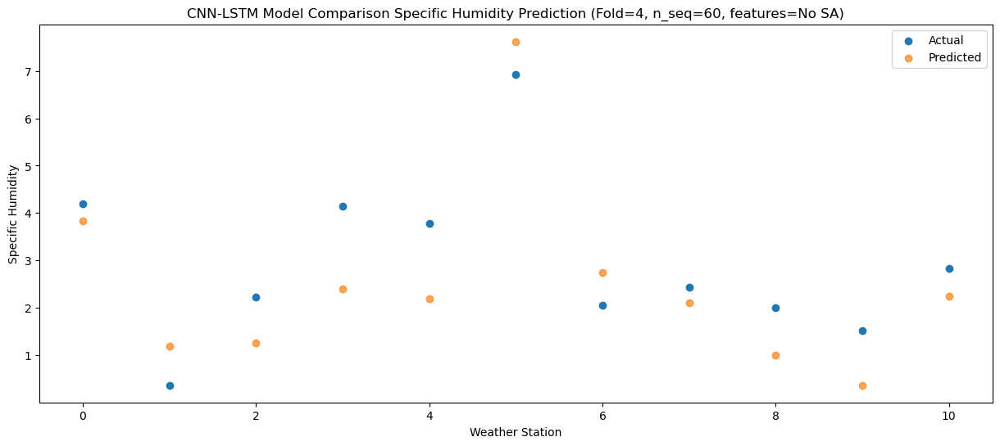

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    9.08   7.916469
1                 1    2.76   5.237712
2                 2    6.82   5.890973
3                 3    8.14   6.663368
4                 4    7.66   6.316771
5                 5    9.18  10.777518
6                 6    6.06   7.199194
7                 7    7.15   6.467914
8                 8    6.02   5.195842
9                 9    5.59   4.541179
10               10    6.29   6.371927


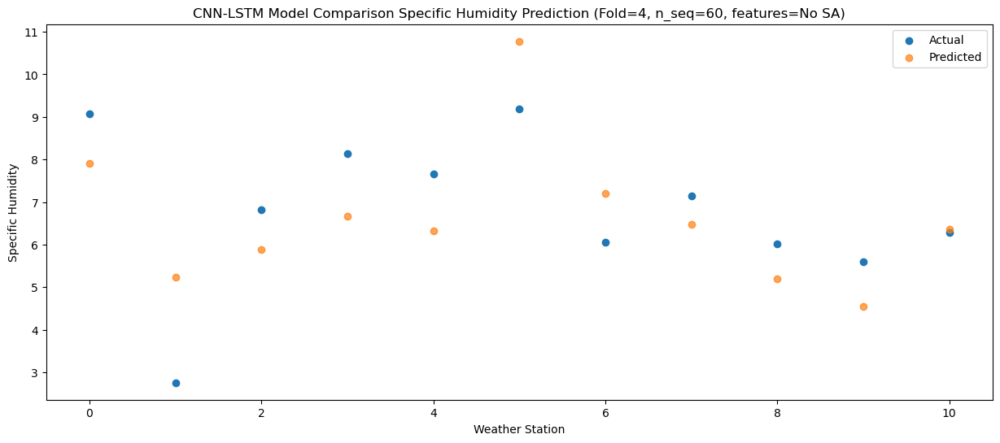

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   12.31  10.166043
1                 1    5.66   7.160661
2                 2    9.20   8.087695
3                 3    9.91   9.068968
4                 4    9.34   8.727666
5                 5   12.03  13.132444
6                 6    8.34   9.053215
7                 7    9.51   8.688440
8                 8    7.46   6.992952
9                 9    7.83   6.531714
10               10    8.20   8.002946


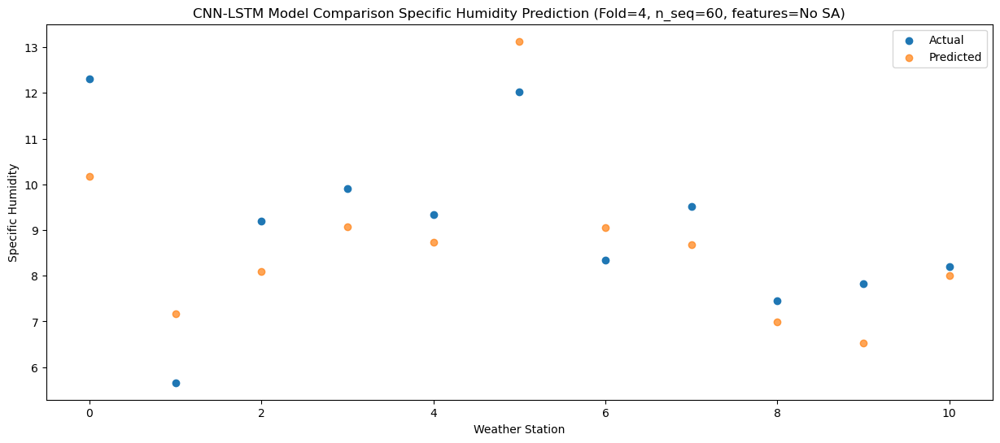

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.94  11.962478
1                 1    6.69   9.286386
2                 2   11.04   9.836698
3                 3    9.33  10.567020
4                 4    8.84  10.225021
5                 5   12.72  14.648502
6                 6   11.50  11.367139
7                 7   10.31  10.473700
8                 8   10.20   9.460819
9                 9   10.47   8.709617
10               10    9.93  10.732943


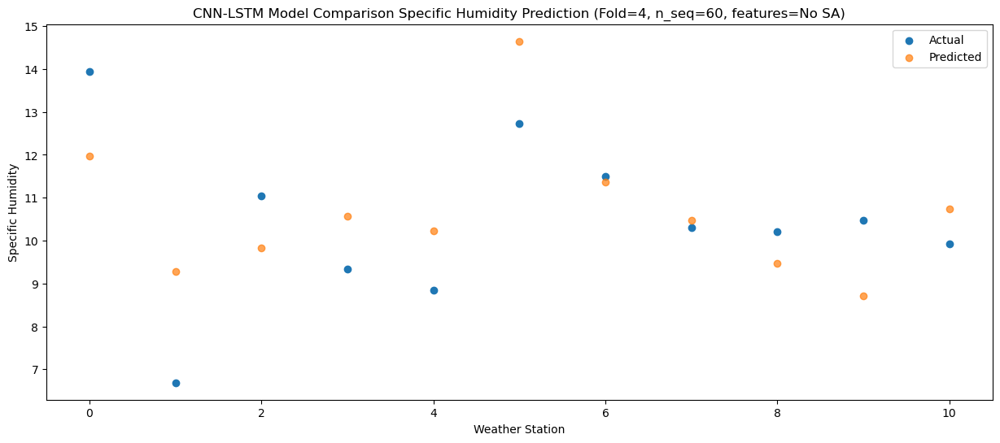

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.73  11.874248
1                 1    6.77   8.770508
2                 2   10.86   9.349151
3                 3   10.34  10.410808
4                 4   10.01  10.120235
5                 5   14.71  14.663258
6                 6   10.31  10.871461
7                 7   10.78  10.238057
8                 8    9.84   9.213248
9                 9    9.70   8.525102
10               10   10.39  10.463926


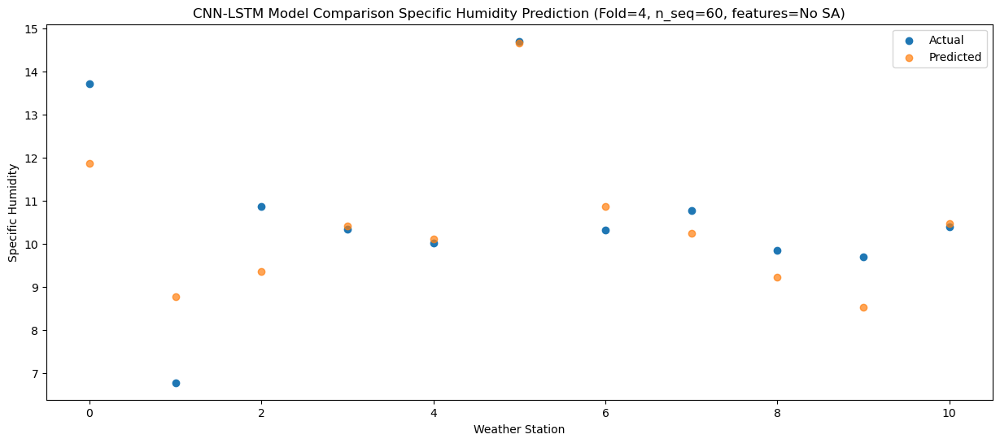

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    9.03   8.351428
1                 1    5.90   5.600356
2                 2    6.62   5.502000
3                 3    7.06   6.643055
4                 4    6.86   6.449736
5                 5   13.46  11.791076
6                 6    6.76   7.414999
7                 7    6.97   6.529341
8                 8    7.18   5.923868
9                 9    6.33   5.116698
10               10    8.40   7.341675


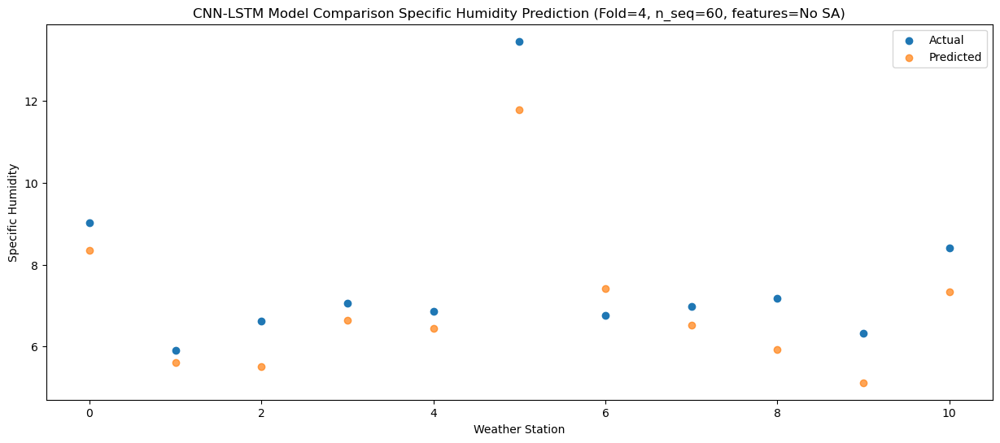

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    4.44   3.418692
1                 1    1.12   0.734754
2                 2    1.66  -0.076563
3                 3    2.60   1.448989
4                 4    2.40   1.410086
5                 5    9.95   7.835263
6                 6    2.08   2.166379
7                 7    2.31   1.283178
8                 8    1.85   1.018544
9                 9    1.57   0.175016
10               10    3.58   2.566392


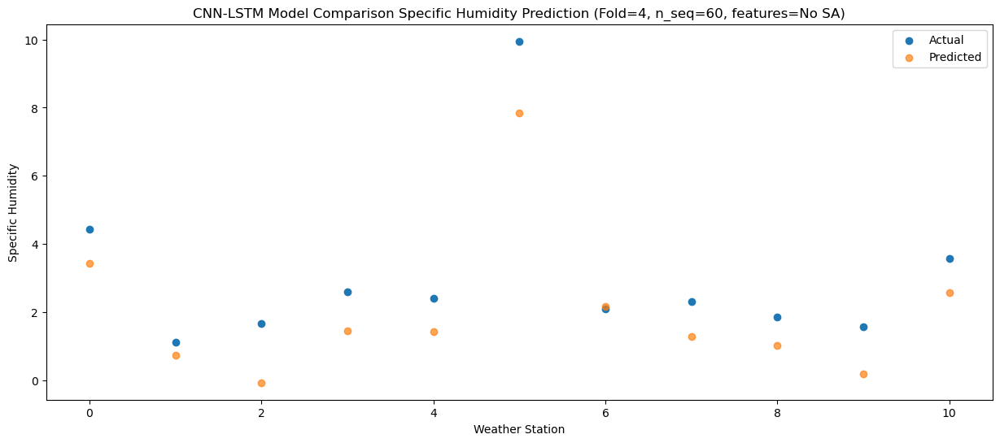

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.27   2.554069
1                 1    1.29   0.136825
2                 2    0.91  -0.304197
3                 3    2.42   0.781956
4                 4    1.98   0.621370
5                 5    7.25   6.369605
6                 6    1.90   1.769346
7                 7    0.95   0.707421
8                 8    0.81   0.276546
9                 9    0.20  -0.598641
10               10    2.86   1.773705


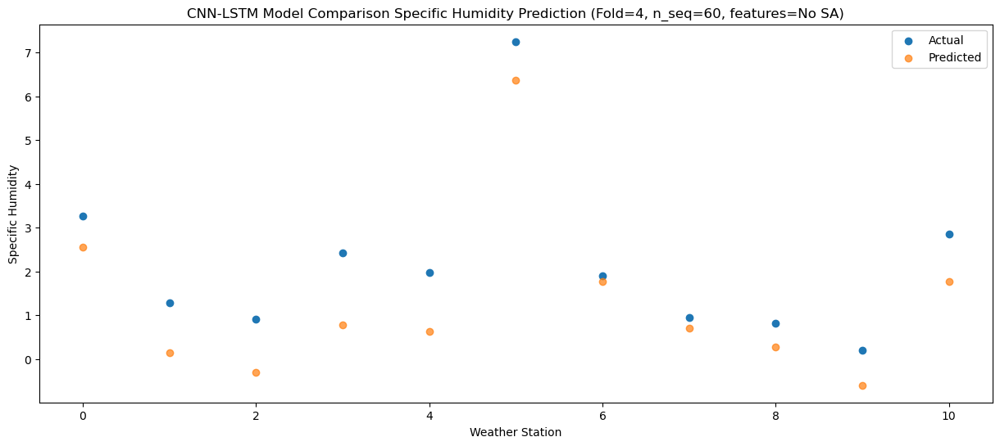

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.93   1.491803
1                 1   -2.23  -1.212132
2                 2    0.37  -1.590373
3                 3    0.84  -0.146933
4                 4    0.39  -0.249750
5                 5    6.61   5.851450
6                 6   -0.09   0.157254
7                 7    0.08  -0.470980
8                 8   -0.15  -1.324713
9                 9   -0.91  -1.976897
10               10    1.41   0.007897


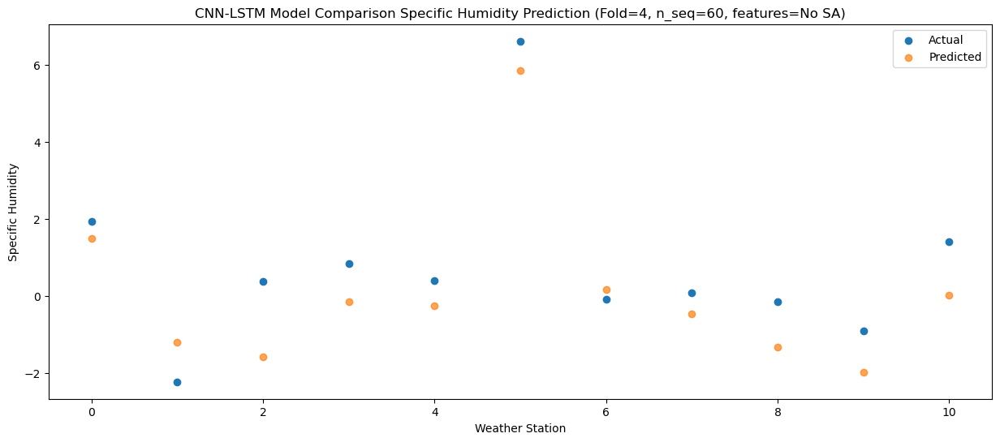

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    2.28   1.652281
1                 1   -2.74  -0.965152
2                 2    0.27  -1.571503
3                 3    0.15  -0.160001
4                 4   -0.36  -0.241463
5                 5    5.06   5.966925
6                 6    0.54   0.469962
7                 7    0.36  -0.365309
8                 8    0.47  -0.876567
9                 9   -0.39  -1.655083
10               10    2.03   0.584176


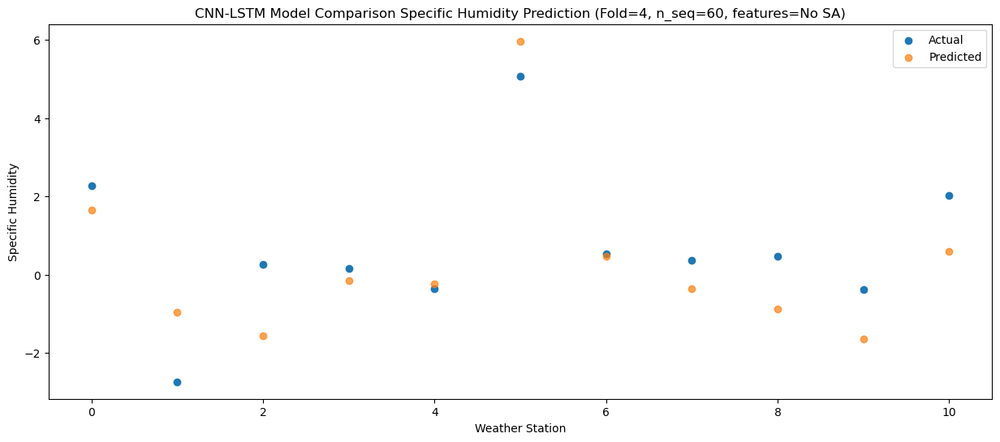

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.23   1.859176
1                 1   -0.80  -0.419065
2                 2    0.94  -0.721065
3                 3    0.51   0.342163
4                 4    0.04   0.170732
5                 5    5.18   6.039148
6                 6    1.58   0.953312
7                 7    0.17   0.079593
8                 8    0.07  -0.881839
9                 9   -0.62  -1.556236
10               10    1.28   0.430660


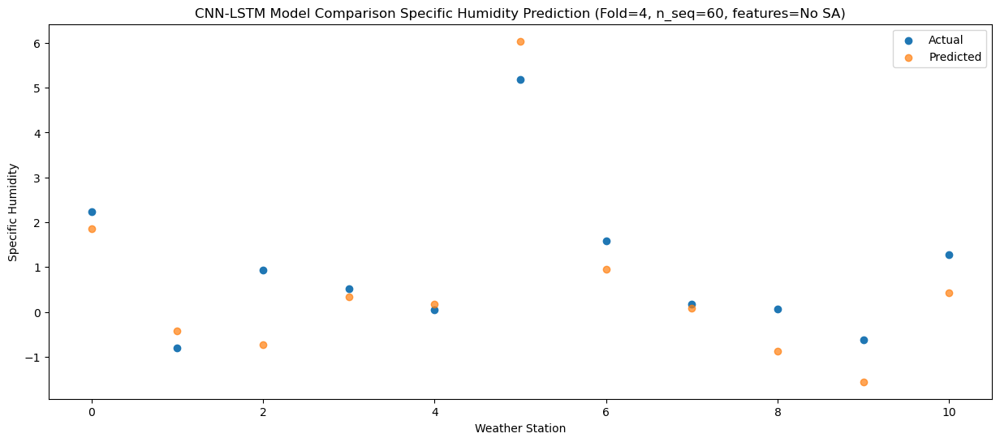

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.07   2.323088
1                 1   -0.42  -0.402193
2                 2    1.27  -0.543770
3                 3    2.57   0.868174
4                 4    2.01   0.737288
5                 5    6.47   6.698663
6                 6    1.07   0.910745
7                 7    0.93   0.433773
8                 8    0.42  -0.795209
9                 9   -0.01  -1.311103
10               10    1.49   0.404117


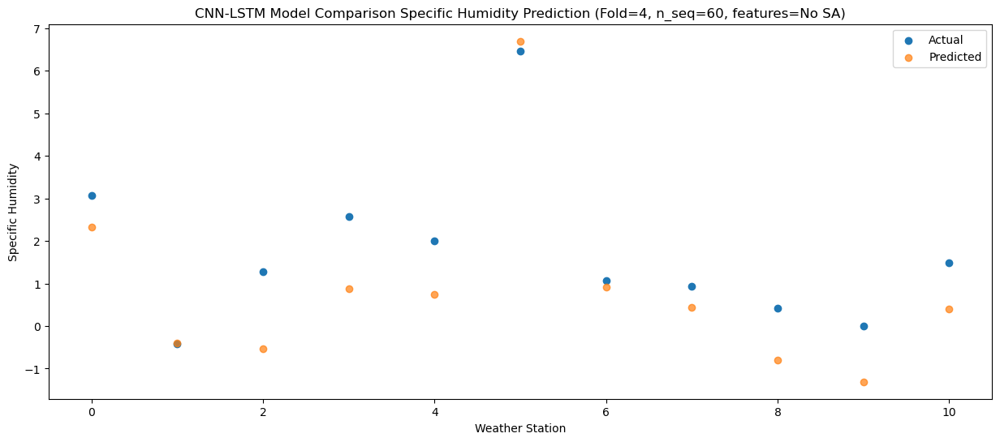

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    4.25   3.373253
1                 1    1.07   0.932375
2                 2    2.11   0.541943
3                 3    3.25   1.707249
4                 4    2.86   1.561246
5                 5    6.44   7.449222
6                 6    2.67   2.421485
7                 7    1.83   1.512657
8                 8    1.87   0.805970
9                 9    1.50   0.056295
10               10    3.19   2.207969


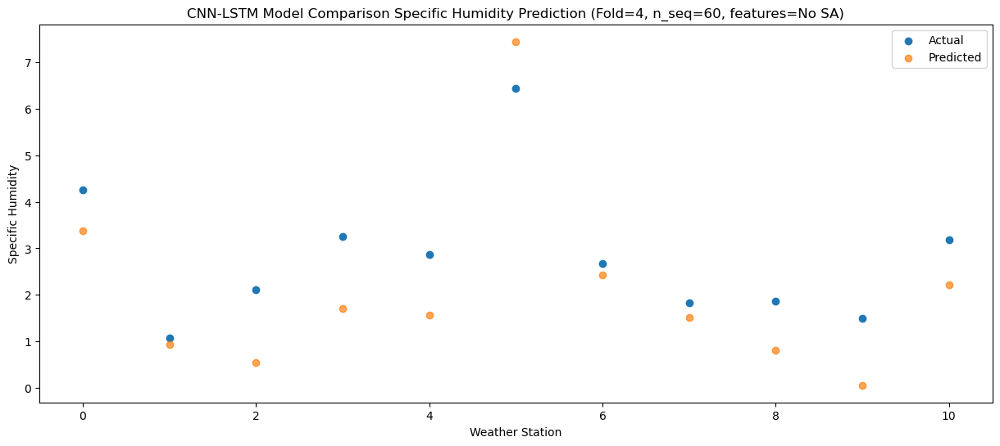

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    8.27   6.636929
1                 1    1.87   3.183197
2                 2    5.49   3.860786
3                 3    7.51   5.586717
4                 4    7.13   5.411299
5                 5   11.28  10.822425
6                 6    4.89   4.517764
7                 7    6.22   4.806448
8                 8    4.12   2.635949
9                 9    4.28   2.507727
10               10    4.09   3.462326


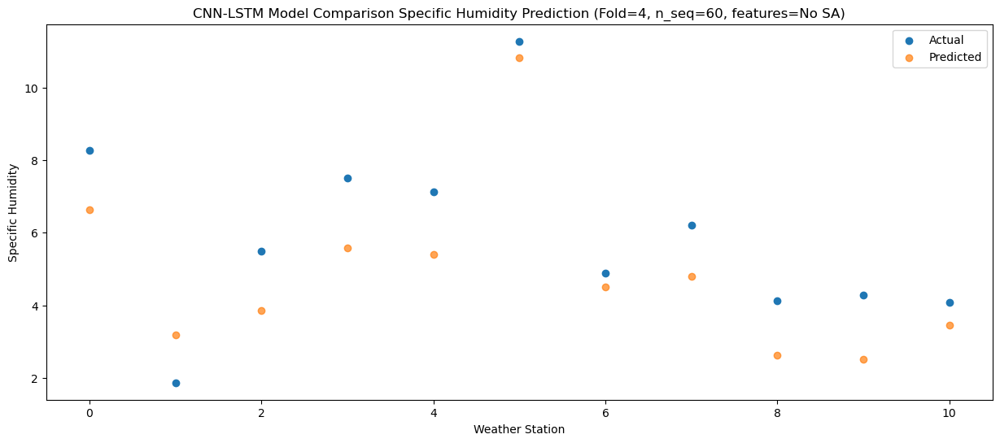

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   10.81   9.691033
1                 1    5.38   6.143811
2                 2    9.06   7.077581
3                 3   11.45   8.574546
4                 4   10.61   8.325236
5                 5   15.14  13.067319
6                 6    7.94   7.878669
7                 7    8.78   7.972113
8                 8    6.08   6.009621
9                 9    5.92   5.756872
10               10    7.33   6.905550


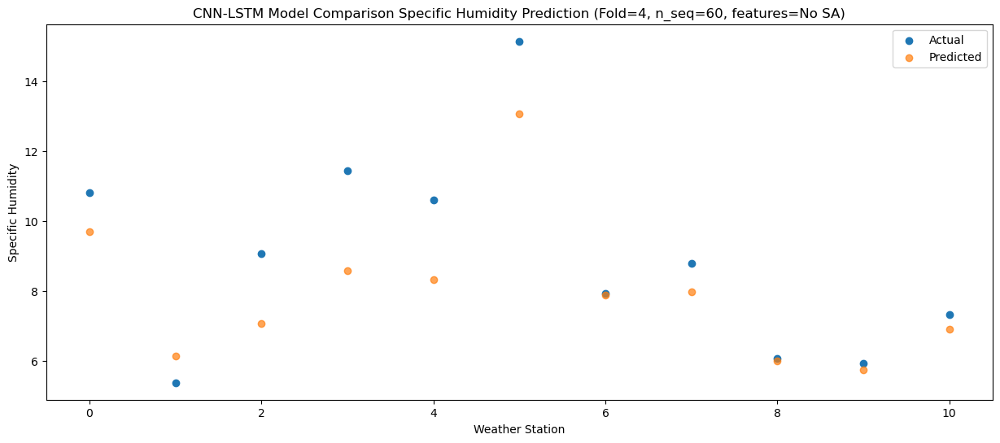

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   13.50  12.070660
1                 1    7.29   8.956472
2                 2   10.65   9.558642
3                 3   11.30  10.587304
4                 4    9.71  10.291014
5                 5   12.81  14.719838
6                 6   11.33  11.119808
7                 7   11.57  10.445441
8                 8   10.38   9.434136
9                 9   10.62   8.744341
10               10   10.95  10.690343


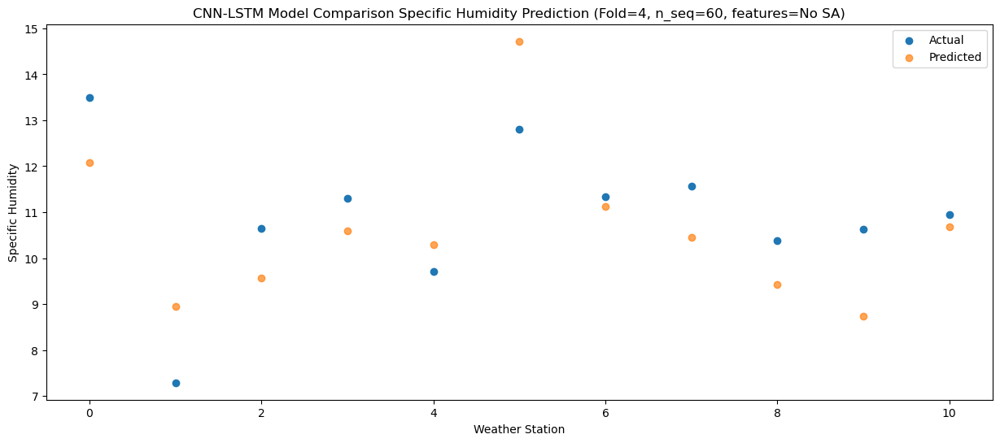

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   14.43  11.283546
1                 1    7.59   8.364294
2                 2    9.07   8.855659
3                 3    9.20   9.964286
4                 4    8.33   9.702112
5                 5   11.95  14.596798
6                 6   10.87  10.129472
7                 7   11.85   9.630031
8                 8    9.84   8.228305
9                 9   10.49   7.710058
10               10   10.15   9.349789


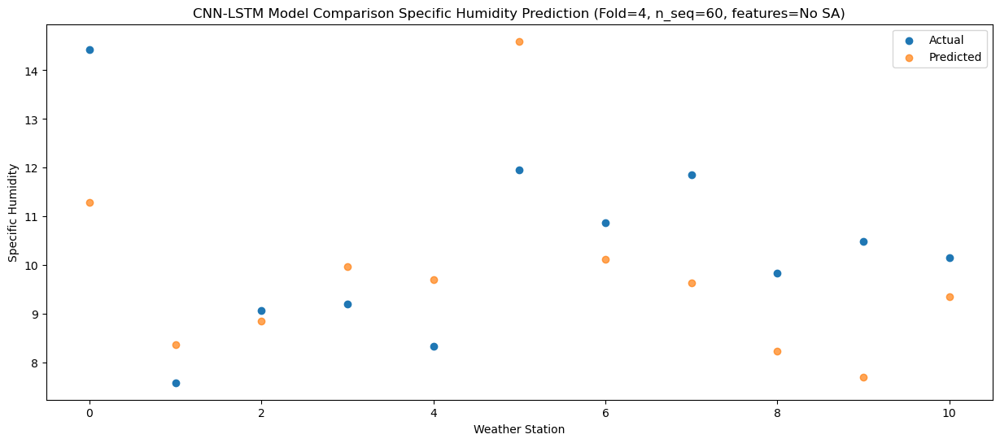

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    9.51   8.791927
1                 1    5.14   5.769244
2                 2    6.05   5.763393
3                 3    8.30   7.112199
4                 4    8.00   6.949309
5                 5   12.46  12.356087
6                 6    7.42   7.541538
7                 7    7.65   6.894635
8                 8    7.04   6.085007
9                 9    6.71   5.403340
10               10    8.44   7.417227


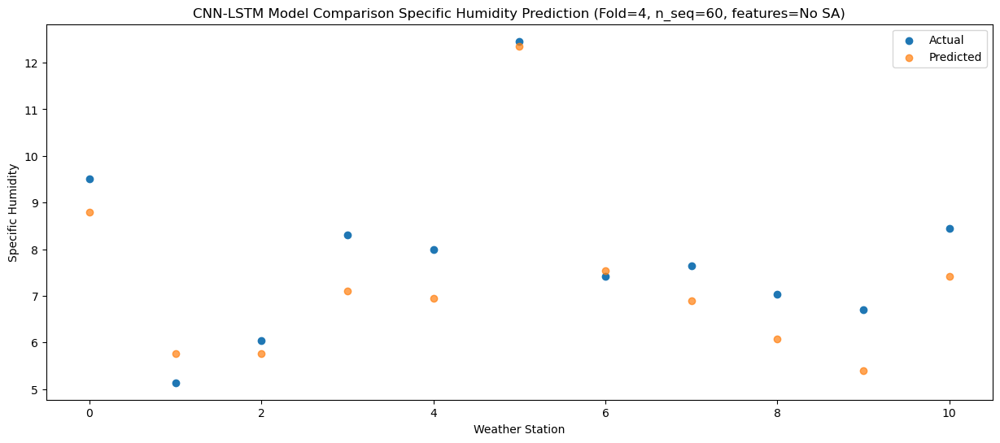

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.32   4.714069
1                 1    1.52   1.589338
2                 2    2.12   1.062103
3                 3    4.58   2.769560
4                 4    4.34   2.732408
5                 5   10.33   8.922004
6                 6    3.51   3.158351
7                 7    4.04   2.533486
8                 8    3.71   2.067903
9                 9    3.27   1.340660
10               10    5.38   3.524249


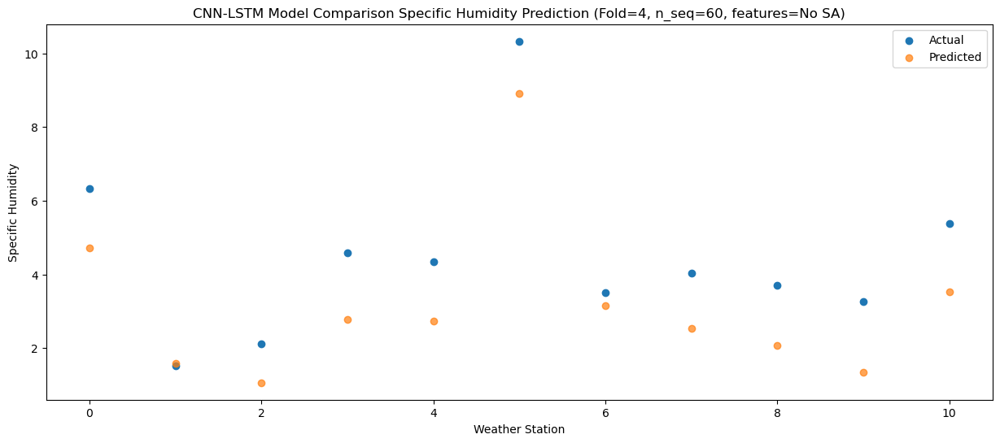

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    3.42   1.856404
1                 1   -0.78  -1.179850
2                 2    0.14  -1.780434
3                 3    2.05   0.030611
4                 4    1.92   0.025071
5                 5    8.03   6.562893
6                 6    0.56   0.102699
7                 7    1.01  -0.356311
8                 8    0.64  -1.110725
9                 9   -0.12  -1.705094
10               10    1.94   0.242755


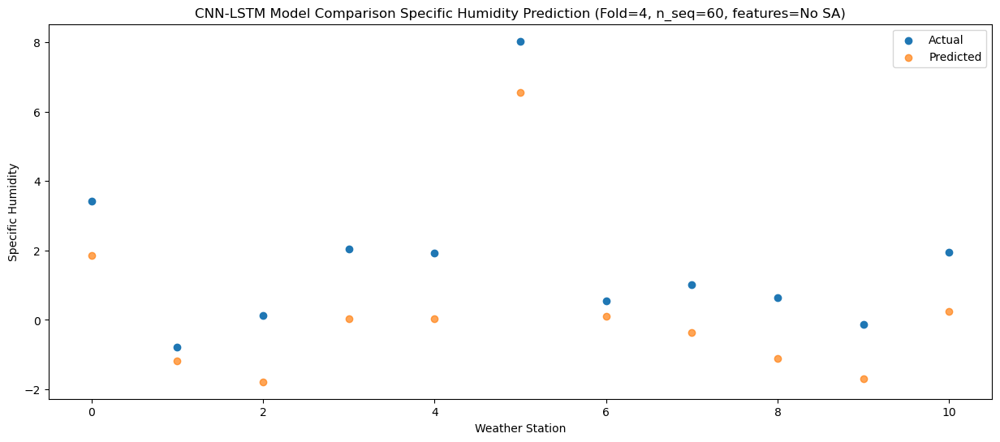

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    3.24   0.945403
1                 1   -1.87  -2.058800
2                 2   -1.17  -3.217160
3                 3    0.30  -1.285881
4                 4    0.16  -1.206665
5                 5    6.45   5.776330
6                 6    0.28  -0.709051
7                 7    0.20  -1.481078
8                 8    0.61  -1.504753
9                 9    0.37  -2.335409
10               10    2.46   0.119802


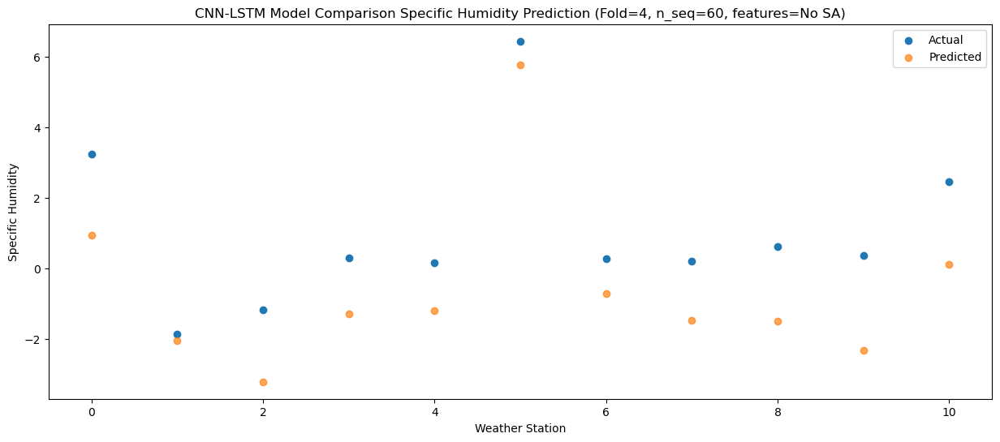

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0    1.54  -0.318017
1                 1   -2.91  -3.098656
2                 2   -1.89  -4.428075
3                 3   -0.98  -2.521523
4                 4   -1.26  -2.423913
5                 5    5.18   4.846715
6                 6   -0.50  -1.935572
7                 7   -0.95  -2.749808
8                 8   -0.47  -2.812637
9                 9   -1.09  -3.627524
10               10    1.39  -1.191550


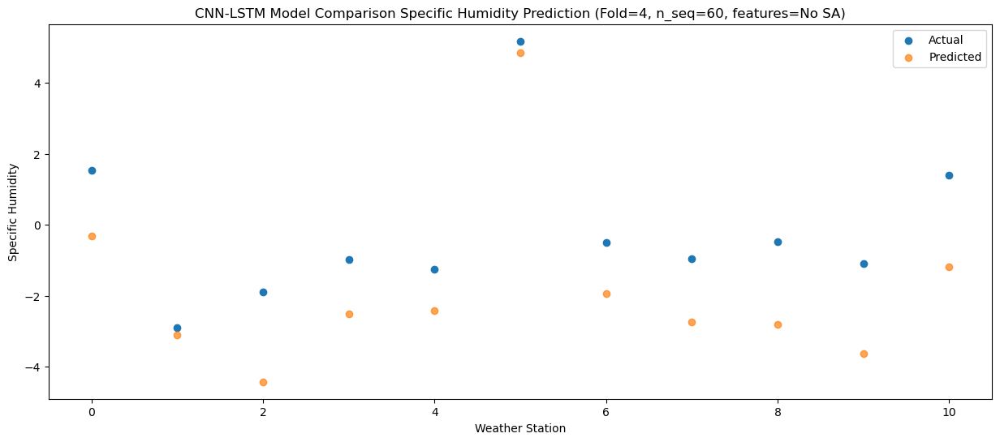

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    2.55   0.965616
1                 1   -3.60  -2.356184
2                 2   -0.46  -3.053906
3                 3    1.36  -0.921451
4                 4    1.09  -0.860282
5                 5    5.53   5.976572
6                 6   -0.32  -1.171428
7                 7    0.41  -1.407874
8                 8    0.11  -2.186122
9                 9   -0.17  -2.709902
10               10    1.41  -0.848700


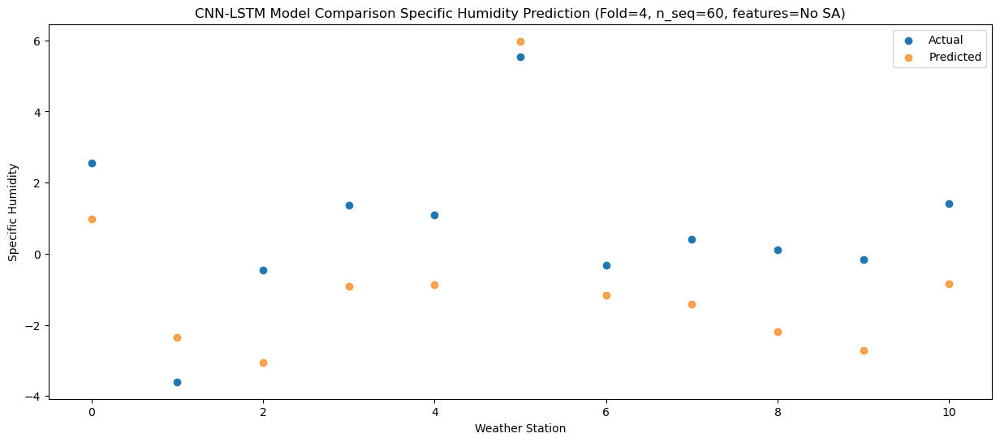

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    3.61   1.821301
1                 1   -0.31  -1.080771
2                 2    1.17  -1.571809
3                 3    3.15   0.105780
4                 4    3.04   0.064685
5                 5    6.67   6.446739
6                 6    1.25   0.188799
7                 7    1.62  -0.293862
8                 8    1.18  -1.201448
9                 9    0.80  -1.765589
10               10    2.48   0.105241


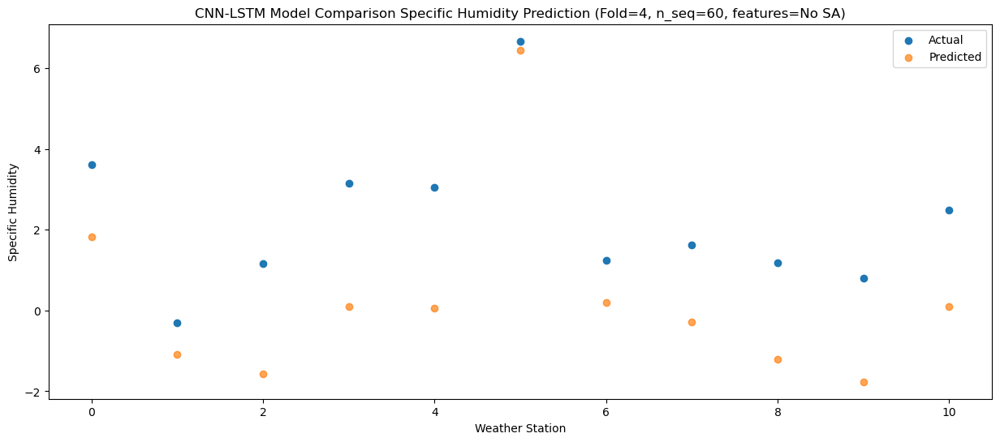

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.29   3.761662
1                 1   -0.91   0.600092
2                 2    3.35   0.611310
3                 3    5.52   2.200668
4                 4    5.54   2.081287
5                 5    7.27   7.793032
6                 6    3.17   2.132099
7                 7    3.35   1.787989
8                 8    3.21   0.624594
9                 9    2.52   0.124528
10               10    4.26   1.828304


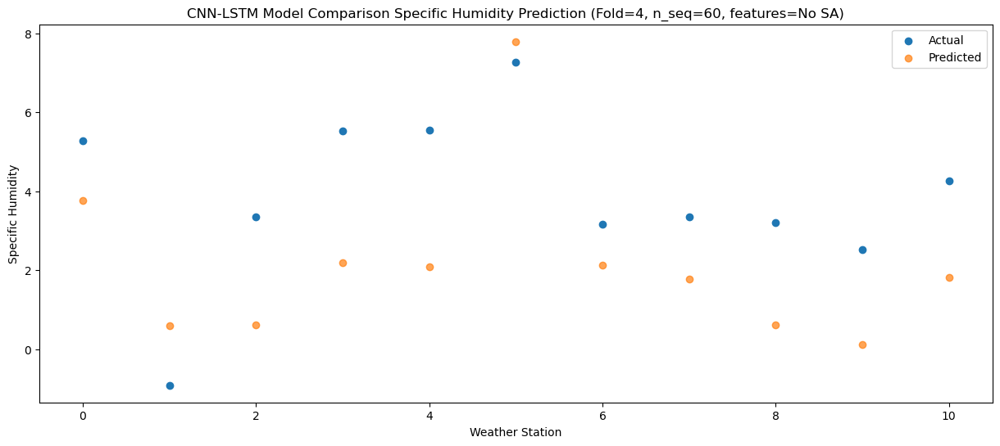

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    9.36   7.568822
1                 1    1.68   4.552740
2                 2    7.67   5.079057
3                 3    9.09   6.258894
4                 4    8.97   6.007133
5                 5   10.03  10.896064
6                 6    7.17   6.321054
7                 7    7.77   5.894987
8                 8    6.70   4.430056
9                 9    6.06   3.954001
10               10    7.18   5.529657


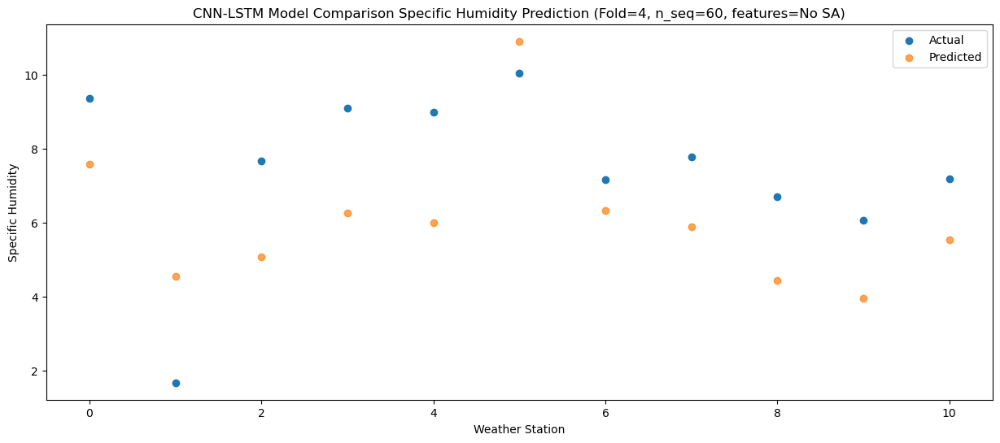

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   12.62  10.107795
1                 1    3.14   6.182870
2                 2    9.01   6.993951
3                 3   11.03   8.731577
4                 4   11.08   8.538380
5                 5   14.56  13.316361
6                 6    8.93   8.108760
7                 7    9.75   8.211883
8                 8    8.39   6.594885
9                 9    8.82   6.272412
10               10    9.73   7.602147


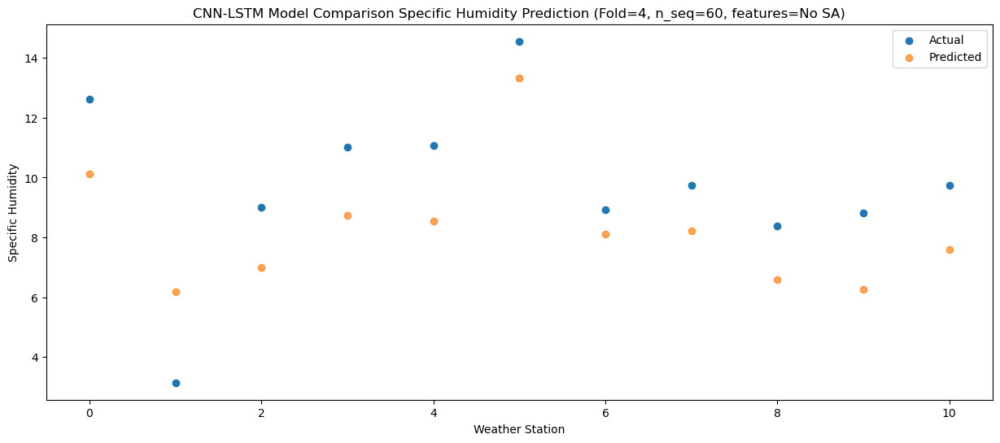

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   13.81  11.005848
1                 1    4.60   8.005890
2                 2   11.04   8.316868
3                 3   10.99   9.418660
4                 4   10.61   9.176553
5                 5   14.44  13.980104
6                 6   11.32  10.020808
7                 7   10.73   9.273092
8                 8    9.69   8.363380
9                 9   10.43   7.673282
10               10   10.85   9.666236


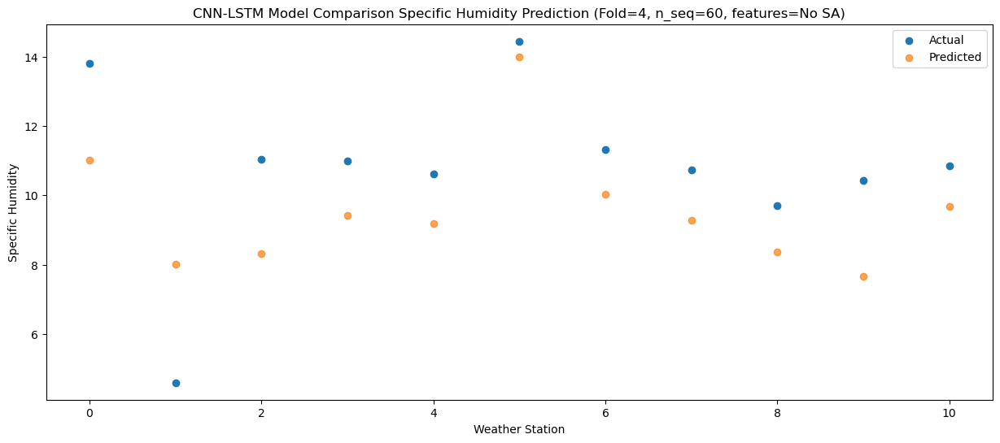

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   12.65  10.780027
1                 1    7.21   7.095996
2                 2    8.73   7.403895
3                 3   10.28   9.094976
4                 4    9.84   8.953773
5                 5   13.24  14.101471
6                 6   10.58   9.036211
7                 7    9.44   8.762866
8                 8    9.33   7.741419
9                 9   10.07   7.205559
10               10   10.83   8.974793


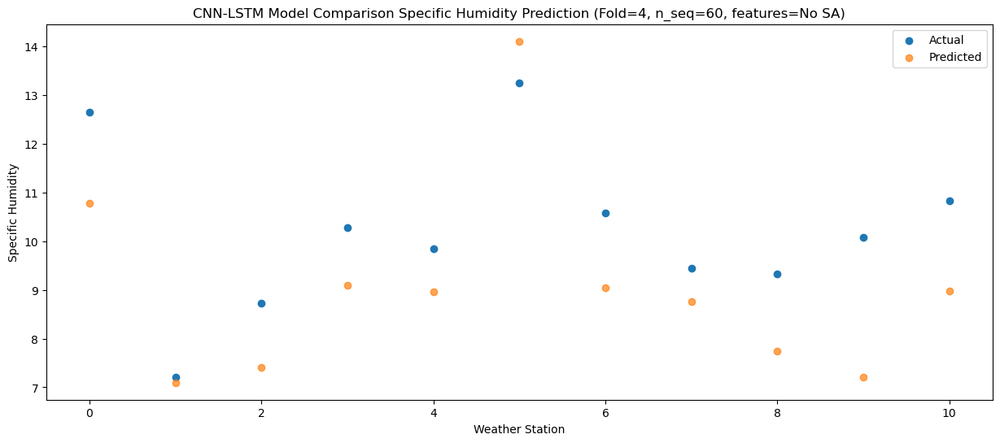

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    9.35   8.010383
1                 1    7.02   5.244979
2                 2    7.63   5.161353
3                 3    7.75   6.395391
4                 4    7.68   6.228888
5                 5   12.36  11.725395
6                 6    8.26   6.871683
7                 7    7.40   6.145774
8                 8    6.65   5.181396
9                 9    6.57   4.556814
10               10    8.76   6.470408


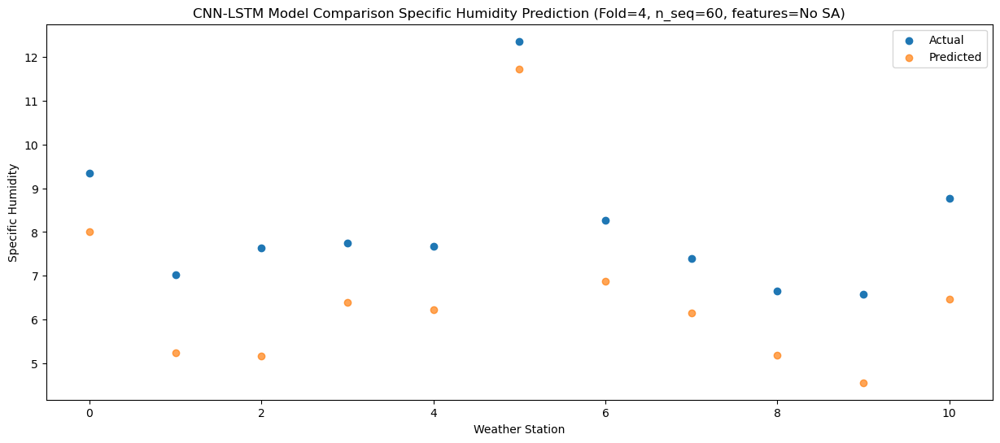

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    5.22   3.272181
1                 1    2.60   0.341285
2                 2    2.84  -0.287351
3                 3    4.29   1.390877
4                 4    3.94   1.366943
5                 5    8.67   7.724446
6                 6    3.86   1.713932
7                 7    3.08   1.084773
8                 8    3.07   0.427881
9                 9    2.47  -0.212791
10               10    4.65   1.825443


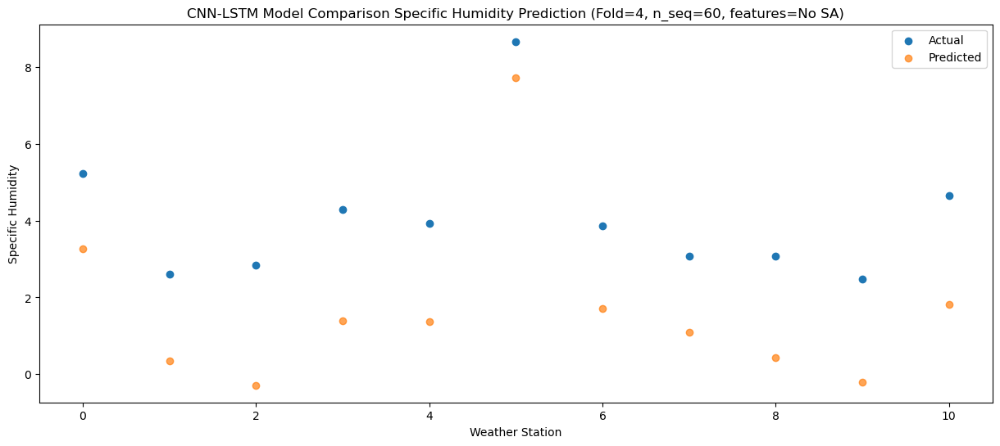

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_4 (Conv1D)           (None, 1, 1024)           1859584   
                                                                 
 max_pooling1d_4 (MaxPooling  (None, 1, 1024)          0         
 1D)                                                             
                                                                 
 dropout_12 (Dropout)        (None, 1, 1024)           0         
                                                                 
 lstm_8 (LSTM)               (None, 1, 512)            3147776   
                                                                 
 dropout_13 (Dropout)        (None, 1, 512)            0         
                                                                 
 lstm_9 (LSTM)               (None, 512)               2099200   
                                                      

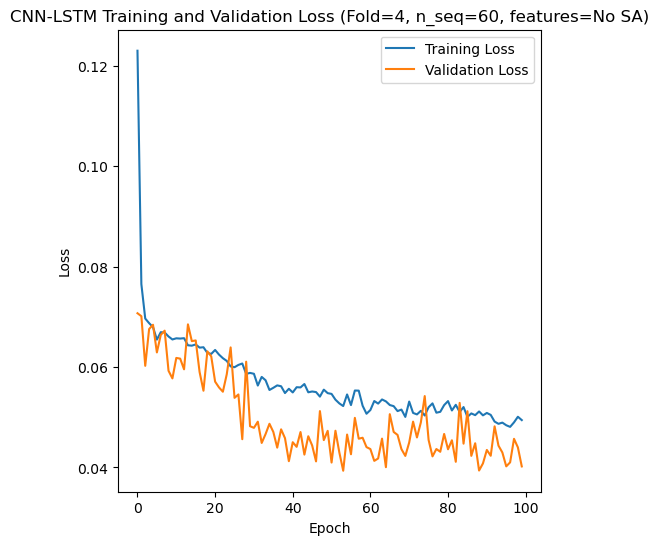

[[1.1824715482186134, 1.0711231259419476, 0.7282812490847065, 0.748954172546088, 0.9740183434915995, 0.9077577008146519, 0.9431362370553741, 0.8206874218091221, 1.486361524631853, 1.5509349533258296, 1.780677868408885, 0.9586284666609581, 0.4395036178797102, 0.5923489338650636, 0.6072328256924202, 0.4917901967801348, 1.0432361152200453, 1.2328162878447295, 1.3651173576904063, 2.052946509486936, 1.66083078907574, 1.7239133532119733, 1.2694143948105363, 1.3454840667117989, 0.7315626527812807, 1.582973885120909, 0.6335909575228419, 0.6374632706050404, 0.7668397162680776, 1.3307148269712479, 1.9539540550678884, 1.7367690631865633, 2.054626206126497, 1.9504017823775406, 1.3660082855534144, 0.7010490735264814, 1.0371395061514335, 1.2996846505588977, 1.2164692592770574, 1.4081952617290907, 1.6963181562154646, 1.7121817084662976, 1.8141114391151236, 2.5559003841941403, 2.3765819720716443, 2.175002283318773, 2.5491132247642354, 1.8396435788350025, 1.5008985476470307, 1.3109174524377816, 1.22889

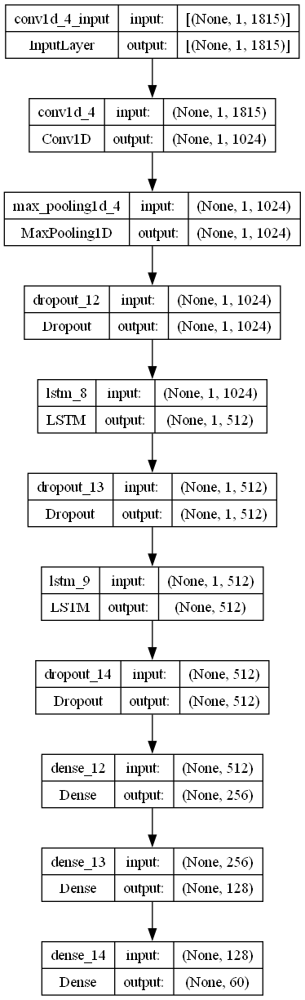

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    filters = 1024
    lr = 0.29999887991116414
    optimizer = SGD(learning_rate = lr)
    activation_function = 'tanh'
    lstm_units = 512
    dropout_rate = 0.36944959061462074

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with a CNN-LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_cnnlstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_cnnlstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # Create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Specific Humidity")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (specific humidity)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction

    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse_avg_list.append(rmse_list)
    mae_avg_list.append(mae_list)
    mape_avg_list.append(mape_list)
    r2_score_avg_list.append(r2_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        
        plot_forecasts(series_ws, forecasts_ws, n_test, n_seq, n_lag)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)
            
        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='CNN-LSTM Model Comparison Specific Humidity Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No SA)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Specific Humidity')
        plt.legend()
        plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'CNN-LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No SA)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse_avg_list)
print(mae_avg_list)
print(mape_avg_list)
print(r2_score_avg_list)
print(forecast_results)
print(actual_results)
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse_avg_list)
print("Average RMSE:"+str(np.mean(rmse_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "cnnlstm_model_optimized_SH_S60_No_SA.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)

In [3]:
print(np.mean(mape_avg_list))

2160035902521.8955


In [4]:
print(np.mean(mape_avg_list[0]))

0.9801592915404665


In [5]:
print(np.mean(mape_avg_list[1]))

7247649801842.889


In [6]:
print(np.mean(mape_avg_list[2]))

1.204935292920127


In [7]:
print(np.mean(mape_avg_list[3]))

3552529710763.3257


In [8]:
print(np.mean(mape_avg_list[4]))

1.0784179412819384


In [9]:
print(mape_avg_list[1])

[0.35323190359247375, 0.6287790294834074, 229199883926503.7, 13.489548175971725, 0.5372791372600753, 1.5615008047067347, 0.2437175809648916, 0.09112135987820214, 0.11230330227717923, 0.15867484184910008, 0.2131502167989338, 0.5102640565309738, 5.471126269710722, 2.7556604961166418, 5.292636823739162, 5.597459666661906, 4.8822133717183736, 6.650177949791772, 0.6723289586060095, 0.2887794062466414, 0.3018636432256054, 0.2613682734697184, 0.41099051603495446, 0.5885936871376084, 3.036107655431073, 5.435620606259204, 5.923821354582653, 9.52584976000176, 47.94979264355029, 205659104183744.38, 0.7401468830436932, 0.5609926397916012, 0.44521481625818554, 0.45893692577216394, 0.6667174601994847, 19.14001810954881, 9.311725279502914, 8.046290237422937, 6.534235243933209, 78.92441461122665, 8.724343094891113, 3.3822064674453944, 1.359639768751573, 0.8728440348786531, 0.585918770840178, 0.5921432173695824, 0.816697343113045, 1.8245535321746684, 4.813988894008494, 4.241016352321815, 20.79933689263

In [10]:
print(mape_avg_list[3])

[0.6119061590547105, 0.6503281793886928, 1.4860295654166775, 1.0993118175521157, 0.5498869700274014, 0.3662361784371631, 0.18656773411788413, 0.08924100675735322, 0.07631089155965312, 0.08899904595479881, 0.10464412375436112, 0.1828340530240435, 0.5798298234155778, 0.5870047988265272, 0.41209085077519697, 0.328451980247698, 202752649381210.7, 0.3443092062353546, 0.21845753496081557, 0.10549158215746873, 0.1089294534062201, 0.07935473479800827, 0.08377042748236828, 0.1339042126774405, 1.1339008286142915, 1.1084075843061838, 0.3557840095298515, 0.5306315487435298, 4.204943933467111, 0.4663677086030043, 0.15352301513021852, 0.11973872606524681, 0.09756204562615176, 0.1059256708969143, 0.12982782475589122, 0.7580974993176988, 1.4467689448618015, 5.277123321684654, 1.60326493987507, 1.6646182372790401, 3.753209388899741, 0.9288394554758131, 1.7444484046951736, 0.19230891756683083, 0.12763201216618097, 0.10152300654854868, 0.12628714384247303, 0.5795408019119338, 4.555674023952085, 1.8503029

In [11]:
print(mape_avg_list[1][2])

229199883926503.7


In [12]:
print(mape_avg_list[1][29])

205659104183744.38


In [13]:
print(mape_avg_list[3][16])

202752649381210.7


In [14]:
print(mape_avg_list[3][51])

10399133264536.818


In [15]:
print(np.sum(mape_avg_list[1][0:1])+np.sum(mape_avg_list[1][3:28])+np.sum(mape_avg_list[1][30:60]))

276.6026595529406


In [16]:
print("MAPE Average for Fold 2 (removing >1e14 values): "+str(276.6026595529406/58))

MAPE Average for Fold 2 (removing >1e14 values): 4.769011371602424


In [17]:
print(np.sum(mape_avg_list[3][0:15])+np.sum(mape_avg_list[3][17:50])+np.sum(mape_avg_list[3][52:60]))

50.597200802822776


In [18]:
print("MAPE Average for Fold 4 (removing >1e14 values): "+str(50.597200802822776/58))

MAPE Average for Fold 4 (removing >1e14 values): 0.8723655310831513


In [19]:
print("Average MAPE: "+str((0.9801592915404665+4.769011371602424+1.204935292920127+0.8723655310831513+1.0784179412819384)/5))

Average MAPE: 1.7809778856856215
